In [238]:
import torch
import torchvision
import torchvision.transforms as transforms
import torch.nn as nn
import torch.nn.functional as F
import numpy as np
torch.cuda.empty_cache()

random_seed = 0
torch.manual_seed(random_seed)
import os    
os.environ['KMP_DUPLICATE_LIB_OK']='True'
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [283]:
import Text_cryptography as TC

In [284]:
crypto_params = {
    'classes': 94,
    'skdim': 15,
    'noise': 0.7,
    'dim_multiplier': 40
}

In [285]:
crossbar_params = {
    'Ron': 10e3,
    'Roff': 10e4,
    'viability': 0.7,
    'P_stuck_on': 0.02,
    'P_stuck_off': 0.02,
}

In [286]:
secret_key = TC.uniform_initializer(crypto_params["skdim"], crypto_params["classes"])


In [287]:
crypt_model1 = TC.encryption_model('model1', secret_key, crypto_params, crossbar_params)

torch.Size([15, 50]) torch.Size([50]) tensor([66, 37, 22, 45,  2, 85, 87, 76, 63, 56, 82, 20, 51, 90, 23, 78,  5, 42,
        88, 32, 61, 53, 24, 82, 86, 18,  8, 61, 19, 59, 54, 21, 30, 50, 80, 75,
        54, 82, 79, 24, 66, 58, 80, 11, 44, 60, 60, 41, 78, 29])
Epoch: 1, Train set: Avg. loss: 0.510109
Test set: Avg. loss: 0.114244
Epoch: 2, Train set: Avg. loss: 0.086948
Test set: Avg. loss: 0.061542
Epoch: 3, Train set: Avg. loss: 0.070166
Test set: Avg. loss: 0.060427
Epoch: 4, Train set: Avg. loss: 0.060045
Test set: Avg. loss: 0.050245
Epoch: 5, Train set: Avg. loss: 0.061391
Test set: Avg. loss: 0.052734
Epoch: 6, Train set: Avg. loss: 0.055310
Test set: Avg. loss: 0.042456
Epoch: 7, Train set: Avg. loss: 0.054063
Test set: Avg. loss: 0.043883
Epoch: 8, Train set: Avg. loss: 0.052722
Test set: Avg. loss: 0.053902
Epoch: 9, Train set: Avg. loss: 0.052229
Test set: Avg. loss: 0.042423
Epoch: 10, Train set: Avg. loss: 0.051049
Test set: Avg. loss: 0.056126


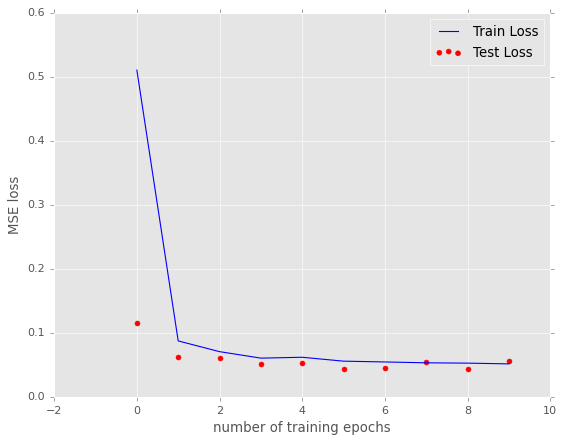

In [288]:
crypt_model1.train()

In [289]:
import random
def random_message(length):
    s = ''
    for i in range(length):
        s += chr(random.randint(32, 32+94-1))
    return s

In [290]:
message = random_message(10000)#"abcdefghijklmnopqrestuvwxyzABCDEFGHIJKLMNOPQRSTUVWXYZ"*4

decryption accuracy is 98.17%


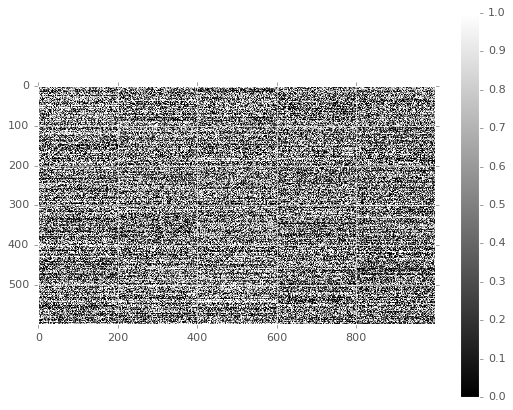

98.17

In [291]:
crypt_model1.evaluate(message, noise = 0.7, vis = True)

In [ ]:
###

## Grid Search

In [136]:
dim_multipliers = list(range(5,105,5))
print(dim_multipliers)
noise_levels = [i*0.01 for i in range(5, 75, 5)]
print(noise_levels)

[5, 10, 15, 20, 25, 30, 35, 40, 45, 50, 55, 60, 65, 70, 75, 80, 85, 90, 95, 100]
[0.05, 0.1, 0.15, 0.2, 0.25, 0.3, 0.35000000000000003, 0.4, 0.45, 0.5, 0.55, 0.6, 0.65, 0.7000000000000001]


In [137]:
grid = np.zeros([len(dim_multipliers), len(noise_levels)])
grid.shape

(20, 14)

In [138]:
message = random_message(10000)

Parameters: 5 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([ 1, 29, 14, 47,  5, 88, 72, 35,  7,  4, 21, 89, 78, 83, 72, 16, 80, 22,
        18, 55, 84,  2, 53, 77, 90, 68, 75,  3, 50, 46, 68, 30, 84, 58, 52, 44,
         8, 13, 73,  5,  3, 88, 41, 28, 88,  4, 18,  9, 33, 36])
Epoch: 1, Train set: Avg. loss: 0.480248
Test set: Avg. loss: 0.205741
Epoch: 2, Train set: Avg. loss: 0.185307
Test set: Avg. loss: 0.167925
Epoch: 3, Train set: Avg. loss: 0.158037
Test set: Avg. loss: 0.152182
Epoch: 4, Train set: Avg. loss: 0.150074
Test set: Avg. loss: 0.139383
Epoch: 5, Train set: Avg. loss: 0.141110
Test set: Avg. loss: 0.132623
Epoch: 6, Train set: Avg. loss: 0.135594
Test set: Avg. loss: 0.130378
Epoch: 7, Train set: Avg. loss: 0.128356
Test set: Avg. loss: 0.127414
Epoch: 8, Train set: Avg. loss: 0.125568
Test set: Avg. loss: 0.124928
Epoch: 9, Train set: Avg. loss: 0.126087
Test set: Avg. loss: 0.124680
Epoch: 10, Train set: Avg. loss: 0.120185
Test set: Avg. loss: 0.122309


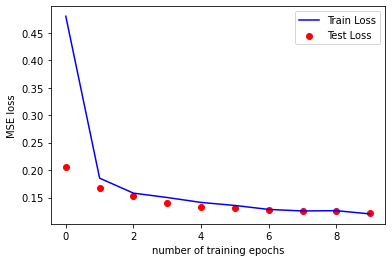

decryption accuracy is 95.72%


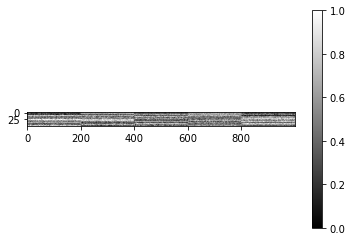

Parameters: 5 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([78, 74, 27, 57, 63, 80, 26, 76, 42, 86, 86, 82, 77, 79, 62, 56, 79, 21,
        36, 86, 38, 50, 55, 75, 13,  1, 44, 66,  6,  3,  8, 41, 52, 85, 89, 33,
        92, 87, 87, 56, 38, 91, 60, 36, 10, 86, 31, 38, 93, 60])
Epoch: 1, Train set: Avg. loss: 0.617045
Test set: Avg. loss: 0.317880
Epoch: 2, Train set: Avg. loss: 0.283725
Test set: Avg. loss: 0.266744
Epoch: 3, Train set: Avg. loss: 0.254848
Test set: Avg. loss: 0.237907
Epoch: 4, Train set: Avg. loss: 0.237949
Test set: Avg. loss: 0.242378
Epoch: 5, Train set: Avg. loss: 0.226811
Test set: Avg. loss: 0.224538
Epoch: 6, Train set: Avg. loss: 0.227268
Test set: Avg. loss: 0.220224
Epoch: 7, Train set: Avg. loss: 0.216363
Test set: Avg. loss: 0.216131
Epoch: 8, Train set: Avg. loss: 0.215654
Test set: Avg. loss: 0.207821
Epoch: 9, Train set: Avg. loss: 0.205862
Test set: Avg. loss: 0.212964
Epoch: 10, Train set: Avg. loss: 0.209425
Test set: Avg. loss: 0.205364


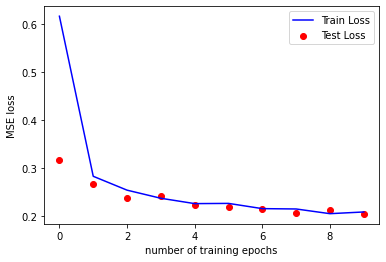

decryption accuracy is 93.28%


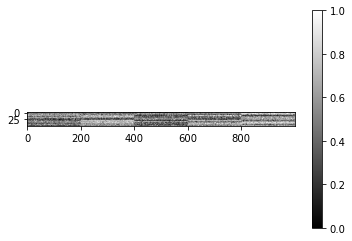

Parameters: 5 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([64, 40, 33, 19, 33, 46, 89, 20, 15, 69, 18, 52,  6, 52, 81, 12, 71, 64,
        52,  0, 20, 81, 84, 54, 59, 72, 65, 26, 77,  6, 63, 80, 91, 42, 62, 80,
         5,  3, 22, 80,  7, 54, 90, 14, 82, 87, 25, 68, 27, 54])
Epoch: 1, Train set: Avg. loss: 0.721689
Test set: Avg. loss: 0.397447
Epoch: 2, Train set: Avg. loss: 0.357465
Test set: Avg. loss: 0.330062
Epoch: 3, Train set: Avg. loss: 0.324164
Test set: Avg. loss: 0.305968
Epoch: 4, Train set: Avg. loss: 0.302711
Test set: Avg. loss: 0.289306
Epoch: 5, Train set: Avg. loss: 0.297774
Test set: Avg. loss: 0.294331
Epoch: 6, Train set: Avg. loss: 0.282585
Test set: Avg. loss: 0.279652
Epoch: 7, Train set: Avg. loss: 0.281814
Test set: Avg. loss: 0.274003
Epoch: 8, Train set: Avg. loss: 0.276971
Test set: Avg. loss: 0.267800
Epoch: 9, Train set: Avg. loss: 0.273535
Test set: Avg. loss: 0.277746
Epoch: 10, Train set: Avg. loss: 0.274869
Test set: Avg. loss: 0.281262


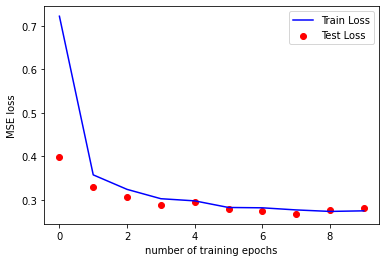

decryption accuracy is 91.15%


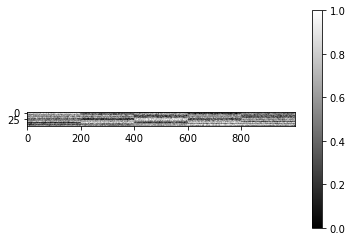

Parameters: 5 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([90, 28, 13, 15, 85, 52, 57,  2, 83, 55, 29, 41, 26, 47,  8, 67,  3, 66,
        20, 27, 80, 83, 27, 29, 69, 81, 59, 92,  2,  4, 73,  9, 50, 42, 81,  5,
        75, 70, 42,  7, 32, 90, 18, 56, 24, 18, 53,  4, 43, 13])
Epoch: 1, Train set: Avg. loss: 0.930357
Test set: Avg. loss: 0.574423
Epoch: 2, Train set: Avg. loss: 0.535889
Test set: Avg. loss: 0.506276
Epoch: 3, Train set: Avg. loss: 0.489502
Test set: Avg. loss: 0.475380
Epoch: 4, Train set: Avg. loss: 0.480895
Test set: Avg. loss: 0.463906
Epoch: 5, Train set: Avg. loss: 0.461573
Test set: Avg. loss: 0.450582
Epoch: 6, Train set: Avg. loss: 0.454203
Test set: Avg. loss: 0.460879
Epoch: 7, Train set: Avg. loss: 0.453037
Test set: Avg. loss: 0.456546
Epoch: 8, Train set: Avg. loss: 0.451552
Test set: Avg. loss: 0.440528
Epoch: 9, Train set: Avg. loss: 0.442637
Test set: Avg. loss: 0.444529
Epoch: 10, Train set: Avg. loss: 0.439269
Test set: Avg. loss: 0.448723


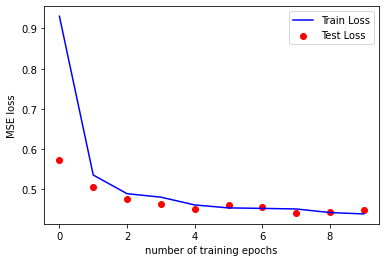

decryption accuracy is 84.56%


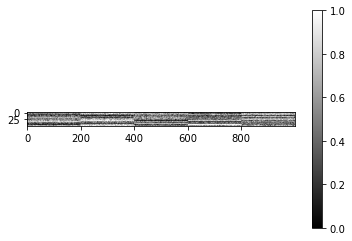

Parameters: 5 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([77, 81, 25, 78,  8, 13, 39, 26, 76, 78, 36, 89, 12, 71, 91, 34, 42, 20,
         4, 10, 87, 15, 65, 54, 18, 44, 93, 64, 72,  6, 84, 57, 26, 61, 24, 25,
        65, 13, 24,  7, 31, 61, 39, 31, 13, 44, 90, 65, 88, 80])
Epoch: 1, Train set: Avg. loss: 1.145595
Test set: Avg. loss: 0.763027
Epoch: 2, Train set: Avg. loss: 0.732671
Test set: Avg. loss: 0.706577
Epoch: 3, Train set: Avg. loss: 0.686953
Test set: Avg. loss: 0.685643
Epoch: 4, Train set: Avg. loss: 0.680234
Test set: Avg. loss: 0.670950
Epoch: 5, Train set: Avg. loss: 0.670698
Test set: Avg. loss: 0.664625
Epoch: 6, Train set: Avg. loss: 0.666053
Test set: Avg. loss: 0.654203
Epoch: 7, Train set: Avg. loss: 0.656068
Test set: Avg. loss: 0.653464
Epoch: 8, Train set: Avg. loss: 0.658618
Test set: Avg. loss: 0.640480
Epoch: 9, Train set: Avg. loss: 0.658592
Test set: Avg. loss: 0.643812
Epoch: 10, Train set: Avg. loss: 0.652553
Test set: Avg. loss: 0.656605


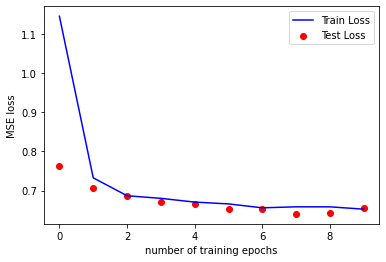

decryption accuracy is 78.13%


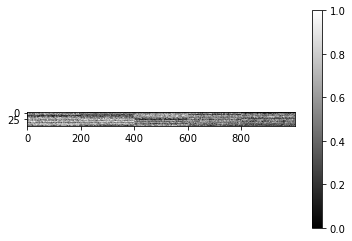

Parameters: 5 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([21, 91, 35, 17, 24, 67, 59, 42, 55, 75, 69, 15,  4, 37, 28, 49, 32, 92,
         1, 61, 24, 12, 21,  8, 66, 49, 76, 37, 56, 23, 31, 33, 73, 83, 17, 68,
        22,  4, 79, 31, 76, 75, 13, 76, 56, 59,  2, 84,  0, 73])
Epoch: 1, Train set: Avg. loss: 1.427497
Test set: Avg. loss: 1.056135
Epoch: 2, Train set: Avg. loss: 1.012340
Test set: Avg. loss: 0.994101
Epoch: 3, Train set: Avg. loss: 0.989940
Test set: Avg. loss: 0.981305
Epoch: 4, Train set: Avg. loss: 0.984411
Test set: Avg. loss: 0.980785
Epoch: 5, Train set: Avg. loss: 0.979456
Test set: Avg. loss: 0.973414
Epoch: 6, Train set: Avg. loss: 0.975253
Test set: Avg. loss: 0.971830
Epoch: 7, Train set: Avg. loss: 0.968693
Test set: Avg. loss: 0.968847
Epoch: 8, Train set: Avg. loss: 0.964563
Test set: Avg. loss: 0.974606
Epoch: 9, Train set: Avg. loss: 0.959344
Test set: Avg. loss: 0.975118
Epoch: 10, Train set: Avg. loss: 0.959421
Test set: Avg. loss: 0.959494


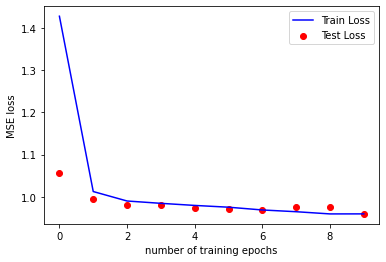

decryption accuracy is 68.58%


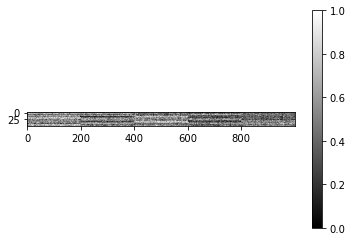

Parameters: 5 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([13, 10, 59, 75, 57, 40,  6, 52, 22, 17, 66, 25, 83, 46, 86, 26,  7, 79,
        57,  0, 78, 68, 54, 63, 46, 30, 38, 13, 77, 29, 11,  9, 49, 20, 90, 42,
        31, 52,  0, 49, 79, 60, 83, 11, 54, 77, 83, 53, 86, 40])
Epoch: 1, Train set: Avg. loss: 1.809843
Test set: Avg. loss: 1.466154
Epoch: 2, Train set: Avg. loss: 1.434570
Test set: Avg. loss: 1.433198
Epoch: 3, Train set: Avg. loss: 1.407709
Test set: Avg. loss: 1.404325
Epoch: 4, Train set: Avg. loss: 1.405132
Test set: Avg. loss: 1.406325
Epoch: 5, Train set: Avg. loss: 1.401733
Test set: Avg. loss: 1.387074
Epoch: 6, Train set: Avg. loss: 1.382090
Test set: Avg. loss: 1.391311
Epoch: 7, Train set: Avg. loss: 1.400607
Test set: Avg. loss: 1.406262
Epoch: 8, Train set: Avg. loss: 1.379394
Test set: Avg. loss: 1.405468
Epoch: 9, Train set: Avg. loss: 1.398847
Test set: Avg. loss: 1.414858
Epoch: 10, Train set: Avg. loss: 1.390764
Test set: Avg. loss: 1

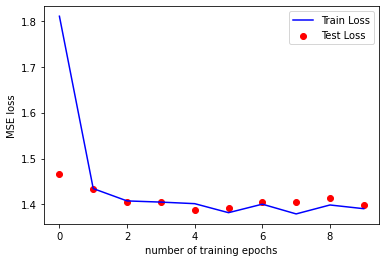

decryption accuracy is 56.07%


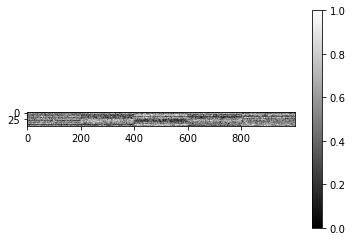

Parameters: 5 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([21, 31, 18, 35, 50, 32,  9, 92, 70, 29, 39, 50, 20,  0,  2, 10, 11, 49,
        56, 53, 84, 43,  6, 81, 64, 92, 19, 11, 47, 87, 50, 46,  6, 19, 67, 42,
        36, 41, 50, 52, 36, 74, 83, 52, 41, 41, 68, 50, 26,  4])
Epoch: 1, Train set: Avg. loss: 2.148241
Test set: Avg. loss: 1.833964
Epoch: 2, Train set: Avg. loss: 1.804258
Test set: Avg. loss: 1.822734
Epoch: 3, Train set: Avg. loss: 1.829736
Test set: Avg. loss: 1.801630
Epoch: 4, Train set: Avg. loss: 1.803646
Test set: Avg. loss: 1.808250
Epoch: 5, Train set: Avg. loss: 1.807874
Test set: Avg. loss: 1.822369
Epoch: 6, Train set: Avg. loss: 1.795486
Test set: Avg. loss: 1.797434
Epoch: 7, Train set: Avg. loss: 1.790800
Test set: Avg. loss: 1.796631
Epoch: 8, Train set: Avg. loss: 1.809961
Test set: Avg. loss: 1.787829
Epoch: 9, Train set: Avg. loss: 1.814660
Test set: Avg. loss: 1.791841
Epoch: 10, Train set: Avg. loss: 1.809019
Test set: Avg. loss: 1.808629


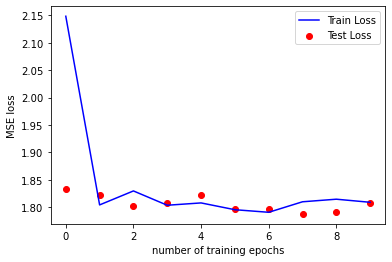

decryption accuracy is 45.55%


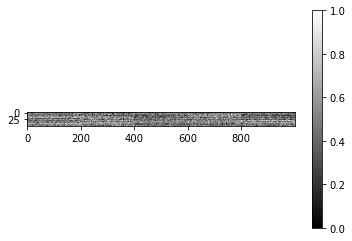

Parameters: 5 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([39, 42, 59, 14, 38, 85, 74, 30, 33, 40, 41, 47, 35, 86, 24, 48, 39, 36,
        13,  0, 58, 17, 44, 56, 45, 14, 23,  0, 78, 73, 17,  7, 33, 27, 27, 78,
        47, 85, 28,  9, 56, 90, 24,  5, 35, 72, 75, 26, 14, 41])
Epoch: 1, Train set: Avg. loss: 2.404977
Test set: Avg. loss: 2.114660
Epoch: 2, Train set: Avg. loss: 2.117321
Test set: Avg. loss: 2.119615
Epoch: 3, Train set: Avg. loss: 2.099574
Test set: Avg. loss: 2.098902
Epoch: 4, Train set: Avg. loss: 2.116570
Test set: Avg. loss: 2.078691
Epoch: 5, Train set: Avg. loss: 2.104684
Test set: Avg. loss: 2.096691
Epoch: 6, Train set: Avg. loss: 2.107553
Test set: Avg. loss: 2.089782
Epoch: 7, Train set: Avg. loss: 2.090309
Test set: Avg. loss: 2.078496
Epoch: 8, Train set: Avg. loss: 2.108419
Test set: Avg. loss: 2.096742
Epoch: 9, Train set: Avg. loss: 2.085193
Test set: Avg. loss: 2.073549
Epoch: 10, Train set: Avg. loss: 2.086625
Test set: Avg. loss: 2.057161


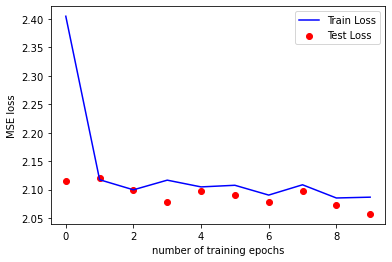

decryption accuracy is 39.32%


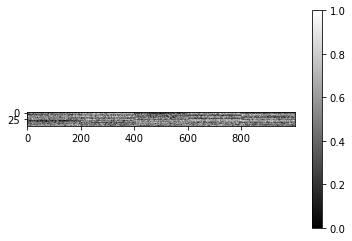

Parameters: 5 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([75, 90, 61, 60, 47, 62, 18, 14, 88, 23, 25,  5, 26, 37, 82, 85, 14, 36,
        82, 39, 23, 22, 89, 58, 47, 68, 55, 44, 12, 49, 84, 25, 66, 79,  4, 58,
        71, 35, 81, 61,  5, 54, 41, 16, 34, 40, 71, 81, 90, 84])
Epoch: 1, Train set: Avg. loss: 2.681712
Test set: Avg. loss: 2.458544
Epoch: 2, Train set: Avg. loss: 2.442041
Test set: Avg. loss: 2.466940
Epoch: 3, Train set: Avg. loss: 2.453580
Test set: Avg. loss: 2.452156
Epoch: 4, Train set: Avg. loss: 2.447206
Test set: Avg. loss: 2.446353
Epoch: 5, Train set: Avg. loss: 2.453348
Test set: Avg. loss: 2.420671
Epoch: 6, Train set: Avg. loss: 2.424244
Test set: Avg. loss: 2.450931
Epoch: 7, Train set: Avg. loss: 2.421871
Test set: Avg. loss: 2.445006
Epoch: 8, Train set: Avg. loss: 2.421433
Test set: Avg. loss: 2.434628
Epoch: 9, Train set: Avg. loss: 2.440175
Test set: Avg. loss: 2.432680
Epoch: 10, Train set: Avg. loss: 2.419967
Test set: Avg. loss: 2.436140


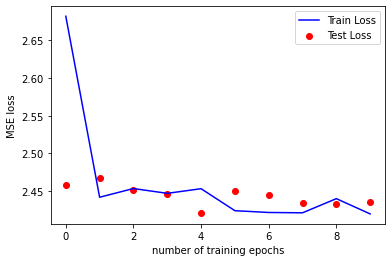

decryption accuracy is 32.44%


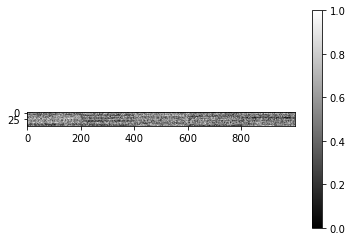

Parameters: 5 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([80, 36,  6, 57, 27, 72, 70, 59, 60, 46, 66, 78, 29, 12, 81, 25, 15, 47,
        56, 86, 47, 75, 42, 71, 86, 13, 49, 86, 81, 92, 50, 20, 48, 62, 73, 77,
        53, 14, 92, 81,  4,  6, 63,  8,  8, 92, 38, 60, 85, 35])
Epoch: 1, Train set: Avg. loss: 2.978766
Test set: Avg. loss: 2.765210
Epoch: 2, Train set: Avg. loss: 2.750768
Test set: Avg. loss: 2.745040
Epoch: 3, Train set: Avg. loss: 2.736877
Test set: Avg. loss: 2.755685
Epoch: 4, Train set: Avg. loss: 2.742069
Test set: Avg. loss: 2.742958
Epoch: 5, Train set: Avg. loss: 2.738397
Test set: Avg. loss: 2.726725
Epoch: 6, Train set: Avg. loss: 2.744799
Test set: Avg. loss: 2.739831
Epoch: 7, Train set: Avg. loss: 2.760921
Test set: Avg. loss: 2.783839
Epoch: 8, Train set: Avg. loss: 2.729978
Test set: Avg. loss: 2.749664
Epoch: 9, Train set: Avg. loss: 2.718883
Test set: Avg. loss: 2.730467
Epoch: 10, Train set: Avg. loss: 2.731036
Test set: Avg. loss: 2.727053


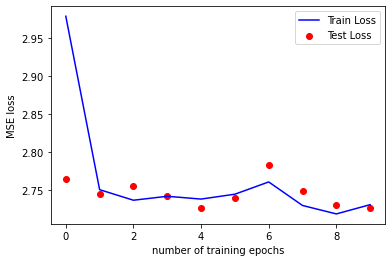

decryption accuracy is 26.06%


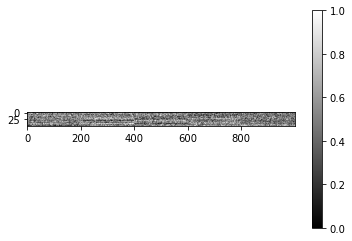

Parameters: 5 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([ 6, 78, 23, 46, 88, 48, 54, 63, 11, 33, 68, 62, 67, 78, 76, 57, 85, 31,
        79, 38, 66, 27, 72, 83, 77, 76, 85,  9,  6, 89, 44, 19, 42, 19,  6, 54,
        70, 38, 27, 77, 53, 22, 63, 22,  2, 50, 22,  1, 60, 39])
Epoch: 1, Train set: Avg. loss: 3.168764
Test set: Avg. loss: 2.994321
Epoch: 2, Train set: Avg. loss: 2.985538
Test set: Avg. loss: 2.972855
Epoch: 3, Train set: Avg. loss: 2.967376
Test set: Avg. loss: 2.980099
Epoch: 4, Train set: Avg. loss: 2.981847
Test set: Avg. loss: 2.968193
Epoch: 5, Train set: Avg. loss: 2.976146
Test set: Avg. loss: 2.970322
Epoch: 6, Train set: Avg. loss: 2.976989
Test set: Avg. loss: 2.971037
Epoch: 7, Train set: Avg. loss: 2.980434
Test set: Avg. loss: 2.969125
Epoch: 8, Train set: Avg. loss: 2.983327
Test set: Avg. loss: 2.948444
Epoch: 9, Train set: Avg. loss: 2.987222
Test set: Avg. loss: 2.965916
Epoch: 10, Train set: Avg. loss: 2.964653
Test set: Avg. loss: 2.967402


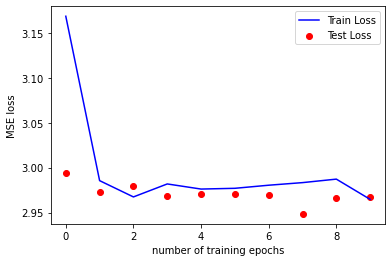

decryption accuracy is 22.64%


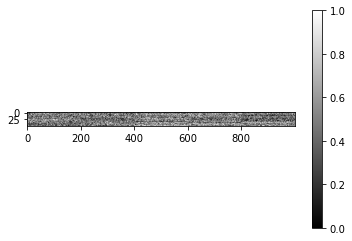

Parameters: 5 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([49, 87, 81, 53, 76, 28, 83, 34, 35, 47, 66, 92, 59, 20, 84, 45, 46, 10,
        32, 69, 26, 33, 29, 52, 36, 19, 56, 50, 58, 82, 79, 14, 67, 68,  0, 12,
        46, 51, 64, 63, 67, 60,  2, 89, 37, 49, 55, 58, 38, 86])
Epoch: 1, Train set: Avg. loss: 3.245188
Test set: Avg. loss: 3.061102
Epoch: 2, Train set: Avg. loss: 3.092603
Test set: Avg. loss: 3.081369
Epoch: 3, Train set: Avg. loss: 3.091668
Test set: Avg. loss: 3.090313
Epoch: 4, Train set: Avg. loss: 3.081107
Test set: Avg. loss: 3.098836
Epoch: 5, Train set: Avg. loss: 3.081927
Test set: Avg. loss: 3.073162
Epoch: 6, Train set: Avg. loss: 3.082055
Test set: Avg. loss: 3.075220
Epoch: 7, Train set: Avg. loss: 3.074851
Test set: Avg. loss: 3.084866
Epoch: 8, Train set: Avg. loss: 3.083660
Test set: Avg. loss: 3.053260
Epoch: 9, Train set: Avg. loss: 3.090599
Test set: Avg. loss: 3.082986
Epoch: 10, Train set: Avg. loss: 3.083228
Test set: Avg. loss: 3.083531


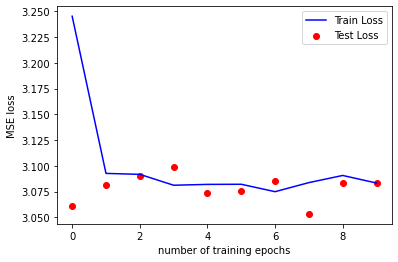

decryption accuracy is 20.36%


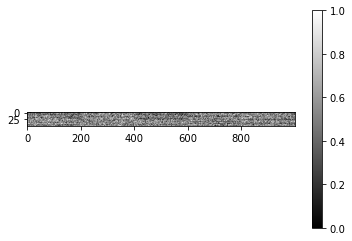

Parameters: 5 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([57, 27, 83,  6,  5,  2, 24, 58, 33,  2, 81, 93, 62, 44, 52, 19, 47, 35,
        32, 32, 35, 38, 12, 72, 73, 56, 31, 85, 19, 67, 90, 36, 11, 46, 13, 28,
        47, 28, 77, 49, 34,  2, 18, 74, 51, 92, 89, 63, 15, 80])
Epoch: 1, Train set: Avg. loss: 3.447779
Test set: Avg. loss: 3.320430
Epoch: 2, Train set: Avg. loss: 3.310837
Test set: Avg. loss: 3.304726
Epoch: 3, Train set: Avg. loss: 3.295006
Test set: Avg. loss: 3.286959
Epoch: 4, Train set: Avg. loss: 3.307500
Test set: Avg. loss: 3.293522
Epoch: 5, Train set: Avg. loss: 3.309787
Test set: Avg. loss: 3.293539
Epoch: 6, Train set: Avg. loss: 3.320757
Test set: Avg. loss: 3.307242
Epoch: 7, Train set: Avg. loss: 3.312945
Test set: Avg. loss: 3.328112
Epoch: 8, Train set: Avg. loss: 3.296817
Test set: Avg. loss: 3.307476
Epoch: 9, Train set: Avg. loss: 3.305318
Test set: Avg. loss: 3.301110
Epoch: 10, Train set: Avg. loss: 3.315045
Test set: Avg. loss: 3.

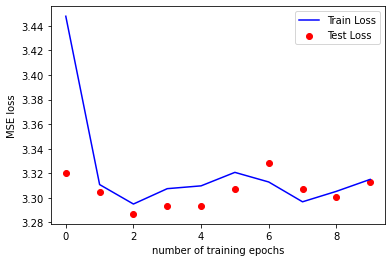

decryption accuracy is 16.32%


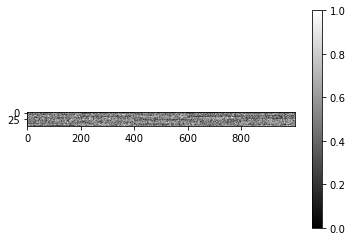

Parameters: 10 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([42, 11, 75, 92, 64, 78, 55, 35,  7, 41, 25, 57, 49, 56, 57, 70, 66, 16,
        45, 62, 56, 43, 27, 72, 46, 66, 76, 26, 57, 73, 50, 35, 53, 31, 80, 84,
        88, 51,  2, 77, 34, 86, 43, 34, 74,  6, 47, 20, 66, 35])
Epoch: 1, Train set: Avg. loss: 0.191670
Test set: Avg. loss: 0.046572
Epoch: 2, Train set: Avg. loss: 0.037893
Test set: Avg. loss: 0.033683
Epoch: 3, Train set: Avg. loss: 0.028803
Test set: Avg. loss: 0.026989
Epoch: 4, Train set: Avg. loss: 0.023804
Test set: Avg. loss: 0.023680
Epoch: 5, Train set: Avg. loss: 0.021764
Test set: Avg. loss: 0.021417
Epoch: 6, Train set: Avg. loss: 0.021737
Test set: Avg. loss: 0.020682
Epoch: 7, Train set: Avg. loss: 0.018342
Test set: Avg. loss: 0.018235
Epoch: 8, Train set: Avg. loss: 0.019008
Test set: Avg. loss: 0.016264
Epoch: 9, Train set: Avg. loss: 0.017509
Test set: Avg. loss: 0.016638
Epoch: 10, Train set: Avg. loss: 0.016866
Test set: Avg. loss: 0.018591


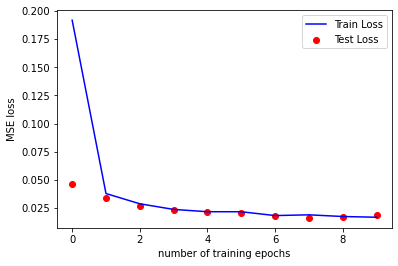

decryption accuracy is 99.55%


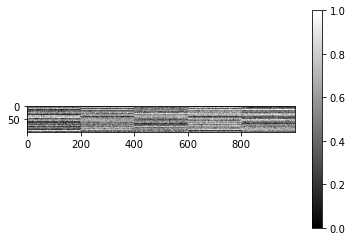

Parameters: 10 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([ 4, 86, 70, 13, 57, 53, 55, 19,  2, 90, 19, 62, 57, 78, 40, 78, 89, 61,
        48, 74, 26,  0,  6, 83, 25, 86, 66, 34, 65, 71, 12, 90, 76, 25, 93, 74,
        44, 64, 65, 88, 10, 59, 81, 68, 68, 43, 59,  9, 54, 47])
Epoch: 1, Train set: Avg. loss: 0.233776
Test set: Avg. loss: 0.067588
Epoch: 2, Train set: Avg. loss: 0.055946
Test set: Avg. loss: 0.047424
Epoch: 3, Train set: Avg. loss: 0.043673
Test set: Avg. loss: 0.041230
Epoch: 4, Train set: Avg. loss: 0.038808
Test set: Avg. loss: 0.038319
Epoch: 5, Train set: Avg. loss: 0.034982
Test set: Avg. loss: 0.032421
Epoch: 6, Train set: Avg. loss: 0.031944
Test set: Avg. loss: 0.029891
Epoch: 7, Train set: Avg. loss: 0.029694
Test set: Avg. loss: 0.028119
Epoch: 8, Train set: Avg. loss: 0.029975
Test set: Avg. loss: 0.028323
Epoch: 9, Train set: Avg. loss: 0.029358
Test set: Avg. loss: 0.028158
Epoch: 10, Train set: Avg. loss: 0.028157
Test set: Avg. loss: 0.027009


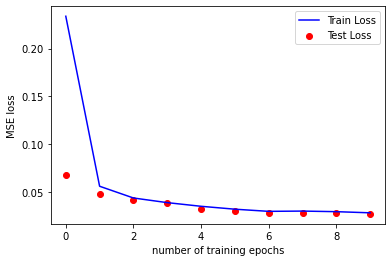

decryption accuracy is 99.41%


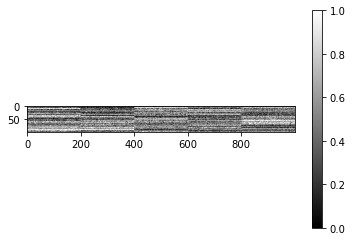

Parameters: 10 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([66, 67, 71, 24, 92, 31, 34,  8, 68, 42, 26, 22, 30, 89, 84, 93, 15, 14,
        86,  1, 78, 24, 67, 93, 30,  6, 44, 74, 69, 53, 42, 22, 61,  8, 10, 46,
        86, 78, 44, 28, 39, 65, 18, 22, 25, 13,  5, 79, 56, 69])
Epoch: 1, Train set: Avg. loss: 0.314341
Test set: Avg. loss: 0.103815
Epoch: 2, Train set: Avg. loss: 0.093234
Test set: Avg. loss: 0.077091
Epoch: 3, Train set: Avg. loss: 0.073879
Test set: Avg. loss: 0.071866
Epoch: 4, Train set: Avg. loss: 0.067656
Test set: Avg. loss: 0.060783
Epoch: 5, Train set: Avg. loss: 0.062252
Test set: Avg. loss: 0.060036
Epoch: 6, Train set: Avg. loss: 0.060678
Test set: Avg. loss: 0.054134
Epoch: 7, Train set: Avg. loss: 0.054408
Test set: Avg. loss: 0.053835
Epoch: 8, Train set: Avg. loss: 0.054203
Test set: Avg. loss: 0.054195
Epoch: 9, Train set: Avg. loss: 0.053759
Test set: Avg. loss: 0.050729
Epoch: 10, Train set: Avg. loss: 0.051575
Test set: Avg. loss: 0.048974


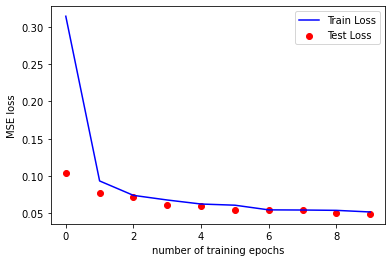

decryption accuracy is 98.29%


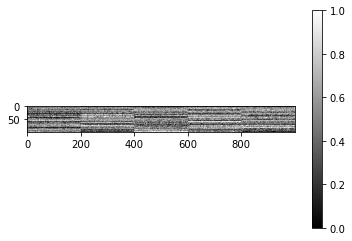

Parameters: 10 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([84, 85, 30, 63, 68, 37, 68, 69, 74, 67, 40, 48, 45, 46, 50, 63, 75, 48,
        93, 27, 21, 89, 69, 17, 76, 65, 84, 50, 22, 79, 78, 73, 65, 37,  4, 62,
        93,  4, 29, 22, 21, 90, 34, 10, 27, 44,  6, 13, 60,  7])
Epoch: 1, Train set: Avg. loss: 0.390735
Test set: Avg. loss: 0.151908
Epoch: 2, Train set: Avg. loss: 0.134258
Test set: Avg. loss: 0.123236
Epoch: 3, Train set: Avg. loss: 0.112503
Test set: Avg. loss: 0.104751
Epoch: 4, Train set: Avg. loss: 0.099416
Test set: Avg. loss: 0.098073
Epoch: 5, Train set: Avg. loss: 0.090676
Test set: Avg. loss: 0.093516
Epoch: 6, Train set: Avg. loss: 0.088757
Test set: Avg. loss: 0.091265
Epoch: 7, Train set: Avg. loss: 0.085873
Test set: Avg. loss: 0.094370
Epoch: 8, Train set: Avg. loss: 0.083461
Test set: Avg. loss: 0.082288
Epoch: 9, Train set: Avg. loss: 0.082558
Test set: Avg. loss: 0.084255
Epoch: 10, Train set: Avg. loss: 0.081972
Test set: Avg. loss: 0.079271


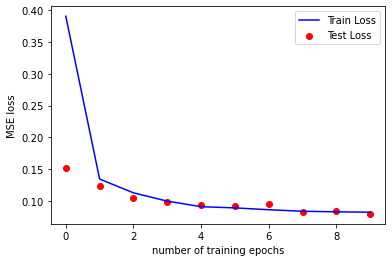

decryption accuracy is 97.5%


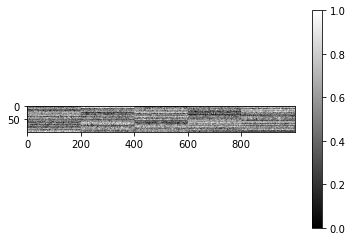

Parameters: 10 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([54, 81,  3, 22, 89, 60, 78, 90, 37, 16, 62, 62,  2, 76, 49, 89, 35,  0,
        56, 40, 79, 64, 67, 78, 19, 77, 22, 25, 32, 85, 62, 45, 10, 11, 42, 69,
        13, 90, 63, 53, 84, 68, 65, 17, 84, 14, 33, 32, 24, 17])
Epoch: 1, Train set: Avg. loss: 0.508373
Test set: Avg. loss: 0.232037
Epoch: 2, Train set: Avg. loss: 0.210469
Test set: Avg. loss: 0.192402
Epoch: 3, Train set: Avg. loss: 0.178900
Test set: Avg. loss: 0.177833
Epoch: 4, Train set: Avg. loss: 0.169295
Test set: Avg. loss: 0.186819
Epoch: 5, Train set: Avg. loss: 0.159619
Test set: Avg. loss: 0.158272
Epoch: 6, Train set: Avg. loss: 0.153987
Test set: Avg. loss: 0.152124
Epoch: 7, Train set: Avg. loss: 0.148880
Test set: Avg. loss: 0.164882
Epoch: 8, Train set: Avg. loss: 0.152256
Test set: Avg. loss: 0.149411
Epoch: 9, Train set: Avg. loss: 0.145031
Test set: Avg. loss: 0.139013
Epoch: 10, Train set: Avg. loss: 0.144798
Test set: Avg. loss: 0.145232


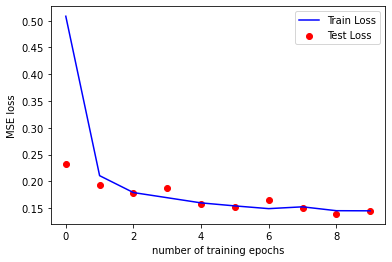

decryption accuracy is 95.11%


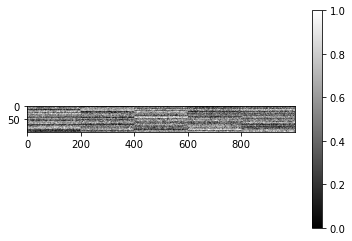

Parameters: 10 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([34, 44, 71, 23, 26, 26, 56, 34, 34,  4, 15,  9, 42, 10, 80, 81, 61, 27,
         3, 53, 79, 93, 87, 89, 63, 90, 74, 68, 18, 46, 48, 60, 22, 62, 62, 63,
        15, 74, 91, 15, 20, 25, 53, 32, 52, 89, 42, 11, 38,  3])
Epoch: 1, Train set: Avg. loss: 0.646487
Test set: Avg. loss: 0.335181
Epoch: 2, Train set: Avg. loss: 0.300509
Test set: Avg. loss: 0.280008
Epoch: 3, Train set: Avg. loss: 0.269791
Test set: Avg. loss: 0.261950
Epoch: 4, Train set: Avg. loss: 0.255920
Test set: Avg. loss: 0.256003
Epoch: 5, Train set: Avg. loss: 0.243697
Test set: Avg. loss: 0.248747
Epoch: 6, Train set: Avg. loss: 0.241229
Test set: Avg. loss: 0.236846
Epoch: 7, Train set: Avg. loss: 0.230533
Test set: Avg. loss: 0.238165
Epoch: 8, Train set: Avg. loss: 0.234741
Test set: Avg. loss: 0.226766
Epoch: 9, Train set: Avg. loss: 0.231513
Test set: Avg. loss: 0.237681
Epoch: 10, Train set: Avg. loss: 0.235990
Test set: Avg. loss: 0.218324


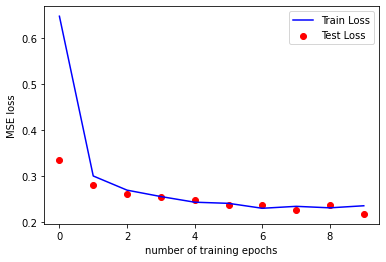

decryption accuracy is 92.16%


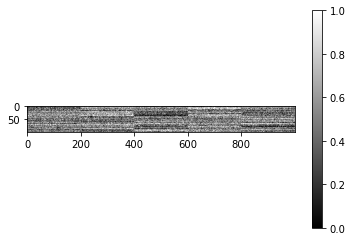

Parameters: 10 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([ 9, 91, 84,  4, 68, 45,  1,  2, 65, 89, 74, 72, 65, 10, 83, 54, 74, 33,
        50, 30, 78, 33, 65, 38, 37, 77, 20, 86, 73, 42,  6, 66, 29, 80, 28, 90,
        10, 50, 33, 37, 56, 53, 45, 80, 93, 71, 14, 57, 11, 19])
Epoch: 1, Train set: Avg. loss: 0.879533
Test set: Avg. loss: 0.546980
Epoch: 2, Train set: Avg. loss: 0.505969
Test set: Avg. loss: 0.485668
Epoch: 3, Train set: Avg. loss: 0.466938
Test set: Avg. loss: 0.452689
Epoch: 4, Train set: Avg. loss: 0.453810
Test set: Avg. loss: 0.473601
Epoch: 5, Train set: Avg. loss: 0.444070
Test set: Avg. loss: 0.471523
Epoch: 6, Train set: Avg. loss: 0.437857
Test set: Avg. loss: 0.440606
Epoch: 7, Train set: Avg. loss: 0.431598
Test set: Avg. loss: 0.442479
Epoch: 8, Train set: Avg. loss: 0.434765
Test set: Avg. loss: 0.440073
Epoch: 9, Train set: Avg. loss: 0.432822
Test set: Avg. loss: 0.426431
Epoch: 10, Train set: Avg. loss: 0.429354
Test set: Avg. loss: 

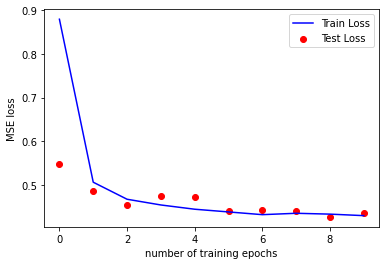

decryption accuracy is 85.14%


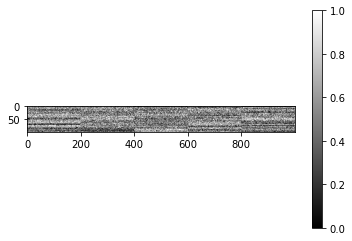

Parameters: 10 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([ 7, 24, 63, 26, 19, 89,  1, 54, 41, 11, 11, 36, 44, 77, 73, 47, 90, 10,
        32, 72, 21, 70, 87, 10, 60, 15, 27, 40, 63, 56, 67, 88, 24, 20, 59, 38,
        30, 57, 46, 80, 91, 86, 53, 72,  0, 34, 18, 67, 23, 17])
Epoch: 1, Train set: Avg. loss: 1.050267
Test set: Avg. loss: 0.697150
Epoch: 2, Train set: Avg. loss: 0.667110
Test set: Avg. loss: 0.654122
Epoch: 3, Train set: Avg. loss: 0.625534
Test set: Avg. loss: 0.631558
Epoch: 4, Train set: Avg. loss: 0.615971
Test set: Avg. loss: 0.618375
Epoch: 5, Train set: Avg. loss: 0.616950
Test set: Avg. loss: 0.620376
Epoch: 6, Train set: Avg. loss: 0.625225
Test set: Avg. loss: 0.613832
Epoch: 7, Train set: Avg. loss: 0.606619
Test set: Avg. loss: 0.596794
Epoch: 8, Train set: Avg. loss: 0.609869
Test set: Avg. loss: 0.588828
Epoch: 9, Train set: Avg. loss: 0.605369
Test set: Avg. loss: 0.605709
Epoch: 10, Train set: Avg. loss: 0.608612
Test set: Avg. loss: 0.602464


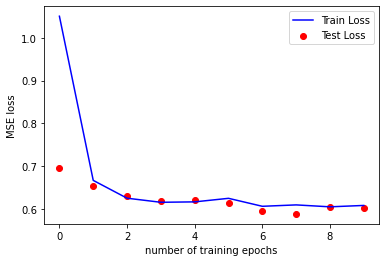

decryption accuracy is 80.37%


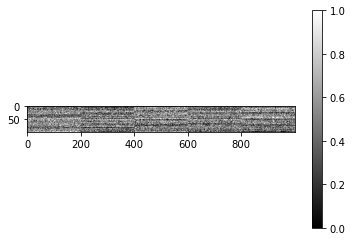

Parameters: 10 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([73, 81, 81, 45, 24, 17, 17, 42, 72, 56, 61, 83, 12, 17, 27, 32, 46,  9,
        55, 67, 30, 70, 93, 41, 60,  4, 10, 73, 59,  8, 15, 53, 11, 64, 91, 17,
        67, 89, 29, 56, 68,  2, 61, 62, 21, 39, 18, 73, 43,  4])
Epoch: 1, Train set: Avg. loss: 1.352462
Test set: Avg. loss: 0.998944
Epoch: 2, Train set: Avg. loss: 0.969650
Test set: Avg. loss: 0.943801
Epoch: 3, Train set: Avg. loss: 0.937742
Test set: Avg. loss: 0.962650
Epoch: 4, Train set: Avg. loss: 0.955158
Test set: Avg. loss: 0.951783
Epoch: 5, Train set: Avg. loss: 0.937971
Test set: Avg. loss: 0.974504
Epoch: 6, Train set: Avg. loss: 0.945968
Test set: Avg. loss: 0.991988
Epoch: 7, Train set: Avg. loss: 0.949569
Test set: Avg. loss: 0.920593
Epoch: 8, Train set: Avg. loss: 0.935806
Test set: Avg. loss: 0.946001
Epoch: 9, Train set: Avg. loss: 0.927022
Test set: Avg. loss: 0.960270
Epoch: 10, Train set: Avg. loss: 0.942609
Test set: Avg. loss: 0.961177


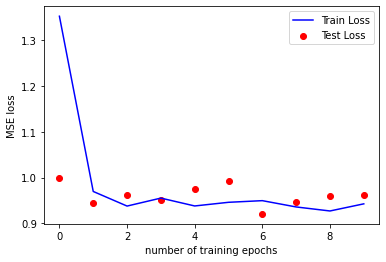

decryption accuracy is 69.74%


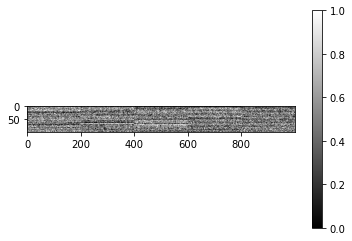

Parameters: 10 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([54,  2, 18, 39, 12, 54, 16, 82, 87, 49, 55, 19, 79, 32, 44, 47, 78, 16,
        23, 85, 52,  1, 65,  3, 27, 83, 89, 40, 84, 18, 63,  9, 24, 10, 56,  5,
        70, 24, 15, 79, 53, 85, 69, 22, 31, 10, 36, 72, 58, 47])
Epoch: 1, Train set: Avg. loss: 1.647188
Test set: Avg. loss: 1.297274
Epoch: 2, Train set: Avg. loss: 1.286492
Test set: Avg. loss: 1.241215
Epoch: 3, Train set: Avg. loss: 1.257804
Test set: Avg. loss: 1.261527
Epoch: 4, Train set: Avg. loss: 1.256102
Test set: Avg. loss: 1.236285
Epoch: 5, Train set: Avg. loss: 1.261611
Test set: Avg. loss: 1.299370
Epoch: 6, Train set: Avg. loss: 1.268528
Test set: Avg. loss: 1.278364
Epoch: 7, Train set: Avg. loss: 1.270159
Test set: Avg. loss: 1.293150
Epoch: 8, Train set: Avg. loss: 1.278620
Test set: Avg. loss: 1.291383
Epoch: 9, Train set: Avg. loss: 1.260996
Test set: Avg. loss: 1.297454
Epoch: 10, Train set: Avg. loss: 1.258399
Test set: Avg. loss: 1.237162


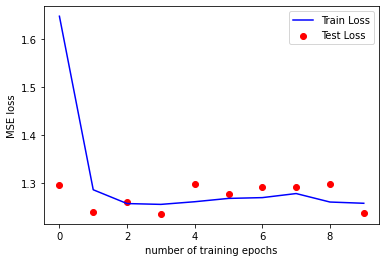

decryption accuracy is 61.55%


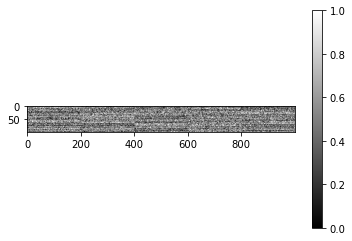

Parameters: 10 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([70, 65, 21, 64, 88, 10, 54, 84, 85, 75, 16, 65,  3,  9, 86, 56, 40, 79,
         8, 70, 50, 16, 77, 69, 27, 18, 62,  5, 55, 90, 78, 93, 44, 82, 60,  2,
        39,  4, 37, 15, 14, 53, 87, 26, 13, 10, 22, 16,  6, 27])
Epoch: 1, Train set: Avg. loss: 1.901532
Test set: Avg. loss: 1.584477
Epoch: 2, Train set: Avg. loss: 1.580047
Test set: Avg. loss: 1.587182
Epoch: 3, Train set: Avg. loss: 1.586463
Test set: Avg. loss: 1.591905
Epoch: 4, Train set: Avg. loss: 1.593416
Test set: Avg. loss: 1.590236
Epoch: 5, Train set: Avg. loss: 1.591860
Test set: Avg. loss: 1.606287
Epoch: 6, Train set: Avg. loss: 1.596703
Test set: Avg. loss: 1.608563
Epoch: 7, Train set: Avg. loss: 1.592095
Test set: Avg. loss: 1.582429
Epoch: 8, Train set: Avg. loss: 1.581700
Test set: Avg. loss: 1.599121
Epoch: 9, Train set: Avg. loss: 1.599728
Test set: Avg. loss: 1.578641
Epoch: 10, Train set: Avg. loss: 1.599890
Test set: Avg. loss: 1.593459


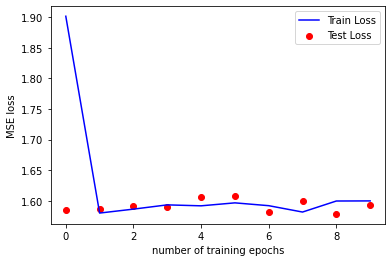

decryption accuracy is 52.35%


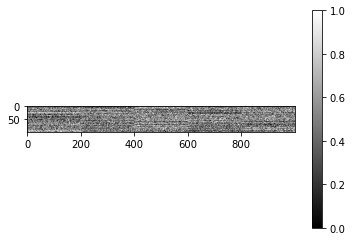

Parameters: 10 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([47, 66,  4, 36, 49, 20, 23, 53, 22, 14, 70, 35, 87, 66, 68, 58, 43, 25,
        77, 92, 39, 85, 21, 69, 24,  3, 93, 41, 90, 25, 64, 85, 73, 74,  5, 14,
        33, 23, 81, 89, 93, 75, 56,  0, 89,  1, 64, 53, 82, 16])
Epoch: 1, Train set: Avg. loss: 2.225918
Test set: Avg. loss: 1.947369
Epoch: 2, Train set: Avg. loss: 1.939160
Test set: Avg. loss: 1.974181
Epoch: 3, Train set: Avg. loss: 1.961285
Test set: Avg. loss: 1.997420
Epoch: 4, Train set: Avg. loss: 1.963024
Test set: Avg. loss: 1.950134
Epoch: 5, Train set: Avg. loss: 1.945680
Test set: Avg. loss: 1.902208
Epoch: 6, Train set: Avg. loss: 1.951975
Test set: Avg. loss: 1.931613
Epoch: 7, Train set: Avg. loss: 1.941819
Test set: Avg. loss: 1.935662
Epoch: 8, Train set: Avg. loss: 1.955322
Test set: Avg. loss: 1.995784
Epoch: 9, Train set: Avg. loss: 1.960550
Test set: Avg. loss: 1.953046
Epoch: 10, Train set: Avg. loss: 1.967873
Test set: Avg. loss: 1.938582


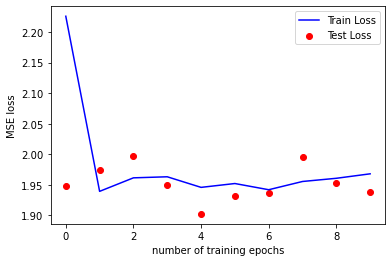

decryption accuracy is 44.63%


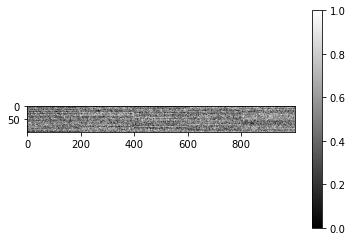

Parameters: 10 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([25, 55, 60, 87, 28, 27, 56, 22, 22, 84, 84,  0, 28, 70, 11, 69, 46, 23,
        75, 35, 14, 75, 19, 42, 79, 41, 85, 57, 51, 83, 33, 26, 79, 24, 15, 66,
        62, 87, 60, 73, 67, 63, 50, 21, 28, 86, 20, 69, 39, 72])
Epoch: 1, Train set: Avg. loss: 2.470036
Test set: Avg. loss: 2.247576
Epoch: 2, Train set: Avg. loss: 2.217728
Test set: Avg. loss: 2.217396
Epoch: 3, Train set: Avg. loss: 2.248130
Test set: Avg. loss: 2.287409
Epoch: 4, Train set: Avg. loss: 2.236829
Test set: Avg. loss: 2.286798
Epoch: 5, Train set: Avg. loss: 2.243117
Test set: Avg. loss: 2.259875
Epoch: 6, Train set: Avg. loss: 2.230820
Test set: Avg. loss: 2.256721
Epoch: 7, Train set: Avg. loss: 2.236246
Test set: Avg. loss: 2.256857
Epoch: 8, Train set: Avg. loss: 2.216514
Test set: Avg. loss: 2.307798
Epoch: 9, Train set: Avg. loss: 2.208835
Test set: Avg. loss: 2.237346
Epoch: 10, Train set: Avg. loss: 2.225303
Test set: Avg. loss: 2.270196


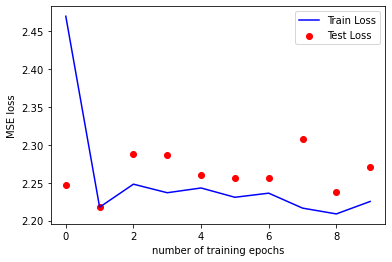

decryption accuracy is 37.11%


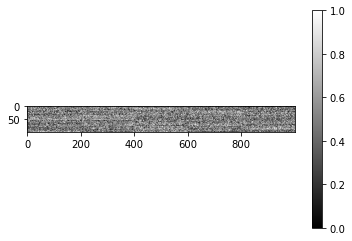

Parameters: 10 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([45, 34, 18, 46, 65, 32, 92,  0,  9, 75,  3, 33, 71, 59, 38, 67, 11, 21,
         8, 49, 60, 14, 72, 19, 12, 85, 48, 52, 48, 85, 59, 17, 11, 62, 81, 10,
         2, 37, 67, 36, 40, 56, 48, 53, 52, 16, 72,  2,  9, 31])
Epoch: 1, Train set: Avg. loss: 2.727006
Test set: Avg. loss: 2.569902
Epoch: 2, Train set: Avg. loss: 2.518509
Test set: Avg. loss: 2.551673
Epoch: 3, Train set: Avg. loss: 2.507873
Test set: Avg. loss: 2.571948
Epoch: 4, Train set: Avg. loss: 2.506678
Test set: Avg. loss: 2.558767
Epoch: 5, Train set: Avg. loss: 2.509902
Test set: Avg. loss: 2.523484
Epoch: 6, Train set: Avg. loss: 2.509242
Test set: Avg. loss: 2.505906
Epoch: 7, Train set: Avg. loss: 2.508122
Test set: Avg. loss: 2.513437
Epoch: 8, Train set: Avg. loss: 2.501735
Test set: Avg. loss: 2.514012
Epoch: 9, Train set: Avg. loss: 2.493847
Test set: Avg. loss: 2.453542
Epoch: 10, Train set: Avg. loss: 2.505105
Test set: Avg. loss: 2

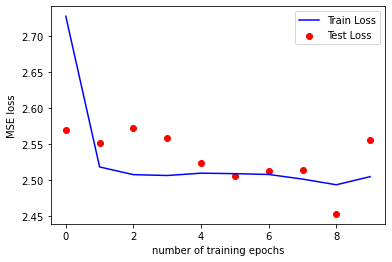

decryption accuracy is 31.72%


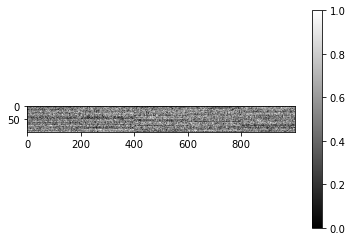

Parameters: 15 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([18, 13, 93, 14, 67, 86, 39, 89, 36, 78, 79,  3, 82, 45, 93, 51, 46, 66,
        37, 41, 14, 75, 10, 46, 28, 19, 69, 65, 53, 60, 83, 92, 26, 37, 15, 65,
        44, 46, 53, 26,  4, 29, 45, 91, 78, 90, 60, 49, 39, 47])
Epoch: 1, Train set: Avg. loss: 0.120955
Test set: Avg. loss: 0.021447
Epoch: 2, Train set: Avg. loss: 0.016557
Test set: Avg. loss: 0.013077
Epoch: 3, Train set: Avg. loss: 0.012139
Test set: Avg. loss: 0.010728
Epoch: 4, Train set: Avg. loss: 0.009418
Test set: Avg. loss: 0.008436
Epoch: 5, Train set: Avg. loss: 0.007748
Test set: Avg. loss: 0.007481
Epoch: 6, Train set: Avg. loss: 0.007499
Test set: Avg. loss: 0.006949
Epoch: 7, Train set: Avg. loss: 0.006390
Test set: Avg. loss: 0.006019
Epoch: 8, Train set: Avg. loss: 0.006584
Test set: Avg. loss: 0.006785
Epoch: 9, Train set: Avg. loss: 0.005841
Test set: Avg. loss: 0.005724
Epoch: 10, Train set: Avg. loss: 0.005437
Test set: Avg. loss: 0.005873


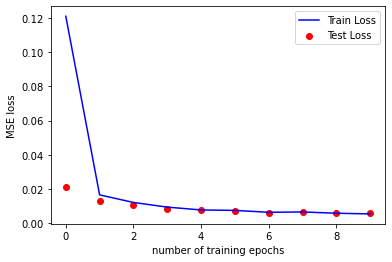

decryption accuracy is 99.81%


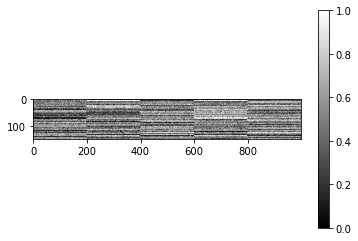

Parameters: 15 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([72, 10, 72, 46, 33, 92, 27, 69,  3, 90, 82, 79, 70, 25, 87, 40, 52, 24,
        83, 72, 18, 16, 35, 13,  6, 45,  9, 13, 34, 48, 82, 25, 33, 53, 83, 35,
        35, 54, 34,  0, 54, 66, 93, 58, 87, 21, 74, 92, 62, 43])
Epoch: 1, Train set: Avg. loss: 0.144124
Test set: Avg. loss: 0.029344
Epoch: 2, Train set: Avg. loss: 0.023770
Test set: Avg. loss: 0.019470
Epoch: 3, Train set: Avg. loss: 0.017378
Test set: Avg. loss: 0.018464
Epoch: 4, Train set: Avg. loss: 0.014648
Test set: Avg. loss: 0.013465
Epoch: 5, Train set: Avg. loss: 0.013425
Test set: Avg. loss: 0.011859
Epoch: 6, Train set: Avg. loss: 0.011572
Test set: Avg. loss: 0.010444
Epoch: 7, Train set: Avg. loss: 0.011105
Test set: Avg. loss: 0.010721
Epoch: 8, Train set: Avg. loss: 0.010279
Test set: Avg. loss: 0.009917
Epoch: 9, Train set: Avg. loss: 0.009707
Test set: Avg. loss: 0.009199
Epoch: 10, Train set: Avg. loss: 0.008952
Test set: Avg. loss: 0.010194


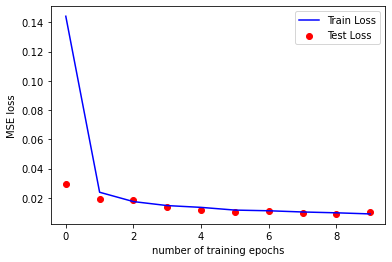

decryption accuracy is 99.82%


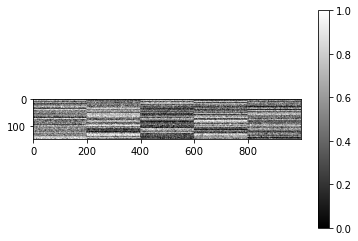

Parameters: 15 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([31, 77, 67, 23, 19, 75, 76,  0, 75, 53, 39, 36, 27, 14, 58, 28,  4, 11,
        31, 81, 19, 75, 83, 39, 67, 80, 34, 57, 90, 46, 29, 53, 82, 29,  5, 14,
        63, 93, 67, 85, 46, 37, 56, 42, 50, 49, 35, 61, 16, 37])
Epoch: 1, Train set: Avg. loss: 0.186356
Test set: Avg. loss: 0.044230
Epoch: 2, Train set: Avg. loss: 0.036464
Test set: Avg. loss: 0.029081
Epoch: 3, Train set: Avg. loss: 0.026460
Test set: Avg. loss: 0.025334
Epoch: 4, Train set: Avg. loss: 0.021873
Test set: Avg. loss: 0.020224
Epoch: 5, Train set: Avg. loss: 0.020256
Test set: Avg. loss: 0.021026
Epoch: 6, Train set: Avg. loss: 0.018339
Test set: Avg. loss: 0.017624
Epoch: 7, Train set: Avg. loss: 0.018078
Test set: Avg. loss: 0.017552
Epoch: 8, Train set: Avg. loss: 0.016166
Test set: Avg. loss: 0.017196
Epoch: 9, Train set: Avg. loss: 0.015327
Test set: Avg. loss: 0.016089
Epoch: 10, Train set: Avg. loss: 0.014014
Test set: Avg. loss: 0.016011


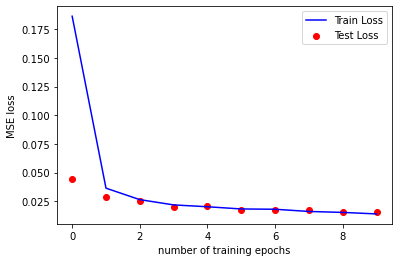

decryption accuracy is 99.66%


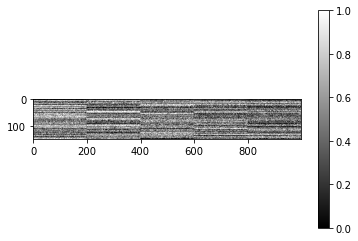

Parameters: 15 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([17, 24, 26, 25, 14, 11, 88, 83,  3, 20, 87,  7,  6, 67, 87, 33, 39,  4,
        72,  6, 46, 13, 40, 79, 55, 77, 55,  9, 38, 85, 73, 72, 86, 31,  5,  7,
        32, 91, 11, 70, 74, 51, 18, 30, 20, 49, 48, 20, 93, 29])
Epoch: 1, Train set: Avg. loss: 0.251323
Test set: Avg. loss: 0.073851
Epoch: 2, Train set: Avg. loss: 0.063939
Test set: Avg. loss: 0.052720
Epoch: 3, Train set: Avg. loss: 0.050532
Test set: Avg. loss: 0.044858
Epoch: 4, Train set: Avg. loss: 0.046500
Test set: Avg. loss: 0.045008
Epoch: 5, Train set: Avg. loss: 0.041622
Test set: Avg. loss: 0.039615
Epoch: 6, Train set: Avg. loss: 0.039309
Test set: Avg. loss: 0.034730
Epoch: 7, Train set: Avg. loss: 0.037367
Test set: Avg. loss: 0.034746
Epoch: 8, Train set: Avg. loss: 0.035522
Test set: Avg. loss: 0.038642
Epoch: 9, Train set: Avg. loss: 0.034647
Test set: Avg. loss: 0.031521
Epoch: 10, Train set: Avg. loss: 0.033086
Test set: Avg. loss: 0.032551


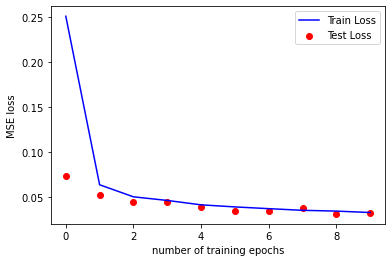

decryption accuracy is 99.04%


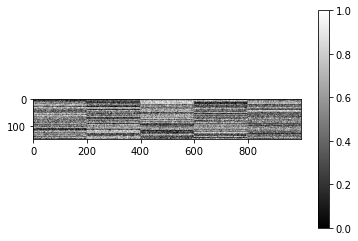

Parameters: 15 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([82, 46, 54, 34, 62, 93, 35, 31, 68, 66,  9, 32, 34, 36,  7, 76, 91, 83,
        30,  5, 80, 33, 39, 23, 93, 62, 47, 40, 60, 81, 89, 18, 37, 45, 23, 32,
        76,  3, 67, 70, 31, 32,  1, 61, 47, 18, 34, 56, 51, 13])
Epoch: 1, Train set: Avg. loss: 0.310712
Test set: Avg. loss: 0.104675
Epoch: 2, Train set: Avg. loss: 0.093876
Test set: Avg. loss: 0.084765
Epoch: 3, Train set: Avg. loss: 0.076259
Test set: Avg. loss: 0.068952
Epoch: 4, Train set: Avg. loss: 0.066784
Test set: Avg. loss: 0.062966
Epoch: 5, Train set: Avg. loss: 0.063854
Test set: Avg. loss: 0.064190
Epoch: 6, Train set: Avg. loss: 0.061045
Test set: Avg. loss: 0.056871
Epoch: 7, Train set: Avg. loss: 0.056753
Test set: Avg. loss: 0.060839
Epoch: 8, Train set: Avg. loss: 0.054729
Test set: Avg. loss: 0.051061
Epoch: 9, Train set: Avg. loss: 0.053410
Test set: Avg. loss: 0.051031
Epoch: 10, Train set: Avg. loss: 0.049948
Test set: Avg. loss: 0.056929


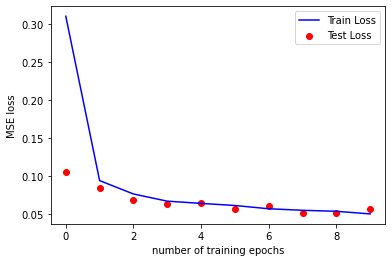

decryption accuracy is 98.13%


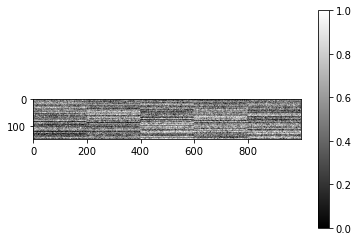

Parameters: 15 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([ 3, 47, 69,  5, 29, 30, 40, 82, 65, 66, 41, 48, 44, 65, 56, 74, 75,  6,
        90,  4, 14, 93, 88, 71, 44, 44, 82, 22, 38, 54, 81, 71, 41,  8, 14, 11,
        33,  8, 28, 71, 66, 54, 91, 46, 22, 27, 39, 65, 38, 24])
Epoch: 1, Train set: Avg. loss: 0.412321
Test set: Avg. loss: 0.166590
Epoch: 2, Train set: Avg. loss: 0.145724
Test set: Avg. loss: 0.130261
Epoch: 3, Train set: Avg. loss: 0.122172
Test set: Avg. loss: 0.112414
Epoch: 4, Train set: Avg. loss: 0.114799
Test set: Avg. loss: 0.107753
Epoch: 5, Train set: Avg. loss: 0.107527
Test set: Avg. loss: 0.107330
Epoch: 6, Train set: Avg. loss: 0.106136
Test set: Avg. loss: 0.107682
Epoch: 7, Train set: Avg. loss: 0.097594
Test set: Avg. loss: 0.099131
Epoch: 8, Train set: Avg. loss: 0.098690
Test set: Avg. loss: 0.096389
Epoch: 9, Train set: Avg. loss: 0.093153
Test set: Avg. loss: 0.091032
Epoch: 10, Train set: Avg. loss: 0.093802
Test set: Avg. loss: 0.091424


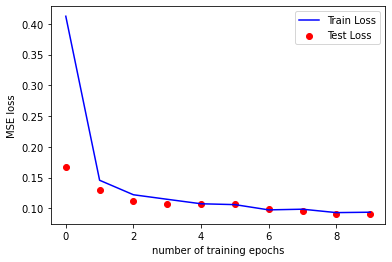

decryption accuracy is 96.95%


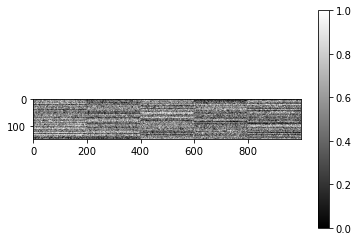

Parameters: 15 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([23, 86,  3, 78, 84, 44,  3,  5, 67, 86, 91, 35, 43, 23, 88, 44, 91, 54,
        25, 15, 18, 82, 42, 63, 90, 12, 68,  1,  1, 44,  9,  9, 34, 27, 83, 48,
        19, 67, 90, 25, 68, 66, 35, 43, 71, 22, 38, 46, 74, 57])
Epoch: 1, Train set: Avg. loss: 0.557366
Test set: Avg. loss: 0.280316
Epoch: 2, Train set: Avg. loss: 0.245892
Test set: Avg. loss: 0.240548
Epoch: 3, Train set: Avg. loss: 0.216341
Test set: Avg. loss: 0.218863
Epoch: 4, Train set: Avg. loss: 0.208074
Test set: Avg. loss: 0.199233
Epoch: 5, Train set: Avg. loss: 0.195965
Test set: Avg. loss: 0.183641
Epoch: 6, Train set: Avg. loss: 0.189162
Test set: Avg. loss: 0.198718
Epoch: 7, Train set: Avg. loss: 0.188762
Test set: Avg. loss: 0.201611
Epoch: 8, Train set: Avg. loss: 0.177649
Test set: Avg. loss: 0.187593
Epoch: 9, Train set: Avg. loss: 0.179086
Test set: Avg. loss: 0.183026
Epoch: 10, Train set: Avg. loss: 0.178928
Test set: Avg. loss: 

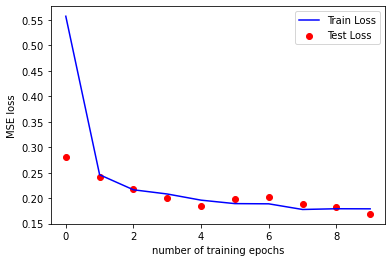

decryption accuracy is 94.38%


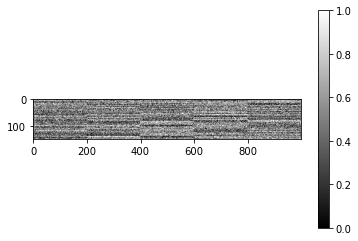

Parameters: 15 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([89, 48, 60, 67, 44, 18, 75,  0, 89, 40, 92, 61,  9, 17,  8, 42, 15, 93,
        37, 69, 66, 81, 48, 70, 53, 25, 13, 70,  3, 55, 78, 86,  0, 86, 42, 63,
        37,  1,  6, 35, 76, 15,  5, 79, 60, 56, 92,  8, 17, 14])
Epoch: 1, Train set: Avg. loss: 0.734043
Test set: Avg. loss: 0.420782
Epoch: 2, Train set: Avg. loss: 0.388883
Test set: Avg. loss: 0.385733
Epoch: 3, Train set: Avg. loss: 0.341311
Test set: Avg. loss: 0.336058
Epoch: 4, Train set: Avg. loss: 0.325739
Test set: Avg. loss: 0.324116
Epoch: 5, Train set: Avg. loss: 0.322835
Test set: Avg. loss: 0.315379
Epoch: 6, Train set: Avg. loss: 0.322118
Test set: Avg. loss: 0.319674
Epoch: 7, Train set: Avg. loss: 0.317951
Test set: Avg. loss: 0.304028
Epoch: 8, Train set: Avg. loss: 0.318110
Test set: Avg. loss: 0.307160
Epoch: 9, Train set: Avg. loss: 0.318822
Test set: Avg. loss: 0.305426
Epoch: 10, Train set: Avg. loss: 0.312742
Test set: Avg. loss: 0.317570


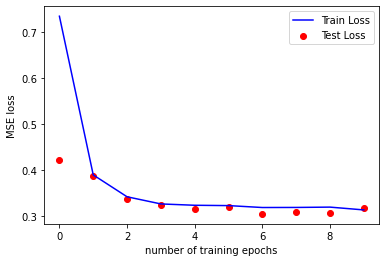

decryption accuracy is 88.82%


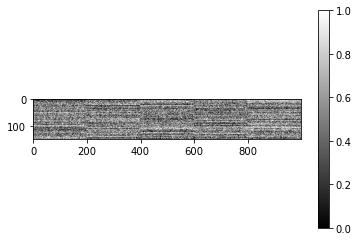

Parameters: 15 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([ 8, 74, 63, 68, 67, 41,  1, 56, 78, 69,  1, 93, 75, 93, 32, 60, 40, 83,
        58,  5,  0, 27, 35, 22,  8, 84, 73, 23, 66, 14, 86, 35,  2, 80, 57, 14,
        78, 25, 27, 37, 22, 20, 78, 15, 85, 31, 44, 71, 86, 67])
Epoch: 1, Train set: Avg. loss: 0.874551
Test set: Avg. loss: 0.552779
Epoch: 2, Train set: Avg. loss: 0.511018
Test set: Avg. loss: 0.470978
Epoch: 3, Train set: Avg. loss: 0.485298
Test set: Avg. loss: 0.469689
Epoch: 4, Train set: Avg. loss: 0.469298
Test set: Avg. loss: 0.467022
Epoch: 5, Train set: Avg. loss: 0.451856
Test set: Avg. loss: 0.445688
Epoch: 6, Train set: Avg. loss: 0.461318
Test set: Avg. loss: 0.455324
Epoch: 7, Train set: Avg. loss: 0.455484
Test set: Avg. loss: 0.446941
Epoch: 8, Train set: Avg. loss: 0.448387
Test set: Avg. loss: 0.439262
Epoch: 9, Train set: Avg. loss: 0.443326
Test set: Avg. loss: 0.439118
Epoch: 10, Train set: Avg. loss: 0.451685
Test set: Avg. loss: 0.435098


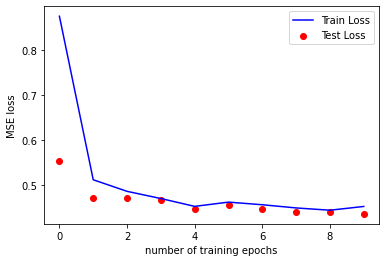

decryption accuracy is 86.19%


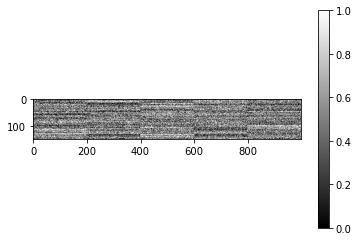

Parameters: 15 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([67, 79, 66, 26, 86, 75, 70,  1, 61,  4, 26, 20, 31, 19, 11, 20, 53, 80,
        43, 36, 15, 82, 61, 66, 53, 10, 55,  7, 62, 57, 29, 57,  7, 91, 51, 92,
        81, 41, 71, 10,  4, 83, 57, 46,  3, 86, 78, 82, 90, 27])
Epoch: 1, Train set: Avg. loss: 1.152875
Test set: Avg. loss: 0.825904
Epoch: 2, Train set: Avg. loss: 0.769189
Test set: Avg. loss: 0.735671
Epoch: 3, Train set: Avg. loss: 0.745665
Test set: Avg. loss: 0.703556
Epoch: 4, Train set: Avg. loss: 0.725132
Test set: Avg. loss: 0.752457
Epoch: 5, Train set: Avg. loss: 0.738628
Test set: Avg. loss: 0.724922
Epoch: 6, Train set: Avg. loss: 0.730938
Test set: Avg. loss: 0.751398
Epoch: 7, Train set: Avg. loss: 0.741355
Test set: Avg. loss: 0.739190
Epoch: 8, Train set: Avg. loss: 0.731273
Test set: Avg. loss: 0.715950
Epoch: 9, Train set: Avg. loss: 0.734183
Test set: Avg. loss: 0.718246
Epoch: 10, Train set: Avg. loss: 0.740210
Test set: Avg. loss: 0.721774


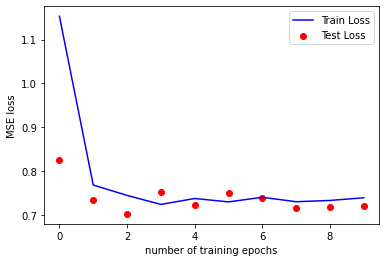

decryption accuracy is 77.91%


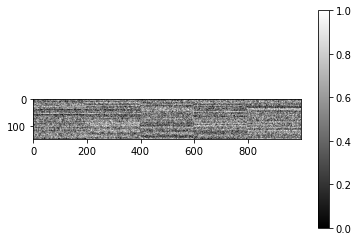

Parameters: 15 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([33, 69, 52, 91, 58, 49, 36, 24, 71, 68, 15, 29,  1, 27, 27,  3, 93, 89,
        37, 48, 10, 39, 66, 21, 33, 28, 48, 14, 48, 38, 63, 59, 53,  1, 54, 50,
        86, 55, 84, 63, 91, 44, 51, 72, 33, 92, 23, 20, 44, 80])
Epoch: 1, Train set: Avg. loss: 1.452646
Test set: Avg. loss: 1.081947
Epoch: 2, Train set: Avg. loss: 1.084789
Test set: Avg. loss: 1.052378
Epoch: 3, Train set: Avg. loss: 1.057387
Test set: Avg. loss: 1.109417
Epoch: 4, Train set: Avg. loss: 1.044420
Test set: Avg. loss: 1.070845
Epoch: 5, Train set: Avg. loss: 1.056593
Test set: Avg. loss: 1.102877
Epoch: 6, Train set: Avg. loss: 1.057991
Test set: Avg. loss: 1.064450
Epoch: 7, Train set: Avg. loss: 1.062911
Test set: Avg. loss: 1.086270
Epoch: 8, Train set: Avg. loss: 1.073531
Test set: Avg. loss: 1.120246
Epoch: 9, Train set: Avg. loss: 1.079304
Test set: Avg. loss: 1.075911
Epoch: 10, Train set: Avg. loss: 1.088572
Test set: Avg. loss: 1.078265


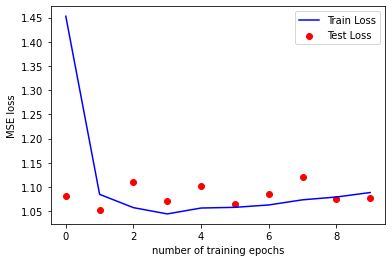

decryption accuracy is 67.49%


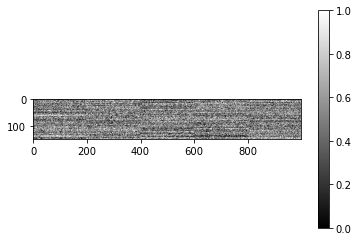

Parameters: 15 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([12, 42,  9, 56,  5, 10, 54, 69, 67, 62, 44, 41, 68, 53, 17, 36,  4, 88,
        72, 52, 57, 41, 14, 59, 91, 42, 81, 74, 16, 90,  8,  9, 25, 31, 90,  8,
        42, 11, 61, 37, 60, 42, 90, 64, 42, 65, 61, 58, 21, 20])
Epoch: 1, Train set: Avg. loss: 1.732056
Test set: Avg. loss: 1.356122
Epoch: 2, Train set: Avg. loss: 1.379235
Test set: Avg. loss: 1.348450
Epoch: 3, Train set: Avg. loss: 1.358580
Test set: Avg. loss: 1.391255
Epoch: 4, Train set: Avg. loss: 1.395029
Test set: Avg. loss: 1.400184
Epoch: 5, Train set: Avg. loss: 1.387589
Test set: Avg. loss: 1.377379
Epoch: 6, Train set: Avg. loss: 1.350100
Test set: Avg. loss: 1.390403
Epoch: 7, Train set: Avg. loss: 1.391539
Test set: Avg. loss: 1.375122
Epoch: 8, Train set: Avg. loss: 1.391074
Test set: Avg. loss: 1.440975
Epoch: 9, Train set: Avg. loss: 1.404488
Test set: Avg. loss: 1.383692
Epoch: 10, Train set: Avg. loss: 1.401191
Test set: Avg. loss: 1.369511


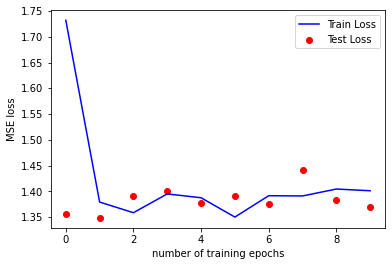

decryption accuracy is 60.53%


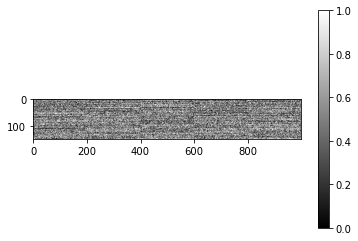

Parameters: 15 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([81, 10, 27, 40, 18, 69, 29, 15, 51, 41, 65, 68, 48, 74, 45, 90,  2, 68,
        44, 58, 71,  9,  8, 17, 22, 33,  7, 64, 92, 34,  7, 89, 45, 14, 78, 72,
         4, 89, 10, 72, 42, 60, 74, 27, 65,  0, 36, 46, 52, 14])
Epoch: 1, Train set: Avg. loss: 1.983153
Test set: Avg. loss: 1.589269
Epoch: 2, Train set: Avg. loss: 1.671005
Test set: Avg. loss: 1.697845
Epoch: 3, Train set: Avg. loss: 1.673289
Test set: Avg. loss: 1.674041
Epoch: 4, Train set: Avg. loss: 1.679777
Test set: Avg. loss: 1.627565
Epoch: 5, Train set: Avg. loss: 1.678861
Test set: Avg. loss: 1.688554
Epoch: 6, Train set: Avg. loss: 1.674698
Test set: Avg. loss: 1.691508
Epoch: 7, Train set: Avg. loss: 1.673604
Test set: Avg. loss: 1.694119
Epoch: 8, Train set: Avg. loss: 1.676031
Test set: Avg. loss: 1.704377
Epoch: 9, Train set: Avg. loss: 1.713529
Test set: Avg. loss: 1.655345
Epoch: 10, Train set: Avg. loss: 1.696569
Test set: Avg. loss: 1.640356


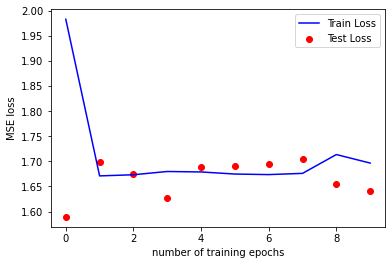

decryption accuracy is 53.17%


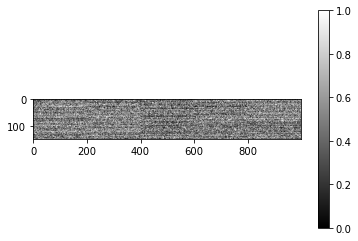

Parameters: 15 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([27, 93, 28, 51, 23, 35, 24, 10,  3,  6, 64, 84,  8, 88, 19, 77, 51, 30,
        22, 63, 25,  3, 66,  8, 14, 52, 12, 26,  7, 37,  6, 11, 59, 46,  1, 52,
        53, 18, 23, 19, 81, 75, 93, 25, 50, 62, 42, 24, 34,  8])
Epoch: 1, Train set: Avg. loss: 2.224238
Test set: Avg. loss: 1.928099
Epoch: 2, Train set: Avg. loss: 1.954194
Test set: Avg. loss: 2.013086
Epoch: 3, Train set: Avg. loss: 1.959169
Test set: Avg. loss: 1.997410
Epoch: 4, Train set: Avg. loss: 1.958191
Test set: Avg. loss: 1.949639
Epoch: 5, Train set: Avg. loss: 1.968283
Test set: Avg. loss: 1.988483
Epoch: 6, Train set: Avg. loss: 1.989824
Test set: Avg. loss: 1.985340
Epoch: 7, Train set: Avg. loss: 1.977856
Test set: Avg. loss: 1.949489
Epoch: 8, Train set: Avg. loss: 1.996773
Test set: Avg. loss: 1.982757
Epoch: 9, Train set: Avg. loss: 1.981230
Test set: Avg. loss: 1.962779
Epoch: 10, Train set: Avg. loss: 1.980066
Test set: Avg. loss: 1

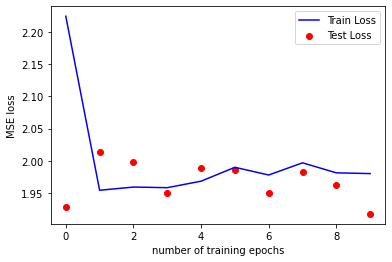

decryption accuracy is 45.83%


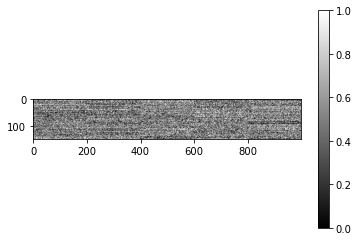

Parameters: 20 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([11, 58, 26, 92, 84, 48,  0,  6, 73, 27, 91, 83, 67, 43, 90, 54, 20, 83,
        93, 88, 63, 30, 73, 10, 46, 41, 79, 68, 58, 59, 22, 61, 14, 26, 78, 71,
        49, 84, 65, 51, 88, 45,  1, 32, 66, 86, 87, 67, 10, 56])
Epoch: 1, Train set: Avg. loss: 0.087197
Test set: Avg. loss: 0.013916
Epoch: 2, Train set: Avg. loss: 0.009524
Test set: Avg. loss: 0.007259
Epoch: 3, Train set: Avg. loss: 0.006389
Test set: Avg. loss: 0.005248
Epoch: 4, Train set: Avg. loss: 0.004795
Test set: Avg. loss: 0.004317
Epoch: 5, Train set: Avg. loss: 0.004099
Test set: Avg. loss: 0.003606
Epoch: 6, Train set: Avg. loss: 0.003498
Test set: Avg. loss: 0.003499
Epoch: 7, Train set: Avg. loss: 0.003164
Test set: Avg. loss: 0.002610
Epoch: 8, Train set: Avg. loss: 0.003140
Test set: Avg. loss: 0.002596
Epoch: 9, Train set: Avg. loss: 0.003195
Test set: Avg. loss: 0.002569
Epoch: 10, Train set: Avg. loss: 0.002602
Test set: Avg. loss: 0.002303


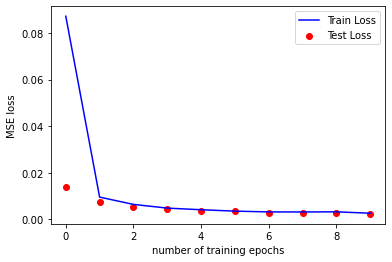

decryption accuracy is 99.97%


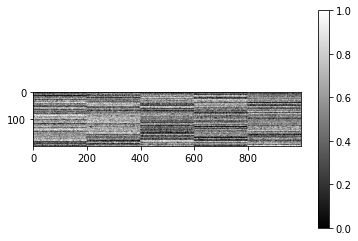

Parameters: 20 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([59, 30, 33,  8, 16, 90,  6, 55, 79,  2,  4,  5, 67, 78, 87, 74,  7, 63,
        92, 59, 89, 88, 31, 46, 35, 87, 82, 63, 29, 86, 27, 70, 40, 42, 30, 17,
        62, 73, 48, 53, 53, 30, 44,  2,  2, 53, 86, 40,  1, 89])
Epoch: 1, Train set: Avg. loss: 0.108063
Test set: Avg. loss: 0.019269
Epoch: 2, Train set: Avg. loss: 0.014568
Test set: Avg. loss: 0.012310
Epoch: 3, Train set: Avg. loss: 0.009896
Test set: Avg. loss: 0.008802
Epoch: 4, Train set: Avg. loss: 0.007952
Test set: Avg. loss: 0.007110
Epoch: 5, Train set: Avg. loss: 0.006961
Test set: Avg. loss: 0.006236
Epoch: 6, Train set: Avg. loss: 0.005943
Test set: Avg. loss: 0.006262
Epoch: 7, Train set: Avg. loss: 0.006153
Test set: Avg. loss: 0.009201
Epoch: 8, Train set: Avg. loss: 0.005299
Test set: Avg. loss: 0.004941
Epoch: 9, Train set: Avg. loss: 0.005331
Test set: Avg. loss: 0.004497
Epoch: 10, Train set: Avg. loss: 0.004668
Test set: Avg. loss: 0.004113


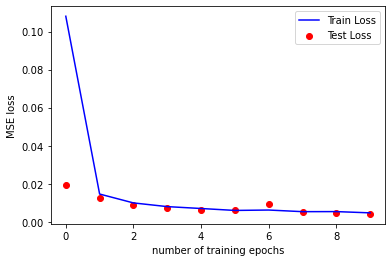

decryption accuracy is 99.94%


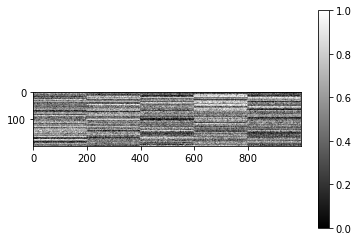

Parameters: 20 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([ 9, 81, 15, 22, 63, 55, 20, 75, 90, 91, 53, 86, 11, 56, 12, 18, 61, 18,
        62, 40, 78, 67, 32, 68,  4, 73, 73, 63, 80, 86, 60, 54, 45, 50, 45, 75,
        76, 70,  3, 35, 28, 34, 36, 57, 79, 63, 40, 88, 44, 89])
Epoch: 1, Train set: Avg. loss: 0.135217
Test set: Avg. loss: 0.028198
Epoch: 2, Train set: Avg. loss: 0.023040
Test set: Avg. loss: 0.018473
Epoch: 3, Train set: Avg. loss: 0.016429
Test set: Avg. loss: 0.013678
Epoch: 4, Train set: Avg. loss: 0.014055
Test set: Avg. loss: 0.011822
Epoch: 5, Train set: Avg. loss: 0.011906
Test set: Avg. loss: 0.009974
Epoch: 6, Train set: Avg. loss: 0.010771
Test set: Avg. loss: 0.012991
Epoch: 7, Train set: Avg. loss: 0.010782
Test set: Avg. loss: 0.022715
Epoch: 8, Train set: Avg. loss: 0.010308
Test set: Avg. loss: 0.007966
Epoch: 9, Train set: Avg. loss: 0.009092
Test set: Avg. loss: 0.016980
Epoch: 10, Train set: Avg. loss: 0.008151
Test set: Avg. loss: 0.009954


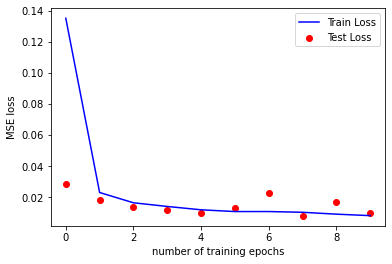

decryption accuracy is 99.76%


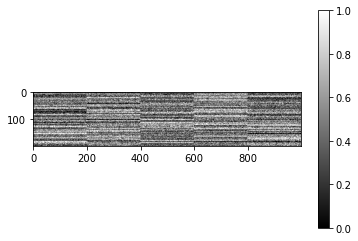

Parameters: 20 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([51, 87, 77, 62, 18, 31, 33, 89, 55, 22, 67, 32, 83, 86,  8, 27, 79, 14,
        50, 72, 11, 68, 59, 92, 35, 69, 28,  0, 71, 69, 86, 72,  9, 47, 87, 40,
        59, 43, 67, 80, 72, 43,  3, 35, 30, 45, 92, 32, 43, 42])
Epoch: 1, Train set: Avg. loss: 0.181630
Test set: Avg. loss: 0.043532
Epoch: 2, Train set: Avg. loss: 0.036006
Test set: Avg. loss: 0.030341
Epoch: 3, Train set: Avg. loss: 0.028790
Test set: Avg. loss: 0.025770
Epoch: 4, Train set: Avg. loss: 0.023834
Test set: Avg. loss: 0.020727
Epoch: 5, Train set: Avg. loss: 0.022714
Test set: Avg. loss: 0.020271
Epoch: 6, Train set: Avg. loss: 0.019531
Test set: Avg. loss: 0.018428
Epoch: 7, Train set: Avg. loss: 0.017637
Test set: Avg. loss: 0.020134
Epoch: 8, Train set: Avg. loss: 0.017197
Test set: Avg. loss: 0.014601
Epoch: 9, Train set: Avg. loss: 0.016668
Test set: Avg. loss: 0.017396
Epoch: 10, Train set: Avg. loss: 0.015839
Test set: Avg. loss: 0.015408


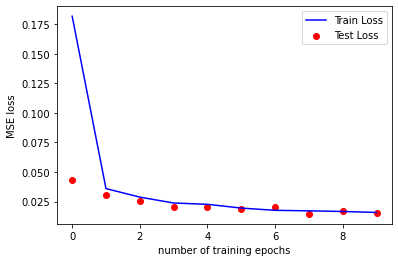

decryption accuracy is 99.68%


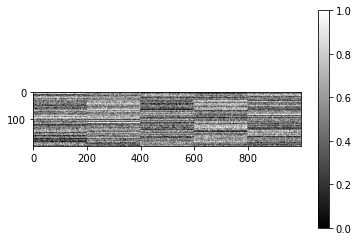

Parameters: 20 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([ 6, 75, 71,  6, 27, 22, 50, 41, 87, 65, 83, 93, 68, 84, 74, 44, 16, 52,
        53, 21, 91, 71,  8, 32, 59, 42, 40, 38, 19, 21, 44, 87, 51, 73, 90, 58,
        11, 34, 14, 56, 43, 82, 50, 46, 29, 50, 85, 23, 18, 20])
Epoch: 1, Train set: Avg. loss: 0.224716
Test set: Avg. loss: 0.061329
Epoch: 2, Train set: Avg. loss: 0.054116
Test set: Avg. loss: 0.042759
Epoch: 3, Train set: Avg. loss: 0.040935
Test set: Avg. loss: 0.038715
Epoch: 4, Train set: Avg. loss: 0.035940
Test set: Avg. loss: 0.038000
Epoch: 5, Train set: Avg. loss: 0.032877
Test set: Avg. loss: 0.033609
Epoch: 6, Train set: Avg. loss: 0.029852
Test set: Avg. loss: 0.029771
Epoch: 7, Train set: Avg. loss: 0.028600
Test set: Avg. loss: 0.028101
Epoch: 8, Train set: Avg. loss: 0.028280
Test set: Avg. loss: 0.026193
Epoch: 9, Train set: Avg. loss: 0.028247
Test set: Avg. loss: 0.023303
Epoch: 10, Train set: Avg. loss: 0.025637
Test set: Avg. loss: 0.024648


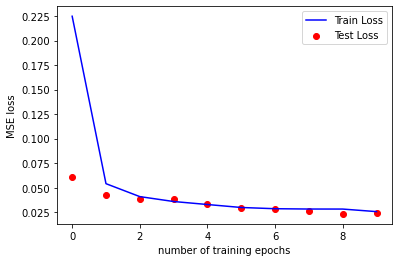

decryption accuracy is 99.24%


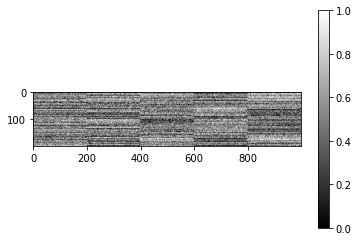

Parameters: 20 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([70, 35, 26, 47, 56, 51, 80, 78, 10, 63, 38, 52, 22, 43, 31, 15, 46, 59,
        13, 45, 85, 74, 29, 41, 78, 39,  3, 73,  3, 86, 78, 18, 12, 30, 37, 89,
        63, 51, 59, 43,  9, 91,  6, 39, 78, 57,  0, 14, 72,  2])
Epoch: 1, Train set: Avg. loss: 0.297379
Test set: Avg. loss: 0.103864
Epoch: 2, Train set: Avg. loss: 0.086648
Test set: Avg. loss: 0.089989
Epoch: 3, Train set: Avg. loss: 0.070455
Test set: Avg. loss: 0.068992
Epoch: 4, Train set: Avg. loss: 0.064667
Test set: Avg. loss: 0.059233
Epoch: 5, Train set: Avg. loss: 0.056890
Test set: Avg. loss: 0.055785
Epoch: 6, Train set: Avg. loss: 0.054497
Test set: Avg. loss: 0.053816
Epoch: 7, Train set: Avg. loss: 0.051484
Test set: Avg. loss: 0.051128
Epoch: 8, Train set: Avg. loss: 0.049852
Test set: Avg. loss: 0.051892
Epoch: 9, Train set: Avg. loss: 0.050931
Test set: Avg. loss: 0.063266
Epoch: 10, Train set: Avg. loss: 0.048469
Test set: Avg. loss: 0.048342


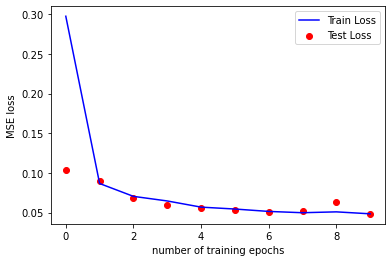

decryption accuracy is 98.73%


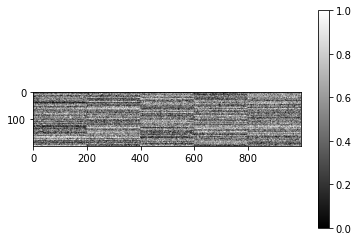

Parameters: 20 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([91, 84, 64, 39, 48, 45, 16, 91, 78, 53, 25,  1, 57, 32, 23, 83, 28, 69,
        85, 61, 92, 68, 87, 44, 86,  6, 23, 32, 93, 19, 17, 29, 60,  1, 50, 32,
        35, 60, 43, 59, 34, 33, 14, 55, 25, 17, 57, 85,  1, 81])
Epoch: 1, Train set: Avg. loss: 0.386113
Test set: Avg. loss: 0.156552
Epoch: 2, Train set: Avg. loss: 0.136353
Test set: Avg. loss: 0.116374
Epoch: 3, Train set: Avg. loss: 0.113497
Test set: Avg. loss: 0.125521
Epoch: 4, Train set: Avg. loss: 0.104509
Test set: Avg. loss: 0.108860
Epoch: 5, Train set: Avg. loss: 0.100158
Test set: Avg. loss: 0.090876
Epoch: 6, Train set: Avg. loss: 0.095791
Test set: Avg. loss: 0.124507
Epoch: 7, Train set: Avg. loss: 0.095213
Test set: Avg. loss: 0.084050
Epoch: 8, Train set: Avg. loss: 0.088281
Test set: Avg. loss: 0.082824
Epoch: 9, Train set: Avg. loss: 0.088210
Test set: Avg. loss: 0.081135
Epoch: 10, Train set: Avg. loss: 0.081185
Test set: Avg. loss: 

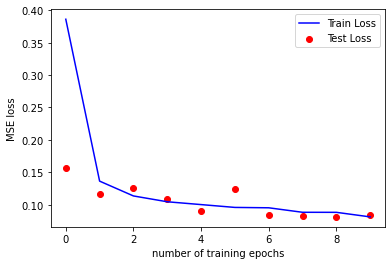

decryption accuracy is 97.04%


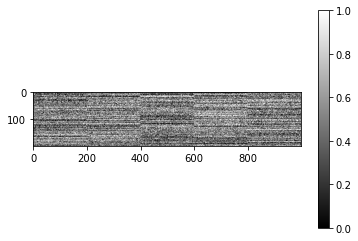

Parameters: 20 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([72, 88, 22, 63, 23, 81, 64, 61, 33, 62, 34,  9,  5, 73, 87, 31, 58, 68,
        44, 80, 52, 53, 47, 89,  8, 18, 74, 15, 18, 56, 38, 34, 81, 15, 29, 75,
        51, 32, 36, 40,  9, 22, 56, 64, 48, 12, 90, 18, 21, 87])
Epoch: 1, Train set: Avg. loss: 0.533978
Test set: Avg. loss: 0.258732
Epoch: 2, Train set: Avg. loss: 0.230002
Test set: Avg. loss: 0.209009
Epoch: 3, Train set: Avg. loss: 0.200737
Test set: Avg. loss: 0.203118
Epoch: 4, Train set: Avg. loss: 0.186903
Test set: Avg. loss: 0.169434
Epoch: 5, Train set: Avg. loss: 0.172748
Test set: Avg. loss: 0.187213
Epoch: 6, Train set: Avg. loss: 0.171387
Test set: Avg. loss: 0.165536
Epoch: 7, Train set: Avg. loss: 0.173213
Test set: Avg. loss: 0.190978
Epoch: 8, Train set: Avg. loss: 0.170972
Test set: Avg. loss: 0.166202
Epoch: 9, Train set: Avg. loss: 0.165590
Test set: Avg. loss: 0.174729
Epoch: 10, Train set: Avg. loss: 0.169493
Test set: Avg. loss: 0.160059


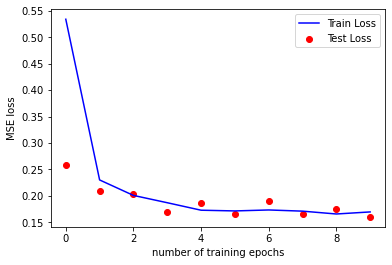

decryption accuracy is 94.14%


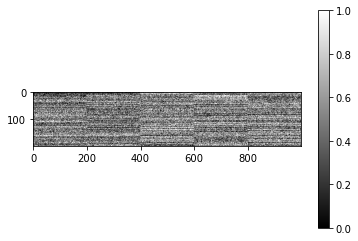

Parameters: 20 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([48, 89, 24, 39,  3, 70, 43, 11,  9, 55,  4, 55, 30, 31, 15, 10, 45,  9,
        35, 20, 22, 81, 82, 82, 54, 84, 54, 30, 71, 72, 92,  7, 90, 59, 69, 46,
        48, 64, 34,  3,  7, 21, 36, 54, 55, 34, 55, 77, 36, 62])
Epoch: 1, Train set: Avg. loss: 0.660715
Test set: Avg. loss: 0.344939
Epoch: 2, Train set: Avg. loss: 0.322830
Test set: Avg. loss: 0.283183
Epoch: 3, Train set: Avg. loss: 0.288356
Test set: Avg. loss: 0.270498
Epoch: 4, Train set: Avg. loss: 0.277251
Test set: Avg. loss: 0.263423
Epoch: 5, Train set: Avg. loss: 0.272024
Test set: Avg. loss: 0.257914
Epoch: 6, Train set: Avg. loss: 0.268966
Test set: Avg. loss: 0.250876
Epoch: 7, Train set: Avg. loss: 0.259068
Test set: Avg. loss: 0.254520
Epoch: 8, Train set: Avg. loss: 0.263558
Test set: Avg. loss: 0.249869
Epoch: 9, Train set: Avg. loss: 0.263825
Test set: Avg. loss: 0.268741
Epoch: 10, Train set: Avg. loss: 0.252340
Test set: Avg. loss: 0.252766


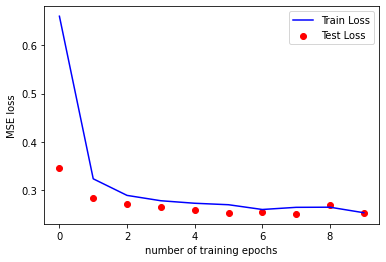

decryption accuracy is 91.61%


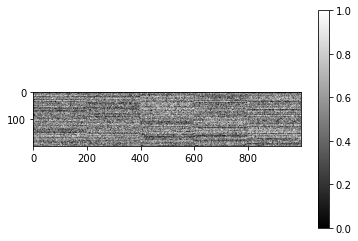

Parameters: 20 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([38, 40, 48, 89, 32, 50, 84, 15, 42, 93,  1, 10, 86, 60, 50, 93,  2,  6,
        66, 30, 11, 55, 37, 53, 40, 16, 15, 74, 55, 72, 72, 58, 92, 77, 46, 58,
        61, 48,  0, 47, 28,  3, 63, 20, 66, 30, 68, 71, 21, 47])
Epoch: 1, Train set: Avg. loss: 0.819485
Test set: Avg. loss: 0.499151
Epoch: 2, Train set: Avg. loss: 0.457756
Test set: Avg. loss: 0.452958
Epoch: 3, Train set: Avg. loss: 0.421279
Test set: Avg. loss: 0.401122
Epoch: 4, Train set: Avg. loss: 0.415647
Test set: Avg. loss: 0.400146
Epoch: 5, Train set: Avg. loss: 0.408623
Test set: Avg. loss: 0.389384
Epoch: 6, Train set: Avg. loss: 0.405573
Test set: Avg. loss: 0.386894
Epoch: 7, Train set: Avg. loss: 0.399214
Test set: Avg. loss: 0.386953
Epoch: 8, Train set: Avg. loss: 0.391141
Test set: Avg. loss: 0.382695
Epoch: 9, Train set: Avg. loss: 0.402678
Test set: Avg. loss: 0.382500
Epoch: 10, Train set: Avg. loss: 0.395714
Test set: Avg. loss: 0.373322


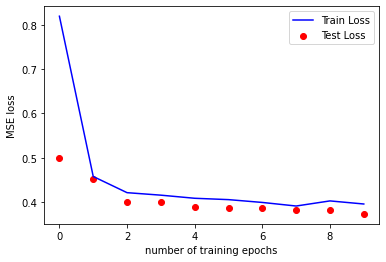

decryption accuracy is 87.76%


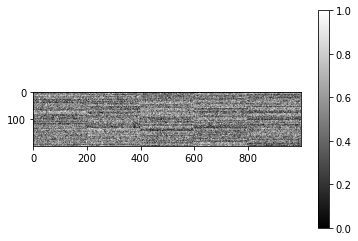

Parameters: 20 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([73, 56, 59, 23, 31, 74, 20, 71, 54, 72, 65, 79,  8, 65, 86, 71, 83, 87,
        25,  8, 58,  1, 81, 71,  4, 89,  6, 79, 28,  6,  0, 26, 14, 39, 86, 64,
        46, 81, 90, 86, 15, 75,  8, 69, 70, 66, 45, 12, 72, 16])
Epoch: 1, Train set: Avg. loss: 1.073192
Test set: Avg. loss: 0.687397
Epoch: 2, Train set: Avg. loss: 0.690644
Test set: Avg. loss: 0.685548
Epoch: 3, Train set: Avg. loss: 0.664656
Test set: Avg. loss: 0.710254
Epoch: 4, Train set: Avg. loss: 0.645046
Test set: Avg. loss: 0.641555
Epoch: 5, Train set: Avg. loss: 0.647483
Test set: Avg. loss: 0.649372
Epoch: 6, Train set: Avg. loss: 0.633315
Test set: Avg. loss: 0.619912
Epoch: 7, Train set: Avg. loss: 0.646175
Test set: Avg. loss: 0.691581
Epoch: 8, Train set: Avg. loss: 0.653349
Test set: Avg. loss: 0.679310
Epoch: 9, Train set: Avg. loss: 0.652929
Test set: Avg. loss: 0.700512
Epoch: 10, Train set: Avg. loss: 0.657182
Test set: Avg. loss: 0.685527


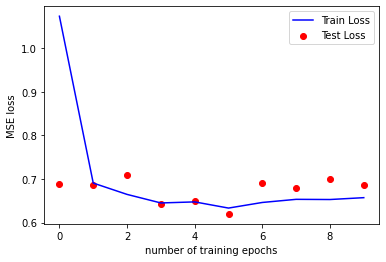

decryption accuracy is 79.04%


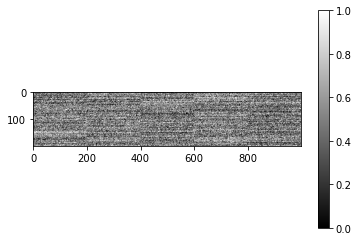

Parameters: 20 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([63, 76, 31,  6, 25, 64,  0, 23, 47,  4, 16, 91,  8, 57, 15, 47, 66, 21,
        90, 22, 29, 14, 10, 26, 17,  4, 16, 68, 85, 31, 18, 57, 57, 89, 35,  5,
        21,  0, 75, 69, 88, 16, 15, 30, 77, 57, 26, 40, 37, 32])
Epoch: 1, Train set: Avg. loss: 1.307305
Test set: Avg. loss: 0.978445
Epoch: 2, Train set: Avg. loss: 0.938166
Test set: Avg. loss: 0.920267
Epoch: 3, Train set: Avg. loss: 0.924522
Test set: Avg. loss: 0.882538
Epoch: 4, Train set: Avg. loss: 0.914381
Test set: Avg. loss: 0.889176
Epoch: 5, Train set: Avg. loss: 0.916357
Test set: Avg. loss: 0.925536
Epoch: 6, Train set: Avg. loss: 0.922965
Test set: Avg. loss: 0.925883
Epoch: 7, Train set: Avg. loss: 0.923267
Test set: Avg. loss: 0.905271
Epoch: 8, Train set: Avg. loss: 0.922108
Test set: Avg. loss: 0.910738
Epoch: 9, Train set: Avg. loss: 0.937484
Test set: Avg. loss: 0.919257
Epoch: 10, Train set: Avg. loss: 0.953724
Test set: Avg. loss: 0.895526


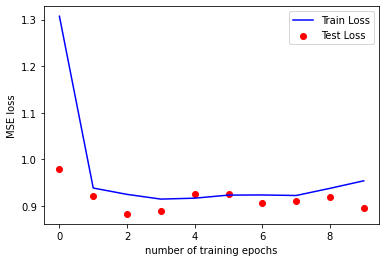

decryption accuracy is 74.6%


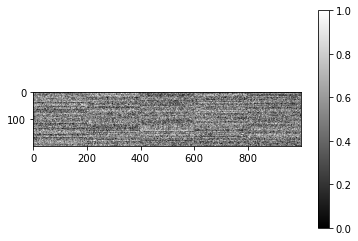

Parameters: 20 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([ 2, 13, 24, 50,  3, 27, 63, 51, 43,  2, 31, 15, 86, 31, 64, 24, 51,  3,
        38, 29, 29, 70, 16, 11, 86, 37, 79, 80, 78, 51, 25,  8, 73, 72, 87, 42,
        84, 58, 64, 89, 18, 35, 12, 53,  8, 59, 64, 86, 68, 59])
Epoch: 1, Train set: Avg. loss: 1.626877
Test set: Avg. loss: 1.373310
Epoch: 2, Train set: Avg. loss: 1.286051
Test set: Avg. loss: 1.330964
Epoch: 3, Train set: Avg. loss: 1.253772
Test set: Avg. loss: 1.291807
Epoch: 4, Train set: Avg. loss: 1.283808
Test set: Avg. loss: 1.348030
Epoch: 5, Train set: Avg. loss: 1.286650
Test set: Avg. loss: 1.278306
Epoch: 6, Train set: Avg. loss: 1.289295
Test set: Avg. loss: 1.352461
Epoch: 7, Train set: Avg. loss: 1.284971
Test set: Avg. loss: 1.370685
Epoch: 8, Train set: Avg. loss: 1.282865
Test set: Avg. loss: 1.270060
Epoch: 9, Train set: Avg. loss: 1.288765
Test set: Avg. loss: 1.331423
Epoch: 10, Train set: Avg. loss: 1.304289
Test set: Avg. loss: 1.326156


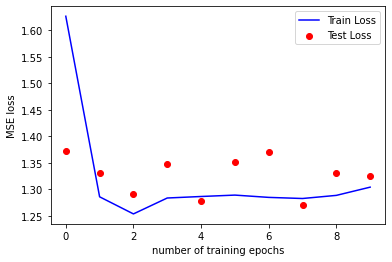

decryption accuracy is 64.32%


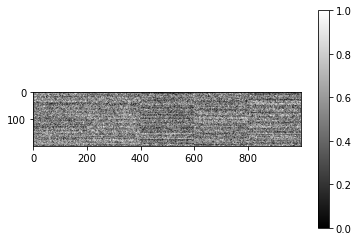

Parameters: 20 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([63, 60, 15, 31, 54, 83, 90,  2, 82,  4, 13, 73, 19, 64, 11, 71, 31, 52,
         0, 78, 27,  0, 93, 48,  9, 31, 34, 13,  5, 77, 70,  4, 87, 15, 61, 61,
        83, 24, 88, 10, 22, 76, 54, 23, 35, 86, 21, 25, 19, 56])
Epoch: 1, Train set: Avg. loss: 1.781703
Test set: Avg. loss: 1.456103
Epoch: 2, Train set: Avg. loss: 1.449993
Test set: Avg. loss: 1.382905
Epoch: 3, Train set: Avg. loss: 1.468530
Test set: Avg. loss: 1.491676
Epoch: 4, Train set: Avg. loss: 1.479430
Test set: Avg. loss: 1.445840
Epoch: 5, Train set: Avg. loss: 1.486285
Test set: Avg. loss: 1.530318
Epoch: 6, Train set: Avg. loss: 1.479419
Test set: Avg. loss: 1.493436
Epoch: 7, Train set: Avg. loss: 1.490161
Test set: Avg. loss: 1.456100
Epoch: 8, Train set: Avg. loss: 1.485362
Test set: Avg. loss: 1.477178
Epoch: 9, Train set: Avg. loss: 1.497495
Test set: Avg. loss: 1.508355
Epoch: 10, Train set: Avg. loss: 1.516669
Test set: Avg. loss: 1

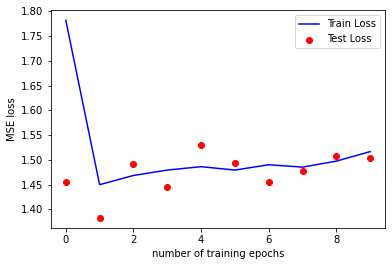

decryption accuracy is 60.0%


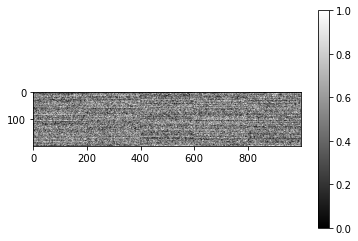

Parameters: 25 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([88, 82, 26,  7, 58, 70, 85, 10, 70,  8, 89, 56, 46, 92, 47, 82, 83, 64,
        77, 42, 58, 57, 47, 59, 76, 17, 79, 43, 11, 57, 55, 37,  7,  4, 61, 79,
        91, 78, 68, 16, 11,  8, 21, 42, 50,  1, 84, 61, 33, 92])
Epoch: 1, Train set: Avg. loss: 0.071833
Test set: Avg. loss: 0.008709
Epoch: 2, Train set: Avg. loss: 0.006375
Test set: Avg. loss: 0.005198
Epoch: 3, Train set: Avg. loss: 0.004224
Test set: Avg. loss: 0.004074
Epoch: 4, Train set: Avg. loss: 0.003385
Test set: Avg. loss: 0.003042
Epoch: 5, Train set: Avg. loss: 0.002688
Test set: Avg. loss: 0.002388
Epoch: 6, Train set: Avg. loss: 0.002506
Test set: Avg. loss: 0.002102
Epoch: 7, Train set: Avg. loss: 0.002357
Test set: Avg. loss: 0.001871
Epoch: 8, Train set: Avg. loss: 0.001763
Test set: Avg. loss: 0.001756
Epoch: 9, Train set: Avg. loss: 0.001767
Test set: Avg. loss: 0.001547
Epoch: 10, Train set: Avg. loss: 0.001653
Test set: Avg. loss: 0.001507


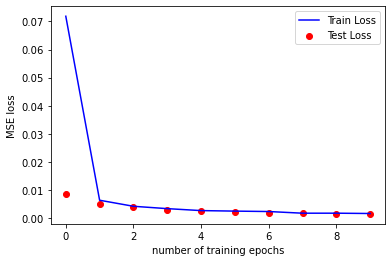

decryption accuracy is 99.99%


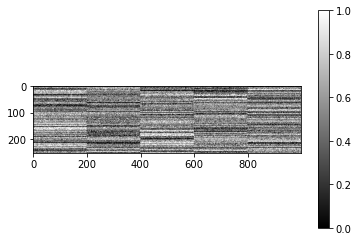

Parameters: 25 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([55, 38, 43, 34, 59, 10, 34, 75, 84, 40, 36, 59, 32, 13, 33, 91, 27, 93,
        28, 40, 25, 29, 62, 52, 15, 84, 83, 66, 14, 37, 28, 56, 43, 62, 67, 39,
        60, 91,  7, 68, 42, 63,  4, 29, 76, 32,  5, 52,  5, 35])
Epoch: 1, Train set: Avg. loss: 0.087264
Test set: Avg. loss: 0.013490
Epoch: 2, Train set: Avg. loss: 0.010120
Test set: Avg. loss: 0.008616
Epoch: 3, Train set: Avg. loss: 0.006644
Test set: Avg. loss: 0.005668
Epoch: 4, Train set: Avg. loss: 0.005041
Test set: Avg. loss: 0.004273
Epoch: 5, Train set: Avg. loss: 0.004118
Test set: Avg. loss: 0.003918
Epoch: 6, Train set: Avg. loss: 0.004195
Test set: Avg. loss: 0.004935
Epoch: 7, Train set: Avg. loss: 0.003600
Test set: Avg. loss: 0.003004
Epoch: 8, Train set: Avg. loss: 0.003407
Test set: Avg. loss: 0.003049
Epoch: 9, Train set: Avg. loss: 0.002897
Test set: Avg. loss: 0.002665
Epoch: 10, Train set: Avg. loss: 0.002624
Test set: Avg. loss: 0.002719


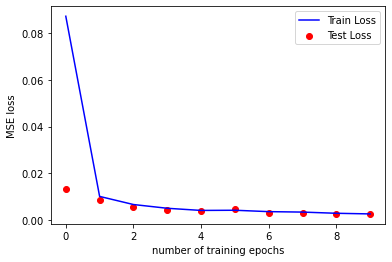

decryption accuracy is 99.96%


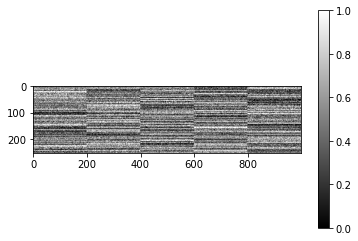

Parameters: 25 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([60, 86, 71, 27, 10, 28,  9, 43, 37, 93, 69, 26, 92,  8, 47, 45, 91, 15,
        14, 89,  3, 73, 40, 85, 83, 44, 69, 20, 23, 59, 58, 65, 68, 71, 13, 14,
        29, 53, 44, 80, 10, 68,  7, 16, 79, 27, 87, 68, 11, 61])
Epoch: 1, Train set: Avg. loss: 0.106967
Test set: Avg. loss: 0.017197
Epoch: 2, Train set: Avg. loss: 0.014122
Test set: Avg. loss: 0.010566
Epoch: 3, Train set: Avg. loss: 0.009417
Test set: Avg. loss: 0.015206
Epoch: 4, Train set: Avg. loss: 0.007429
Test set: Avg. loss: 0.007665
Epoch: 5, Train set: Avg. loss: 0.006383
Test set: Avg. loss: 0.006235
Epoch: 6, Train set: Avg. loss: 0.005707
Test set: Avg. loss: 0.005329
Epoch: 7, Train set: Avg. loss: 0.004811
Test set: Avg. loss: 0.004685
Epoch: 8, Train set: Avg. loss: 0.005787
Test set: Avg. loss: 0.004898
Epoch: 9, Train set: Avg. loss: 0.005208
Test set: Avg. loss: 0.005022
Epoch: 10, Train set: Avg. loss: 0.004021
Test set: Avg. loss: 0.003963


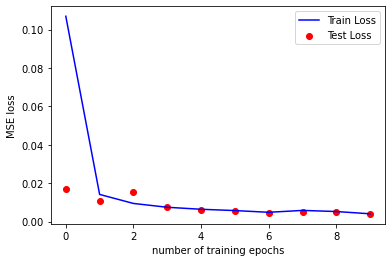

decryption accuracy is 99.96%


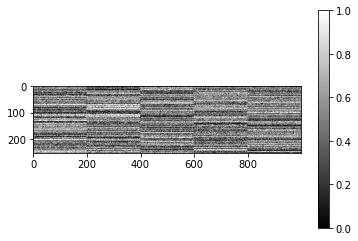

Parameters: 25 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([ 8, 31,  4, 28, 24, 45, 67, 70, 29, 20, 62, 47,  4,  7, 31, 50, 34, 90,
        86, 55, 63, 77, 59, 81, 51, 26, 84, 33, 75, 85, 56, 53, 89, 41, 32, 87,
        83, 17, 71, 66, 43, 60, 93, 28, 82, 12, 85, 91, 90, 63])
Epoch: 1, Train set: Avg. loss: 0.136451
Test set: Avg. loss: 0.027754
Epoch: 2, Train set: Avg. loss: 0.021693
Test set: Avg. loss: 0.019142
Epoch: 3, Train set: Avg. loss: 0.016582
Test set: Avg. loss: 0.012590
Epoch: 4, Train set: Avg. loss: 0.013057
Test set: Avg. loss: 0.010302
Epoch: 5, Train set: Avg. loss: 0.011003
Test set: Avg. loss: 0.010272
Epoch: 6, Train set: Avg. loss: 0.010143
Test set: Avg. loss: 0.009133
Epoch: 7, Train set: Avg. loss: 0.009457
Test set: Avg. loss: 0.008897
Epoch: 8, Train set: Avg. loss: 0.008121
Test set: Avg. loss: 0.007750
Epoch: 9, Train set: Avg. loss: 0.008371
Test set: Avg. loss: 0.007613
Epoch: 10, Train set: Avg. loss: 0.008573
Test set: Avg. loss: 0.008983


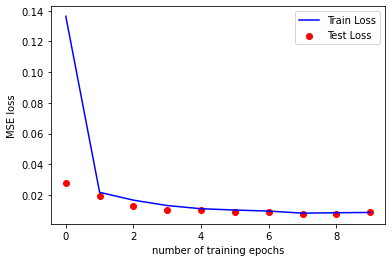

decryption accuracy is 99.91%


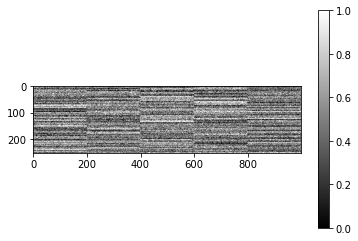

Parameters: 25 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([72, 77, 73, 83, 64, 91, 19, 23, 71, 82, 92,  4,  5, 44,  1, 83, 68, 75,
        51,  3, 30, 45, 38, 79, 65,  8, 54,  1, 71, 53, 81, 92, 81, 55,  0,  7,
        85, 87, 77, 66, 45, 21, 19, 13, 55, 57, 63, 30, 71, 91])
Epoch: 1, Train set: Avg. loss: 0.175423
Test set: Avg. loss: 0.041167
Epoch: 2, Train set: Avg. loss: 0.036851
Test set: Avg. loss: 0.030020
Epoch: 3, Train set: Avg. loss: 0.028175
Test set: Avg. loss: 0.022710
Epoch: 4, Train set: Avg. loss: 0.023173
Test set: Avg. loss: 0.022264
Epoch: 5, Train set: Avg. loss: 0.020473
Test set: Avg. loss: 0.018874
Epoch: 6, Train set: Avg. loss: 0.019853
Test set: Avg. loss: 0.017383
Epoch: 7, Train set: Avg. loss: 0.017935
Test set: Avg. loss: 0.015567
Epoch: 8, Train set: Avg. loss: 0.018118
Test set: Avg. loss: 0.016497
Epoch: 9, Train set: Avg. loss: 0.018357
Test set: Avg. loss: 0.015402
Epoch: 10, Train set: Avg. loss: 0.017788
Test set: Avg. loss: 0.025633


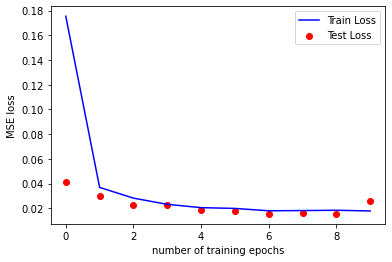

decryption accuracy is 99.34%


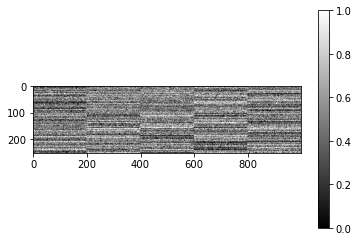

Parameters: 25 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([90, 22, 48, 28, 79, 79, 53, 40, 41, 24, 62, 18, 24, 16, 37, 10, 86, 83,
        35, 45, 32, 19, 87, 21, 33, 69, 88,  3, 78, 30,  6, 64, 76, 26, 53, 14,
        74, 14, 55, 36, 93, 77, 54,  7, 53, 88, 10, 32, 40, 79])
Epoch: 1, Train set: Avg. loss: 0.230286
Test set: Avg. loss: 0.062396
Epoch: 2, Train set: Avg. loss: 0.056660
Test set: Avg. loss: 0.077580
Epoch: 3, Train set: Avg. loss: 0.044624
Test set: Avg. loss: 0.038352
Epoch: 4, Train set: Avg. loss: 0.037273
Test set: Avg. loss: 0.032864
Epoch: 5, Train set: Avg. loss: 0.033773
Test set: Avg. loss: 0.029688
Epoch: 6, Train set: Avg. loss: 0.032072
Test set: Avg. loss: 0.029220
Epoch: 7, Train set: Avg. loss: 0.033831
Test set: Avg. loss: 0.034980
Epoch: 8, Train set: Avg. loss: 0.028949
Test set: Avg. loss: 0.027125
Epoch: 9, Train set: Avg. loss: 0.029484
Test set: Avg. loss: 0.027610
Epoch: 10, Train set: Avg. loss: 0.028000
Test set: Avg. loss: 0.036370


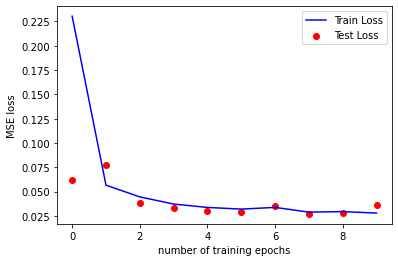

decryption accuracy is 98.87%


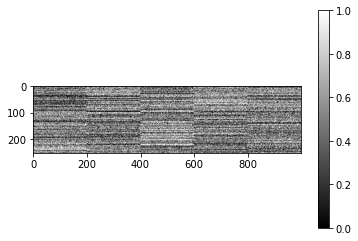

Parameters: 25 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([63, 28,  1, 87, 35, 46, 20, 43, 62, 29, 30, 47, 51, 45, 74, 87, 91, 71,
        21, 30, 78, 50, 71, 77, 40,  6, 20, 53, 36, 89, 39, 77, 21, 40,  1, 85,
        38, 37, 15, 15, 36, 44, 22, 31, 18, 74, 32, 90, 53, 56])
Epoch: 1, Train set: Avg. loss: 0.315634
Test set: Avg. loss: 0.132985
Epoch: 2, Train set: Avg. loss: 0.097274
Test set: Avg. loss: 0.086168
Epoch: 3, Train set: Avg. loss: 0.080597
Test set: Avg. loss: 0.092943
Epoch: 4, Train set: Avg. loss: 0.069296
Test set: Avg. loss: 0.062130
Epoch: 5, Train set: Avg. loss: 0.065683
Test set: Avg. loss: 0.060802
Epoch: 6, Train set: Avg. loss: 0.064739
Test set: Avg. loss: 0.062014
Epoch: 7, Train set: Avg. loss: 0.061435
Test set: Avg. loss: 0.064872
Epoch: 8, Train set: Avg. loss: 0.060483
Test set: Avg. loss: 0.055574
Epoch: 9, Train set: Avg. loss: 0.059410
Test set: Avg. loss: 0.057887
Epoch: 10, Train set: Avg. loss: 0.057121
Test set: Avg. loss: 

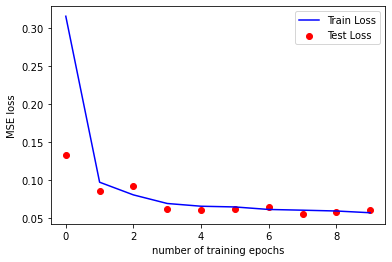

decryption accuracy is 98.28%


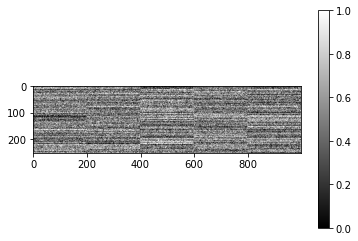

Parameters: 25 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([66, 66, 68, 37, 70, 71, 87, 91, 29, 29, 55, 31,  8, 45,  7, 45, 12, 84,
        19, 82, 33, 17,  3, 14, 80, 34, 35, 51, 72, 17, 24, 64, 66,  5, 80, 35,
        74, 92, 29, 42, 79, 52, 87,  5, 35, 77,  1, 50, 18, 28])
Epoch: 1, Train set: Avg. loss: 0.394275
Test set: Avg. loss: 0.164806
Epoch: 2, Train set: Avg. loss: 0.141816
Test set: Avg. loss: 0.112931
Epoch: 3, Train set: Avg. loss: 0.115657
Test set: Avg. loss: 0.132062
Epoch: 4, Train set: Avg. loss: 0.113310
Test set: Avg. loss: 0.101232
Epoch: 5, Train set: Avg. loss: 0.105499
Test set: Avg. loss: 0.110591
Epoch: 6, Train set: Avg. loss: 0.103274
Test set: Avg. loss: 0.096537
Epoch: 7, Train set: Avg. loss: 0.097590
Test set: Avg. loss: 0.094100
Epoch: 8, Train set: Avg. loss: 0.096811
Test set: Avg. loss: 0.110319
Epoch: 9, Train set: Avg. loss: 0.091841
Test set: Avg. loss: 0.092653
Epoch: 10, Train set: Avg. loss: 0.097717
Test set: Avg. loss: 0.091825


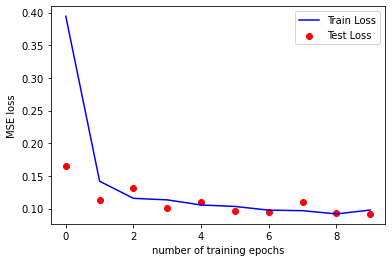

decryption accuracy is 96.92%


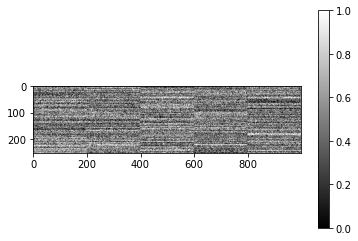

Parameters: 25 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([42,  2, 88,  4,  4,  1, 71, 32,  9, 18,  0, 87, 57, 93, 88, 53,  8, 52,
        11, 42, 26,  2, 66, 18, 86,  5, 32, 38, 47,  7,  5, 72, 37, 14, 64, 71,
        35, 54, 51, 70, 18, 23, 46, 50, 38, 81, 14, 86, 55, 66])
Epoch: 1, Train set: Avg. loss: 0.527331
Test set: Avg. loss: 0.281390
Epoch: 2, Train set: Avg. loss: 0.233988
Test set: Avg. loss: 0.244968
Epoch: 3, Train set: Avg. loss: 0.200287
Test set: Avg. loss: 0.169350
Epoch: 4, Train set: Avg. loss: 0.181719
Test set: Avg. loss: 0.177830
Epoch: 5, Train set: Avg. loss: 0.172124
Test set: Avg. loss: 0.173457
Epoch: 6, Train set: Avg. loss: 0.174998
Test set: Avg. loss: 0.184873
Epoch: 7, Train set: Avg. loss: 0.171397
Test set: Avg. loss: 0.160082
Epoch: 8, Train set: Avg. loss: 0.172880
Test set: Avg. loss: 0.162791
Epoch: 9, Train set: Avg. loss: 0.171007
Test set: Avg. loss: 0.175591
Epoch: 10, Train set: Avg. loss: 0.161934
Test set: Avg. loss: 0.159413


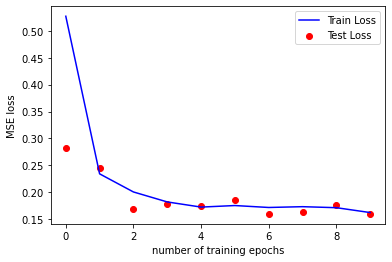

decryption accuracy is 94.45%


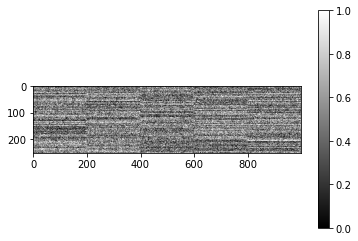

Parameters: 25 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([64, 77, 37, 41, 77, 10, 41, 20, 36, 23, 46, 16, 59, 69, 41, 15, 64, 37,
        33, 67, 22,  2,  3, 40, 24, 59,  6, 74,  9,  7, 20, 12,  1, 88, 34, 86,
        67,  3, 62,  4, 61, 24,  5, 74, 79, 59, 66,  0, 85, 83])
Epoch: 1, Train set: Avg. loss: 0.702173
Test set: Avg. loss: 0.402768
Epoch: 2, Train set: Avg. loss: 0.358184
Test set: Avg. loss: 0.433516
Epoch: 3, Train set: Avg. loss: 0.322986
Test set: Avg. loss: 0.322341
Epoch: 4, Train set: Avg. loss: 0.309050
Test set: Avg. loss: 0.328422
Epoch: 5, Train set: Avg. loss: 0.307485
Test set: Avg. loss: 0.289312
Epoch: 6, Train set: Avg. loss: 0.300619
Test set: Avg. loss: 0.287761
Epoch: 7, Train set: Avg. loss: 0.301046
Test set: Avg. loss: 0.287367
Epoch: 8, Train set: Avg. loss: 0.294364
Test set: Avg. loss: 0.297931
Epoch: 9, Train set: Avg. loss: 0.296677
Test set: Avg. loss: 0.298244
Epoch: 10, Train set: Avg. loss: 0.289349
Test set: Avg. loss: 0.302733


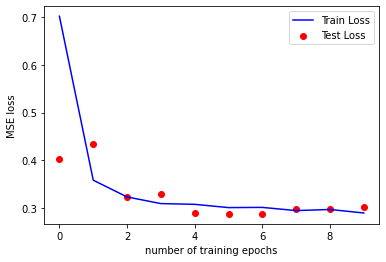

decryption accuracy is 90.09%


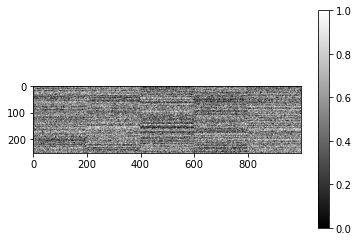

Parameters: 25 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([11, 31, 75, 12, 35, 16,  0, 62, 90, 27, 74, 53, 79,  8, 46, 18, 17, 37,
        84, 75, 36, 42, 25, 82, 55, 20, 23, 14, 85, 55, 69, 93,  5, 67, 82, 22,
        84, 29, 44, 91, 51, 92, 73, 34, 53, 64, 15, 61, 56,  4])
Epoch: 1, Train set: Avg. loss: 0.846199
Test set: Avg. loss: 0.506004
Epoch: 2, Train set: Avg. loss: 0.482819
Test set: Avg. loss: 0.435339
Epoch: 3, Train set: Avg. loss: 0.446854
Test set: Avg. loss: 0.477769
Epoch: 4, Train set: Avg. loss: 0.430418
Test set: Avg. loss: 0.439422
Epoch: 5, Train set: Avg. loss: 0.423684
Test set: Avg. loss: 0.415179
Epoch: 6, Train set: Avg. loss: 0.416297
Test set: Avg. loss: 0.458912
Epoch: 7, Train set: Avg. loss: 0.417694
Test set: Avg. loss: 0.391202
Epoch: 8, Train set: Avg. loss: 0.412927
Test set: Avg. loss: 0.439573
Epoch: 9, Train set: Avg. loss: 0.411665
Test set: Avg. loss: 0.383217
Epoch: 10, Train set: Avg. loss: 0.420101
Test set: Avg. loss: 0.408985


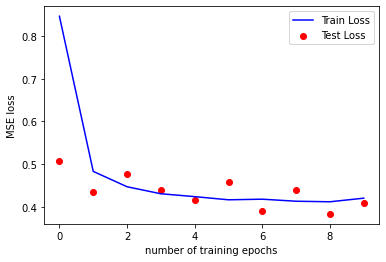

decryption accuracy is 87.3%


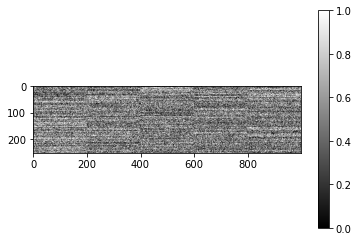

Parameters: 25 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([73, 52, 70, 84, 43, 64, 92, 67, 19, 58, 28, 43, 74, 68, 41, 78, 12, 69,
        82, 82, 69, 69, 85, 89, 35, 68, 30, 26,  3, 71, 55, 89, 23, 53, 59, 36,
        21, 44, 90, 19, 21, 87, 12, 46, 87, 74, 60, 23, 13, 59])
Epoch: 1, Train set: Avg. loss: 1.097186
Test set: Avg. loss: 0.728894
Epoch: 2, Train set: Avg. loss: 0.717943
Test set: Avg. loss: 0.720736
Epoch: 3, Train set: Avg. loss: 0.687229
Test set: Avg. loss: 0.670248
Epoch: 4, Train set: Avg. loss: 0.674128
Test set: Avg. loss: 0.663375
Epoch: 5, Train set: Avg. loss: 0.665821
Test set: Avg. loss: 0.701524
Epoch: 6, Train set: Avg. loss: 0.673043
Test set: Avg. loss: 0.679312
Epoch: 7, Train set: Avg. loss: 0.665186
Test set: Avg. loss: 0.656357
Epoch: 8, Train set: Avg. loss: 0.671211
Test set: Avg. loss: 0.640418
Epoch: 9, Train set: Avg. loss: 0.681452
Test set: Avg. loss: 0.692958
Epoch: 10, Train set: Avg. loss: 0.671369
Test set: Avg. loss: 0.668838


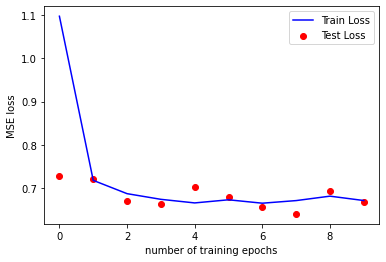

decryption accuracy is 80.67%


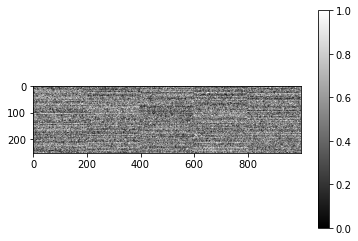

Parameters: 25 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([33, 50, 74, 29, 45, 81, 32, 59, 78, 63, 64, 73, 53, 15, 75, 77,  5, 25,
         3, 85, 80,  2, 18, 92, 11, 68, 26, 26, 14, 69,  8, 38, 80, 44, 20, 88,
        76,  3, 15, 18, 68, 77, 25,  3, 17,  4, 41, 67,  7, 35])
Epoch: 1, Train set: Avg. loss: 1.338487
Test set: Avg. loss: 0.953949
Epoch: 2, Train set: Avg. loss: 0.955348
Test set: Avg. loss: 0.975143
Epoch: 3, Train set: Avg. loss: 0.942757
Test set: Avg. loss: 0.977085
Epoch: 4, Train set: Avg. loss: 0.933197
Test set: Avg. loss: 0.979894
Epoch: 5, Train set: Avg. loss: 0.906727
Test set: Avg. loss: 0.898267
Epoch: 6, Train set: Avg. loss: 0.937491
Test set: Avg. loss: 0.900714
Epoch: 7, Train set: Avg. loss: 0.925789
Test set: Avg. loss: 0.955012
Epoch: 8, Train set: Avg. loss: 0.932298
Test set: Avg. loss: 1.003976
Epoch: 9, Train set: Avg. loss: 0.950644
Test set: Avg. loss: 0.983235
Epoch: 10, Train set: Avg. loss: 0.949296
Test set: Avg. loss: 0.944740


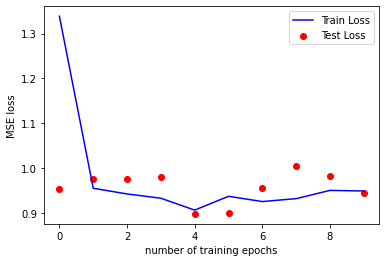

decryption accuracy is 73.81%


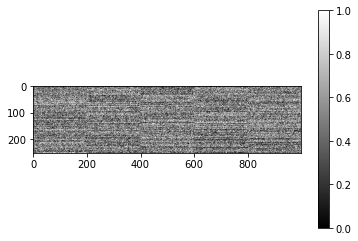

Parameters: 25 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([70, 63,  1, 29, 22,  9, 83, 85, 80, 64,  8, 93, 77, 62, 57, 24, 93, 16,
        19, 83, 20, 26, 50, 70, 35, 76, 35, 51, 91, 31, 85,  7, 57, 76, 51, 54,
        48, 23, 90, 74, 61, 85,  5, 35, 92, 61, 58, 66, 49, 58])
Epoch: 1, Train set: Avg. loss: 1.519451
Test set: Avg. loss: 1.254288
Epoch: 2, Train set: Avg. loss: 1.170475
Test set: Avg. loss: 1.246365
Epoch: 3, Train set: Avg. loss: 1.155871
Test set: Avg. loss: 1.187384
Epoch: 4, Train set: Avg. loss: 1.163340
Test set: Avg. loss: 1.112196
Epoch: 5, Train set: Avg. loss: 1.165329
Test set: Avg. loss: 1.149225
Epoch: 6, Train set: Avg. loss: 1.183450
Test set: Avg. loss: 1.260322
Epoch: 7, Train set: Avg. loss: 1.183058
Test set: Avg. loss: 1.172722
Epoch: 8, Train set: Avg. loss: 1.163489
Test set: Avg. loss: 1.214296
Epoch: 9, Train set: Avg. loss: 1.207468
Test set: Avg. loss: 1.159193
Epoch: 10, Train set: Avg. loss: 1.199262
Test set: Avg. loss: 1

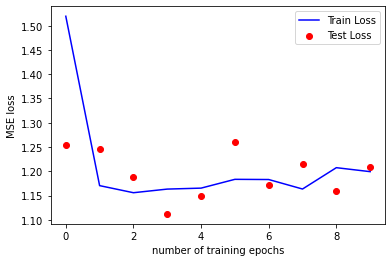

decryption accuracy is 68.2%


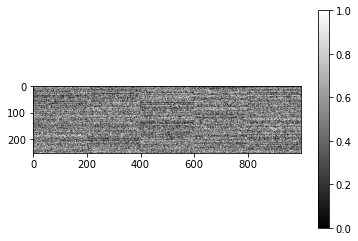

Parameters: 30 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([40, 77, 13, 14, 71, 81,  2,  4, 65,  5, 80,  0, 32, 58, 77, 22, 56, 82,
        38, 62, 20, 18,  0, 53, 37, 44, 21, 58, 71, 23, 84, 75,  1, 56, 10, 77,
        36, 37, 37, 64,  4, 13, 89, 35, 72,  0, 37, 55, 57, 80])
Epoch: 1, Train set: Avg. loss: 0.060681
Test set: Avg. loss: 0.006629
Epoch: 2, Train set: Avg. loss: 0.005156
Test set: Avg. loss: 0.003789
Epoch: 3, Train set: Avg. loss: 0.003201
Test set: Avg. loss: 0.002555
Epoch: 4, Train set: Avg. loss: 0.002412
Test set: Avg. loss: 0.002145
Epoch: 5, Train set: Avg. loss: 0.002064
Test set: Avg. loss: 0.001748
Epoch: 6, Train set: Avg. loss: 0.001815
Test set: Avg. loss: 0.001592
Epoch: 7, Train set: Avg. loss: 0.001449
Test set: Avg. loss: 0.001413
Epoch: 8, Train set: Avg. loss: 0.001448
Test set: Avg. loss: 0.001319
Epoch: 9, Train set: Avg. loss: 0.001217
Test set: Avg. loss: 0.001139
Epoch: 10, Train set: Avg. loss: 0.001149
Test set: Avg. loss: 0.001051


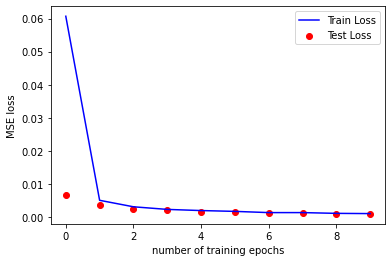

decryption accuracy is 100.0%


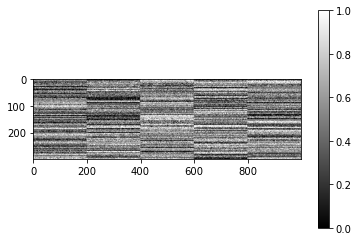

Parameters: 30 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([40, 62, 30, 18, 66, 70, 22, 71, 67, 70, 88, 16, 73,  9, 61, 44, 81, 61,
        49, 48,  4, 59, 31, 89, 21, 25, 42, 86, 66, 12, 25, 71, 21, 71, 77, 91,
        11, 83, 29, 80, 76, 41, 74, 76,  8, 56, 36, 21, 72, 45])
Epoch: 1, Train set: Avg. loss: 0.074366
Test set: Avg. loss: 0.009524
Epoch: 2, Train set: Avg. loss: 0.007284
Test set: Avg. loss: 0.005116
Epoch: 3, Train set: Avg. loss: 0.004711
Test set: Avg. loss: 0.003856
Epoch: 4, Train set: Avg. loss: 0.003379
Test set: Avg. loss: 0.002822
Epoch: 5, Train set: Avg. loss: 0.002859
Test set: Avg. loss: 0.003027
Epoch: 6, Train set: Avg. loss: 0.002583
Test set: Avg. loss: 0.002192
Epoch: 7, Train set: Avg. loss: 0.002090
Test set: Avg. loss: 0.002143
Epoch: 8, Train set: Avg. loss: 0.001965
Test set: Avg. loss: 0.003099
Epoch: 9, Train set: Avg. loss: 0.001979
Test set: Avg. loss: 0.001550
Epoch: 10, Train set: Avg. loss: 0.001664
Test set: Avg. loss: 0.001680


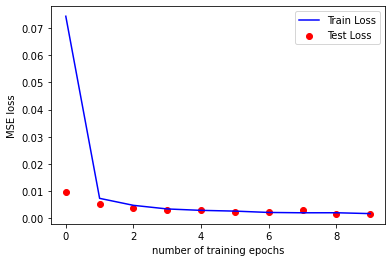

decryption accuracy is 100.0%


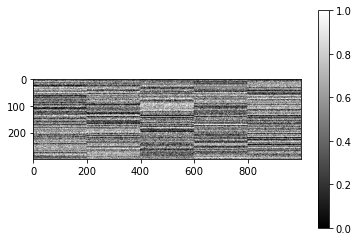

Parameters: 30 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([37, 87, 66,  9, 62, 41, 74, 93, 58, 85, 80, 40, 48, 93, 42, 82, 51,  7,
        16, 78, 60, 53, 37, 53,  5, 65, 59, 63, 68, 24, 81, 34, 28, 76, 32, 33,
        40, 15, 86, 58, 64, 76, 16, 85, 42, 19, 34, 17, 72, 68])
Epoch: 1, Train set: Avg. loss: 0.091690
Test set: Avg. loss: 0.014235
Epoch: 2, Train set: Avg. loss: 0.010395
Test set: Avg. loss: 0.007637
Epoch: 3, Train set: Avg. loss: 0.006733
Test set: Avg. loss: 0.005791
Epoch: 4, Train set: Avg. loss: 0.005472
Test set: Avg. loss: 0.004769
Epoch: 5, Train set: Avg. loss: 0.005055
Test set: Avg. loss: 0.004128
Epoch: 6, Train set: Avg. loss: 0.004175
Test set: Avg. loss: 0.003694
Epoch: 7, Train set: Avg. loss: 0.004120
Test set: Avg. loss: 0.003588
Epoch: 8, Train set: Avg. loss: 0.003743
Test set: Avg. loss: 0.003269
Epoch: 9, Train set: Avg. loss: 0.003324
Test set: Avg. loss: 0.002744
Epoch: 10, Train set: Avg. loss: 0.003128
Test set: Avg. loss: 0.002542


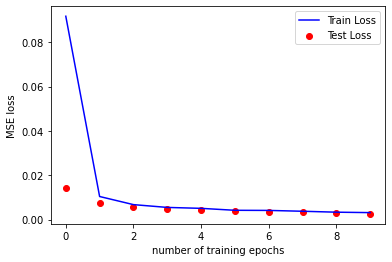

decryption accuracy is 99.97%


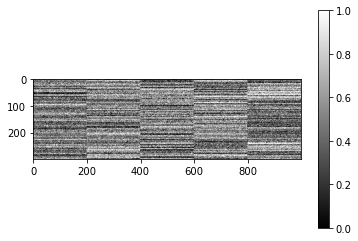

Parameters: 30 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([39, 92, 79, 26, 78, 52, 62, 27, 15,  9, 70, 13, 35, 70, 57, 91, 32, 28,
        33, 86,  6, 17, 55, 21, 53, 82, 41, 68, 56, 93, 32, 29, 12,  4, 71, 86,
        72, 15, 77, 91, 68,  2,  8, 17, 28, 21, 56, 45, 92, 76])
Epoch: 1, Train set: Avg. loss: 0.114949
Test set: Avg. loss: 0.019678
Epoch: 2, Train set: Avg. loss: 0.016446
Test set: Avg. loss: 0.011709
Epoch: 3, Train set: Avg. loss: 0.011241
Test set: Avg. loss: 0.013178
Epoch: 4, Train set: Avg. loss: 0.009576
Test set: Avg. loss: 0.007440
Epoch: 5, Train set: Avg. loss: 0.008116
Test set: Avg. loss: 0.007293
Epoch: 6, Train set: Avg. loss: 0.007597
Test set: Avg. loss: 0.006840
Epoch: 7, Train set: Avg. loss: 0.006624
Test set: Avg. loss: 0.006727
Epoch: 8, Train set: Avg. loss: 0.006621
Test set: Avg. loss: 0.005342
Epoch: 9, Train set: Avg. loss: 0.005277
Test set: Avg. loss: 0.005917
Epoch: 10, Train set: Avg. loss: 0.005658
Test set: Avg. loss: 0.004629


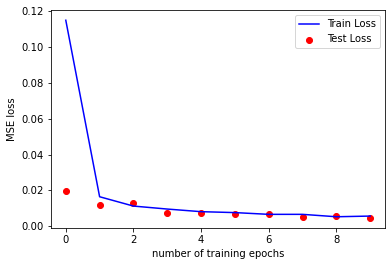

decryption accuracy is 99.92%


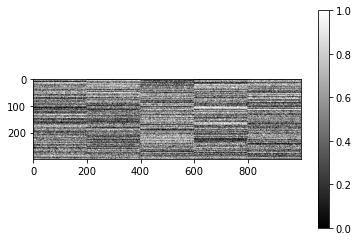

Parameters: 30 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([36, 81, 69, 66, 12, 12, 40, 28, 73, 66,  4, 80, 86, 40,  8, 75, 20, 87,
        20, 87, 71, 49, 44, 24,  2, 41, 11, 80, 60, 64, 55, 12,  3, 90, 46,  2,
        15, 78, 64, 20, 81, 18, 60, 74, 10, 13,  3, 32, 83, 83])
Epoch: 1, Train set: Avg. loss: 0.150154
Test set: Avg. loss: 0.033422
Epoch: 2, Train set: Avg. loss: 0.026041
Test set: Avg. loss: 0.021659
Epoch: 3, Train set: Avg. loss: 0.017787
Test set: Avg. loss: 0.014073
Epoch: 4, Train set: Avg. loss: 0.016238
Test set: Avg. loss: 0.012918
Epoch: 5, Train set: Avg. loss: 0.015989
Test set: Avg. loss: 0.015056
Epoch: 6, Train set: Avg. loss: 0.012931
Test set: Avg. loss: 0.011265
Epoch: 7, Train set: Avg. loss: 0.013385
Test set: Avg. loss: 0.011281
Epoch: 8, Train set: Avg. loss: 0.012473
Test set: Avg. loss: 0.010703
Epoch: 9, Train set: Avg. loss: 0.011592
Test set: Avg. loss: 0.009043
Epoch: 10, Train set: Avg. loss: 0.011030
Test set: Avg. loss: 0.009382


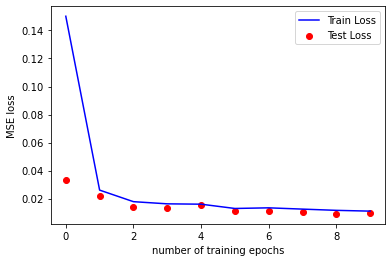

decryption accuracy is 99.75%


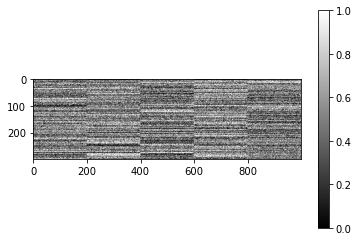

Parameters: 30 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([72, 44, 17, 67, 28, 24, 38, 83, 30, 48,  5, 35, 16, 37, 30, 36, 30,  7,
        54, 65,  5, 45, 15, 33, 45, 49, 29, 12, 44,  6, 73, 77, 24,  5, 55, 43,
        12, 61, 86, 51,  4, 25, 80, 29, 65, 73, 41, 74, 35, 59])
Epoch: 1, Train set: Avg. loss: 0.198409
Test set: Avg. loss: 0.045063
Epoch: 2, Train set: Avg. loss: 0.040664
Test set: Avg. loss: 0.032635
Epoch: 3, Train set: Avg. loss: 0.031648
Test set: Avg. loss: 0.054384
Epoch: 4, Train set: Avg. loss: 0.028873
Test set: Avg. loss: 0.028890
Epoch: 5, Train set: Avg. loss: 0.027284
Test set: Avg. loss: 0.025310
Epoch: 6, Train set: Avg. loss: 0.023188
Test set: Avg. loss: 0.019523
Epoch: 7, Train set: Avg. loss: 0.021500
Test set: Avg. loss: 0.020658
Epoch: 8, Train set: Avg. loss: 0.021168
Test set: Avg. loss: 0.018564
Epoch: 9, Train set: Avg. loss: 0.021385
Test set: Avg. loss: 0.017485
Epoch: 10, Train set: Avg. loss: 0.019956
Test set: Avg. loss: 0.018582


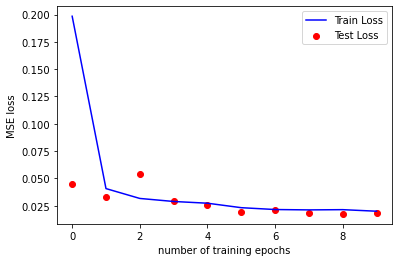

decryption accuracy is 99.4%


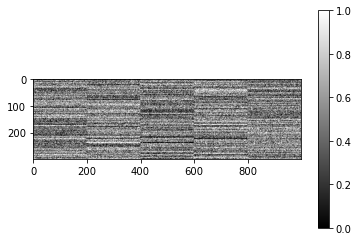

Parameters: 30 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([45, 59, 71, 31, 54, 62, 26, 42, 48, 32, 47, 79, 76, 72, 46, 19, 41,  3,
        45, 64, 84, 87, 49, 84, 21, 65,  3, 92, 74, 22, 54,  9, 47, 50, 54, 29,
        70, 34,  7, 21, 40, 65, 73, 62, 30, 12, 91, 20, 78, 11])
Epoch: 1, Train set: Avg. loss: 0.259091
Test set: Avg. loss: 0.072939
Epoch: 2, Train set: Avg. loss: 0.065499
Test set: Avg. loss: 0.053051
Epoch: 3, Train set: Avg. loss: 0.052076
Test set: Avg. loss: 0.055521
Epoch: 4, Train set: Avg. loss: 0.049466
Test set: Avg. loss: 0.049451
Epoch: 5, Train set: Avg. loss: 0.043973
Test set: Avg. loss: 0.045606
Epoch: 6, Train set: Avg. loss: 0.040382
Test set: Avg. loss: 0.034319
Epoch: 7, Train set: Avg. loss: 0.038866
Test set: Avg. loss: 0.031075
Epoch: 8, Train set: Avg. loss: 0.038294
Test set: Avg. loss: 0.037138
Epoch: 9, Train set: Avg. loss: 0.038536
Test set: Avg. loss: 0.031655
Epoch: 10, Train set: Avg. loss: 0.035041
Test set: Avg. loss: 

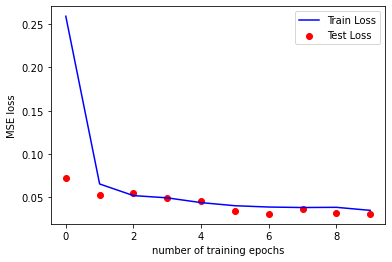

decryption accuracy is 99.06%


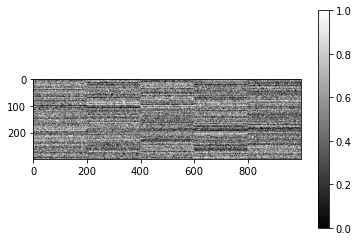

Parameters: 30 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([36, 17, 87, 25, 33, 66, 27, 40,  2, 13, 47, 53, 79, 81, 48, 24,  8, 41,
        72, 14, 12, 27, 24, 38, 82,  5, 36, 51,  5, 67, 32, 48, 47, 81, 31,  3,
        67, 19, 64, 51, 82,  9, 64, 16, 16, 42, 66, 82, 69, 40])
Epoch: 1, Train set: Avg. loss: 0.335744
Test set: Avg. loss: 0.117932
Epoch: 2, Train set: Avg. loss: 0.105639
Test set: Avg. loss: 0.083137
Epoch: 3, Train set: Avg. loss: 0.089458
Test set: Avg. loss: 0.085745
Epoch: 4, Train set: Avg. loss: 0.082389
Test set: Avg. loss: 0.073307
Epoch: 5, Train set: Avg. loss: 0.076279
Test set: Avg. loss: 0.071423
Epoch: 6, Train set: Avg. loss: 0.072858
Test set: Avg. loss: 0.075413
Epoch: 7, Train set: Avg. loss: 0.071436
Test set: Avg. loss: 0.063613
Epoch: 8, Train set: Avg. loss: 0.067602
Test set: Avg. loss: 0.065944
Epoch: 9, Train set: Avg. loss: 0.066747
Test set: Avg. loss: 0.060667
Epoch: 10, Train set: Avg. loss: 0.067095
Test set: Avg. loss: 0.056266


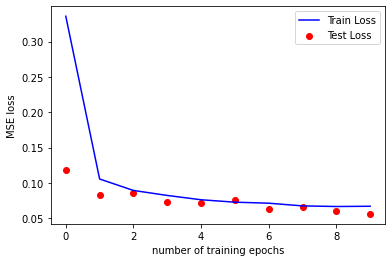

decryption accuracy is 98.2%


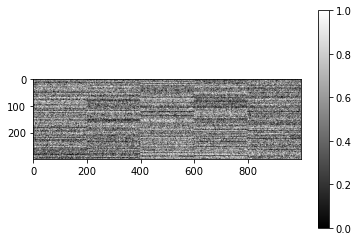

Parameters: 30 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([ 6, 24, 29, 53, 55, 86,  8, 64, 54,  9, 28, 44, 20, 13, 60, 89, 32, 89,
         7, 86, 48, 90, 86, 46, 14, 46, 30, 38, 82, 28, 53, 46, 52, 12, 50, 21,
        12, 75, 26, 92, 17, 63, 28, 39,  5, 56, 31, 89, 17, 77])
Epoch: 1, Train set: Avg. loss: 0.446288
Test set: Avg. loss: 0.185434
Epoch: 2, Train set: Avg. loss: 0.168371
Test set: Avg. loss: 0.130634
Epoch: 3, Train set: Avg. loss: 0.145701
Test set: Avg. loss: 0.123893
Epoch: 4, Train set: Avg. loss: 0.134861
Test set: Avg. loss: 0.128755
Epoch: 5, Train set: Avg. loss: 0.128327
Test set: Avg. loss: 0.132236
Epoch: 6, Train set: Avg. loss: 0.128090
Test set: Avg. loss: 0.110606
Epoch: 7, Train set: Avg. loss: 0.119236
Test set: Avg. loss: 0.130941
Epoch: 8, Train set: Avg. loss: 0.117431
Test set: Avg. loss: 0.119438
Epoch: 9, Train set: Avg. loss: 0.111062
Test set: Avg. loss: 0.135642
Epoch: 10, Train set: Avg. loss: 0.118370
Test set: Avg. loss: 0.111470


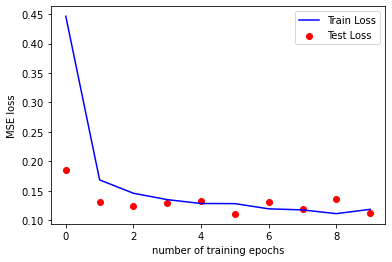

decryption accuracy is 96.39%


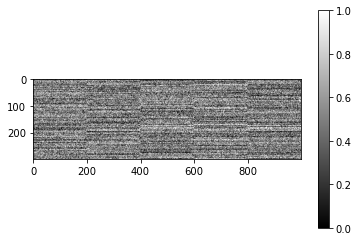

Parameters: 30 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([36, 46, 42, 88,  9, 89,  8, 76, 71, 54,  8, 47, 36, 91, 55, 32, 13, 10,
        76, 59, 30, 79, 55, 75, 28, 66, 11, 30, 28, 54, 49, 19, 23, 84, 79, 27,
        60, 13, 32, 87, 28, 34, 48, 49, 32, 10, 74, 64, 60, 53])
Epoch: 1, Train set: Avg. loss: 0.583810
Test set: Avg. loss: 0.295537
Epoch: 2, Train set: Avg. loss: 0.266244
Test set: Avg. loss: 0.231744
Epoch: 3, Train set: Avg. loss: 0.242956
Test set: Avg. loss: 0.241229
Epoch: 4, Train set: Avg. loss: 0.225011
Test set: Avg. loss: 0.232210
Epoch: 5, Train set: Avg. loss: 0.212181
Test set: Avg. loss: 0.225920
Epoch: 6, Train set: Avg. loss: 0.204556
Test set: Avg. loss: 0.200274
Epoch: 7, Train set: Avg. loss: 0.210980
Test set: Avg. loss: 0.189428
Epoch: 8, Train set: Avg. loss: 0.206118
Test set: Avg. loss: 0.210653
Epoch: 9, Train set: Avg. loss: 0.194075
Test set: Avg. loss: 0.202838
Epoch: 10, Train set: Avg. loss: 0.202521
Test set: Avg. loss: 0.187364


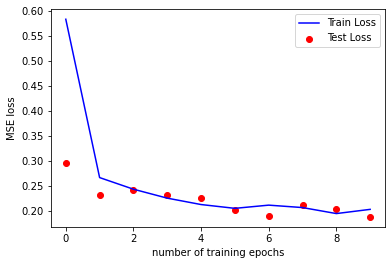

decryption accuracy is 93.86%


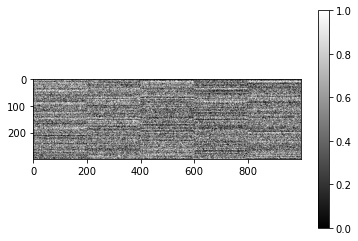

Parameters: 30 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([28, 66, 70, 23, 88, 28, 93, 82, 28, 65, 12, 48, 50, 50, 55, 31, 57, 36,
         2, 81, 44, 59, 84, 18,  7, 65, 64, 18, 60, 17, 19, 22, 66, 59, 44, 15,
        60, 90, 57, 46, 42, 69,  9, 66, 93, 89, 17, 52,  8, 53])
Epoch: 1, Train set: Avg. loss: 0.721275
Test set: Avg. loss: 0.362687
Epoch: 2, Train set: Avg. loss: 0.361554
Test set: Avg. loss: 0.371379
Epoch: 3, Train set: Avg. loss: 0.330735
Test set: Avg. loss: 0.306621
Epoch: 4, Train set: Avg. loss: 0.309242
Test set: Avg. loss: 0.313232
Epoch: 5, Train set: Avg. loss: 0.301514
Test set: Avg. loss: 0.324433
Epoch: 6, Train set: Avg. loss: 0.302288
Test set: Avg. loss: 0.320950
Epoch: 7, Train set: Avg. loss: 0.295884
Test set: Avg. loss: 0.263537
Epoch: 8, Train set: Avg. loss: 0.297048
Test set: Avg. loss: 0.288044
Epoch: 9, Train set: Avg. loss: 0.290242
Test set: Avg. loss: 0.306066
Epoch: 10, Train set: Avg. loss: 0.290498
Test set: Avg. loss: 0.278541


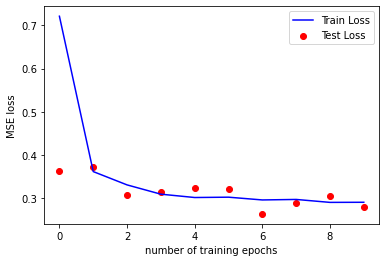

decryption accuracy is 91.4%


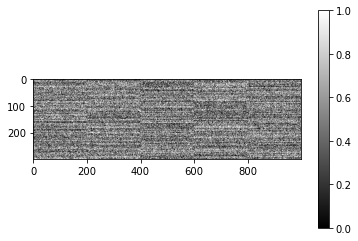

Parameters: 30 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([33, 88, 91,  7, 30,  0, 69, 44, 22, 62, 54, 85, 70, 48, 81, 45, 62, 90,
        53, 85, 48, 38, 11, 75,  5, 84, 15, 63, 88, 63, 61, 70, 14, 19, 71, 49,
        19, 17, 13, 11, 70, 41, 56, 55, 21,  3,  6, 12, 51, 88])
Epoch: 1, Train set: Avg. loss: 0.942272
Test set: Avg. loss: 0.583086
Epoch: 2, Train set: Avg. loss: 0.558543
Test set: Avg. loss: 0.472897
Epoch: 3, Train set: Avg. loss: 0.516514
Test set: Avg. loss: 0.544930
Epoch: 4, Train set: Avg. loss: 0.516019
Test set: Avg. loss: 0.550785
Epoch: 5, Train set: Avg. loss: 0.491138
Test set: Avg. loss: 0.496728
Epoch: 6, Train set: Avg. loss: 0.491529
Test set: Avg. loss: 0.485560
Epoch: 7, Train set: Avg. loss: 0.496221
Test set: Avg. loss: 0.528483
Epoch: 8, Train set: Avg. loss: 0.486174
Test set: Avg. loss: 0.511153
Epoch: 9, Train set: Avg. loss: 0.506039
Test set: Avg. loss: 0.488276
Epoch: 10, Train set: Avg. loss: 0.488210
Test set: Avg. loss: 0.489979


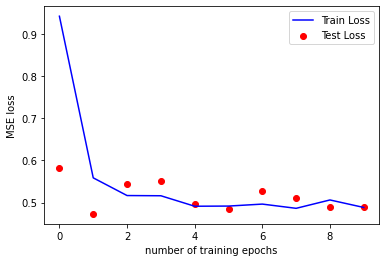

decryption accuracy is 85.37%


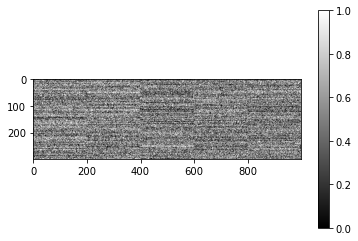

Parameters: 30 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([27, 75, 66, 30, 87, 14, 25, 36, 44, 59, 65, 48, 36, 66, 54, 89, 49, 74,
        51, 33, 17, 13, 58, 86, 30, 62, 89, 37, 25, 16, 65, 38, 25, 11, 92, 17,
        32, 38,  4, 15, 85, 66, 28, 41,  3, 47,  9, 67, 71, 54])
Epoch: 1, Train set: Avg. loss: 1.132537
Test set: Avg. loss: 0.842605
Epoch: 2, Train set: Avg. loss: 0.735224
Test set: Avg. loss: 0.687774
Epoch: 3, Train set: Avg. loss: 0.696048
Test set: Avg. loss: 0.747251
Epoch: 4, Train set: Avg. loss: 0.692512
Test set: Avg. loss: 0.693118
Epoch: 5, Train set: Avg. loss: 0.693702
Test set: Avg. loss: 0.656381
Epoch: 6, Train set: Avg. loss: 0.682553
Test set: Avg. loss: 0.701060
Epoch: 7, Train set: Avg. loss: 0.690430
Test set: Avg. loss: 0.679056
Epoch: 8, Train set: Avg. loss: 0.693881
Test set: Avg. loss: 0.648635
Epoch: 9, Train set: Avg. loss: 0.685149
Test set: Avg. loss: 0.673935
Epoch: 10, Train set: Avg. loss: 0.696056
Test set: Avg. loss: 0.637338


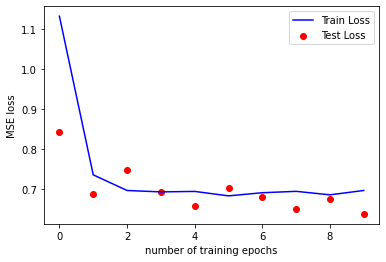

decryption accuracy is 81.91%


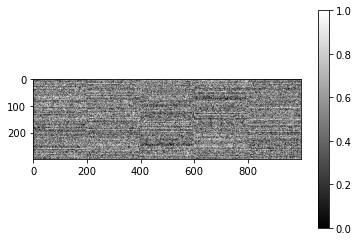

Parameters: 30 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([36, 77, 25, 14, 53, 29, 76,  5, 27, 47, 74, 82, 22, 78,  3, 78, 62, 35,
         5, 46, 60, 24, 24, 73, 12, 62, 48, 17, 55, 15, 26, 92, 54, 50,  3, 39,
        71, 64, 27, 38, 45, 75, 77, 46,  6, 70, 48, 65,  8, 11])
Epoch: 1, Train set: Avg. loss: 1.367151
Test set: Avg. loss: 0.970645
Epoch: 2, Train set: Avg. loss: 0.959834
Test set: Avg. loss: 0.876087
Epoch: 3, Train set: Avg. loss: 0.931488
Test set: Avg. loss: 0.872435
Epoch: 4, Train set: Avg. loss: 0.928988
Test set: Avg. loss: 0.862559
Epoch: 5, Train set: Avg. loss: 0.942136
Test set: Avg. loss: 0.920725
Epoch: 6, Train set: Avg. loss: 0.943929
Test set: Avg. loss: 0.931402
Epoch: 7, Train set: Avg. loss: 0.937573
Test set: Avg. loss: 0.977027
Epoch: 8, Train set: Avg. loss: 0.935798
Test set: Avg. loss: 0.961438
Epoch: 9, Train set: Avg. loss: 0.943535
Test set: Avg. loss: 0.943227
Epoch: 10, Train set: Avg. loss: 0.942898
Test set: Avg. loss: 0

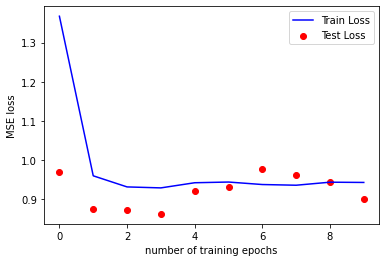

decryption accuracy is 76.24%


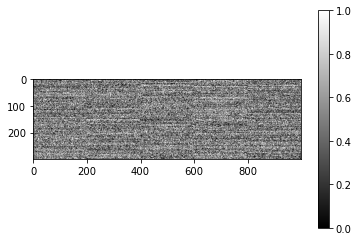

Parameters: 35 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([67, 93, 63, 57, 60, 82, 47, 67, 84,  1, 15, 13, 89, 86,  3, 82, 75, 70,
        19, 27, 71, 14, 69, 61, 28, 70, 72, 82, 59, 17, 85, 88, 10, 22, 25, 65,
        13, 72, 84, 71, 54, 47, 39, 41, 68,  8, 20, 12, 48,  3])
Epoch: 1, Train set: Avg. loss: 0.053562
Test set: Avg. loss: 0.005307
Epoch: 2, Train set: Avg. loss: 0.003805
Test set: Avg. loss: 0.002920
Epoch: 3, Train set: Avg. loss: 0.002371
Test set: Avg. loss: 0.002134
Epoch: 4, Train set: Avg. loss: 0.001783
Test set: Avg. loss: 0.001533
Epoch: 5, Train set: Avg. loss: 0.001403
Test set: Avg. loss: 0.001233
Epoch: 6, Train set: Avg. loss: 0.001158
Test set: Avg. loss: 0.001045
Epoch: 7, Train set: Avg. loss: 0.001014
Test set: Avg. loss: 0.000956
Epoch: 8, Train set: Avg. loss: 0.000925
Test set: Avg. loss: 0.000835
Epoch: 9, Train set: Avg. loss: 0.000888
Test set: Avg. loss: 0.000808
Epoch: 10, Train set: Avg. loss: 0.000763
Test set: Avg. loss: 0.000753


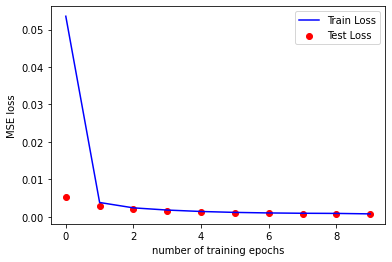

decryption accuracy is 100.0%


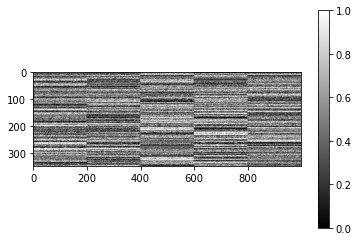

Parameters: 35 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([79, 74, 37, 33, 38, 91, 27, 81,  0, 42, 81, 70, 62, 52, 40, 92, 15,  6,
        83, 92, 11, 57, 17, 41, 86, 81, 70,  9, 86, 89, 88, 44, 25, 49, 66, 50,
        52,  5, 61, 18, 53, 64, 61, 29, 22, 53, 58, 47, 48, 72])
Epoch: 1, Train set: Avg. loss: 0.067700
Test set: Avg. loss: 0.007502
Epoch: 2, Train set: Avg. loss: 0.005769
Test set: Avg. loss: 0.004320
Epoch: 3, Train set: Avg. loss: 0.003771
Test set: Avg. loss: 0.002991
Epoch: 4, Train set: Avg. loss: 0.002837
Test set: Avg. loss: 0.002510
Epoch: 5, Train set: Avg. loss: 0.002240
Test set: Avg. loss: 0.002023
Epoch: 6, Train set: Avg. loss: 0.001893
Test set: Avg. loss: 0.002058
Epoch: 7, Train set: Avg. loss: 0.001810
Test set: Avg. loss: 0.001666
Epoch: 8, Train set: Avg. loss: 0.001737
Test set: Avg. loss: 0.001846
Epoch: 9, Train set: Avg. loss: 0.001419
Test set: Avg. loss: 0.001458
Epoch: 10, Train set: Avg. loss: 0.001321
Test set: Avg. loss: 0.001277


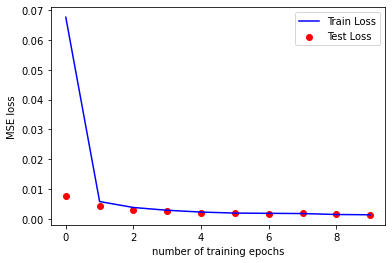

decryption accuracy is 100.0%


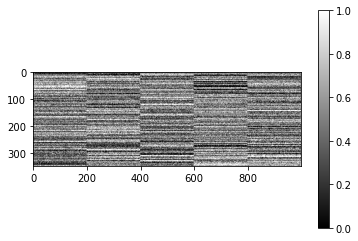

Parameters: 35 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([41, 61, 39, 82, 61, 47, 93, 12, 18, 62, 62, 24, 46, 92, 82, 33, 67, 10,
        46, 50, 65, 49, 44, 22, 70, 49, 52, 74, 71, 26,  1, 51, 69, 93, 76, 23,
        85, 90, 34, 73, 18,  4,  2,  5, 74, 43, 25, 88, 21, 49])
Epoch: 1, Train set: Avg. loss: 0.081319
Test set: Avg. loss: 0.010664
Epoch: 2, Train set: Avg. loss: 0.008186
Test set: Avg. loss: 0.005864
Epoch: 3, Train set: Avg. loss: 0.005376
Test set: Avg. loss: 0.004302
Epoch: 4, Train set: Avg. loss: 0.004355
Test set: Avg. loss: 0.003738
Epoch: 5, Train set: Avg. loss: 0.003643
Test set: Avg. loss: 0.003713
Epoch: 6, Train set: Avg. loss: 0.003810
Test set: Avg. loss: 0.002895
Epoch: 7, Train set: Avg. loss: 0.002747
Test set: Avg. loss: 0.002476
Epoch: 8, Train set: Avg. loss: 0.002067
Test set: Avg. loss: 0.002752
Epoch: 9, Train set: Avg. loss: 0.002165
Test set: Avg. loss: 0.001859
Epoch: 10, Train set: Avg. loss: 0.002230
Test set: Avg. loss: 0.001693


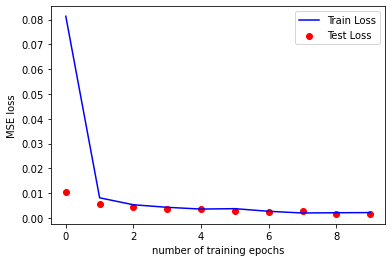

decryption accuracy is 99.99%


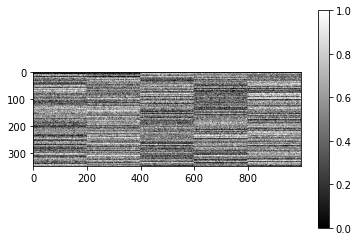

Parameters: 35 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([57, 16, 79, 44, 74, 84,  8, 59, 56, 41, 59, 49, 26, 93, 10, 37, 19, 71,
        15, 25, 78, 48, 44,  3, 43, 51, 71, 86, 92, 50, 49, 44,  6, 82, 37, 26,
        38, 16, 41, 52, 57, 17, 60, 48, 53,  5, 43, 91, 25, 32])
Epoch: 1, Train set: Avg. loss: 0.102947
Test set: Avg. loss: 0.017941
Epoch: 2, Train set: Avg. loss: 0.013334
Test set: Avg. loss: 0.009839
Epoch: 3, Train set: Avg. loss: 0.009794
Test set: Avg. loss: 0.009919
Epoch: 4, Train set: Avg. loss: 0.007705
Test set: Avg. loss: 0.006655
Epoch: 5, Train set: Avg. loss: 0.006246
Test set: Avg. loss: 0.006661
Epoch: 6, Train set: Avg. loss: 0.005405
Test set: Avg. loss: 0.004403
Epoch: 7, Train set: Avg. loss: 0.005333
Test set: Avg. loss: 0.003816
Epoch: 8, Train set: Avg. loss: 0.004777
Test set: Avg. loss: 0.007368
Epoch: 9, Train set: Avg. loss: 0.004786
Test set: Avg. loss: 0.003843
Epoch: 10, Train set: Avg. loss: 0.003706
Test set: Avg. loss: 0.004129


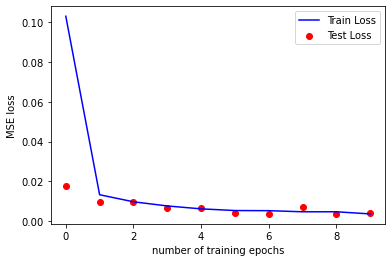

decryption accuracy is 99.92%


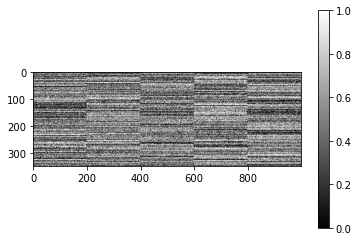

Parameters: 35 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([ 5, 17, 66, 83, 77, 41, 40, 38, 45, 64, 16, 31,  6, 56, 84, 17, 56, 48,
        49, 93, 92, 22, 19, 59, 14, 79,  8,  6, 29, 34, 93, 24, 22, 29, 62, 92,
        75, 15, 68, 73, 24, 45, 27, 24, 79, 71, 78, 21, 64, 75])
Epoch: 1, Train set: Avg. loss: 0.128973
Test set: Avg. loss: 0.021730
Epoch: 2, Train set: Avg. loss: 0.019005
Test set: Avg. loss: 0.015271
Epoch: 3, Train set: Avg. loss: 0.013187
Test set: Avg. loss: 0.019695
Epoch: 4, Train set: Avg. loss: 0.011993
Test set: Avg. loss: 0.009636
Epoch: 5, Train set: Avg. loss: 0.011125
Test set: Avg. loss: 0.010084
Epoch: 6, Train set: Avg. loss: 0.008369
Test set: Avg. loss: 0.007465
Epoch: 7, Train set: Avg. loss: 0.008719
Test set: Avg. loss: 0.010024
Epoch: 8, Train set: Avg. loss: 0.008404
Test set: Avg. loss: 0.006471
Epoch: 9, Train set: Avg. loss: 0.007161
Test set: Avg. loss: 0.006403
Epoch: 10, Train set: Avg. loss: 0.007100
Test set: Avg. loss: 0.009255


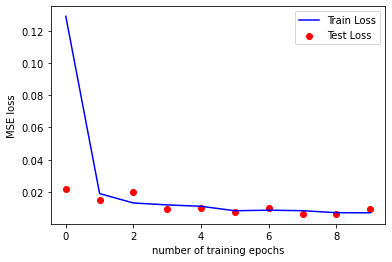

decryption accuracy is 99.74%


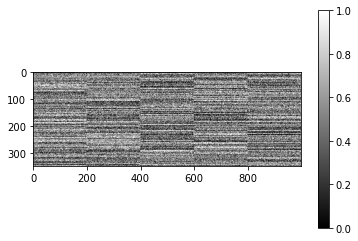

Parameters: 35 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([ 6,  2, 75, 27, 85, 30, 74,  7, 43, 84, 89, 39, 14, 49,  3, 31,  6, 30,
        48, 40,  8, 45, 14, 50, 26, 51, 47, 34, 60, 44, 58, 88,  7,  5, 80, 36,
        44, 14, 83, 25,  0, 28, 53, 87, 60,  0, 73, 40, 43, 32])
Epoch: 1, Train set: Avg. loss: 0.173477
Test set: Avg. loss: 0.043828
Epoch: 2, Train set: Avg. loss: 0.033370
Test set: Avg. loss: 0.027107
Epoch: 3, Train set: Avg. loss: 0.023009
Test set: Avg. loss: 0.021828
Epoch: 4, Train set: Avg. loss: 0.020590
Test set: Avg. loss: 0.019714
Epoch: 5, Train set: Avg. loss: 0.021009
Test set: Avg. loss: 0.015283
Epoch: 6, Train set: Avg. loss: 0.018212
Test set: Avg. loss: 0.018492
Epoch: 7, Train set: Avg. loss: 0.017408
Test set: Avg. loss: 0.014905
Epoch: 8, Train set: Avg. loss: 0.017049
Test set: Avg. loss: 0.019155
Epoch: 9, Train set: Avg. loss: 0.014808
Test set: Avg. loss: 0.012600
Epoch: 10, Train set: Avg. loss: 0.014826
Test set: Avg. loss: 0.011500


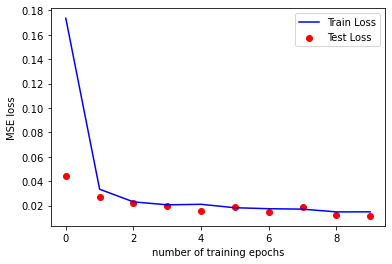

decryption accuracy is 99.71%


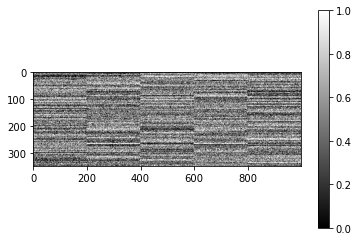

Parameters: 35 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([50, 88, 35, 76, 42, 14,  4, 91, 21, 18, 58, 76, 59, 52, 82, 86, 83, 59,
        72, 82, 54, 75, 25, 22, 15, 31, 39, 10,  4, 20, 48, 70, 20, 74, 86, 16,
         6, 85,  3, 36, 21, 81, 24, 50,  6, 61, 49, 44, 64, 27])
Epoch: 1, Train set: Avg. loss: 0.218849
Test set: Avg. loss: 0.060737
Epoch: 2, Train set: Avg. loss: 0.046219
Test set: Avg. loss: 0.041660
Epoch: 3, Train set: Avg. loss: 0.036364
Test set: Avg. loss: 0.032384
Epoch: 4, Train set: Avg. loss: 0.032228
Test set: Avg. loss: 0.038775
Epoch: 5, Train set: Avg. loss: 0.028322
Test set: Avg. loss: 0.028448
Epoch: 6, Train set: Avg. loss: 0.026747
Test set: Avg. loss: 0.025179
Epoch: 7, Train set: Avg. loss: 0.024902
Test set: Avg. loss: 0.023312
Epoch: 8, Train set: Avg. loss: 0.023321
Test set: Avg. loss: 0.021572
Epoch: 9, Train set: Avg. loss: 0.025404
Test set: Avg. loss: 0.020045
Epoch: 10, Train set: Avg. loss: 0.021103
Test set: Avg. loss: 

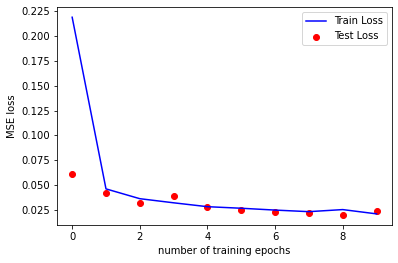

decryption accuracy is 99.28%


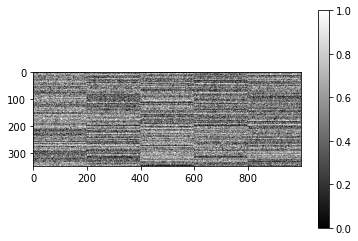

Parameters: 35 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([89, 45, 15, 90, 72, 52, 55,  0, 85,  0, 29, 77, 74, 14, 40, 68, 93, 11,
        85, 50,  6,  1, 81, 20, 60, 10, 25,  3, 80, 52, 17, 83, 29, 38, 59, 71,
        55, 25, 64, 28, 25, 51, 37,  9, 72, 50, 16, 27, 25, 28])
Epoch: 1, Train set: Avg. loss: 0.289214
Test set: Avg. loss: 0.091866
Epoch: 2, Train set: Avg. loss: 0.079499
Test set: Avg. loss: 0.062846
Epoch: 3, Train set: Avg. loss: 0.059519
Test set: Avg. loss: 0.047961
Epoch: 4, Train set: Avg. loss: 0.055861
Test set: Avg. loss: 0.048938
Epoch: 5, Train set: Avg. loss: 0.050130
Test set: Avg. loss: 0.046141
Epoch: 6, Train set: Avg. loss: 0.047941
Test set: Avg. loss: 0.040232
Epoch: 7, Train set: Avg. loss: 0.048661
Test set: Avg. loss: 0.050461
Epoch: 8, Train set: Avg. loss: 0.048599
Test set: Avg. loss: 0.082497
Epoch: 9, Train set: Avg. loss: 0.047220
Test set: Avg. loss: 0.047870
Epoch: 10, Train set: Avg. loss: 0.047912
Test set: Avg. loss: 0.055988


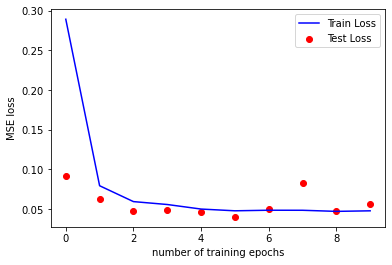

decryption accuracy is 98.4%


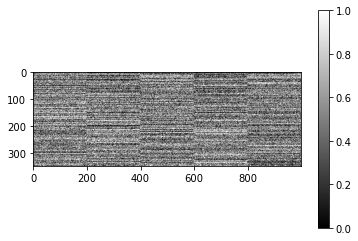

Parameters: 35 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([67, 25, 27, 43, 34, 72, 15, 37, 10, 47, 93, 79, 37, 46, 65, 67,  3, 37,
        48, 41, 29, 48, 39, 76, 15, 60, 33, 50,  5, 46, 20, 63, 63, 79,  2, 54,
        59, 45, 34, 16, 55, 59, 13, 83, 48, 63, 47, 53, 45,  0])
Epoch: 1, Train set: Avg. loss: 0.372848
Test set: Avg. loss: 0.127634
Epoch: 2, Train set: Avg. loss: 0.119728
Test set: Avg. loss: 0.123151
Epoch: 3, Train set: Avg. loss: 0.098356
Test set: Avg. loss: 0.093987
Epoch: 4, Train set: Avg. loss: 0.093639
Test set: Avg. loss: 0.077579
Epoch: 5, Train set: Avg. loss: 0.086232
Test set: Avg. loss: 0.081733
Epoch: 6, Train set: Avg. loss: 0.079153
Test set: Avg. loss: 0.076131
Epoch: 7, Train set: Avg. loss: 0.084762
Test set: Avg. loss: 0.072578
Epoch: 8, Train set: Avg. loss: 0.077630
Test set: Avg. loss: 0.079335
Epoch: 9, Train set: Avg. loss: 0.072534
Test set: Avg. loss: 0.075775
Epoch: 10, Train set: Avg. loss: 0.074087
Test set: Avg. loss: 0.080811


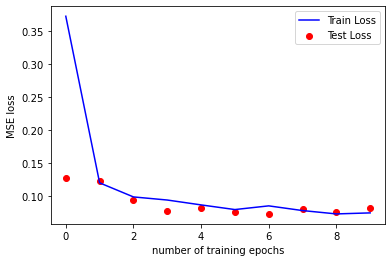

decryption accuracy is 97.37%


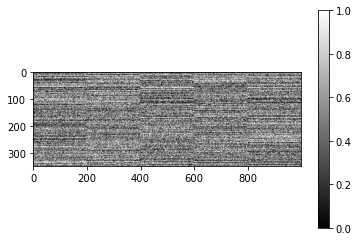

Parameters: 35 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([88,  8, 16, 88, 65, 68, 22, 25, 46, 78, 71, 70, 92, 37, 40, 91, 90, 81,
        43, 22, 18, 84,  2, 77, 37, 38, 17, 53, 84, 80, 77, 74, 23, 61, 29,  1,
        31, 19, 36, 92,  7, 48, 86, 28, 78, 86,  2, 60,  5, 44])
Epoch: 1, Train set: Avg. loss: 0.494998
Test set: Avg. loss: 0.206858
Epoch: 2, Train set: Avg. loss: 0.189598
Test set: Avg. loss: 0.187583
Epoch: 3, Train set: Avg. loss: 0.169851
Test set: Avg. loss: 0.149950
Epoch: 4, Train set: Avg. loss: 0.162294
Test set: Avg. loss: 0.134296
Epoch: 5, Train set: Avg. loss: 0.150087
Test set: Avg. loss: 0.140745
Epoch: 6, Train set: Avg. loss: 0.150608
Test set: Avg. loss: 0.167752
Epoch: 7, Train set: Avg. loss: 0.141519
Test set: Avg. loss: 0.157272
Epoch: 8, Train set: Avg. loss: 0.145207
Test set: Avg. loss: 0.134217
Epoch: 9, Train set: Avg. loss: 0.142652
Test set: Avg. loss: 0.148397
Epoch: 10, Train set: Avg. loss: 0.144639
Test set: Avg. loss: 0.127197


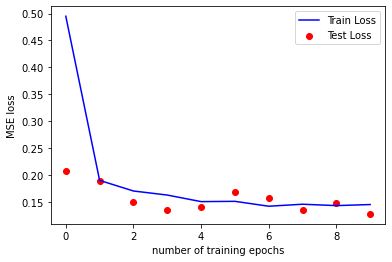

decryption accuracy is 95.71%


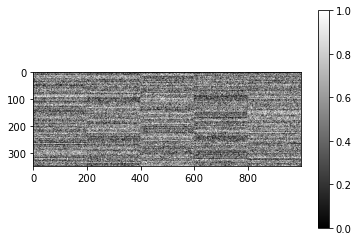

Parameters: 35 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([51, 15, 25, 72, 20,  9, 19, 18, 68, 27, 91, 77, 25, 10, 69, 46, 67, 60,
        54, 41, 44, 40, 86, 69, 15, 90, 75, 68, 69, 35, 19, 92, 49, 51, 61,  6,
        79, 63,  5, 50, 30,  3, 31, 72, 20, 52, 38, 85, 47, 54])
Epoch: 1, Train set: Avg. loss: 0.621587
Test set: Avg. loss: 0.320806
Epoch: 2, Train set: Avg. loss: 0.289336
Test set: Avg. loss: 0.239011
Epoch: 3, Train set: Avg. loss: 0.249453
Test set: Avg. loss: 0.249290
Epoch: 4, Train set: Avg. loss: 0.242818
Test set: Avg. loss: 0.253948
Epoch: 5, Train set: Avg. loss: 0.231300
Test set: Avg. loss: 0.214540
Epoch: 6, Train set: Avg. loss: 0.226708
Test set: Avg. loss: 0.240442
Epoch: 7, Train set: Avg. loss: 0.226782
Test set: Avg. loss: 0.201876
Epoch: 8, Train set: Avg. loss: 0.223241
Test set: Avg. loss: 0.219970
Epoch: 9, Train set: Avg. loss: 0.212610
Test set: Avg. loss: 0.225574
Epoch: 10, Train set: Avg. loss: 0.207642
Test set: Avg. loss: 0.219570


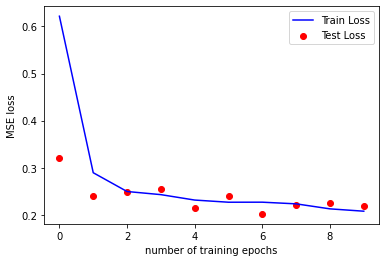

decryption accuracy is 93.26%


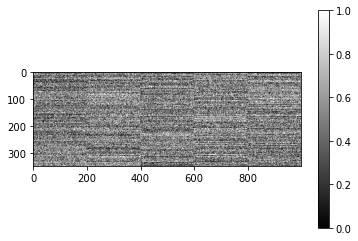

Parameters: 35 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([81, 81, 39, 52, 66, 44,  4, 87, 79,  1,  9,  7, 66, 40, 42, 37, 83, 32,
        64, 71, 90,  1, 70, 74, 35, 47, 93, 10, 11, 21, 73, 42, 49, 83, 57, 42,
        71, 89, 81, 85, 60, 13,  4, 57,  4, 62, 15, 23, 36, 75])
Epoch: 1, Train set: Avg. loss: 0.800719
Test set: Avg. loss: 0.443548
Epoch: 2, Train set: Avg. loss: 0.416540
Test set: Avg. loss: 0.350477
Epoch: 3, Train set: Avg. loss: 0.371803
Test set: Avg. loss: 0.377738
Epoch: 4, Train set: Avg. loss: 0.353029
Test set: Avg. loss: 0.326393
Epoch: 5, Train set: Avg. loss: 0.349858
Test set: Avg. loss: 0.327713
Epoch: 6, Train set: Avg. loss: 0.347939
Test set: Avg. loss: 0.318220
Epoch: 7, Train set: Avg. loss: 0.327154
Test set: Avg. loss: 0.313358
Epoch: 8, Train set: Avg. loss: 0.338428
Test set: Avg. loss: 0.380127
Epoch: 9, Train set: Avg. loss: 0.325156
Test set: Avg. loss: 0.321624
Epoch: 10, Train set: Avg. loss: 0.332496
Test set: Avg. loss: 0.347525


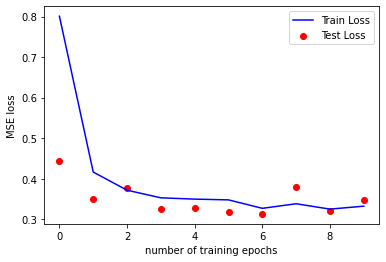

decryption accuracy is 89.73%


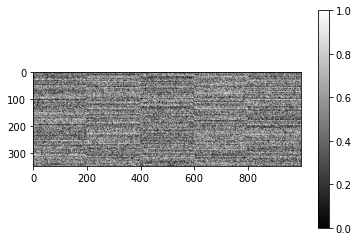

Parameters: 35 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([82,  0, 12, 93,  6, 57, 78, 90, 55, 47, 55, 43, 68, 32, 50,  3, 72, 28,
        76, 71, 92, 16, 32,  2, 26,  8, 55, 77, 34, 37, 12, 86, 91, 53, 56, 47,
        71, 72, 40, 70, 35, 11, 64, 38, 69, 22, 67, 22, 25, 35])
Epoch: 1, Train set: Avg. loss: 1.031242
Test set: Avg. loss: 0.598204
Epoch: 2, Train set: Avg. loss: 0.607751
Test set: Avg. loss: 0.528513
Epoch: 3, Train set: Avg. loss: 0.570247
Test set: Avg. loss: 0.525893
Epoch: 4, Train set: Avg. loss: 0.550151
Test set: Avg. loss: 0.533675
Epoch: 5, Train set: Avg. loss: 0.536274
Test set: Avg. loss: 0.560464
Epoch: 6, Train set: Avg. loss: 0.547263
Test set: Avg. loss: 0.565469
Epoch: 7, Train set: Avg. loss: 0.542727
Test set: Avg. loss: 0.501061
Epoch: 8, Train set: Avg. loss: 0.537920
Test set: Avg. loss: 0.522466
Epoch: 9, Train set: Avg. loss: 0.543234
Test set: Avg. loss: 0.568784
Epoch: 10, Train set: Avg. loss: 0.554601
Test set: Avg. loss: 0.531343


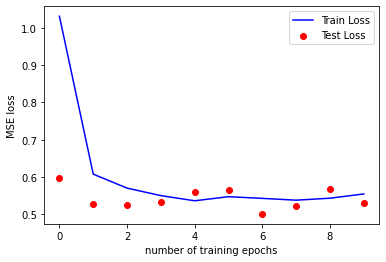

decryption accuracy is 85.75%


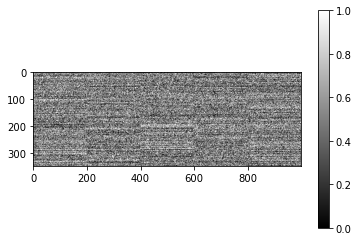

Parameters: 35 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([65, 91, 71, 46, 30, 49, 88, 83, 64, 42, 58,  2, 73, 24, 42, 55, 33,  2,
        15, 28, 83, 92, 88, 93, 93, 26, 63, 53,  6, 93, 90, 88, 27, 92, 11, 14,
        57, 73, 67, 75, 13, 33, 37, 16, 93, 15, 29, 34, 22, 87])
Epoch: 1, Train set: Avg. loss: 1.292940
Test set: Avg. loss: 0.896548
Epoch: 2, Train set: Avg. loss: 0.853357
Test set: Avg. loss: 0.850474
Epoch: 3, Train set: Avg. loss: 0.841151
Test set: Avg. loss: 0.819919
Epoch: 4, Train set: Avg. loss: 0.825124
Test set: Avg. loss: 0.876579
Epoch: 5, Train set: Avg. loss: 0.810988
Test set: Avg. loss: 0.845652
Epoch: 6, Train set: Avg. loss: 0.805643
Test set: Avg. loss: 0.848428
Epoch: 7, Train set: Avg. loss: 0.819300
Test set: Avg. loss: 0.830713
Epoch: 8, Train set: Avg. loss: 0.802194
Test set: Avg. loss: 0.822488
Epoch: 9, Train set: Avg. loss: 0.829956
Test set: Avg. loss: 0.757586
Epoch: 10, Train set: Avg. loss: 0.825870
Test set: Avg. loss: 0

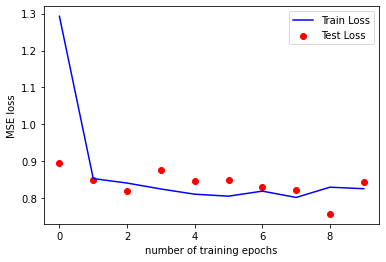

decryption accuracy is 78.66%


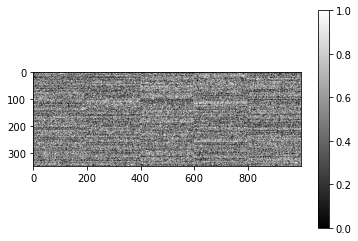

Parameters: 40 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([31, 31,  3, 18, 92, 46, 41,  2, 91, 69, 44, 87, 93, 76, 26, 51, 71, 75,
        73, 39, 50, 56, 17, 24, 49, 70, 24, 71, 18, 92, 20, 77, 42, 39, 69, 74,
        56, 93, 44, 71, 48, 88, 49, 27, 42, 89, 58, 37, 79,  3])
Epoch: 1, Train set: Avg. loss: 0.049667
Test set: Avg. loss: 0.004374
Epoch: 2, Train set: Avg. loss: 0.003090
Test set: Avg. loss: 0.002360
Epoch: 3, Train set: Avg. loss: 0.001944
Test set: Avg. loss: 0.001647
Epoch: 4, Train set: Avg. loss: 0.001442
Test set: Avg. loss: 0.001261
Epoch: 5, Train set: Avg. loss: 0.001160
Test set: Avg. loss: 0.001094
Epoch: 6, Train set: Avg. loss: 0.000973
Test set: Avg. loss: 0.000917
Epoch: 7, Train set: Avg. loss: 0.000908
Test set: Avg. loss: 0.000786
Epoch: 8, Train set: Avg. loss: 0.000743
Test set: Avg. loss: 0.000680
Epoch: 9, Train set: Avg. loss: 0.000663
Test set: Avg. loss: 0.000630
Epoch: 10, Train set: Avg. loss: 0.000590
Test set: Avg. loss: 0.000598


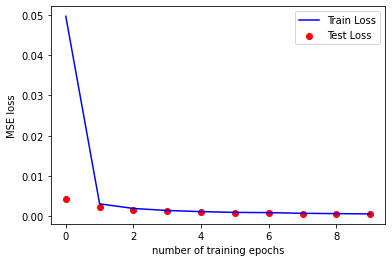

decryption accuracy is 100.0%


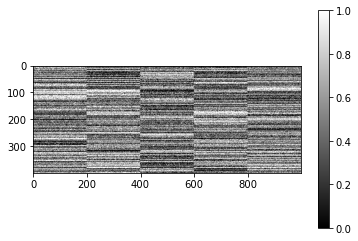

Parameters: 40 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([18, 14, 27, 32, 56, 19,  3, 35, 89, 68,  9, 84, 41, 81, 74, 89,  4, 38,
        47, 14,  5, 70, 62, 69, 91, 36,  6, 93, 75, 74, 43, 52, 27, 86, 46, 70,
        89, 24, 40, 62, 16, 30, 55, 62, 46, 83, 77, 23, 87, 29])
Epoch: 1, Train set: Avg. loss: 0.060526
Test set: Avg. loss: 0.006311
Epoch: 2, Train set: Avg. loss: 0.004757
Test set: Avg. loss: 0.003606
Epoch: 3, Train set: Avg. loss: 0.003056
Test set: Avg. loss: 0.002456
Epoch: 4, Train set: Avg. loss: 0.002534
Test set: Avg. loss: 0.002970
Epoch: 5, Train set: Avg. loss: 0.002056
Test set: Avg. loss: 0.001606
Epoch: 6, Train set: Avg. loss: 0.001672
Test set: Avg. loss: 0.001382
Epoch: 7, Train set: Avg. loss: 0.001664
Test set: Avg. loss: 0.001305
Epoch: 8, Train set: Avg. loss: 0.001484
Test set: Avg. loss: 0.001193
Epoch: 9, Train set: Avg. loss: 0.001111
Test set: Avg. loss: 0.001023
Epoch: 10, Train set: Avg. loss: 0.001150
Test set: Avg. loss: 0.000963


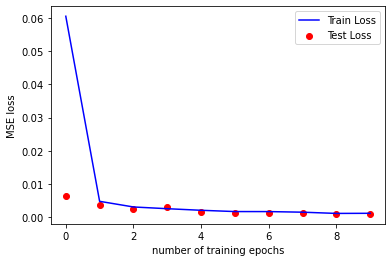

decryption accuracy is 100.0%


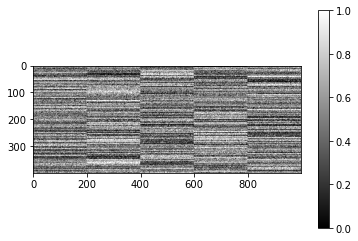

Parameters: 40 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([41, 57, 68, 90,  3, 49, 82, 88, 83, 81, 62, 80, 73,  8, 54, 80, 37, 81,
        45,  7, 15, 66, 19, 23, 10, 37, 37, 67, 58, 21,  6, 15,  4, 18,  2, 31,
        26, 69, 19, 36, 87, 59, 43, 70, 79, 56, 46, 46, 56, 72])
Epoch: 1, Train set: Avg. loss: 0.074204
Test set: Avg. loss: 0.008305
Epoch: 2, Train set: Avg. loss: 0.006321
Test set: Avg. loss: 0.004694
Epoch: 3, Train set: Avg. loss: 0.004634
Test set: Avg. loss: 0.003433
Epoch: 4, Train set: Avg. loss: 0.003472
Test set: Avg. loss: 0.002640
Epoch: 5, Train set: Avg. loss: 0.002643
Test set: Avg. loss: 0.002179
Epoch: 6, Train set: Avg. loss: 0.002494
Test set: Avg. loss: 0.002102
Epoch: 7, Train set: Avg. loss: 0.002210
Test set: Avg. loss: 0.003119
Epoch: 8, Train set: Avg. loss: 0.001820
Test set: Avg. loss: 0.001508
Epoch: 9, Train set: Avg. loss: 0.001539
Test set: Avg. loss: 0.003116
Epoch: 10, Train set: Avg. loss: 0.001458
Test set: Avg. loss: 0.001288


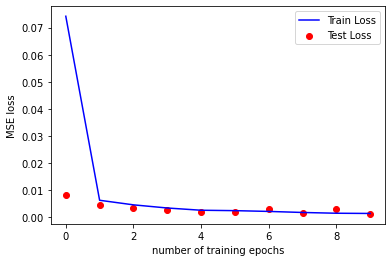

decryption accuracy is 100.0%


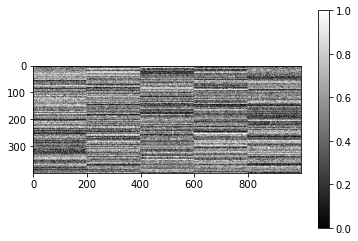

Parameters: 40 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([24,  5, 21, 23,  4, 35, 47, 17, 12, 36, 25, 71,  9, 77, 26, 20,  4, 67,
        64, 52, 52, 93, 26, 45,  3, 29, 88, 30, 18, 37, 38, 80, 42, 82, 60, 63,
        67, 47, 88, 92, 89, 85, 82, 28, 92, 69, 38, 82, 93, 43])
Epoch: 1, Train set: Avg. loss: 0.093600
Test set: Avg. loss: 0.019231
Epoch: 2, Train set: Avg. loss: 0.010588
Test set: Avg. loss: 0.016230
Epoch: 3, Train set: Avg. loss: 0.006762
Test set: Avg. loss: 0.005837
Epoch: 4, Train set: Avg. loss: 0.005351
Test set: Avg. loss: 0.004408
Epoch: 5, Train set: Avg. loss: 0.004923
Test set: Avg. loss: 0.004120
Epoch: 6, Train set: Avg. loss: 0.004702
Test set: Avg. loss: 0.003461
Epoch: 7, Train set: Avg. loss: 0.003610
Test set: Avg. loss: 0.003613
Epoch: 8, Train set: Avg. loss: 0.003065
Test set: Avg. loss: 0.002671
Epoch: 9, Train set: Avg. loss: 0.002866
Test set: Avg. loss: 0.003250
Epoch: 10, Train set: Avg. loss: 0.002922
Test set: Avg. loss: 0.002380


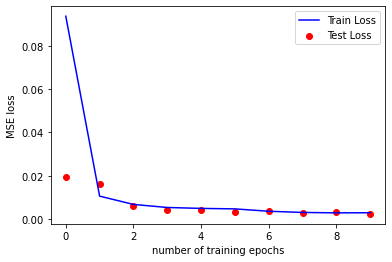

decryption accuracy is 99.94%


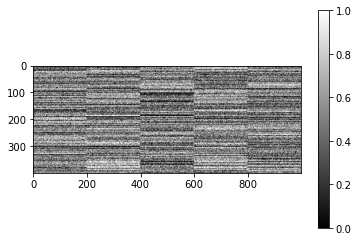

Parameters: 40 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([74, 61, 65, 81, 50, 17,  2,  8, 78, 87, 39, 69, 87, 87,  4,  8, 77,  9,
        52, 16, 36, 66, 21, 59, 49, 90, 80, 59, 93, 71, 38, 42, 92, 72, 48, 62,
        89, 20, 49, 58, 91,  3, 47, 77, 42, 70,  6, 66, 32, 92])
Epoch: 1, Train set: Avg. loss: 0.114512
Test set: Avg. loss: 0.020422
Epoch: 2, Train set: Avg. loss: 0.014457
Test set: Avg. loss: 0.011326
Epoch: 3, Train set: Avg. loss: 0.010627
Test set: Avg. loss: 0.008406
Epoch: 4, Train set: Avg. loss: 0.008931
Test set: Avg. loss: 0.006804
Epoch: 5, Train set: Avg. loss: 0.008227
Test set: Avg. loss: 0.005626
Epoch: 6, Train set: Avg. loss: 0.006765
Test set: Avg. loss: 0.005699
Epoch: 7, Train set: Avg. loss: 0.005914
Test set: Avg. loss: 0.005503
Epoch: 8, Train set: Avg. loss: 0.006254
Test set: Avg. loss: 0.004732
Epoch: 9, Train set: Avg. loss: 0.005287
Test set: Avg. loss: 0.004048
Epoch: 10, Train set: Avg. loss: 0.004950
Test set: Avg. loss: 0.004042


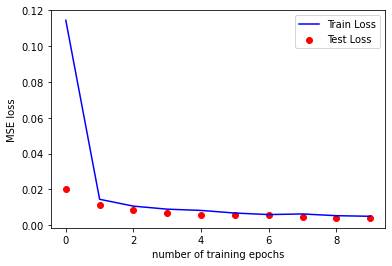

decryption accuracy is 99.88%


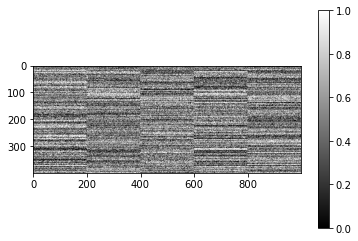

Parameters: 40 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([61, 73, 82, 93,  0, 90, 77, 93,  7, 64, 27, 71, 18, 26,  5, 77, 14, 22,
        18, 89, 13, 80, 93, 40, 83, 20, 44, 37, 59,  9, 57, 27, 66, 88, 35, 67,
        74, 87, 18, 66, 63, 54,  0, 47, 25, 55, 50, 91, 63, 84])
Epoch: 1, Train set: Avg. loss: 0.149076
Test set: Avg. loss: 0.030699
Epoch: 2, Train set: Avg. loss: 0.024100
Test set: Avg. loss: 0.017004
Epoch: 3, Train set: Avg. loss: 0.017922
Test set: Avg. loss: 0.013491
Epoch: 4, Train set: Avg. loss: 0.014229
Test set: Avg. loss: 0.010672
Epoch: 5, Train set: Avg. loss: 0.014909
Test set: Avg. loss: 0.009765
Epoch: 6, Train set: Avg. loss: 0.011496
Test set: Avg. loss: 0.008871
Epoch: 7, Train set: Avg. loss: 0.011015
Test set: Avg. loss: 0.010895
Epoch: 8, Train set: Avg. loss: 0.010367
Test set: Avg. loss: 0.008035
Epoch: 9, Train set: Avg. loss: 0.009571
Test set: Avg. loss: 0.008633
Epoch: 10, Train set: Avg. loss: 0.009658
Test set: Avg. loss: 0.007645


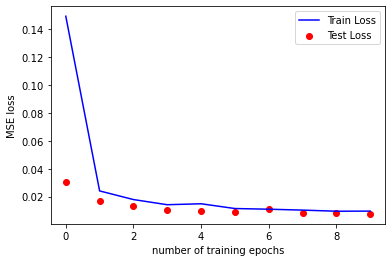

decryption accuracy is 99.77%


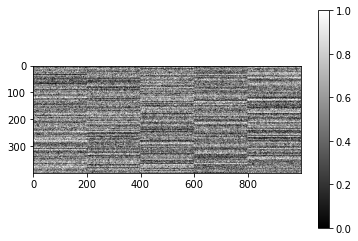

Parameters: 40 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([32, 33, 43, 61,  8, 79, 23, 13, 50, 82, 74,  3, 79, 51, 89,  3, 26, 50,
        50, 44, 20, 75,  3, 23, 70,  0, 60, 89, 66, 86, 86,  0,  1, 70, 59, 54,
        42, 39, 88, 56, 64, 93, 61, 88, 28, 65, 76, 41, 26, 58])
Epoch: 1, Train set: Avg. loss: 0.195085
Test set: Avg. loss: 0.046362
Epoch: 2, Train set: Avg. loss: 0.035530
Test set: Avg. loss: 0.037612
Epoch: 3, Train set: Avg. loss: 0.026556
Test set: Avg. loss: 0.027905
Epoch: 4, Train set: Avg. loss: 0.023332
Test set: Avg. loss: 0.024906
Epoch: 5, Train set: Avg. loss: 0.021616
Test set: Avg. loss: 0.022393
Epoch: 6, Train set: Avg. loss: 0.019400
Test set: Avg. loss: 0.018448
Epoch: 7, Train set: Avg. loss: 0.017046
Test set: Avg. loss: 0.014120
Epoch: 8, Train set: Avg. loss: 0.020599
Test set: Avg. loss: 0.013959
Epoch: 9, Train set: Avg. loss: 0.016770
Test set: Avg. loss: 0.016072
Epoch: 10, Train set: Avg. loss: 0.016426
Test set: Avg. loss: 

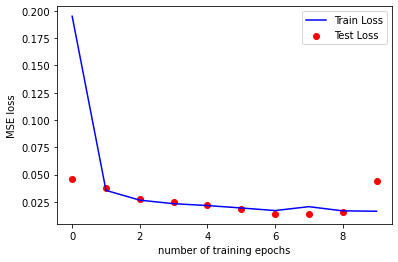

decryption accuracy is 99.08%


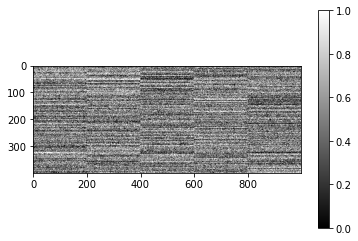

Parameters: 40 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([35, 66, 39, 13, 33,  6, 31, 48, 76, 12, 12, 31, 43, 49, 84, 16,  8, 88,
        55, 81, 74, 42, 63, 36,  2, 41, 40, 12, 33, 44, 54, 42, 10, 74, 61, 84,
        33, 87, 27, 27, 51, 62, 83, 48, 31, 60, 83,  0, 19, 49])
Epoch: 1, Train set: Avg. loss: 0.260040
Test set: Avg. loss: 0.066307
Epoch: 2, Train set: Avg. loss: 0.061982
Test set: Avg. loss: 0.053722
Epoch: 3, Train set: Avg. loss: 0.049599
Test set: Avg. loss: 0.040890
Epoch: 4, Train set: Avg. loss: 0.043788
Test set: Avg. loss: 0.040901
Epoch: 5, Train set: Avg. loss: 0.040331
Test set: Avg. loss: 0.040805
Epoch: 6, Train set: Avg. loss: 0.036628
Test set: Avg. loss: 0.066089
Epoch: 7, Train set: Avg. loss: 0.035981
Test set: Avg. loss: 0.037445
Epoch: 8, Train set: Avg. loss: 0.034319
Test set: Avg. loss: 0.032134
Epoch: 9, Train set: Avg. loss: 0.031295
Test set: Avg. loss: 0.028779
Epoch: 10, Train set: Avg. loss: 0.029937
Test set: Avg. loss: 0.025227


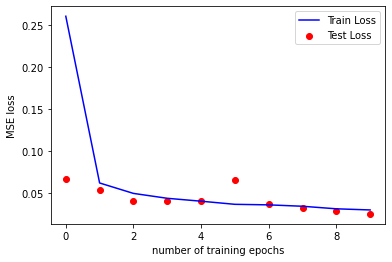

decryption accuracy is 99.37%


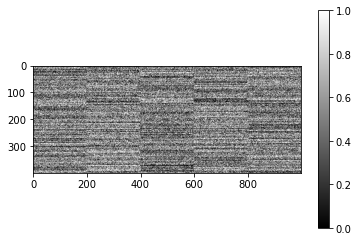

Parameters: 40 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([70, 78, 71, 74, 27,  5, 64,  4,  6, 59, 23, 61, 65, 69, 82, 37, 56, 53,
        28, 15, 57, 23, 24, 69, 36,  1, 76, 27, 59, 83, 68, 44, 87,  7, 67, 65,
        11, 88, 15, 68, 26, 53, 48, 41, 45, 65, 67, 18,  1, 51])
Epoch: 1, Train set: Avg. loss: 0.345745
Test set: Avg. loss: 0.128951
Epoch: 2, Train set: Avg. loss: 0.104178
Test set: Avg. loss: 0.079882
Epoch: 3, Train set: Avg. loss: 0.086232
Test set: Avg. loss: 0.075955
Epoch: 4, Train set: Avg. loss: 0.079571
Test set: Avg. loss: 0.084022
Epoch: 5, Train set: Avg. loss: 0.074652
Test set: Avg. loss: 0.115216
Epoch: 6, Train set: Avg. loss: 0.072094
Test set: Avg. loss: 0.147634
Epoch: 7, Train set: Avg. loss: 0.067355
Test set: Avg. loss: 0.063668
Epoch: 8, Train set: Avg. loss: 0.065907
Test set: Avg. loss: 0.094245
Epoch: 9, Train set: Avg. loss: 0.065180
Test set: Avg. loss: 0.065329
Epoch: 10, Train set: Avg. loss: 0.061210
Test set: Avg. loss: 0.052333


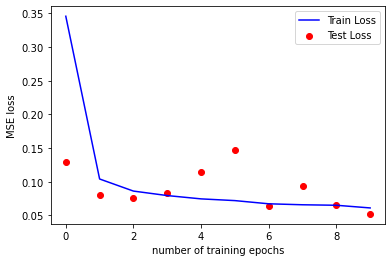

decryption accuracy is 98.48%


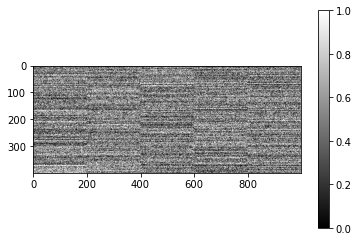

Parameters: 40 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([ 7,  2, 24, 12, 46, 69, 65, 65, 77, 12, 15, 10, 71, 48, 48, 30, 24, 35,
        24, 71, 61, 75, 77, 26, 52, 51, 86, 86,  1, 69, 19, 49, 61, 41, 28, 71,
        36, 70,  9, 17,  0, 64, 73, 84, 75, 59, 70, 88, 15, 64])
Epoch: 1, Train set: Avg. loss: 0.460964
Test set: Avg. loss: 0.155367
Epoch: 2, Train set: Avg. loss: 0.170562
Test set: Avg. loss: 0.127909
Epoch: 3, Train set: Avg. loss: 0.152076
Test set: Avg. loss: 0.183979
Epoch: 4, Train set: Avg. loss: 0.131587
Test set: Avg. loss: 0.151965
Epoch: 5, Train set: Avg. loss: 0.124541
Test set: Avg. loss: 0.123116
Epoch: 6, Train set: Avg. loss: 0.122035
Test set: Avg. loss: 0.123106
Epoch: 7, Train set: Avg. loss: 0.119999
Test set: Avg. loss: 0.111313
Epoch: 8, Train set: Avg. loss: 0.121993
Test set: Avg. loss: 0.110700
Epoch: 9, Train set: Avg. loss: 0.120439
Test set: Avg. loss: 0.108270
Epoch: 10, Train set: Avg. loss: 0.117221
Test set: Avg. loss: 0.120136


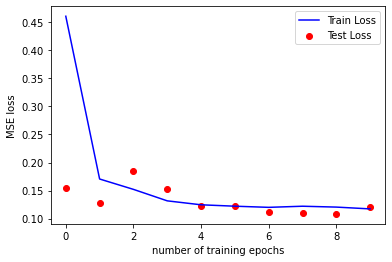

decryption accuracy is 96.44%


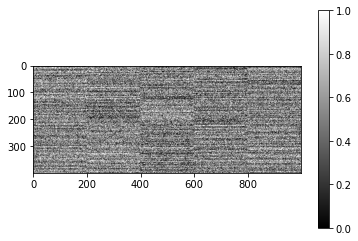

Parameters: 40 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([86, 36, 31, 29, 79, 62, 64, 23, 85, 42, 75, 71, 66, 56, 80,  5,  0, 43,
        16, 72, 48, 88, 37,  6, 14, 77, 56, 73, 72, 10, 74, 16, 26, 28, 13, 91,
        38, 72, 52, 64, 67, 74, 59, 77, 54, 39, 73, 35, 82, 28])
Epoch: 1, Train set: Avg. loss: 0.594565
Test set: Avg. loss: 0.255793
Epoch: 2, Train set: Avg. loss: 0.244928
Test set: Avg. loss: 0.239251
Epoch: 3, Train set: Avg. loss: 0.220592
Test set: Avg. loss: 0.195358
Epoch: 4, Train set: Avg. loss: 0.197529
Test set: Avg. loss: 0.165778
Epoch: 5, Train set: Avg. loss: 0.188578
Test set: Avg. loss: 0.179624
Epoch: 6, Train set: Avg. loss: 0.183112
Test set: Avg. loss: 0.153933
Epoch: 7, Train set: Avg. loss: 0.188485
Test set: Avg. loss: 0.204276
Epoch: 8, Train set: Avg. loss: 0.181177
Test set: Avg. loss: 0.175022
Epoch: 9, Train set: Avg. loss: 0.180894
Test set: Avg. loss: 0.177950
Epoch: 10, Train set: Avg. loss: 0.171418
Test set: Avg. loss: 0.153919


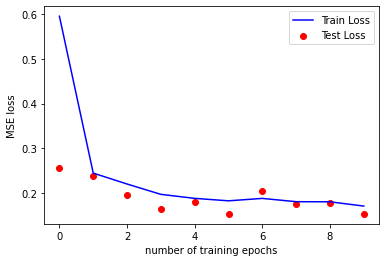

decryption accuracy is 95.45%


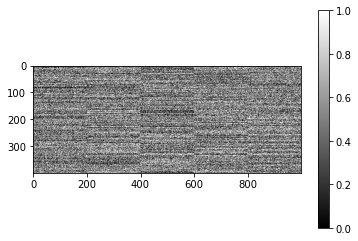

Parameters: 40 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([93, 77, 55,  0, 68, 74, 82, 89, 12,  0, 34, 42, 39, 46, 38, 92, 31, 30,
         9, 90, 72, 40,  3, 18, 57, 75, 39, 92, 74, 45, 76,  5, 85, 26, 24, 41,
        46, 82, 60, 24, 51, 83, 18, 21, 35, 42, 32, 92, 43, 43])
Epoch: 1, Train set: Avg. loss: 0.777472
Test set: Avg. loss: 0.356025
Epoch: 2, Train set: Avg. loss: 0.388247
Test set: Avg. loss: 0.404759
Epoch: 3, Train set: Avg. loss: 0.333749
Test set: Avg. loss: 0.303827
Epoch: 4, Train set: Avg. loss: 0.321929
Test set: Avg. loss: 0.279224
Epoch: 5, Train set: Avg. loss: 0.323730
Test set: Avg. loss: 0.283092
Epoch: 6, Train set: Avg. loss: 0.308962
Test set: Avg. loss: 0.267674
Epoch: 7, Train set: Avg. loss: 0.292303
Test set: Avg. loss: 0.287031
Epoch: 8, Train set: Avg. loss: 0.303334
Test set: Avg. loss: 0.268278
Epoch: 9, Train set: Avg. loss: 0.290065
Test set: Avg. loss: 0.254716
Epoch: 10, Train set: Avg. loss: 0.288528
Test set: Avg. loss: 0.292037


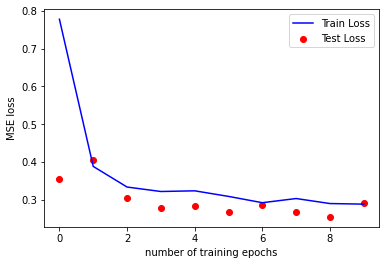

decryption accuracy is 91.52%


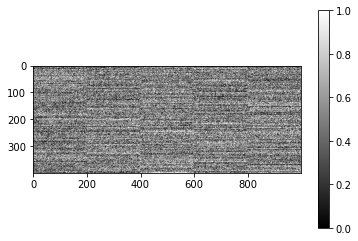

Parameters: 40 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([33, 47, 84, 86, 66, 89, 43, 42, 93, 47, 76, 52, 40, 65, 66, 56, 41, 20,
        15, 87, 36, 40, 35, 63, 42, 23, 27, 36, 89, 12, 27, 84, 70, 43, 49, 79,
        70, 57, 41, 67, 39, 18, 51, 40, 79, 39, 79, 51, 48,  7])
Epoch: 1, Train set: Avg. loss: 0.956794
Test set: Avg. loss: 0.594752
Epoch: 2, Train set: Avg. loss: 0.523960
Test set: Avg. loss: 0.585776
Epoch: 3, Train set: Avg. loss: 0.480641
Test set: Avg. loss: 0.451675
Epoch: 4, Train set: Avg. loss: 0.458398
Test set: Avg. loss: 0.456284
Epoch: 5, Train set: Avg. loss: 0.461487
Test set: Avg. loss: 0.510944
Epoch: 6, Train set: Avg. loss: 0.458216
Test set: Avg. loss: 0.448079
Epoch: 7, Train set: Avg. loss: 0.450946
Test set: Avg. loss: 0.421547
Epoch: 8, Train set: Avg. loss: 0.457870
Test set: Avg. loss: 0.468231
Epoch: 9, Train set: Avg. loss: 0.463193
Test set: Avg. loss: 0.408503
Epoch: 10, Train set: Avg. loss: 0.433269
Test set: Avg. loss: 0.459706


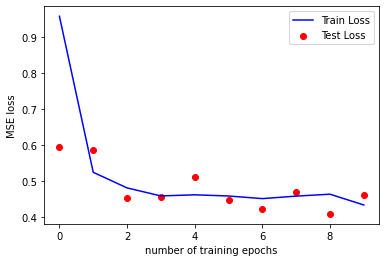

decryption accuracy is 88.07%


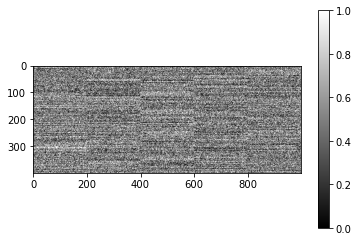

Parameters: 40 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([25, 42, 77, 74, 53, 73, 61, 75, 60,  3, 34, 70, 12, 80, 65, 31, 14, 45,
        63, 83, 17, 16, 19, 34, 21, 20, 10,  6, 76, 93, 90, 29, 93, 26, 42, 14,
         2, 14, 30, 48, 85, 68, 87, 61, 71, 30, 92,  2, 84, 58])
Epoch: 1, Train set: Avg. loss: 1.137178
Test set: Avg. loss: 0.755562
Epoch: 2, Train set: Avg. loss: 0.679345
Test set: Avg. loss: 0.697866
Epoch: 3, Train set: Avg. loss: 0.627350
Test set: Avg. loss: 0.561498
Epoch: 4, Train set: Avg. loss: 0.596979
Test set: Avg. loss: 0.660249
Epoch: 5, Train set: Avg. loss: 0.611802
Test set: Avg. loss: 0.563962
Epoch: 6, Train set: Avg. loss: 0.617826
Test set: Avg. loss: 0.664365
Epoch: 7, Train set: Avg. loss: 0.603306
Test set: Avg. loss: 0.524809
Epoch: 8, Train set: Avg. loss: 0.590918
Test set: Avg. loss: 0.678918
Epoch: 9, Train set: Avg. loss: 0.602659
Test set: Avg. loss: 0.576760
Epoch: 10, Train set: Avg. loss: 0.591556
Test set: Avg. loss: 0

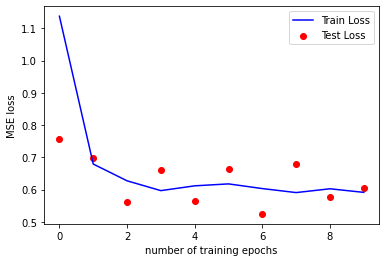

decryption accuracy is 84.63%


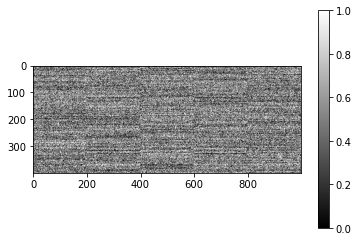

Parameters: 45 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([24, 74, 55, 43, 63, 81, 50, 18, 64, 63, 34, 59, 73, 68, 30,  8, 77, 75,
        27, 50, 62, 74, 23, 64, 87, 40, 10, 80, 51, 19, 83, 16, 43,  2, 40, 86,
        51, 36, 47, 23, 82, 88, 66, 69, 43,  2, 83, 17, 48, 54])
Epoch: 1, Train set: Avg. loss: 0.047196
Test set: Avg. loss: 0.003687
Epoch: 2, Train set: Avg. loss: 0.002808
Test set: Avg. loss: 0.001975
Epoch: 3, Train set: Avg. loss: 0.001645
Test set: Avg. loss: 0.001338
Epoch: 4, Train set: Avg. loss: 0.001196
Test set: Avg. loss: 0.001045
Epoch: 5, Train set: Avg. loss: 0.000981
Test set: Avg. loss: 0.000882
Epoch: 6, Train set: Avg. loss: 0.000826
Test set: Avg. loss: 0.000768
Epoch: 7, Train set: Avg. loss: 0.000716
Test set: Avg. loss: 0.000623
Epoch: 8, Train set: Avg. loss: 0.000600
Test set: Avg. loss: 0.000615
Epoch: 9, Train set: Avg. loss: 0.000605
Test set: Avg. loss: 0.000509
Epoch: 10, Train set: Avg. loss: 0.000484
Test set: Avg. loss: 0.000463


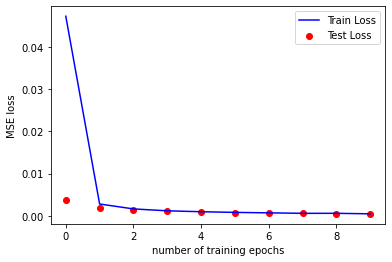

decryption accuracy is 100.0%


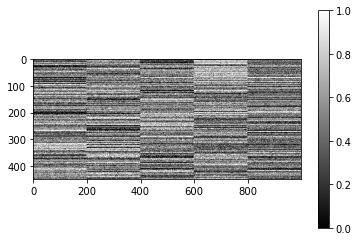

Parameters: 45 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([10, 33, 55, 50,  5,  7, 73, 49, 81, 61,  4, 76, 17, 68, 70, 66, 90, 13,
        30, 92, 89, 42, 32, 29, 18, 56, 81, 38, 85, 22, 67, 46, 22,  1, 74,  6,
        90, 43, 15, 31, 47,  4, 83, 60, 47, 26, 82, 43, 92, 62])
Epoch: 1, Train set: Avg. loss: 0.058565
Test set: Avg. loss: 0.005513
Epoch: 2, Train set: Avg. loss: 0.004053
Test set: Avg. loss: 0.002775
Epoch: 3, Train set: Avg. loss: 0.002433
Test set: Avg. loss: 0.001991
Epoch: 4, Train set: Avg. loss: 0.001912
Test set: Avg. loss: 0.001576
Epoch: 5, Train set: Avg. loss: 0.001545
Test set: Avg. loss: 0.001454
Epoch: 6, Train set: Avg. loss: 0.001181
Test set: Avg. loss: 0.001099
Epoch: 7, Train set: Avg. loss: 0.001066
Test set: Avg. loss: 0.000943
Epoch: 8, Train set: Avg. loss: 0.001016
Test set: Avg. loss: 0.000815
Epoch: 9, Train set: Avg. loss: 0.000818
Test set: Avg. loss: 0.000784
Epoch: 10, Train set: Avg. loss: 0.000928
Test set: Avg. loss: 0.000765


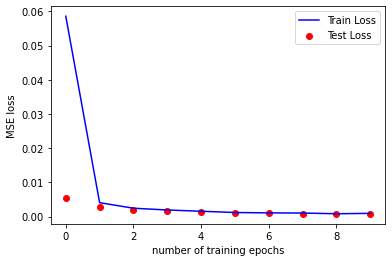

decryption accuracy is 100.0%


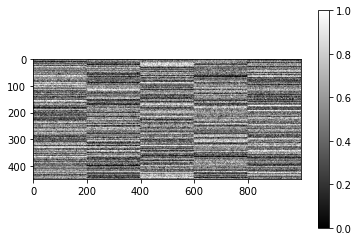

Parameters: 45 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([48, 47, 54, 40, 30, 23, 39, 87, 71, 26, 48, 93, 76, 83, 47, 43, 36, 25,
        84, 60, 91, 87, 50, 28, 86, 41, 27, 79, 50, 92, 35, 28, 12, 56, 63, 80,
        66,  0, 88, 14, 50,  2, 93, 55, 59, 23, 36, 52, 57, 41])
Epoch: 1, Train set: Avg. loss: 0.069204
Test set: Avg. loss: 0.007260
Epoch: 2, Train set: Avg. loss: 0.005736
Test set: Avg. loss: 0.003995
Epoch: 3, Train set: Avg. loss: 0.003579
Test set: Avg. loss: 0.002846
Epoch: 4, Train set: Avg. loss: 0.003065
Test set: Avg. loss: 0.002211
Epoch: 5, Train set: Avg. loss: 0.002210
Test set: Avg. loss: 0.002093
Epoch: 6, Train set: Avg. loss: 0.001915
Test set: Avg. loss: 0.001823
Epoch: 7, Train set: Avg. loss: 0.001864
Test set: Avg. loss: 0.001441
Epoch: 8, Train set: Avg. loss: 0.001404
Test set: Avg. loss: 0.001238
Epoch: 9, Train set: Avg. loss: 0.001381
Test set: Avg. loss: 0.001233
Epoch: 10, Train set: Avg. loss: 0.001284
Test set: Avg. loss: 0.001055


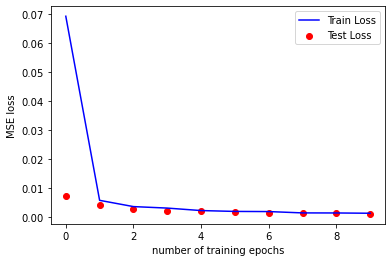

decryption accuracy is 99.99%


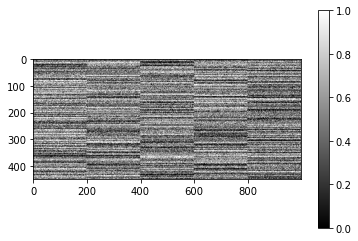

Parameters: 45 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([26, 57, 71, 54, 65, 19, 55, 38, 75, 27, 87, 63, 50, 89, 66, 36, 32, 76,
        67, 60, 13, 23, 27, 11, 90, 62, 52, 83, 64, 35, 90, 68, 61, 62, 21, 59,
        44, 40, 33, 88, 57, 65, 33, 53, 71, 63,  5, 83, 51, 92])
Epoch: 1, Train set: Avg. loss: 0.088975
Test set: Avg. loss: 0.012762
Epoch: 2, Train set: Avg. loss: 0.008570
Test set: Avg. loss: 0.006312
Epoch: 3, Train set: Avg. loss: 0.005654
Test set: Avg. loss: 0.004672
Epoch: 4, Train set: Avg. loss: 0.004405
Test set: Avg. loss: 0.003974
Epoch: 5, Train set: Avg. loss: 0.003364
Test set: Avg. loss: 0.003384
Epoch: 6, Train set: Avg. loss: 0.002898
Test set: Avg. loss: 0.002781
Epoch: 7, Train set: Avg. loss: 0.002738
Test set: Avg. loss: 0.002190
Epoch: 8, Train set: Avg. loss: 0.003229
Test set: Avg. loss: 0.002170
Epoch: 9, Train set: Avg. loss: 0.002422
Test set: Avg. loss: 0.002011
Epoch: 10, Train set: Avg. loss: 0.002154
Test set: Avg. loss: 0.001940


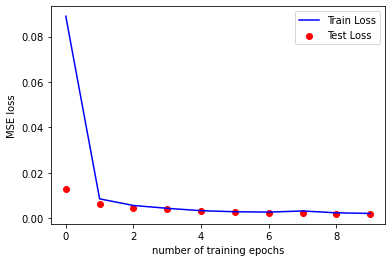

decryption accuracy is 99.93%


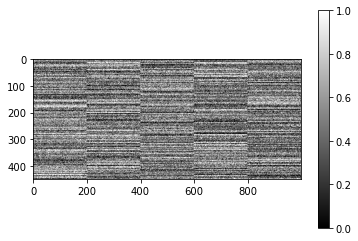

Parameters: 45 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([30, 90, 39, 69, 34, 31, 19, 14, 20, 66, 47,  2, 72, 75, 89, 24, 81, 84,
        57, 57,  4, 72, 27, 48, 63, 86, 93, 83, 11, 85, 67, 19, 51, 93,  4, 21,
        11, 28,  6, 82, 42, 51, 69, 21, 19, 39, 25, 31, 77, 51])
Epoch: 1, Train set: Avg. loss: 0.109333
Test set: Avg. loss: 0.014849
Epoch: 2, Train set: Avg. loss: 0.012953
Test set: Avg. loss: 0.009186
Epoch: 3, Train set: Avg. loss: 0.009160
Test set: Avg. loss: 0.008366
Epoch: 4, Train set: Avg. loss: 0.006659
Test set: Avg. loss: 0.005812
Epoch: 5, Train set: Avg. loss: 0.005864
Test set: Avg. loss: 0.005818
Epoch: 6, Train set: Avg. loss: 0.005289
Test set: Avg. loss: 0.004615
Epoch: 7, Train set: Avg. loss: 0.004497
Test set: Avg. loss: 0.008345
Epoch: 8, Train set: Avg. loss: 0.004443
Test set: Avg. loss: 0.003576
Epoch: 9, Train set: Avg. loss: 0.004338
Test set: Avg. loss: 0.003643
Epoch: 10, Train set: Avg. loss: 0.004100
Test set: Avg. loss: 0.003260


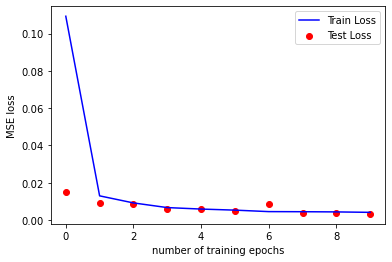

decryption accuracy is 99.95%


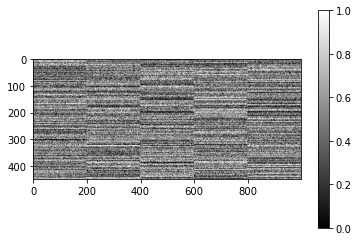

Parameters: 45 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([15, 31,  2, 88,  6, 59, 44,  3, 92, 16, 58, 80, 83, 38,  7, 64, 84, 61,
        29, 34, 18,  9, 32, 77,  9, 60, 20, 82, 18, 61, 82,  3, 35, 23, 90, 40,
        65, 59, 59, 93, 64,  0, 29, 18, 75, 62, 93, 28, 49, 37])
Epoch: 1, Train set: Avg. loss: 0.140269
Test set: Avg. loss: 0.023527
Epoch: 2, Train set: Avg. loss: 0.018421
Test set: Avg. loss: 0.027490
Epoch: 3, Train set: Avg. loss: 0.014516
Test set: Avg. loss: 0.011773
Epoch: 4, Train set: Avg. loss: 0.011220
Test set: Avg. loss: 0.008304
Epoch: 5, Train set: Avg. loss: 0.010080
Test set: Avg. loss: 0.007128
Epoch: 6, Train set: Avg. loss: 0.009406
Test set: Avg. loss: 0.015769
Epoch: 7, Train set: Avg. loss: 0.008054
Test set: Avg. loss: 0.007145
Epoch: 8, Train set: Avg. loss: 0.007581
Test set: Avg. loss: 0.006377
Epoch: 9, Train set: Avg. loss: 0.007755
Test set: Avg. loss: 0.006336
Epoch: 10, Train set: Avg. loss: 0.006980
Test set: Avg. loss: 0.005844


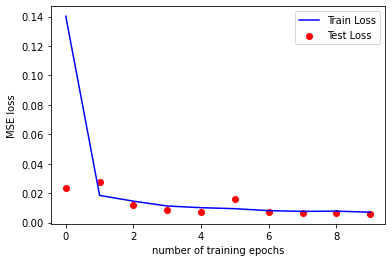

decryption accuracy is 99.9%


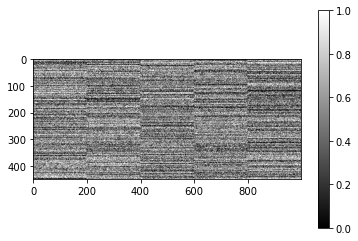

Parameters: 45 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([50, 64, 38,  5, 93, 89, 23, 22, 16, 29, 87, 63, 87, 18, 79, 23, 79,  1,
        31,  5, 34, 61, 45, 26, 32,  9, 38, 39, 85, 37, 83, 87, 81, 72, 87,  2,
        38, 81, 74, 56, 49, 34, 75, 10, 70,  2, 12, 89, 83, 24])
Epoch: 1, Train set: Avg. loss: 0.193743
Test set: Avg. loss: 0.036541
Epoch: 2, Train set: Avg. loss: 0.035714
Test set: Avg. loss: 0.031606
Epoch: 3, Train set: Avg. loss: 0.026940
Test set: Avg. loss: 0.025554
Epoch: 4, Train set: Avg. loss: 0.021804
Test set: Avg. loss: 0.018959
Epoch: 5, Train set: Avg. loss: 0.020320
Test set: Avg. loss: 0.018392
Epoch: 6, Train set: Avg. loss: 0.019029
Test set: Avg. loss: 0.027081
Epoch: 7, Train set: Avg. loss: 0.018462
Test set: Avg. loss: 0.016291
Epoch: 8, Train set: Avg. loss: 0.016647
Test set: Avg. loss: 0.022688
Epoch: 9, Train set: Avg. loss: 0.017875
Test set: Avg. loss: 0.011795
Epoch: 10, Train set: Avg. loss: 0.014302
Test set: Avg. loss: 

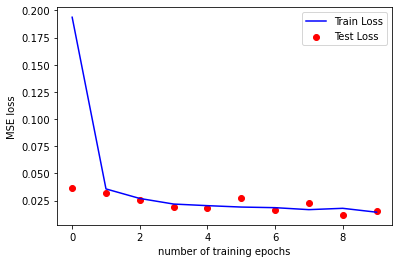

decryption accuracy is 99.6%


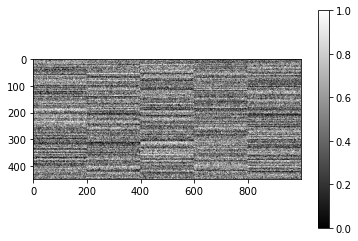

Parameters: 45 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([93, 10, 18, 15, 39, 50, 22,  3, 71, 68,  2,  3, 45, 87, 49, 61, 30, 57,
        56,  4, 71, 87, 32, 28, 25, 34, 71, 59, 55, 84, 11, 59, 22, 41, 28, 84,
        35, 13, 57, 41,  2, 75, 66, 86, 23, 36, 65, 23, 18, 59])
Epoch: 1, Train set: Avg. loss: 0.240555
Test set: Avg. loss: 0.053558
Epoch: 2, Train set: Avg. loss: 0.053430
Test set: Avg. loss: 0.057966
Epoch: 3, Train set: Avg. loss: 0.044376
Test set: Avg. loss: 0.035966
Epoch: 4, Train set: Avg. loss: 0.037797
Test set: Avg. loss: 0.044170
Epoch: 5, Train set: Avg. loss: 0.034055
Test set: Avg. loss: 0.029797
Epoch: 6, Train set: Avg. loss: 0.034031
Test set: Avg. loss: 0.025776
Epoch: 7, Train set: Avg. loss: 0.032501
Test set: Avg. loss: 0.026611
Epoch: 8, Train set: Avg. loss: 0.029529
Test set: Avg. loss: 0.034919
Epoch: 9, Train set: Avg. loss: 0.029566
Test set: Avg. loss: 0.026615
Epoch: 10, Train set: Avg. loss: 0.028296
Test set: Avg. loss: 0.025469


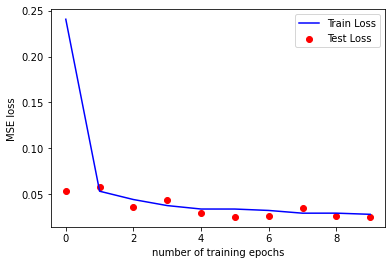

decryption accuracy is 99.25%


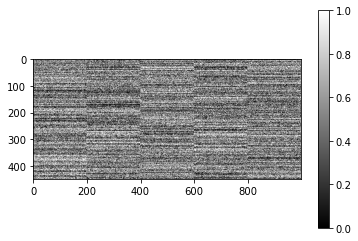

Parameters: 45 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([35, 22, 10, 91, 60, 88, 93, 93, 48,  1, 73, 61, 74, 60,  2, 77, 68, 27,
         8, 60, 29, 69,  1, 34, 59, 26, 40, 93, 73, 17, 22, 62, 45, 91, 10, 44,
        81, 29, 56, 31, 51, 61, 51, 29, 28, 42, 35, 69, 82, 43])
Epoch: 1, Train set: Avg. loss: 0.311557
Test set: Avg. loss: 0.140436
Epoch: 2, Train set: Avg. loss: 0.080191
Test set: Avg. loss: 0.062615
Epoch: 3, Train set: Avg. loss: 0.064799
Test set: Avg. loss: 0.078975
Epoch: 4, Train set: Avg. loss: 0.062202
Test set: Avg. loss: 0.065469
Epoch: 5, Train set: Avg. loss: 0.059265
Test set: Avg. loss: 0.042905
Epoch: 6, Train set: Avg. loss: 0.056711
Test set: Avg. loss: 0.061063
Epoch: 7, Train set: Avg. loss: 0.056675
Test set: Avg. loss: 0.042023
Epoch: 8, Train set: Avg. loss: 0.048555
Test set: Avg. loss: 0.055413
Epoch: 9, Train set: Avg. loss: 0.053452
Test set: Avg. loss: 0.053217
Epoch: 10, Train set: Avg. loss: 0.051032
Test set: Avg. loss: 0.057815


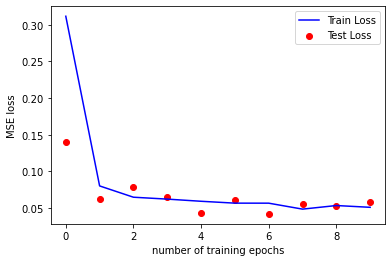

decryption accuracy is 98.5%


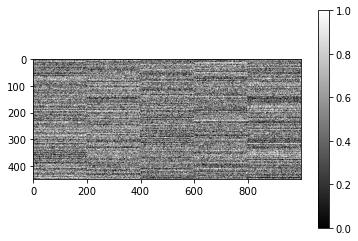

Parameters: 45 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([21, 72, 76, 39, 33, 67, 39, 72,  5, 37, 92,  3, 58, 76, 48, 21, 23, 59,
        23, 74, 39, 44, 46, 40, 30, 39,  0, 62, 70, 11, 29, 16, 73, 31, 67, 78,
        50,  5, 88, 53, 26, 37, 90, 51, 19, 34, 10, 93, 49,  5])
Epoch: 1, Train set: Avg. loss: 0.430891
Test set: Avg. loss: 0.138940
Epoch: 2, Train set: Avg. loss: 0.137849
Test set: Avg. loss: 0.123550
Epoch: 3, Train set: Avg. loss: 0.108380
Test set: Avg. loss: 0.113323
Epoch: 4, Train set: Avg. loss: 0.103445
Test set: Avg. loss: 0.102447
Epoch: 5, Train set: Avg. loss: 0.094205
Test set: Avg. loss: 0.083089
Epoch: 6, Train set: Avg. loss: 0.095261
Test set: Avg. loss: 0.086930
Epoch: 7, Train set: Avg. loss: 0.089534
Test set: Avg. loss: 0.072807
Epoch: 8, Train set: Avg. loss: 0.091776
Test set: Avg. loss: 0.086124
Epoch: 9, Train set: Avg. loss: 0.083523
Test set: Avg. loss: 0.078540
Epoch: 10, Train set: Avg. loss: 0.085818
Test set: Avg. loss: 0.097012


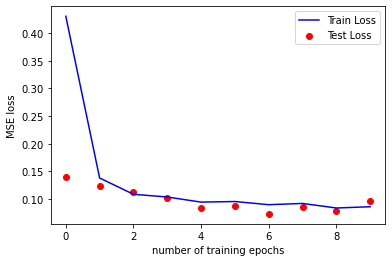

decryption accuracy is 97.25%


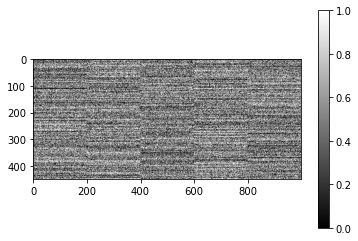

Parameters: 45 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([57, 15, 19,  7, 53, 78, 58, 71, 16, 52, 27, 46, 87, 92, 37, 32, 86,  6,
        19, 47, 57, 41, 39, 30, 69, 18, 65,  4, 46, 66, 92, 51, 90, 26, 19,  2,
        47, 74,  5, 53, 23, 12, 14, 48, 50, 13, 23, 85, 36, 57])
Epoch: 1, Train set: Avg. loss: 0.577014
Test set: Avg. loss: 0.251945
Epoch: 2, Train set: Avg. loss: 0.214795
Test set: Avg. loss: 0.250258
Epoch: 3, Train set: Avg. loss: 0.186000
Test set: Avg. loss: 0.167493
Epoch: 4, Train set: Avg. loss: 0.174621
Test set: Avg. loss: 0.160075
Epoch: 5, Train set: Avg. loss: 0.164622
Test set: Avg. loss: 0.205712
Epoch: 6, Train set: Avg. loss: 0.160920
Test set: Avg. loss: 0.274667
Epoch: 7, Train set: Avg. loss: 0.151250
Test set: Avg. loss: 0.160898
Epoch: 8, Train set: Avg. loss: 0.147143
Test set: Avg. loss: 0.144916
Epoch: 9, Train set: Avg. loss: 0.156718
Test set: Avg. loss: 0.169897
Epoch: 10, Train set: Avg. loss: 0.149894
Test set: Avg. loss: 0.159252


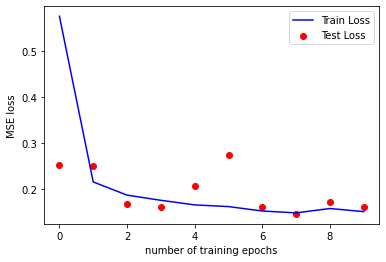

decryption accuracy is 95.84%


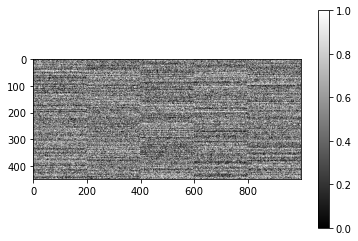

Parameters: 45 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([34, 16, 42, 58, 27, 11, 33, 65, 29,  6, 77, 49, 68, 71, 55, 10, 76, 12,
        14,  1, 59, 93, 33, 75, 51, 65, 48, 46, 66,  0, 42,  4, 20, 71, 47, 70,
        33, 18, 36, 65, 22, 62, 30, 58, 17,  7, 32, 19, 22, 90])
Epoch: 1, Train set: Avg. loss: 0.717059
Test set: Avg. loss: 0.304713
Epoch: 2, Train set: Avg. loss: 0.310937
Test set: Avg. loss: 0.349078
Epoch: 3, Train set: Avg. loss: 0.263839
Test set: Avg. loss: 0.252737
Epoch: 4, Train set: Avg. loss: 0.249485
Test set: Avg. loss: 0.246498
Epoch: 5, Train set: Avg. loss: 0.248506
Test set: Avg. loss: 0.249782
Epoch: 6, Train set: Avg. loss: 0.247748
Test set: Avg. loss: 0.245427
Epoch: 7, Train set: Avg. loss: 0.240881
Test set: Avg. loss: 0.185760
Epoch: 8, Train set: Avg. loss: 0.241289
Test set: Avg. loss: 0.226192
Epoch: 9, Train set: Avg. loss: 0.228194
Test set: Avg. loss: 0.229939
Epoch: 10, Train set: Avg. loss: 0.230071
Test set: Avg. loss: 0.191646


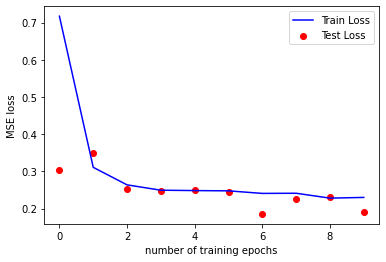

decryption accuracy is 94.43%


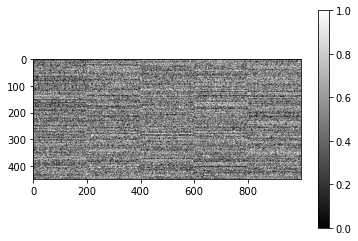

Parameters: 45 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([13, 33, 58, 87, 58, 54, 34, 12,  0,  1, 84, 55, 32, 57, 93, 80, 72, 39,
        64, 67, 87, 26, 87, 72, 85, 10, 72, 71, 15, 65, 40, 30, 60, 10, 79, 58,
         3, 71, 46, 46, 11, 78, 18, 71, 29, 52, 46, 38, 42, 45])
Epoch: 1, Train set: Avg. loss: 0.881154
Test set: Avg. loss: 0.564431
Epoch: 2, Train set: Avg. loss: 0.439406
Test set: Avg. loss: 0.403734
Epoch: 3, Train set: Avg. loss: 0.382015
Test set: Avg. loss: 0.453224
Epoch: 4, Train set: Avg. loss: 0.370443
Test set: Avg. loss: 0.383935
Epoch: 5, Train set: Avg. loss: 0.352559
Test set: Avg. loss: 0.355253
Epoch: 6, Train set: Avg. loss: 0.349766
Test set: Avg. loss: 0.354293
Epoch: 7, Train set: Avg. loss: 0.347144
Test set: Avg. loss: 0.311594
Epoch: 8, Train set: Avg. loss: 0.340536
Test set: Avg. loss: 0.374404
Epoch: 9, Train set: Avg. loss: 0.335232
Test set: Avg. loss: 0.355121
Epoch: 10, Train set: Avg. loss: 0.336229
Test set: Avg. loss: 0.315807


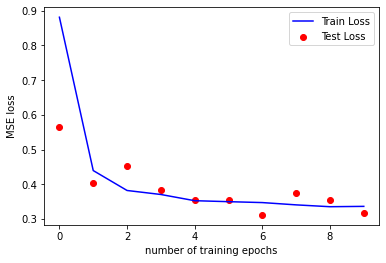

decryption accuracy is 91.35%


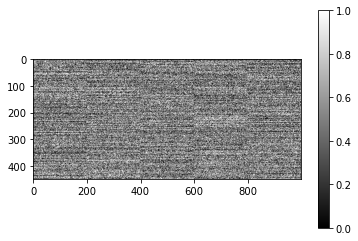

Parameters: 45 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([93, 21, 31, 87, 35, 82, 10, 55, 37, 74, 30,  8, 11, 22, 64, 31, 42, 44,
         4, 40, 58, 84, 45, 60, 57, 48, 80, 64, 49, 59, 25,  4, 41, 64,  7, 83,
        59, 30, 69, 72, 45, 13, 20, 22, 80, 26, 15,  4, 44, 91])
Epoch: 1, Train set: Avg. loss: 1.108341
Test set: Avg. loss: 0.571770
Epoch: 2, Train set: Avg. loss: 0.613659
Test set: Avg. loss: 0.504967
Epoch: 3, Train set: Avg. loss: 0.571154
Test set: Avg. loss: 0.587418
Epoch: 4, Train set: Avg. loss: 0.551458
Test set: Avg. loss: 0.506792
Epoch: 5, Train set: Avg. loss: 0.532332
Test set: Avg. loss: 0.486864
Epoch: 6, Train set: Avg. loss: 0.523464
Test set: Avg. loss: 0.502608
Epoch: 7, Train set: Avg. loss: 0.521797
Test set: Avg. loss: 0.482474
Epoch: 8, Train set: Avg. loss: 0.517836
Test set: Avg. loss: 0.490191
Epoch: 9, Train set: Avg. loss: 0.517555
Test set: Avg. loss: 0.459461
Epoch: 10, Train set: Avg. loss: 0.509438
Test set: Avg. loss: 0

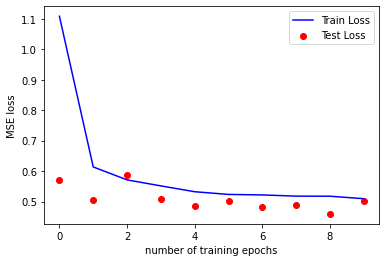

decryption accuracy is 87.62%


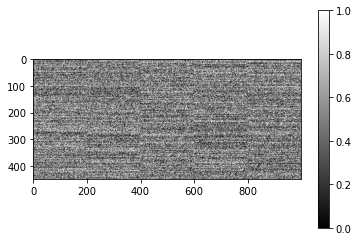

Parameters: 50 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([79, 75, 19, 49, 38,  7, 92, 40, 36, 82, 48, 10, 22, 69, 20, 40, 42, 93,
        76, 82, 31, 16, 87, 71, 70, 62, 14,  7, 90, 30, 91, 67, 74, 29,  3, 12,
        44, 19, 84, 36, 43, 61, 88, 53, 71, 59, 17, 93, 58, 84])
Epoch: 1, Train set: Avg. loss: 0.046179
Test set: Avg. loss: 0.003290
Epoch: 2, Train set: Avg. loss: 0.002334
Test set: Avg. loss: 0.001713
Epoch: 3, Train set: Avg. loss: 0.001443
Test set: Avg. loss: 0.001190
Epoch: 4, Train set: Avg. loss: 0.001122
Test set: Avg. loss: 0.000927
Epoch: 5, Train set: Avg. loss: 0.000822
Test set: Avg. loss: 0.000811
Epoch: 6, Train set: Avg. loss: 0.000690
Test set: Avg. loss: 0.000659
Epoch: 7, Train set: Avg. loss: 0.000615
Test set: Avg. loss: 0.000560
Epoch: 8, Train set: Avg. loss: 0.000548
Test set: Avg. loss: 0.000469
Epoch: 9, Train set: Avg. loss: 0.000479
Test set: Avg. loss: 0.000464
Epoch: 10, Train set: Avg. loss: 0.000418
Test set: Avg. loss: 0.000388


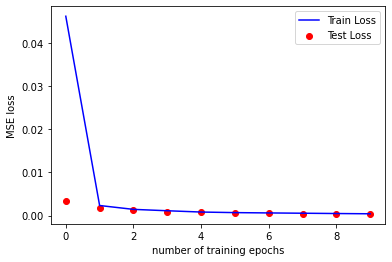

decryption accuracy is 100.0%


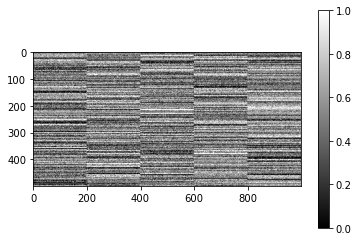

Parameters: 50 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([53, 70, 71, 36, 53, 73, 93, 84, 80, 69, 29, 88, 18, 31,  5, 55, 25, 43,
        32, 52, 78, 33, 34, 11, 20, 21, 33, 55, 83, 25, 51,  7, 18,  6, 83, 67,
        57, 89, 59, 61, 75, 44, 88, 68,  6, 39, 62, 27,  2, 66])
Epoch: 1, Train set: Avg. loss: 0.055319
Test set: Avg. loss: 0.004746
Epoch: 2, Train set: Avg. loss: 0.003291
Test set: Avg. loss: 0.002332
Epoch: 3, Train set: Avg. loss: 0.002008
Test set: Avg. loss: 0.001732
Epoch: 4, Train set: Avg. loss: 0.001495
Test set: Avg. loss: 0.001296
Epoch: 5, Train set: Avg. loss: 0.001250
Test set: Avg. loss: 0.001080
Epoch: 6, Train set: Avg. loss: 0.000988
Test set: Avg. loss: 0.000918
Epoch: 7, Train set: Avg. loss: 0.000877
Test set: Avg. loss: 0.000843
Epoch: 8, Train set: Avg. loss: 0.000910
Test set: Avg. loss: 0.001267
Epoch: 9, Train set: Avg. loss: 0.000782
Test set: Avg. loss: 0.000655
Epoch: 10, Train set: Avg. loss: 0.000683
Test set: Avg. loss: 0.000610


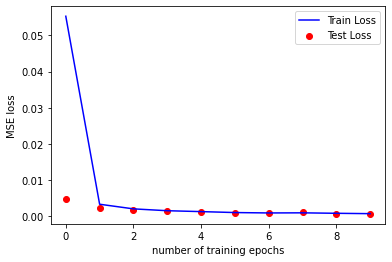

decryption accuracy is 100.0%


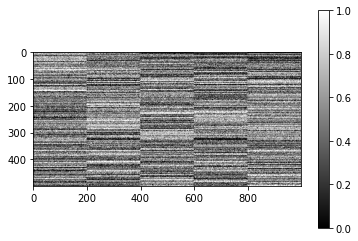

Parameters: 50 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([86,  8,  9, 54, 27, 63, 25, 16, 65, 40, 72, 57, 58, 76, 66, 41, 67, 57,
        39, 18, 16, 70, 15, 58, 12, 11, 13, 28, 93, 10, 68, 80, 65, 56, 30, 52,
        18, 46, 69, 27, 32, 66, 29, 29, 78, 86, 24, 34, 22,  6])
Epoch: 1, Train set: Avg. loss: 0.073455
Test set: Avg. loss: 0.006573
Epoch: 2, Train set: Avg. loss: 0.004739
Test set: Avg. loss: 0.003375
Epoch: 3, Train set: Avg. loss: 0.003079
Test set: Avg. loss: 0.002514
Epoch: 4, Train set: Avg. loss: 0.002296
Test set: Avg. loss: 0.001883
Epoch: 5, Train set: Avg. loss: 0.002014
Test set: Avg. loss: 0.001574
Epoch: 6, Train set: Avg. loss: 0.001854
Test set: Avg. loss: 0.001456
Epoch: 7, Train set: Avg. loss: 0.001507
Test set: Avg. loss: 0.001294
Epoch: 8, Train set: Avg. loss: 0.001306
Test set: Avg. loss: 0.001097
Epoch: 9, Train set: Avg. loss: 0.001471
Test set: Avg. loss: 0.001184
Epoch: 10, Train set: Avg. loss: 0.001615
Test set: Avg. loss: 0.000991


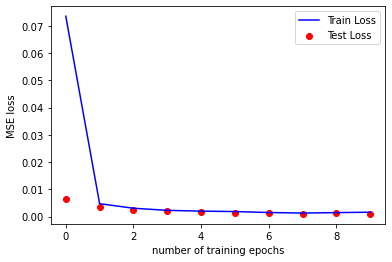

decryption accuracy is 99.98%


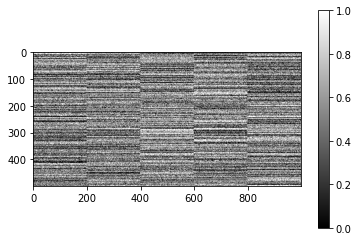

Parameters: 50 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([26, 50, 71,  1, 16, 28, 70, 50, 93, 65,  2,  1, 71, 56, 93, 12, 93, 67,
        23, 65, 12, 38, 55, 65, 78, 68, 19,  6, 30, 67,  5, 93, 86, 29, 30, 18,
        74,  6, 35, 80, 84,  3, 92, 78, 17, 42, 48, 61, 37, 61])
Epoch: 1, Train set: Avg. loss: 0.098811
Test set: Avg. loss: 0.008411
Epoch: 2, Train set: Avg. loss: 0.007158
Test set: Avg. loss: 0.004766
Epoch: 3, Train set: Avg. loss: 0.004510
Test set: Avg. loss: 0.003765
Epoch: 4, Train set: Avg. loss: 0.003249
Test set: Avg. loss: 0.002757
Epoch: 5, Train set: Avg. loss: 0.002782
Test set: Avg. loss: 0.002251
Epoch: 6, Train set: Avg. loss: 0.002163
Test set: Avg. loss: 0.002154
Epoch: 7, Train set: Avg. loss: 0.001899
Test set: Avg. loss: 0.002003
Epoch: 8, Train set: Avg. loss: 0.001697
Test set: Avg. loss: 0.001520
Epoch: 9, Train set: Avg. loss: 0.002012
Test set: Avg. loss: 0.001455
Epoch: 10, Train set: Avg. loss: 0.001558
Test set: Avg. loss: 0.001227


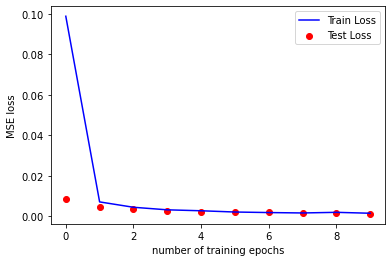

decryption accuracy is 100.0%


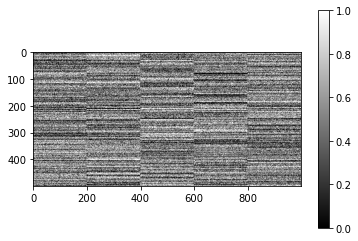

Parameters: 50 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([34, 80, 68, 79, 84, 42, 47, 51, 22, 19, 18, 88,  2, 90,  9, 91, 52,  3,
        74, 35, 51, 14, 21, 72, 26, 29, 44, 83, 41,  2, 20, 60, 31, 84, 78, 24,
        44,  5, 10, 48,  3, 15, 34, 39,  0, 20, 59, 70, 85, 67])
Epoch: 1, Train set: Avg. loss: 0.118453
Test set: Avg. loss: 0.014248
Epoch: 2, Train set: Avg. loss: 0.010094
Test set: Avg. loss: 0.008886
Epoch: 3, Train set: Avg. loss: 0.007177
Test set: Avg. loss: 0.005221
Epoch: 4, Train set: Avg. loss: 0.006327
Test set: Avg. loss: 0.005632
Epoch: 5, Train set: Avg. loss: 0.004839
Test set: Avg. loss: 0.004208
Epoch: 6, Train set: Avg. loss: 0.004362
Test set: Avg. loss: 0.003664
Epoch: 7, Train set: Avg. loss: 0.004046
Test set: Avg. loss: 0.003315
Epoch: 8, Train set: Avg. loss: 0.003964
Test set: Avg. loss: 0.003443
Epoch: 9, Train set: Avg. loss: 0.003563
Test set: Avg. loss: 0.003144
Epoch: 10, Train set: Avg. loss: 0.003277
Test set: Avg. loss: 0.003214


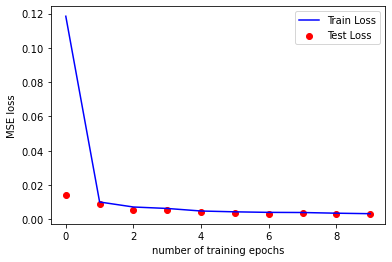

decryption accuracy is 99.96%


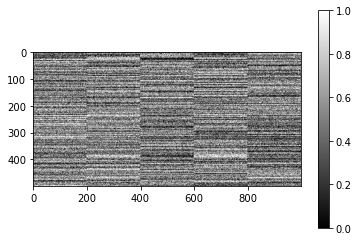

Parameters: 50 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([27, 63, 48, 66, 23, 28,  2, 12, 79, 24, 93, 78, 15, 64, 89, 67, 85, 32,
        25, 28, 92, 83, 68, 56, 20, 15, 67, 12, 48, 18, 47, 18, 92, 58, 44, 24,
        28, 12, 20, 27, 60, 47, 88, 61, 24, 40, 35, 53, 87, 46])
Epoch: 1, Train set: Avg. loss: 0.132489
Test set: Avg. loss: 0.018688
Epoch: 2, Train set: Avg. loss: 0.017079
Test set: Avg. loss: 0.010729
Epoch: 3, Train set: Avg. loss: 0.011944
Test set: Avg. loss: 0.015353
Epoch: 4, Train set: Avg. loss: 0.009698
Test set: Avg. loss: 0.017825
Epoch: 5, Train set: Avg. loss: 0.008862
Test set: Avg. loss: 0.009169
Epoch: 6, Train set: Avg. loss: 0.007128
Test set: Avg. loss: 0.006663
Epoch: 7, Train set: Avg. loss: 0.006314
Test set: Avg. loss: 0.007986
Epoch: 8, Train set: Avg. loss: 0.006083
Test set: Avg. loss: 0.005574
Epoch: 9, Train set: Avg. loss: 0.006008
Test set: Avg. loss: 0.012481
Epoch: 10, Train set: Avg. loss: 0.006582
Test set: Avg. loss: 0.010540


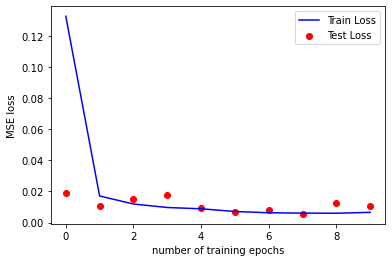

decryption accuracy is 99.75%


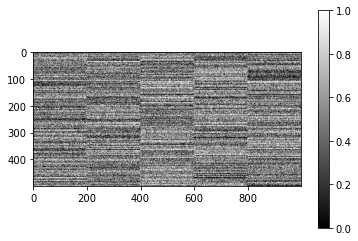

Parameters: 50 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([12, 14, 60, 39, 37,  6, 25, 70,  1, 15, 39, 93, 23, 46, 66, 93, 63, 38,
         7, 72, 85, 29, 10, 25, 76, 60, 39, 47, 89, 49, 56, 74, 75,  3, 49, 52,
        41, 85, 82, 17, 85, 87,  5, 15, 89, 64, 44,  8,  4, 61])
Epoch: 1, Train set: Avg. loss: 0.184599
Test set: Avg. loss: 0.031383
Epoch: 2, Train set: Avg. loss: 0.029972
Test set: Avg. loss: 0.021822
Epoch: 3, Train set: Avg. loss: 0.020429
Test set: Avg. loss: 0.014067
Epoch: 4, Train set: Avg. loss: 0.017250
Test set: Avg. loss: 0.019426
Epoch: 5, Train set: Avg. loss: 0.015620
Test set: Avg. loss: 0.021099
Epoch: 6, Train set: Avg. loss: 0.014089
Test set: Avg. loss: 0.012003
Epoch: 7, Train set: Avg. loss: 0.015120
Test set: Avg. loss: 0.013734
Epoch: 8, Train set: Avg. loss: 0.015451
Test set: Avg. loss: 0.010966
Epoch: 9, Train set: Avg. loss: 0.012811
Test set: Avg. loss: 0.010057
Epoch: 10, Train set: Avg. loss: 0.012065
Test set: Avg. loss: 

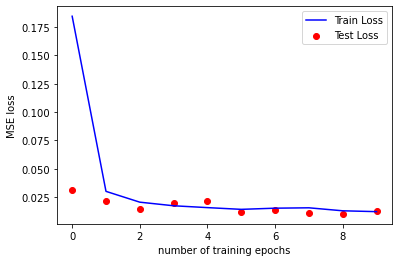

decryption accuracy is 99.68%


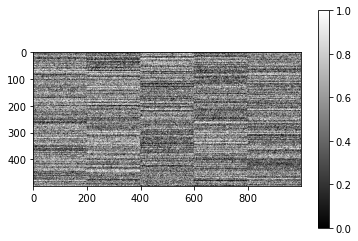

Parameters: 50 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([ 5, 62, 15, 58, 93, 27, 79, 20, 87, 64, 85, 50, 45, 86, 60, 71, 24,  2,
        87,  0, 35, 78, 71,  1, 71, 40, 81, 77, 40, 86, 14, 65, 20, 68, 36, 53,
        13, 55, 24, 76, 74, 64, 34, 44, 73, 18, 13, 54, 81, 11])
Epoch: 1, Train set: Avg. loss: 0.248795
Test set: Avg. loss: 0.044970
Epoch: 2, Train set: Avg. loss: 0.049288
Test set: Avg. loss: 0.040924
Epoch: 3, Train set: Avg. loss: 0.037840
Test set: Avg. loss: 0.036506
Epoch: 4, Train set: Avg. loss: 0.029575
Test set: Avg. loss: 0.024567
Epoch: 5, Train set: Avg. loss: 0.028297
Test set: Avg. loss: 0.028149
Epoch: 6, Train set: Avg. loss: 0.030737
Test set: Avg. loss: 0.021257
Epoch: 7, Train set: Avg. loss: 0.027057
Test set: Avg. loss: 0.033186
Epoch: 8, Train set: Avg. loss: 0.025766
Test set: Avg. loss: 0.023226
Epoch: 9, Train set: Avg. loss: 0.025357
Test set: Avg. loss: 0.021711
Epoch: 10, Train set: Avg. loss: 0.023793
Test set: Avg. loss: 0.019889


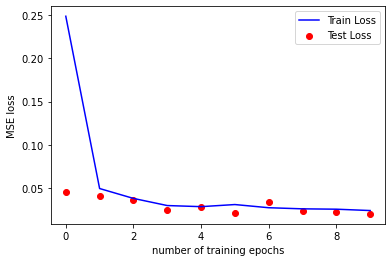

decryption accuracy is 99.53%


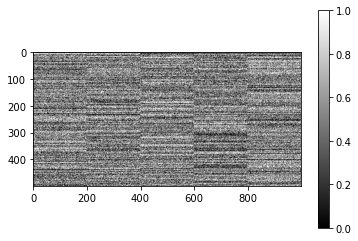

Parameters: 50 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([33, 40, 43,  1, 14, 11, 45, 77, 60, 27, 41, 47, 91,  8, 30, 70, 27, 82,
        18, 49, 26, 79, 76, 47, 40, 10, 37, 12, 92, 73, 58, 62, 83, 29, 64, 12,
         3, 76, 23, 17, 40, 74, 49, 11, 53,  2, 86, 28, 13,  7])
Epoch: 1, Train set: Avg. loss: 0.311526
Test set: Avg. loss: 0.106230
Epoch: 2, Train set: Avg. loss: 0.065888
Test set: Avg. loss: 0.050498
Epoch: 3, Train set: Avg. loss: 0.055501
Test set: Avg. loss: 0.039598
Epoch: 4, Train set: Avg. loss: 0.049565
Test set: Avg. loss: 0.038558
Epoch: 5, Train set: Avg. loss: 0.043185
Test set: Avg. loss: 0.061271
Epoch: 6, Train set: Avg. loss: 0.041161
Test set: Avg. loss: 0.036039
Epoch: 7, Train set: Avg. loss: 0.036862
Test set: Avg. loss: 0.047698
Epoch: 8, Train set: Avg. loss: 0.039143
Test set: Avg. loss: 0.068382
Epoch: 9, Train set: Avg. loss: 0.036684
Test set: Avg. loss: 0.038669
Epoch: 10, Train set: Avg. loss: 0.033588
Test set: Avg. loss: 0.036935


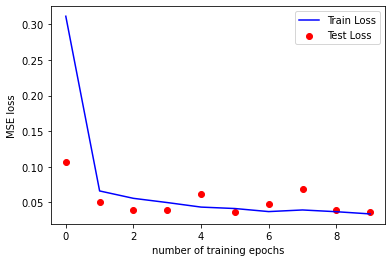

decryption accuracy is 99.01%


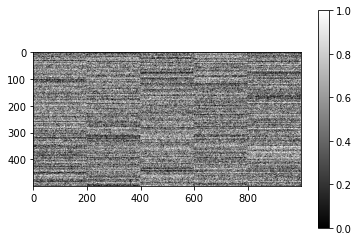

Parameters: 50 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([93, 10, 15, 65, 60, 19, 25, 37, 20, 89, 38, 83, 76, 63, 42, 20, 41, 49,
        71, 81, 37, 23, 49, 87, 72, 64, 63, 21, 60, 71, 50, 88,  6, 48, 74, 72,
        53, 78, 11, 18, 11,  4, 28,  8, 70, 27, 19, 88, 72, 81])
Epoch: 1, Train set: Avg. loss: 0.404446
Test set: Avg. loss: 0.124280
Epoch: 2, Train set: Avg. loss: 0.115493
Test set: Avg. loss: 0.083552
Epoch: 3, Train set: Avg. loss: 0.095589
Test set: Avg. loss: 0.125064
Epoch: 4, Train set: Avg. loss: 0.083850
Test set: Avg. loss: 0.068143
Epoch: 5, Train set: Avg. loss: 0.082560
Test set: Avg. loss: 0.061430
Epoch: 6, Train set: Avg. loss: 0.073923
Test set: Avg. loss: 0.055433
Epoch: 7, Train set: Avg. loss: 0.078400
Test set: Avg. loss: 0.073999
Epoch: 8, Train set: Avg. loss: 0.071826
Test set: Avg. loss: 0.066486
Epoch: 9, Train set: Avg. loss: 0.068866
Test set: Avg. loss: 0.060650
Epoch: 10, Train set: Avg. loss: 0.067404
Test set: Avg. loss: 0.101445


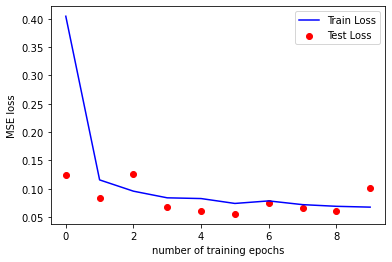

decryption accuracy is 97.06%


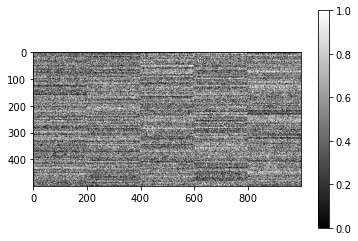

Parameters: 50 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([70, 55, 76,  6, 56, 58, 92, 19, 32, 49, 72, 92, 39, 22, 28, 77, 69, 50,
        77, 10, 50, 36, 28, 46, 15, 46, 76, 18, 64, 15, 66,  4, 84, 67, 73,  7,
        85, 71, 83, 45, 82, 63, 25,  0, 61, 25,  1, 33, 71, 13])
Epoch: 1, Train set: Avg. loss: 0.546792
Test set: Avg. loss: 0.200735
Epoch: 2, Train set: Avg. loss: 0.193382
Test set: Avg. loss: 0.170553
Epoch: 3, Train set: Avg. loss: 0.163507
Test set: Avg. loss: 0.144162
Epoch: 4, Train set: Avg. loss: 0.142212
Test set: Avg. loss: 0.136021
Epoch: 5, Train set: Avg. loss: 0.141206
Test set: Avg. loss: 0.112172
Epoch: 6, Train set: Avg. loss: 0.145712
Test set: Avg. loss: 0.112168
Epoch: 7, Train set: Avg. loss: 0.126062
Test set: Avg. loss: 0.099016
Epoch: 8, Train set: Avg. loss: 0.126805
Test set: Avg. loss: 0.130165
Epoch: 9, Train set: Avg. loss: 0.134505
Test set: Avg. loss: 0.124643
Epoch: 10, Train set: Avg. loss: 0.132285
Test set: Avg. loss: 0.139433


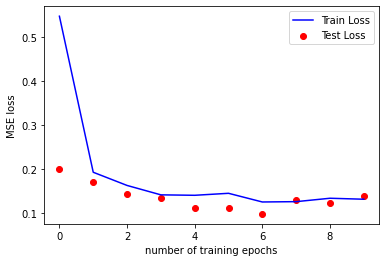

decryption accuracy is 96.18%


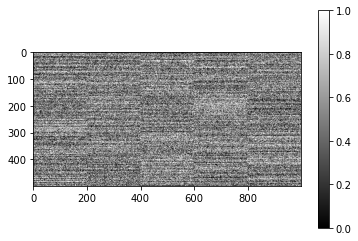

Parameters: 50 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([71, 61, 71,  9, 14, 80, 85, 22, 49, 40, 81, 91,  4, 13, 52, 37, 27, 87,
        24, 69, 85, 51, 76, 32, 53, 49, 32,  4, 11, 16, 84, 71, 44,  0, 86, 30,
        27, 92, 52,  0,  6, 83, 83, 75, 68, 68, 30, 66, 66, 68])
Epoch: 1, Train set: Avg. loss: 0.736616
Test set: Avg. loss: 0.297946
Epoch: 2, Train set: Avg. loss: 0.293119
Test set: Avg. loss: 0.295923
Epoch: 3, Train set: Avg. loss: 0.252820
Test set: Avg. loss: 0.226020
Epoch: 4, Train set: Avg. loss: 0.241644
Test set: Avg. loss: 0.216381
Epoch: 5, Train set: Avg. loss: 0.224844
Test set: Avg. loss: 0.261691
Epoch: 6, Train set: Avg. loss: 0.222276
Test set: Avg. loss: 0.196591
Epoch: 7, Train set: Avg. loss: 0.208712
Test set: Avg. loss: 0.217027
Epoch: 8, Train set: Avg. loss: 0.217313
Test set: Avg. loss: 0.216539
Epoch: 9, Train set: Avg. loss: 0.211557
Test set: Avg. loss: 0.218340
Epoch: 10, Train set: Avg. loss: 0.210944
Test set: Avg. loss: 0.185216


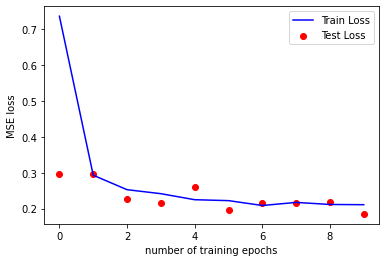

decryption accuracy is 94.32%


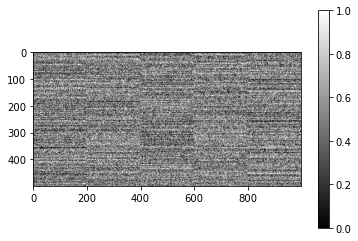

Parameters: 50 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([35, 72,  0, 27, 39, 48, 35, 39, 25, 69, 49, 12, 46, 83, 49, 37, 46, 92,
        80, 13,  3, 15, 26, 33, 85, 55, 18,  4, 68, 34,  5, 43, 72, 22, 62, 14,
        80, 46, 19, 64,  3, 76, 31, 82, 14, 17, 78,  4,  4, 68])
Epoch: 1, Train set: Avg. loss: 0.880124
Test set: Avg. loss: 0.390888
Epoch: 2, Train set: Avg. loss: 0.411042
Test set: Avg. loss: 0.407923
Epoch: 3, Train set: Avg. loss: 0.354583
Test set: Avg. loss: 0.289330
Epoch: 4, Train set: Avg. loss: 0.332385
Test set: Avg. loss: 0.342726
Epoch: 5, Train set: Avg. loss: 0.318402
Test set: Avg. loss: 0.283643
Epoch: 6, Train set: Avg. loss: 0.293375
Test set: Avg. loss: 0.270982
Epoch: 7, Train set: Avg. loss: 0.309521
Test set: Avg. loss: 0.324589
Epoch: 8, Train set: Avg. loss: 0.316529
Test set: Avg. loss: 0.269884
Epoch: 9, Train set: Avg. loss: 0.305935
Test set: Avg. loss: 0.263357
Epoch: 10, Train set: Avg. loss: 0.305741
Test set: Avg. loss: 0.288831


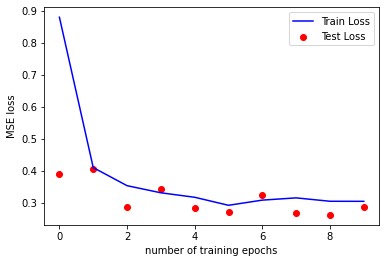

decryption accuracy is 92.01%


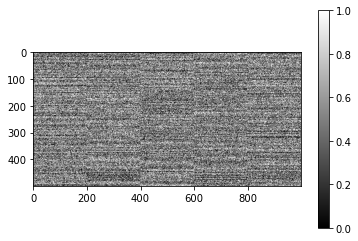

Parameters: 50 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([80, 13, 61,  3, 18, 39, 77, 59, 57,  1,  3, 88,  5, 93, 38, 63, 27, 71,
        89, 53, 29,  7, 42, 40, 42, 16, 57, 16, 10,  5,  4, 11, 65, 42,  0, 76,
         5, 88, 10, 41, 11, 26,  2, 45, 84, 69, 43, 40, 68, 21])
Epoch: 1, Train set: Avg. loss: 1.123905
Test set: Avg. loss: 0.616610
Epoch: 2, Train set: Avg. loss: 0.561241
Test set: Avg. loss: 0.470963
Epoch: 3, Train set: Avg. loss: 0.502965
Test set: Avg. loss: 0.526971
Epoch: 4, Train set: Avg. loss: 0.489298
Test set: Avg. loss: 0.481829
Epoch: 5, Train set: Avg. loss: 0.480301
Test set: Avg. loss: 0.429517
Epoch: 6, Train set: Avg. loss: 0.447792
Test set: Avg. loss: 0.501703
Epoch: 7, Train set: Avg. loss: 0.451519
Test set: Avg. loss: 0.482639
Epoch: 8, Train set: Avg. loss: 0.442543
Test set: Avg. loss: 0.421808
Epoch: 9, Train set: Avg. loss: 0.448649
Test set: Avg. loss: 0.404414
Epoch: 10, Train set: Avg. loss: 0.445502
Test set: Avg. loss: 0

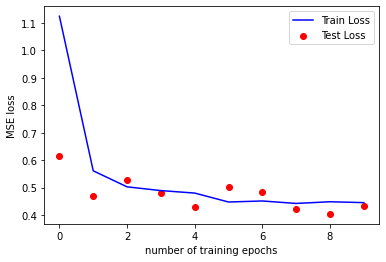

decryption accuracy is 89.45%


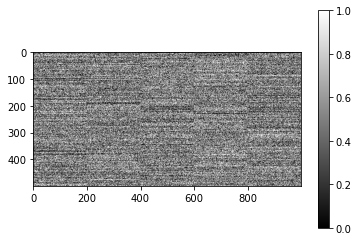

Parameters: 55 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([56, 86,  1, 75, 31, 68, 36, 91, 37, 76, 76, 30, 36, 46, 36, 77,  0, 14,
         5, 83, 63, 87, 21, 45, 21,  4, 53, 39,  2, 27, 69,  3,  9, 16, 45, 48,
        44, 75, 35, 93, 78, 21, 80, 10, 61, 29, 17, 89, 56,  7])
Epoch: 1, Train set: Avg. loss: 0.051420
Test set: Avg. loss: 0.002878
Epoch: 2, Train set: Avg. loss: 0.002016
Test set: Avg. loss: 0.001503
Epoch: 3, Train set: Avg. loss: 0.001226
Test set: Avg. loss: 0.001052
Epoch: 4, Train set: Avg. loss: 0.000906
Test set: Avg. loss: 0.000796
Epoch: 5, Train set: Avg. loss: 0.000713
Test set: Avg. loss: 0.001160
Epoch: 6, Train set: Avg. loss: 0.000604
Test set: Avg. loss: 0.000545
Epoch: 7, Train set: Avg. loss: 0.000522
Test set: Avg. loss: 0.000477
Epoch: 8, Train set: Avg. loss: 0.000472
Test set: Avg. loss: 0.000439
Epoch: 9, Train set: Avg. loss: 0.000390
Test set: Avg. loss: 0.000375
Epoch: 10, Train set: Avg. loss: 0.000357
Test set: Avg. loss: 0.000336


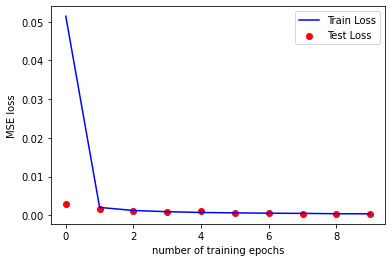

decryption accuracy is 100.0%


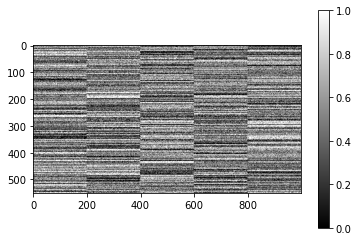

Parameters: 55 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([ 7,  9, 20, 38, 16, 75,  0, 12, 66, 31, 21,  5, 42, 56, 69, 32, 44, 71,
        28, 53, 52, 76, 29, 54, 65, 24, 28, 54, 73, 30, 68, 11, 42, 68, 74, 45,
        30, 89, 21,  4, 26, 92, 52, 88, 19, 18, 54, 14, 42, 86])
Epoch: 1, Train set: Avg. loss: 0.068288
Test set: Avg. loss: 0.003960
Epoch: 2, Train set: Avg. loss: 0.003049
Test set: Avg. loss: 0.002294
Epoch: 3, Train set: Avg. loss: 0.001922
Test set: Avg. loss: 0.001775
Epoch: 4, Train set: Avg. loss: 0.001335
Test set: Avg. loss: 0.001129
Epoch: 5, Train set: Avg. loss: 0.001144
Test set: Avg. loss: 0.001005
Epoch: 6, Train set: Avg. loss: 0.000876
Test set: Avg. loss: 0.000802
Epoch: 7, Train set: Avg. loss: 0.000795
Test set: Avg. loss: 0.000783
Epoch: 8, Train set: Avg. loss: 0.000728
Test set: Avg. loss: 0.000602
Epoch: 9, Train set: Avg. loss: 0.000629
Test set: Avg. loss: 0.000651
Epoch: 10, Train set: Avg. loss: 0.000677
Test set: Avg. loss: 0.000588


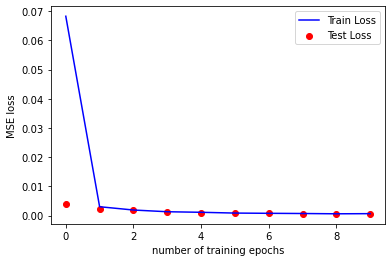

decryption accuracy is 100.0%


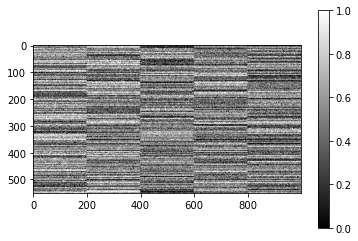

Parameters: 55 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([86,  4, 31, 28, 30,  7, 37, 46,  8, 87, 64, 65, 51, 77, 44, 57, 42, 31,
        23, 57, 61, 61, 20, 13, 40, 86, 78, 63, 43, 22, 26, 28, 42, 47, 10,  8,
        25, 73, 60, 87, 82, 59, 56, 27, 45,  7, 45, 18, 68, 50])
Epoch: 1, Train set: Avg. loss: 0.075346
Test set: Avg. loss: 0.006067
Epoch: 2, Train set: Avg. loss: 0.004488
Test set: Avg. loss: 0.002928
Epoch: 3, Train set: Avg. loss: 0.002639
Test set: Avg. loss: 0.002088
Epoch: 4, Train set: Avg. loss: 0.002006
Test set: Avg. loss: 0.001715
Epoch: 5, Train set: Avg. loss: 0.001463
Test set: Avg. loss: 0.001388
Epoch: 6, Train set: Avg. loss: 0.001368
Test set: Avg. loss: 0.001386
Epoch: 7, Train set: Avg. loss: 0.001114
Test set: Avg. loss: 0.001062
Epoch: 8, Train set: Avg. loss: 0.000938
Test set: Avg. loss: 0.000862
Epoch: 9, Train set: Avg. loss: 0.000867
Test set: Avg. loss: 0.000823
Epoch: 10, Train set: Avg. loss: 0.001047
Test set: Avg. loss: 0.000762


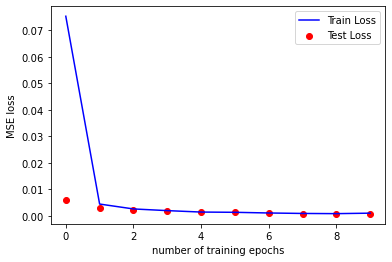

decryption accuracy is 100.0%


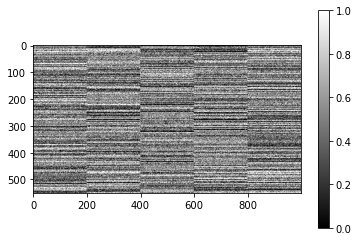

Parameters: 55 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([36, 23, 30, 14,  6, 36, 33, 92, 68, 73, 63, 38, 16, 10, 60, 63, 32, 81,
         3, 81, 44, 75, 83, 15, 14, 33,  6, 76, 68, 36, 24, 69, 54, 34, 39, 75,
        18, 10,  5, 88, 23,  4, 22, 51, 83, 33, 71, 64, 12, 80])
Epoch: 1, Train set: Avg. loss: 0.086060
Test set: Avg. loss: 0.008226
Epoch: 2, Train set: Avg. loss: 0.006318
Test set: Avg. loss: 0.004481
Epoch: 3, Train set: Avg. loss: 0.004377
Test set: Avg. loss: 0.003104
Epoch: 4, Train set: Avg. loss: 0.003366
Test set: Avg. loss: 0.002740
Epoch: 5, Train set: Avg. loss: 0.002684
Test set: Avg. loss: 0.002084
Epoch: 6, Train set: Avg. loss: 0.002438
Test set: Avg. loss: 0.001605
Epoch: 7, Train set: Avg. loss: 0.002014
Test set: Avg. loss: 0.001643
Epoch: 8, Train set: Avg. loss: 0.002136
Test set: Avg. loss: 0.001277
Epoch: 9, Train set: Avg. loss: 0.001795
Test set: Avg. loss: 0.001341
Epoch: 10, Train set: Avg. loss: 0.001251
Test set: Avg. loss: 0.001281


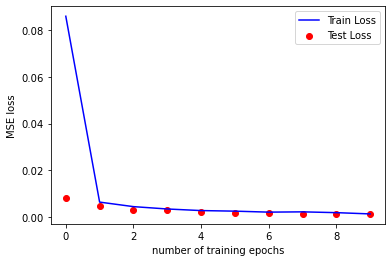

decryption accuracy is 99.98%


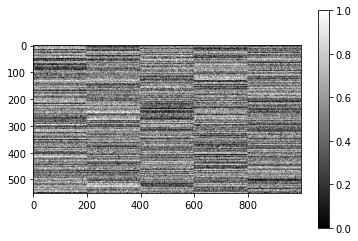

Parameters: 55 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([42, 20, 35, 75, 55, 21, 25, 34, 10, 28, 64, 13, 57, 68, 17, 16, 31, 18,
        21, 30, 47, 71, 20, 67, 76, 38,  3, 44, 15, 60, 85,  2, 33, 25, 90, 77,
        50,  8, 86, 24,  3, 61, 77, 42, 83, 83, 91, 18,  5, 16])
Epoch: 1, Train set: Avg. loss: 0.120638
Test set: Avg. loss: 0.012763
Epoch: 2, Train set: Avg. loss: 0.009094
Test set: Avg. loss: 0.005855
Epoch: 3, Train set: Avg. loss: 0.005331
Test set: Avg. loss: 0.004193
Epoch: 4, Train set: Avg. loss: 0.004281
Test set: Avg. loss: 0.003215
Epoch: 5, Train set: Avg. loss: 0.003360
Test set: Avg. loss: 0.002898
Epoch: 6, Train set: Avg. loss: 0.003526
Test set: Avg. loss: 0.002472
Epoch: 7, Train set: Avg. loss: 0.003123
Test set: Avg. loss: 0.002274
Epoch: 8, Train set: Avg. loss: 0.002923
Test set: Avg. loss: 0.003142
Epoch: 9, Train set: Avg. loss: 0.002317
Test set: Avg. loss: 0.002180
Epoch: 10, Train set: Avg. loss: 0.002232
Test set: Avg. loss: 0.001779


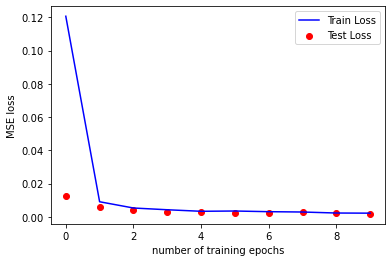

decryption accuracy is 99.98%


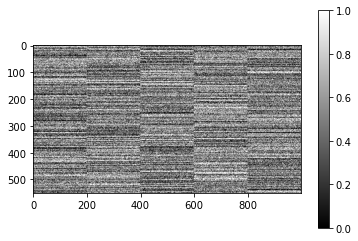

Parameters: 55 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([51, 83, 56, 72, 63, 11, 56, 80, 78, 27, 22, 80, 84, 41, 73, 70, 28, 32,
         1, 87, 17, 39, 54, 81, 76,  4, 63, 49, 24, 15, 26, 26, 31, 91, 62, 64,
        16, 47, 92, 57, 37,  9, 26, 56, 14, 35, 80, 71, 85, 60])
Epoch: 1, Train set: Avg. loss: 0.141018
Test set: Avg. loss: 0.016145
Epoch: 2, Train set: Avg. loss: 0.015937
Test set: Avg. loss: 0.009889
Epoch: 3, Train set: Avg. loss: 0.010585
Test set: Avg. loss: 0.013033
Epoch: 4, Train set: Avg. loss: 0.009785
Test set: Avg. loss: 0.006288
Epoch: 5, Train set: Avg. loss: 0.007100
Test set: Avg. loss: 0.006234
Epoch: 6, Train set: Avg. loss: 0.006664
Test set: Avg. loss: 0.005219
Epoch: 7, Train set: Avg. loss: 0.005676
Test set: Avg. loss: 0.004192
Epoch: 8, Train set: Avg. loss: 0.006608
Test set: Avg. loss: 0.004490
Epoch: 9, Train set: Avg. loss: 0.005621
Test set: Avg. loss: 0.004025
Epoch: 10, Train set: Avg. loss: 0.006248
Test set: Avg. loss: 0.003949


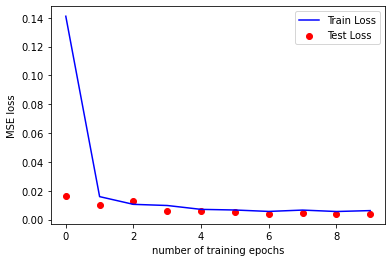

decryption accuracy is 99.94%


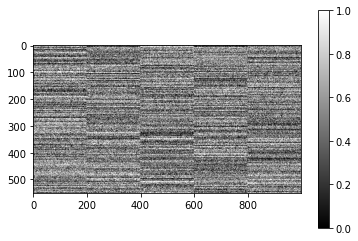

Parameters: 55 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([37, 61, 67, 62, 41, 72, 87,  1, 71, 22, 55, 23, 20, 35, 31, 57, 65,  8,
        26, 86, 48, 31, 40,  1, 67,  7, 68, 17, 72, 37, 24, 90, 92,  0, 82, 34,
        73,  6, 51, 26, 62, 17, 45, 45, 15, 85, 26,  0,  8, 66])
Epoch: 1, Train set: Avg. loss: 0.181219
Test set: Avg. loss: 0.031282
Epoch: 2, Train set: Avg. loss: 0.027260
Test set: Avg. loss: 0.019616
Epoch: 3, Train set: Avg. loss: 0.018342
Test set: Avg. loss: 0.021609
Epoch: 4, Train set: Avg. loss: 0.016317
Test set: Avg. loss: 0.040514
Epoch: 5, Train set: Avg. loss: 0.014563
Test set: Avg. loss: 0.013221
Epoch: 6, Train set: Avg. loss: 0.013780
Test set: Avg. loss: 0.009618
Epoch: 7, Train set: Avg. loss: 0.011165
Test set: Avg. loss: 0.009667
Epoch: 8, Train set: Avg. loss: 0.012665
Test set: Avg. loss: 0.042252
Epoch: 9, Train set: Avg. loss: 0.010269
Test set: Avg. loss: 0.017111
Epoch: 10, Train set: Avg. loss: 0.010084
Test set: Avg. loss: 

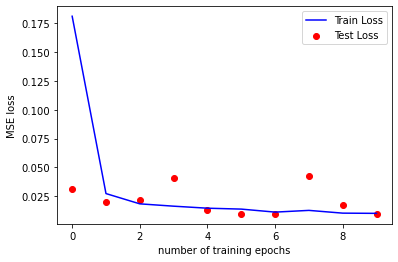

decryption accuracy is 99.79%


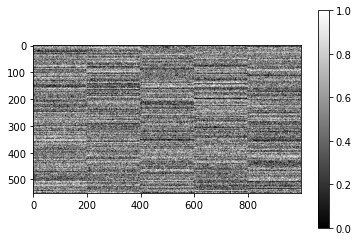

Parameters: 55 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([90, 27, 80, 89, 46, 21,  9, 52, 55,  5, 61, 75, 79,  1, 62, 31, 76, 38,
        11, 62, 57, 79, 31,  3, 74, 21, 67, 37,  6, 36, 20, 18, 48, 37, 59, 71,
        23, 64, 30, 70, 22, 36, 29, 61, 91, 41, 17, 88, 35, 65])
Epoch: 1, Train set: Avg. loss: 0.257711
Test set: Avg. loss: 0.048791
Epoch: 2, Train set: Avg. loss: 0.039414
Test set: Avg. loss: 0.028755
Epoch: 3, Train set: Avg. loss: 0.032917
Test set: Avg. loss: 0.052165
Epoch: 4, Train set: Avg. loss: 0.030780
Test set: Avg. loss: 0.020307
Epoch: 5, Train set: Avg. loss: 0.025277
Test set: Avg. loss: 0.031566
Epoch: 6, Train set: Avg. loss: 0.026622
Test set: Avg. loss: 0.048416
Epoch: 7, Train set: Avg. loss: 0.024690
Test set: Avg. loss: 0.015099
Epoch: 8, Train set: Avg. loss: 0.023386
Test set: Avg. loss: 0.020353
Epoch: 9, Train set: Avg. loss: 0.021993
Test set: Avg. loss: 0.020697
Epoch: 10, Train set: Avg. loss: 0.022814
Test set: Avg. loss: 0.013806


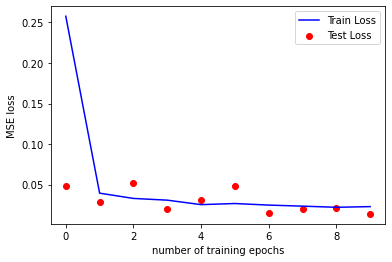

decryption accuracy is 99.67%


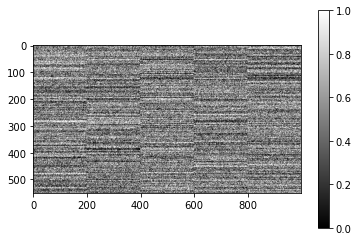

Parameters: 55 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([81,  8,  8, 75, 62, 22, 11, 85, 83, 19, 54, 74, 92, 33, 39, 88, 18, 15,
        86, 72, 68, 37,  9, 35, 62, 60, 81,  3, 84, 69, 63,  7,  6,  3, 62,  0,
        66, 35,  6, 45, 73, 83, 33, 69, 67, 56, 83,  0, 42, 49])
Epoch: 1, Train set: Avg. loss: 0.336760
Test set: Avg. loss: 0.072679
Epoch: 2, Train set: Avg. loss: 0.066604
Test set: Avg. loss: 0.044814
Epoch: 3, Train set: Avg. loss: 0.051009
Test set: Avg. loss: 0.045396
Epoch: 4, Train set: Avg. loss: 0.042411
Test set: Avg. loss: 0.032196
Epoch: 5, Train set: Avg. loss: 0.036838
Test set: Avg. loss: 0.030960
Epoch: 6, Train set: Avg. loss: 0.036080
Test set: Avg. loss: 0.030944
Epoch: 7, Train set: Avg. loss: 0.035654
Test set: Avg. loss: 0.031989
Epoch: 8, Train set: Avg. loss: 0.039209
Test set: Avg. loss: 0.033226
Epoch: 9, Train set: Avg. loss: 0.033514
Test set: Avg. loss: 0.028672
Epoch: 10, Train set: Avg. loss: 0.032636
Test set: Avg. loss: 0.031222


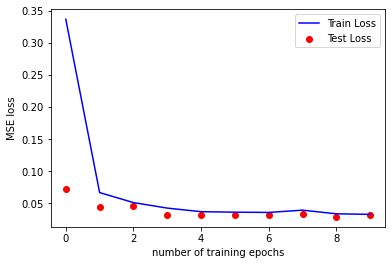

decryption accuracy is 99.21%


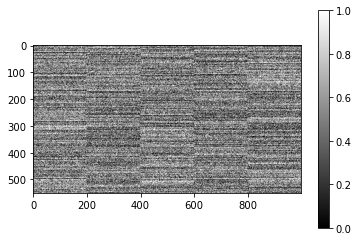

Parameters: 55 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([50, 83, 88, 79, 55, 66, 15, 68, 80,  1, 32, 20, 13,  9, 68, 70, 15, 28,
        21, 84, 27, 50, 15,  5, 68, 77, 79, 30, 31, 88, 27, 24, 18, 22, 65, 78,
        42, 24, 89, 91, 56, 19, 51,  1, 40, 57, 93, 25,  8, 81])
Epoch: 1, Train set: Avg. loss: 0.399283
Test set: Avg. loss: 0.124391
Epoch: 2, Train set: Avg. loss: 0.103899
Test set: Avg. loss: 0.094880
Epoch: 3, Train set: Avg. loss: 0.090004
Test set: Avg. loss: 0.064645
Epoch: 4, Train set: Avg. loss: 0.074060
Test set: Avg. loss: 0.069332
Epoch: 5, Train set: Avg. loss: 0.072428
Test set: Avg. loss: 0.083194
Epoch: 6, Train set: Avg. loss: 0.064871
Test set: Avg. loss: 0.060786
Epoch: 7, Train set: Avg. loss: 0.059000
Test set: Avg. loss: 0.051371
Epoch: 8, Train set: Avg. loss: 0.062504
Test set: Avg. loss: 0.048042
Epoch: 9, Train set: Avg. loss: 0.057521
Test set: Avg. loss: 0.071533
Epoch: 10, Train set: Avg. loss: 0.059268
Test set: Avg. loss: 0.135230


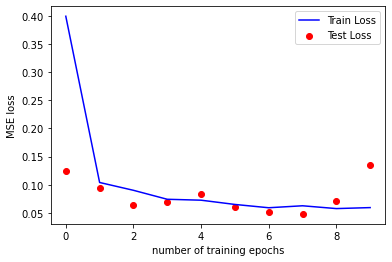

decryption accuracy is 97.18%


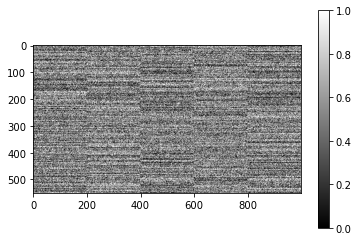

Parameters: 55 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([ 7, 83, 64, 30, 80,  5, 32, 30, 47, 30,  7, 23, 50, 34, 21, 81, 61,  2,
        86, 50, 86,  5,  8, 83, 52, 44, 71, 90, 23, 53, 50, 58, 55, 93, 11, 47,
        12, 44, 66, 18, 61, 73, 55, 49, 64, 83, 13, 59,  3, 68])
Epoch: 1, Train set: Avg. loss: 0.534826
Test set: Avg. loss: 0.150221
Epoch: 2, Train set: Avg. loss: 0.159253
Test set: Avg. loss: 0.263032
Epoch: 3, Train set: Avg. loss: 0.130394
Test set: Avg. loss: 0.135980
Epoch: 4, Train set: Avg. loss: 0.117954
Test set: Avg. loss: 0.113748
Epoch: 5, Train set: Avg. loss: 0.115202
Test set: Avg. loss: 0.153402
Epoch: 6, Train set: Avg. loss: 0.109416
Test set: Avg. loss: 0.089656
Epoch: 7, Train set: Avg. loss: 0.105347
Test set: Avg. loss: 0.103590
Epoch: 8, Train set: Avg. loss: 0.102141
Test set: Avg. loss: 0.131058
Epoch: 9, Train set: Avg. loss: 0.103152
Test set: Avg. loss: 0.115225
Epoch: 10, Train set: Avg. loss: 0.102087
Test set: Avg. loss: 0.121470


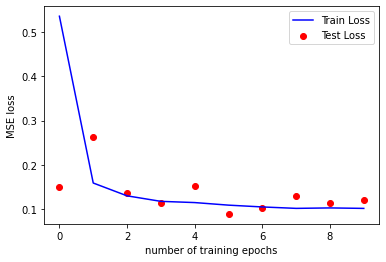

decryption accuracy is 96.66%


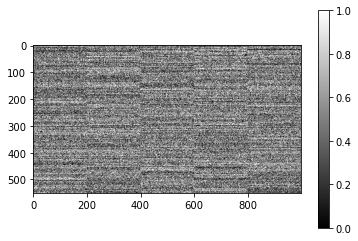

Parameters: 55 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([55, 58, 23, 50, 57, 41, 63, 58, 64, 30, 70, 38, 25, 90, 46, 87, 59, 46,
        93, 25,  3, 72, 71, 39, 11, 80, 21, 29, 64, 50, 89, 79, 47, 44, 30, 77,
        10, 84, 23, 81, 21, 23,  6, 23, 55, 65, 90, 85, 44, 33])
Epoch: 1, Train set: Avg. loss: 0.674020
Test set: Avg. loss: 0.286080
Epoch: 2, Train set: Avg. loss: 0.250484
Test set: Avg. loss: 0.220862
Epoch: 3, Train set: Avg. loss: 0.209784
Test set: Avg. loss: 0.204744
Epoch: 4, Train set: Avg. loss: 0.190401
Test set: Avg. loss: 0.181595
Epoch: 5, Train set: Avg. loss: 0.186194
Test set: Avg. loss: 0.171968
Epoch: 6, Train set: Avg. loss: 0.195251
Test set: Avg. loss: 0.159702
Epoch: 7, Train set: Avg. loss: 0.179646
Test set: Avg. loss: 0.159554
Epoch: 8, Train set: Avg. loss: 0.178696
Test set: Avg. loss: 0.173999
Epoch: 9, Train set: Avg. loss: 0.173152
Test set: Avg. loss: 0.155657
Epoch: 10, Train set: Avg. loss: 0.177701
Test set: Avg. loss: 0.141728


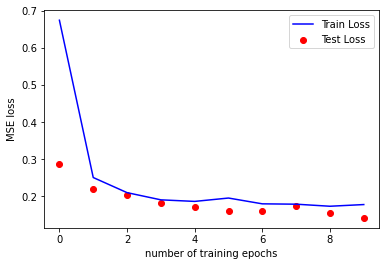

decryption accuracy is 96.03%


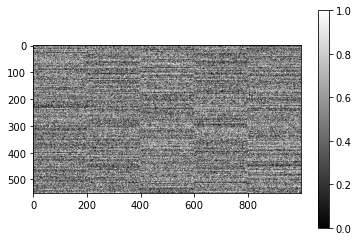

Parameters: 55 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([28, 45, 15, 29,  3,  8, 88, 12, 67, 87, 78, 71, 76, 59, 66,  2, 57, 77,
        14, 85, 71, 58, 42, 53, 40, 13, 66, 15, 30,  3, 61, 32, 40, 86, 53, 71,
        83, 85, 49, 86, 69, 81, 87, 25, 76, 41, 12, 21, 26, 27])
Epoch: 1, Train set: Avg. loss: 0.864633
Test set: Avg. loss: 0.441359
Epoch: 2, Train set: Avg. loss: 0.340977
Test set: Avg. loss: 0.464761
Epoch: 3, Train set: Avg. loss: 0.307023
Test set: Avg. loss: 0.283898
Epoch: 4, Train set: Avg. loss: 0.285300
Test set: Avg. loss: 0.266822
Epoch: 5, Train set: Avg. loss: 0.273688
Test set: Avg. loss: 0.287778
Epoch: 6, Train set: Avg. loss: 0.264178
Test set: Avg. loss: 0.254518
Epoch: 7, Train set: Avg. loss: 0.248417
Test set: Avg. loss: 0.220814
Epoch: 8, Train set: Avg. loss: 0.245771
Test set: Avg. loss: 0.285324
Epoch: 9, Train set: Avg. loss: 0.244403
Test set: Avg. loss: 0.257021
Epoch: 10, Train set: Avg. loss: 0.253205
Test set: Avg. loss: 0.221931


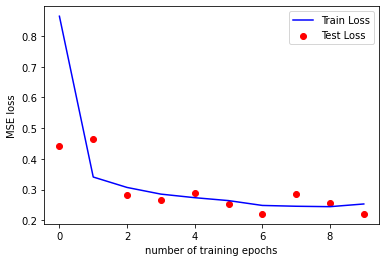

decryption accuracy is 94.04%


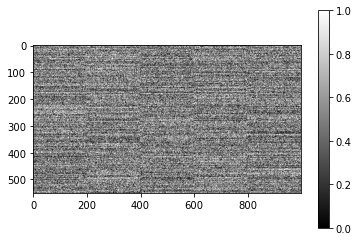

Parameters: 55 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([ 9, 11, 28, 29, 85, 81, 69, 55, 51, 34, 25, 92, 24, 22, 28,  1, 22, 62,
        77, 36, 70, 44, 65, 87, 43, 92, 35, 64, 28, 24, 72, 76, 43, 81,  9, 42,
        19, 14,  1, 17, 19, 34, 39,  2, 10, 23,  9, 35, 20,  5])
Epoch: 1, Train set: Avg. loss: 1.106056
Test set: Avg. loss: 0.608066
Epoch: 2, Train set: Avg. loss: 0.500462
Test set: Avg. loss: 0.392455
Epoch: 3, Train set: Avg. loss: 0.450339
Test set: Avg. loss: 0.432090
Epoch: 4, Train set: Avg. loss: 0.404202
Test set: Avg. loss: 0.505052
Epoch: 5, Train set: Avg. loss: 0.403631
Test set: Avg. loss: 0.383320
Epoch: 6, Train set: Avg. loss: 0.388317
Test set: Avg. loss: 0.369904
Epoch: 7, Train set: Avg. loss: 0.381871
Test set: Avg. loss: 0.399292
Epoch: 8, Train set: Avg. loss: 0.389801
Test set: Avg. loss: 0.356625
Epoch: 9, Train set: Avg. loss: 0.364458
Test set: Avg. loss: 0.390655
Epoch: 10, Train set: Avg. loss: 0.371095
Test set: Avg. loss: 0

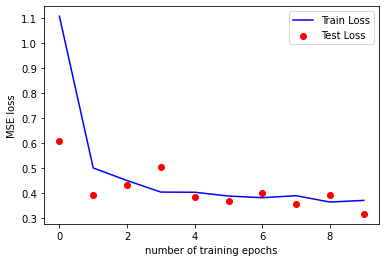

decryption accuracy is 92.16%


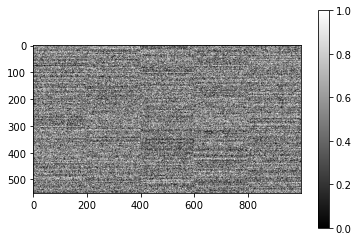

Parameters: 60 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([66, 84, 36, 25, 63, 41, 26, 43, 51, 33, 81, 33, 92, 33,  1, 77, 43, 22,
        44,  9, 46,  0, 21,  0, 34, 81, 31, 33, 67, 70, 24, 36, 53, 58, 84, 71,
        60, 45, 60, 80, 21, 49, 39, 72, 12, 35, 92, 30, 30, 80])
Epoch: 1, Train set: Avg. loss: 0.055882
Test set: Avg. loss: 0.002612
Epoch: 2, Train set: Avg. loss: 0.001828
Test set: Avg. loss: 0.001326
Epoch: 3, Train set: Avg. loss: 0.001109
Test set: Avg. loss: 0.000906
Epoch: 4, Train set: Avg. loss: 0.000811
Test set: Avg. loss: 0.000692
Epoch: 5, Train set: Avg. loss: 0.000638
Test set: Avg. loss: 0.000579
Epoch: 6, Train set: Avg. loss: 0.000543
Test set: Avg. loss: 0.000487
Epoch: 7, Train set: Avg. loss: 0.000452
Test set: Avg. loss: 0.000426
Epoch: 8, Train set: Avg. loss: 0.000389
Test set: Avg. loss: 0.000361
Epoch: 9, Train set: Avg. loss: 0.000345
Test set: Avg. loss: 0.000359
Epoch: 10, Train set: Avg. loss: 0.000323
Test set: Avg. loss: 0.000318


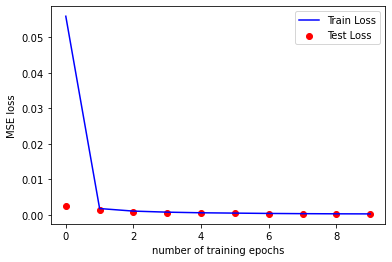

decryption accuracy is 100.0%


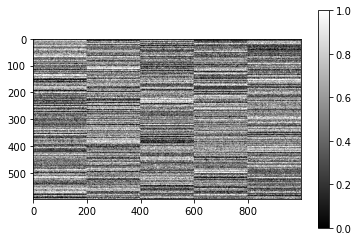

Parameters: 60 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([17, 57, 79, 84,  8, 36, 71, 65, 33, 54, 53, 18, 63, 82, 53, 39, 92, 28,
        85, 71, 70, 56, 14, 84, 68, 62,  4, 55, 44, 21, 73, 22, 37, 84,  3, 62,
        67, 61, 40, 11,  3, 64, 38, 83, 32, 49, 54, 79, 32, 91])
Epoch: 1, Train set: Avg. loss: 0.081698
Test set: Avg. loss: 0.003385
Epoch: 2, Train set: Avg. loss: 0.002498
Test set: Avg. loss: 0.001798
Epoch: 3, Train set: Avg. loss: 0.001506
Test set: Avg. loss: 0.001484
Epoch: 4, Train set: Avg. loss: 0.001176
Test set: Avg. loss: 0.001027
Epoch: 5, Train set: Avg. loss: 0.000880
Test set: Avg. loss: 0.000789
Epoch: 6, Train set: Avg. loss: 0.000736
Test set: Avg. loss: 0.000645
Epoch: 7, Train set: Avg. loss: 0.000646
Test set: Avg. loss: 0.000558
Epoch: 8, Train set: Avg. loss: 0.000543
Test set: Avg. loss: 0.000547
Epoch: 9, Train set: Avg. loss: 0.000492
Test set: Avg. loss: 0.000512
Epoch: 10, Train set: Avg. loss: 0.000476
Test set: Avg. loss: 0.000431


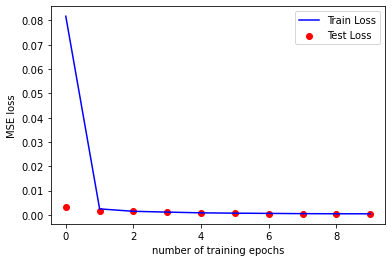

decryption accuracy is 100.0%


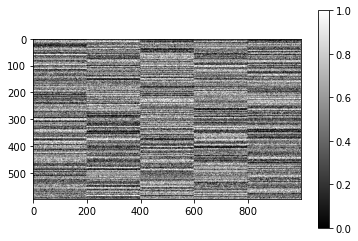

Parameters: 60 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([62, 38, 60, 16, 69, 42, 50, 29, 93, 37, 48, 40, 47, 74, 38, 29, 90, 34,
        10, 34, 23, 37, 58, 45, 34, 66, 20, 46, 40, 75, 75,  2, 54, 82, 27, 12,
        81, 60, 14, 57, 60, 21, 14, 16, 43,  2, 55, 37, 25, 77])
Epoch: 1, Train set: Avg. loss: 0.076334
Test set: Avg. loss: 0.004648
Epoch: 2, Train set: Avg. loss: 0.003450
Test set: Avg. loss: 0.002584
Epoch: 3, Train set: Avg. loss: 0.002430
Test set: Avg. loss: 0.001704
Epoch: 4, Train set: Avg. loss: 0.001725
Test set: Avg. loss: 0.001456
Epoch: 5, Train set: Avg. loss: 0.001488
Test set: Avg. loss: 0.001193
Epoch: 6, Train set: Avg. loss: 0.001135
Test set: Avg. loss: 0.000957
Epoch: 7, Train set: Avg. loss: 0.001141
Test set: Avg. loss: 0.000894
Epoch: 8, Train set: Avg. loss: 0.000893
Test set: Avg. loss: 0.000777
Epoch: 9, Train set: Avg. loss: 0.000868
Test set: Avg. loss: 0.000670
Epoch: 10, Train set: Avg. loss: 0.000652
Test set: Avg. loss: 0.000593


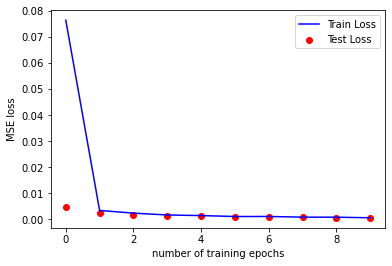

decryption accuracy is 100.0%


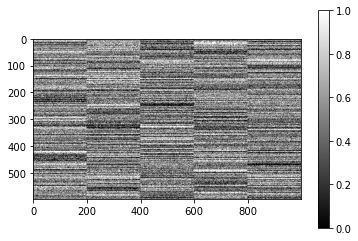

Parameters: 60 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([ 8, 53, 50,  6, 60, 24, 57, 71, 58, 83, 29, 57, 53, 79, 84, 47, 84, 71,
        67, 44, 77, 60, 30, 40, 41, 85, 68, 35,  3, 86, 23,  0, 61, 80, 92, 62,
        80, 34, 85, 11, 69, 51, 70, 37, 33, 60, 31, 52, 75, 63])
Epoch: 1, Train set: Avg. loss: 0.118758
Test set: Avg. loss: 0.006486
Epoch: 2, Train set: Avg. loss: 0.006038
Test set: Avg. loss: 0.025357
Epoch: 3, Train set: Avg. loss: 0.003717
Test set: Avg. loss: 0.002707
Epoch: 4, Train set: Avg. loss: 0.003034
Test set: Avg. loss: 0.002230
Epoch: 5, Train set: Avg. loss: 0.002715
Test set: Avg. loss: 0.003616
Epoch: 6, Train set: Avg. loss: 0.002157
Test set: Avg. loss: 0.002169
Epoch: 7, Train set: Avg. loss: 0.002248
Test set: Avg. loss: 0.004125
Epoch: 8, Train set: Avg. loss: 0.002277
Test set: Avg. loss: 0.001522
Epoch: 9, Train set: Avg. loss: 0.001800
Test set: Avg. loss: 0.001694
Epoch: 10, Train set: Avg. loss: 0.001342
Test set: Avg. loss: 0.001189


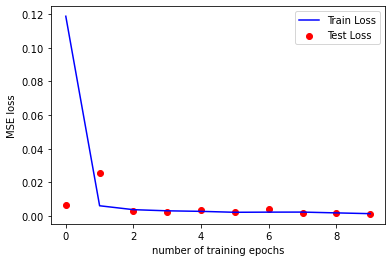

decryption accuracy is 99.99%


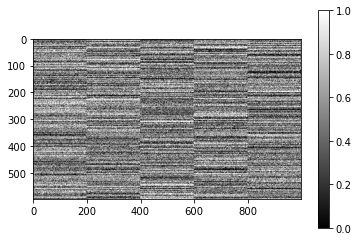

Parameters: 60 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([82, 67, 59, 54, 68, 20, 56, 53, 22, 33, 58, 23, 82, 17, 17, 25, 49, 69,
        54, 93, 32, 47, 80, 45, 11, 53,  8, 68, 56, 12, 89, 61, 79, 31, 51, 43,
        30,  1, 38, 38, 34, 10, 86, 61, 54, 82, 23, 66, 11, 36])
Epoch: 1, Train set: Avg. loss: 0.108156
Test set: Avg. loss: 0.022921
Epoch: 2, Train set: Avg. loss: 0.007591
Test set: Avg. loss: 0.008672
Epoch: 3, Train set: Avg. loss: 0.005186
Test set: Avg. loss: 0.017345
Epoch: 4, Train set: Avg. loss: 0.004297
Test set: Avg. loss: 0.004243
Epoch: 5, Train set: Avg. loss: 0.003018
Test set: Avg. loss: 0.002327
Epoch: 6, Train set: Avg. loss: 0.002765
Test set: Avg. loss: 0.003242
Epoch: 7, Train set: Avg. loss: 0.002566
Test set: Avg. loss: 0.003427
Epoch: 8, Train set: Avg. loss: 0.002125
Test set: Avg. loss: 0.002258
Epoch: 9, Train set: Avg. loss: 0.001932
Test set: Avg. loss: 0.001499
Epoch: 10, Train set: Avg. loss: 0.001674
Test set: Avg. loss: 0.001745


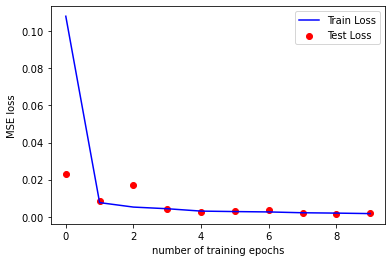

decryption accuracy is 99.98%


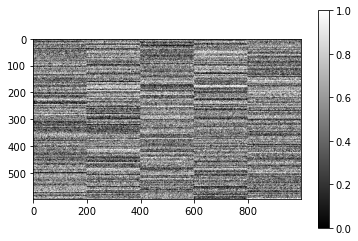

Parameters: 60 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([42, 42,  9, 59, 56, 38, 85, 24, 72, 57, 10, 45, 88, 63, 61, 31, 47, 49,
        91, 24, 84,  6, 68, 86, 81, 40, 84, 55, 16, 78, 17, 89, 88, 19, 57, 39,
        75, 59, 30,  4, 24,  8, 79, 52, 89, 25, 61,  7, 15, 57])
Epoch: 1, Train set: Avg. loss: 0.144406
Test set: Avg. loss: 0.013568
Epoch: 2, Train set: Avg. loss: 0.012925
Test set: Avg. loss: 0.008398
Epoch: 3, Train set: Avg. loss: 0.008450
Test set: Avg. loss: 0.006227
Epoch: 4, Train set: Avg. loss: 0.007700
Test set: Avg. loss: 0.009498
Epoch: 5, Train set: Avg. loss: 0.005746
Test set: Avg. loss: 0.004001
Epoch: 6, Train set: Avg. loss: 0.005380
Test set: Avg. loss: 0.011219
Epoch: 7, Train set: Avg. loss: 0.005769
Test set: Avg. loss: 0.004295
Epoch: 8, Train set: Avg. loss: 0.004550
Test set: Avg. loss: 0.006302
Epoch: 9, Train set: Avg. loss: 0.003571
Test set: Avg. loss: 0.005477
Epoch: 10, Train set: Avg. loss: 0.004438
Test set: Avg. loss: 0.002604


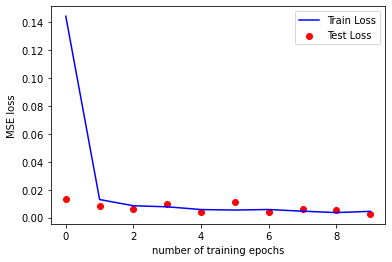

decryption accuracy is 99.91%


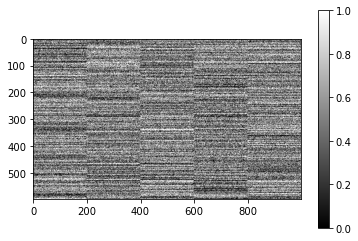

Parameters: 60 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([51, 73, 75, 40, 50, 86,  3, 62, 15, 36, 83, 44, 44, 47, 47, 22,  4, 20,
        56, 18, 41, 67, 17, 57, 59, 15, 84,  5, 93, 71, 65, 92, 80, 40, 42, 27,
        10, 20, 33, 36, 66, 30, 59, 28, 32, 17, 26, 46, 79, 93])
Epoch: 1, Train set: Avg. loss: 0.198968
Test set: Avg. loss: 0.021043
Epoch: 2, Train set: Avg. loss: 0.023416
Test set: Avg. loss: 0.016292
Epoch: 3, Train set: Avg. loss: 0.016042
Test set: Avg. loss: 0.012196
Epoch: 4, Train set: Avg. loss: 0.014209
Test set: Avg. loss: 0.009317
Epoch: 5, Train set: Avg. loss: 0.012304
Test set: Avg. loss: 0.007835
Epoch: 6, Train set: Avg. loss: 0.010257
Test set: Avg. loss: 0.009226
Epoch: 7, Train set: Avg. loss: 0.009177
Test set: Avg. loss: 0.008522
Epoch: 8, Train set: Avg. loss: 0.009460
Test set: Avg. loss: 0.008499
Epoch: 9, Train set: Avg. loss: 0.007527
Test set: Avg. loss: 0.005780
Epoch: 10, Train set: Avg. loss: 0.009669
Test set: Avg. loss: 

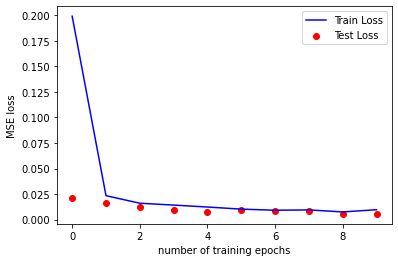

decryption accuracy is 99.84%


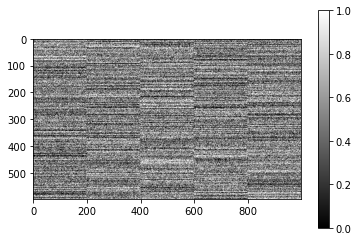

Parameters: 60 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([30, 73, 28, 26, 43, 37, 25, 14, 28, 49, 82, 13, 27, 20, 67, 38, 78, 22,
        76, 11, 87, 84,  0, 54, 93, 14, 15, 24, 79, 16, 59, 48, 29, 71, 10, 71,
        11, 36, 42, 76, 10, 21, 34,  6, 13,  7, 90, 65, 90, 79])
Epoch: 1, Train set: Avg. loss: 0.270324
Test set: Avg. loss: 0.042225
Epoch: 2, Train set: Avg. loss: 0.037447
Test set: Avg. loss: 0.043203
Epoch: 3, Train set: Avg. loss: 0.028622
Test set: Avg. loss: 0.021315
Epoch: 4, Train set: Avg. loss: 0.025467
Test set: Avg. loss: 0.022463
Epoch: 5, Train set: Avg. loss: 0.021293
Test set: Avg. loss: 0.018444
Epoch: 6, Train set: Avg. loss: 0.021032
Test set: Avg. loss: 0.046273
Epoch: 7, Train set: Avg. loss: 0.022461
Test set: Avg. loss: 0.017206
Epoch: 8, Train set: Avg. loss: 0.021663
Test set: Avg. loss: 0.015659
Epoch: 9, Train set: Avg. loss: 0.018558
Test set: Avg. loss: 0.017957
Epoch: 10, Train set: Avg. loss: 0.018288
Test set: Avg. loss: 0.015686


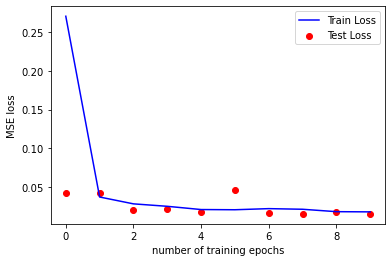

decryption accuracy is 99.64%


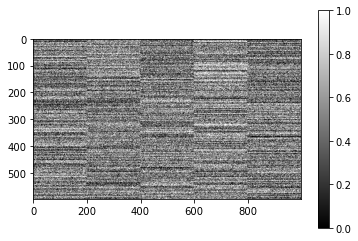

Parameters: 60 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([40, 40,  2, 15, 75, 32, 18, 43, 83, 46, 39, 85, 13, 84, 49, 64, 45, 47,
        18, 60, 24, 62, 23,  2, 54, 75, 31, 63,  0, 66, 59, 62, 52, 59, 49, 59,
        27,  2, 50, 82, 80, 75,  2, 58, 72, 36, 86, 13, 85, 78])
Epoch: 1, Train set: Avg. loss: 0.325529
Test set: Avg. loss: 0.104494
Epoch: 2, Train set: Avg. loss: 0.052432
Test set: Avg. loss: 0.059153
Epoch: 3, Train set: Avg. loss: 0.046226
Test set: Avg. loss: 0.034242
Epoch: 4, Train set: Avg. loss: 0.034630
Test set: Avg. loss: 0.023189
Epoch: 5, Train set: Avg. loss: 0.032266
Test set: Avg. loss: 0.027821
Epoch: 6, Train set: Avg. loss: 0.033546
Test set: Avg. loss: 0.028310
Epoch: 7, Train set: Avg. loss: 0.027263
Test set: Avg. loss: 0.021149
Epoch: 8, Train set: Avg. loss: 0.026968
Test set: Avg. loss: 0.028702
Epoch: 9, Train set: Avg. loss: 0.027088
Test set: Avg. loss: 0.037989
Epoch: 10, Train set: Avg. loss: 0.026536
Test set: Avg. loss: 0.021846


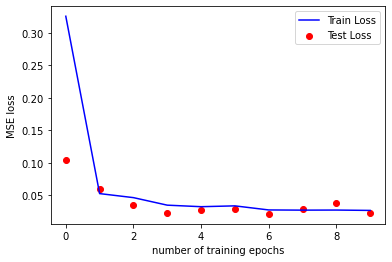

decryption accuracy is 99.33%


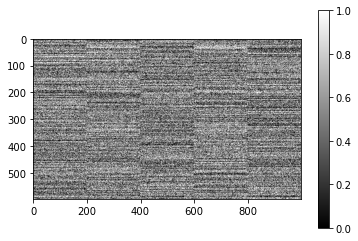

Parameters: 60 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([27, 60, 36, 24, 25, 92, 11, 81, 76, 77,  4, 33,  4,  0, 81, 21, 75, 40,
        45, 25, 46, 91, 28, 32,  9, 49, 51, 32, 91, 47, 67, 80, 64, 18, 20, 59,
        81, 87, 93, 75, 90, 33, 39, 63, 86, 29, 17,  5, 71, 89])
Epoch: 1, Train set: Avg. loss: 0.394434
Test set: Avg. loss: 0.092309
Epoch: 2, Train set: Avg. loss: 0.091277
Test set: Avg. loss: 0.078013
Epoch: 3, Train set: Avg. loss: 0.072798
Test set: Avg. loss: 0.058794
Epoch: 4, Train set: Avg. loss: 0.062592
Test set: Avg. loss: 0.046405
Epoch: 5, Train set: Avg. loss: 0.060742
Test set: Avg. loss: 0.069605
Epoch: 6, Train set: Avg. loss: 0.056576
Test set: Avg. loss: 0.045375
Epoch: 7, Train set: Avg. loss: 0.059670
Test set: Avg. loss: 0.058012
Epoch: 8, Train set: Avg. loss: 0.052234
Test set: Avg. loss: 0.069875
Epoch: 9, Train set: Avg. loss: 0.054700
Test set: Avg. loss: 0.065905
Epoch: 10, Train set: Avg. loss: 0.054926
Test set: Avg. loss: 0.062559


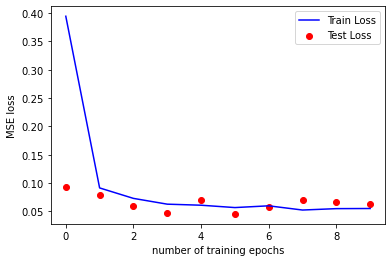

decryption accuracy is 98.47%


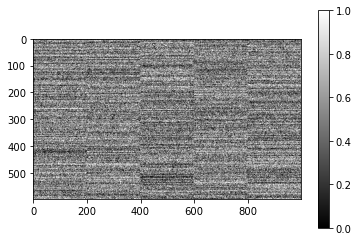

Parameters: 60 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([64, 35, 66, 60,  9, 41,  5, 73, 23, 75,  5, 59, 66,  8,  2, 76, 33, 91,
         1, 66,  7,  0, 29,  8, 29, 26, 91, 51, 90, 35, 53, 86, 64, 77, 88, 21,
        61,  1, 27, 32, 22, 86, 60,  6, 34, 28, 35, 82, 85, 52])
Epoch: 1, Train set: Avg. loss: 0.532605
Test set: Avg. loss: 0.138274
Epoch: 2, Train set: Avg. loss: 0.148102
Test set: Avg. loss: 0.109587
Epoch: 3, Train set: Avg. loss: 0.117794
Test set: Avg. loss: 0.102737
Epoch: 4, Train set: Avg. loss: 0.104266
Test set: Avg. loss: 0.079987
Epoch: 5, Train set: Avg. loss: 0.101931
Test set: Avg. loss: 0.147014
Epoch: 6, Train set: Avg. loss: 0.100078
Test set: Avg. loss: 0.083741
Epoch: 7, Train set: Avg. loss: 0.093340
Test set: Avg. loss: 0.071100
Epoch: 8, Train set: Avg. loss: 0.088035
Test set: Avg. loss: 0.061861
Epoch: 9, Train set: Avg. loss: 0.087497
Test set: Avg. loss: 0.064382
Epoch: 10, Train set: Avg. loss: 0.089898
Test set: Avg. loss: 0.070606


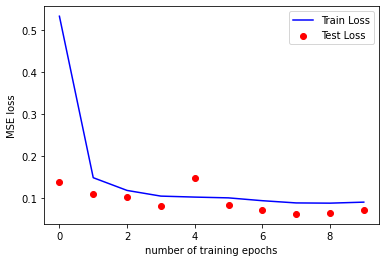

decryption accuracy is 98.09%


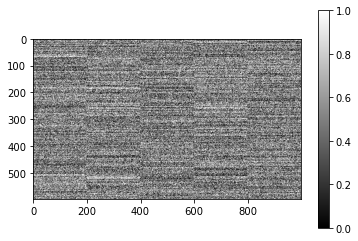

Parameters: 60 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([46,  1, 23, 70, 78,  8, 29, 68, 71, 29, 82, 22, 90, 64,  4, 56, 80, 27,
        56, 68, 87, 80, 51, 81, 46, 84, 55, 65, 36, 19,  3, 30, 34, 23,  4, 87,
        17, 48, 53, 68, 70, 22,  0, 48,  6, 76, 23, 37, 24, 79])
Epoch: 1, Train set: Avg. loss: 0.682120
Test set: Avg. loss: 0.304642
Epoch: 2, Train set: Avg. loss: 0.218431
Test set: Avg. loss: 0.149493
Epoch: 3, Train set: Avg. loss: 0.188169
Test set: Avg. loss: 0.185010
Epoch: 4, Train set: Avg. loss: 0.168348
Test set: Avg. loss: 0.143027
Epoch: 5, Train set: Avg. loss: 0.161160
Test set: Avg. loss: 0.156931
Epoch: 6, Train set: Avg. loss: 0.153597
Test set: Avg. loss: 0.162374
Epoch: 7, Train set: Avg. loss: 0.147482
Test set: Avg. loss: 0.148513
Epoch: 8, Train set: Avg. loss: 0.147940
Test set: Avg. loss: 0.124225
Epoch: 9, Train set: Avg. loss: 0.145792
Test set: Avg. loss: 0.119759
Epoch: 10, Train set: Avg. loss: 0.140849
Test set: Avg. loss: 0.127362


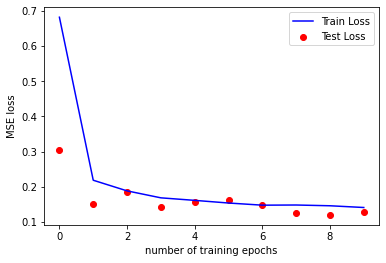

decryption accuracy is 96.58%


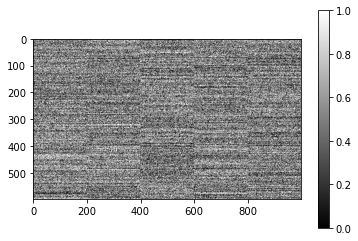

Parameters: 60 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([56, 49,  3, 23, 55, 84, 62, 12, 83, 83, 77, 76, 16, 36, 26, 55, 17, 80,
        79, 85, 23, 33, 40, 21, 86, 24, 40, 73, 33, 49, 57,  6, 35, 67, 25,  0,
        92, 17, 54, 31, 51, 54, 24, 10, 34, 41, 28, 63, 87, 69])
Epoch: 1, Train set: Avg. loss: 0.971601
Test set: Avg. loss: 0.290688
Epoch: 2, Train set: Avg. loss: 0.319732
Test set: Avg. loss: 0.289935
Epoch: 3, Train set: Avg. loss: 0.269213
Test set: Avg. loss: 0.256480
Epoch: 4, Train set: Avg. loss: 0.250735
Test set: Avg. loss: 0.277498
Epoch: 5, Train set: Avg. loss: 0.239261
Test set: Avg. loss: 0.236343
Epoch: 6, Train set: Avg. loss: 0.237584
Test set: Avg. loss: 0.183968
Epoch: 7, Train set: Avg. loss: 0.221720
Test set: Avg. loss: 0.210973
Epoch: 8, Train set: Avg. loss: 0.218610
Test set: Avg. loss: 0.202625
Epoch: 9, Train set: Avg. loss: 0.211754
Test set: Avg. loss: 0.210885
Epoch: 10, Train set: Avg. loss: 0.206490
Test set: Avg. loss: 0.198303


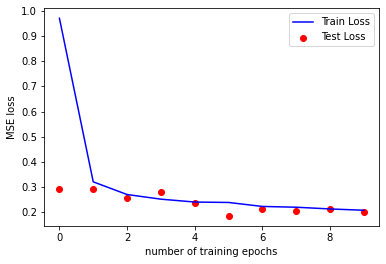

decryption accuracy is 94.73%


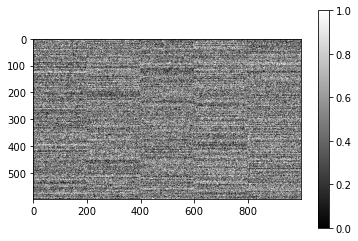

Parameters: 60 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([27, 80, 83, 69, 75, 44, 18, 60, 57, 76,  5, 45, 47, 42, 12, 14, 59, 91,
        84, 62, 88, 92, 33, 39, 47,  6, 61, 90, 38, 52, 79, 28, 58, 51,  0, 15,
        42, 46, 13, 27, 19, 48, 20, 45, 88, 63, 31, 18, 25, 30])
Epoch: 1, Train set: Avg. loss: 1.185654
Test set: Avg. loss: 0.575084
Epoch: 2, Train set: Avg. loss: 0.465250
Test set: Avg. loss: 0.407741
Epoch: 3, Train set: Avg. loss: 0.396109
Test set: Avg. loss: 0.363906
Epoch: 4, Train set: Avg. loss: 0.372528
Test set: Avg. loss: 0.384517
Epoch: 5, Train set: Avg. loss: 0.352344
Test set: Avg. loss: 0.337865
Epoch: 6, Train set: Avg. loss: 0.349528
Test set: Avg. loss: 0.392424
Epoch: 7, Train set: Avg. loss: 0.335435
Test set: Avg. loss: 0.326894
Epoch: 8, Train set: Avg. loss: 0.341751
Test set: Avg. loss: 0.275407
Epoch: 9, Train set: Avg. loss: 0.331240
Test set: Avg. loss: 0.276382
Epoch: 10, Train set: Avg. loss: 0.322111
Test set: Avg. loss: 0

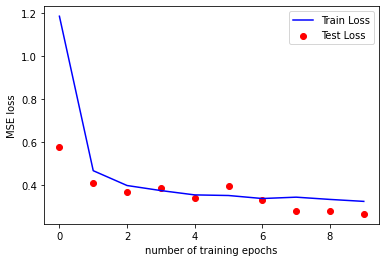

decryption accuracy is 93.47%


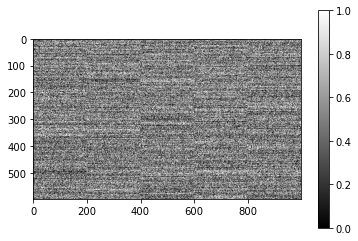

Parameters: 65 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([75, 16,  9, 18, 90,  5, 10, 31, 70, 49, 21, 52, 79, 43, 21, 58, 29, 53,
        89, 92, 20, 66, 47, 37, 61,  3, 28, 84,  3, 73, 53, 83, 18, 10, 67, 47,
        52, 50,  5, 75, 44, 64, 61, 55, 36, 34, 57,  7, 69, 54])
Epoch: 1, Train set: Avg. loss: 0.052707
Test set: Avg. loss: 0.002307
Epoch: 2, Train set: Avg. loss: 0.001648
Test set: Avg. loss: 0.001208
Epoch: 3, Train set: Avg. loss: 0.001002
Test set: Avg. loss: 0.000818
Epoch: 4, Train set: Avg. loss: 0.000725
Test set: Avg. loss: 0.000629
Epoch: 5, Train set: Avg. loss: 0.000609
Test set: Avg. loss: 0.000518
Epoch: 6, Train set: Avg. loss: 0.000469
Test set: Avg. loss: 0.000435
Epoch: 7, Train set: Avg. loss: 0.000409
Test set: Avg. loss: 0.000378
Epoch: 8, Train set: Avg. loss: 0.000379
Test set: Avg. loss: 0.000331
Epoch: 9, Train set: Avg. loss: 0.000310
Test set: Avg. loss: 0.000306
Epoch: 10, Train set: Avg. loss: 0.000279
Test set: Avg. loss: 0.000268


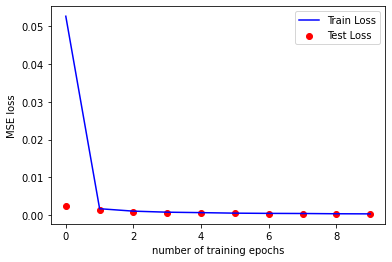

decryption accuracy is 100.0%


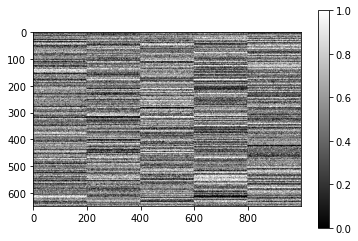

Parameters: 65 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([60, 72, 15, 44, 52, 61, 45, 29, 25, 57, 36, 36, 49, 35, 53, 25, 56, 59,
        30,  6, 43, 54, 24, 79, 52, 89, 69, 16, 43, 87,  4, 81, 86, 58, 82, 67,
         6, 47, 48, 11, 74, 48, 35, 62, 22, 15, 13,  7, 32, 57])
Epoch: 1, Train set: Avg. loss: 0.058762
Test set: Avg. loss: 0.003052
Epoch: 2, Train set: Avg. loss: 0.002268
Test set: Avg. loss: 0.001658
Epoch: 3, Train set: Avg. loss: 0.001367
Test set: Avg. loss: 0.001093
Epoch: 4, Train set: Avg. loss: 0.000972
Test set: Avg. loss: 0.000884
Epoch: 5, Train set: Avg. loss: 0.000787
Test set: Avg. loss: 0.000688
Epoch: 6, Train set: Avg. loss: 0.000647
Test set: Avg. loss: 0.000598
Epoch: 7, Train set: Avg. loss: 0.000569
Test set: Avg. loss: 0.000518
Epoch: 8, Train set: Avg. loss: 0.000525
Test set: Avg. loss: 0.000479
Epoch: 9, Train set: Avg. loss: 0.000433
Test set: Avg. loss: 0.000403
Epoch: 10, Train set: Avg. loss: 0.000420
Test set: Avg. loss: 0.000387


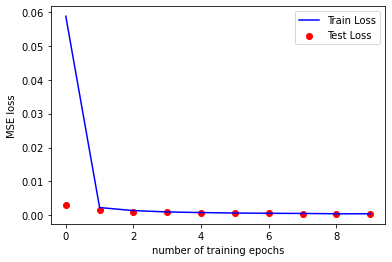

decryption accuracy is 100.0%


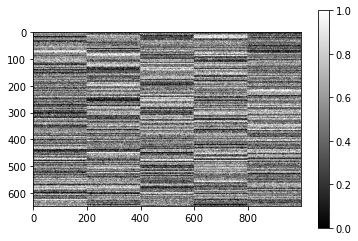

Parameters: 65 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([37, 78, 38, 70, 83, 80, 38, 83, 36, 88, 91, 70,  5, 40, 87, 34, 36, 70,
        21, 41, 60, 84, 72, 85,  0, 81, 75, 20, 51, 86, 31, 53, 74, 78, 53, 51,
        20, 55, 12, 85, 41, 10, 88, 36, 11, 93, 80, 18, 49, 76])
Epoch: 1, Train set: Avg. loss: 0.091565
Test set: Avg. loss: 0.004205
Epoch: 2, Train set: Avg. loss: 0.003251
Test set: Avg. loss: 0.002230
Epoch: 3, Train set: Avg. loss: 0.001991
Test set: Avg. loss: 0.001598
Epoch: 4, Train set: Avg. loss: 0.001413
Test set: Avg. loss: 0.001274
Epoch: 5, Train set: Avg. loss: 0.001225
Test set: Avg. loss: 0.001018
Epoch: 6, Train set: Avg. loss: 0.000986
Test set: Avg. loss: 0.000829
Epoch: 7, Train set: Avg. loss: 0.000845
Test set: Avg. loss: 0.000787
Epoch: 8, Train set: Avg. loss: 0.000895
Test set: Avg. loss: 0.000675
Epoch: 9, Train set: Avg. loss: 0.000661
Test set: Avg. loss: 0.000587
Epoch: 10, Train set: Avg. loss: 0.000625
Test set: Avg. loss: 0.000565


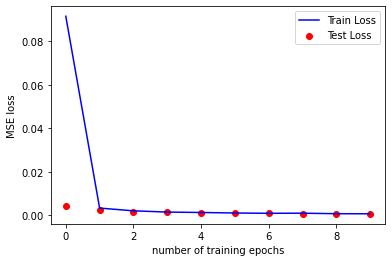

decryption accuracy is 100.0%


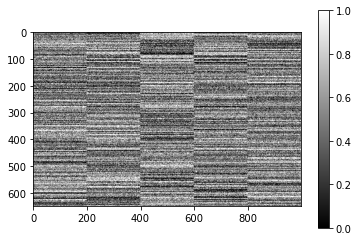

Parameters: 65 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([23, 67, 14, 16, 60, 90, 47, 49, 80, 65, 16,  9, 41, 51, 28, 19, 44, 86,
        14,  2, 72,  7, 14, 87, 90, 56, 47, 60,  3, 20, 92, 68, 56, 75, 20, 40,
        41, 65, 85, 25, 93, 87, 28, 81, 85, 38, 17,  3, 58, 50])
Epoch: 1, Train set: Avg. loss: 0.090673
Test set: Avg. loss: 0.006420
Epoch: 2, Train set: Avg. loss: 0.004340
Test set: Avg. loss: 0.003153
Epoch: 3, Train set: Avg. loss: 0.002924
Test set: Avg. loss: 0.002312
Epoch: 4, Train set: Avg. loss: 0.002230
Test set: Avg. loss: 0.001777
Epoch: 5, Train set: Avg. loss: 0.001709
Test set: Avg. loss: 0.001559
Epoch: 6, Train set: Avg. loss: 0.001724
Test set: Avg. loss: 0.001704
Epoch: 7, Train set: Avg. loss: 0.001185
Test set: Avg. loss: 0.001066
Epoch: 8, Train set: Avg. loss: 0.001048
Test set: Avg. loss: 0.001016
Epoch: 9, Train set: Avg. loss: 0.001057
Test set: Avg. loss: 0.001377
Epoch: 10, Train set: Avg. loss: 0.000872
Test set: Avg. loss: 0.000801


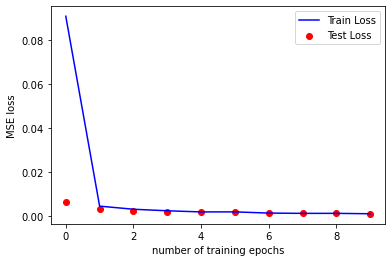

decryption accuracy is 100.0%


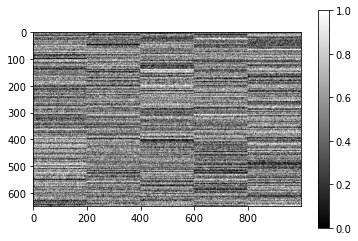

Parameters: 65 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([24, 12, 70, 62, 69, 39, 69, 56, 30, 36, 74,  2,  2, 92, 78, 28, 29, 51,
         5, 91, 80, 68, 84, 27, 85, 60, 48, 86, 23, 68, 23, 34, 49, 44, 86, 46,
        42, 81, 74, 65, 29, 66,  1, 22, 63, 67, 46, 38, 85, 76])
Epoch: 1, Train set: Avg. loss: 0.106432
Test set: Avg. loss: 0.011991
Epoch: 2, Train set: Avg. loss: 0.007129
Test set: Avg. loss: 0.005505
Epoch: 3, Train set: Avg. loss: 0.004823
Test set: Avg. loss: 0.003419
Epoch: 4, Train set: Avg. loss: 0.003785
Test set: Avg. loss: 0.002850
Epoch: 5, Train set: Avg. loss: 0.003185
Test set: Avg. loss: 0.002303
Epoch: 6, Train set: Avg. loss: 0.003180
Test set: Avg. loss: 0.002155
Epoch: 7, Train set: Avg. loss: 0.002641
Test set: Avg. loss: 0.002293
Epoch: 8, Train set: Avg. loss: 0.002133
Test set: Avg. loss: 0.002157
Epoch: 9, Train set: Avg. loss: 0.001949
Test set: Avg. loss: 0.003436
Epoch: 10, Train set: Avg. loss: 0.001511
Test set: Avg. loss: 0.001480


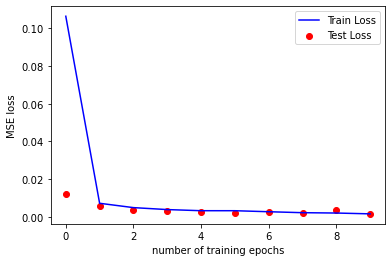

decryption accuracy is 99.99%


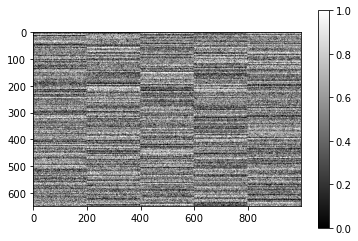

Parameters: 65 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([73, 79, 77,  8,  7, 61, 79, 32, 46, 84, 43, 12, 41, 77, 43, 34, 38, 64,
        39, 55, 43, 22, 87, 35, 20, 93, 76,  1, 74, 43, 63,  3,  5, 62, 21, 41,
        42,  1, 70, 37, 74, 65, 88, 83, 83, 87, 79, 52, 79, 28])
Epoch: 1, Train set: Avg. loss: 0.148388
Test set: Avg. loss: 0.012061
Epoch: 2, Train set: Avg. loss: 0.012456
Test set: Avg. loss: 0.007886
Epoch: 3, Train set: Avg. loss: 0.007980
Test set: Avg. loss: 0.005350
Epoch: 4, Train set: Avg. loss: 0.006979
Test set: Avg. loss: 0.006417
Epoch: 5, Train set: Avg. loss: 0.004374
Test set: Avg. loss: 0.005303
Epoch: 6, Train set: Avg. loss: 0.005296
Test set: Avg. loss: 0.002955
Epoch: 7, Train set: Avg. loss: 0.004365
Test set: Avg. loss: 0.003225
Epoch: 8, Train set: Avg. loss: 0.003249
Test set: Avg. loss: 0.003099
Epoch: 9, Train set: Avg. loss: 0.003994
Test set: Avg. loss: 0.003415
Epoch: 10, Train set: Avg. loss: 0.003579
Test set: Avg. loss: 0.002675


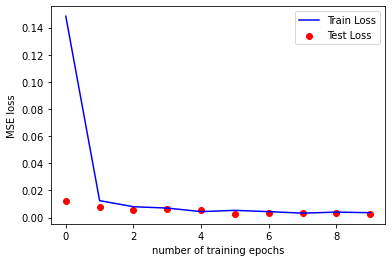

decryption accuracy is 99.99%


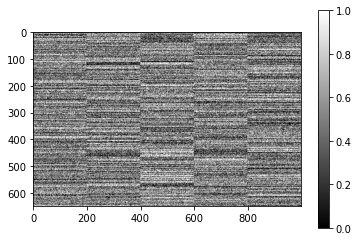

Parameters: 65 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([43, 44, 30, 47, 61, 87, 83, 80, 49, 56, 58, 77, 16, 63, 58, 93, 25, 35,
         8, 83, 47, 61, 17, 85, 62, 72, 58, 17, 93, 52, 66, 65, 59,  1,  0, 39,
        68, 84, 27, 35, 54, 17, 67,  7, 20, 77, 15,  0, 12, 17])
Epoch: 1, Train set: Avg. loss: 0.252541
Test set: Avg. loss: 0.022765
Epoch: 2, Train set: Avg. loss: 0.018748
Test set: Avg. loss: 0.011933
Epoch: 3, Train set: Avg. loss: 0.013047
Test set: Avg. loss: 0.017214
Epoch: 4, Train set: Avg. loss: 0.011320
Test set: Avg. loss: 0.032586
Epoch: 5, Train set: Avg. loss: 0.009691
Test set: Avg. loss: 0.007475
Epoch: 6, Train set: Avg. loss: 0.009049
Test set: Avg. loss: 0.006061
Epoch: 7, Train set: Avg. loss: 0.008272
Test set: Avg. loss: 0.005212
Epoch: 8, Train set: Avg. loss: 0.007447
Test set: Avg. loss: 0.005623
Epoch: 9, Train set: Avg. loss: 0.007541
Test set: Avg. loss: 0.005169
Epoch: 10, Train set: Avg. loss: 0.005271
Test set: Avg. loss: 

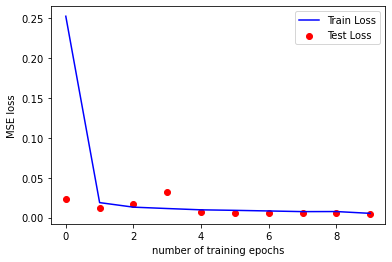

decryption accuracy is 99.91%


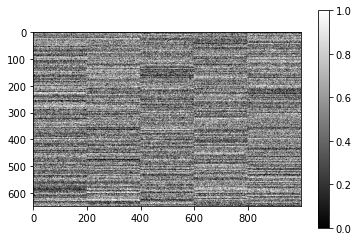

Parameters: 65 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([11, 46, 50, 63, 61, 76, 72, 67, 71, 72, 39, 43, 48, 84, 28, 79, 19, 44,
        73, 32, 26, 77, 48, 70, 48, 64, 79, 67, 38, 28, 17, 18, 44, 26, 35, 28,
        68, 24,  0, 59,  5, 17, 39, 12, 31, 44,  7, 29,  6, 31])
Epoch: 1, Train set: Avg. loss: 0.268586
Test set: Avg. loss: 0.031358
Epoch: 2, Train set: Avg. loss: 0.031087
Test set: Avg. loss: 0.023826
Epoch: 3, Train set: Avg. loss: 0.021895
Test set: Avg. loss: 0.013259
Epoch: 4, Train set: Avg. loss: 0.020838
Test set: Avg. loss: 0.013746
Epoch: 5, Train set: Avg. loss: 0.017295
Test set: Avg. loss: 0.013299
Epoch: 6, Train set: Avg. loss: 0.015239
Test set: Avg. loss: 0.016942
Epoch: 7, Train set: Avg. loss: 0.015925
Test set: Avg. loss: 0.014836
Epoch: 8, Train set: Avg. loss: 0.013812
Test set: Avg. loss: 0.009112
Epoch: 9, Train set: Avg. loss: 0.013934
Test set: Avg. loss: 0.009337
Epoch: 10, Train set: Avg. loss: 0.015298
Test set: Avg. loss: 0.012040


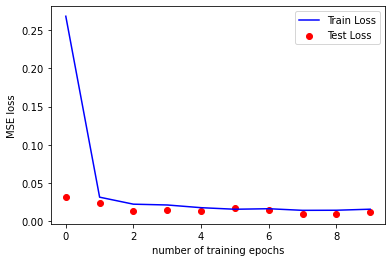

decryption accuracy is 99.72%


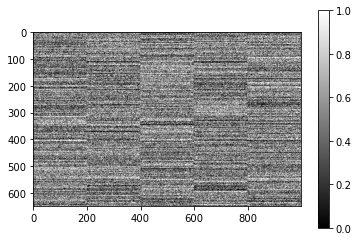

Parameters: 65 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([78, 48,  0, 17, 67, 56, 56, 48, 38, 87, 25, 27,  6, 20, 62, 41, 44, 33,
        24, 78, 77, 15, 26, 36, 83, 43, 88, 85, 84, 14, 39, 57, 34, 27, 64, 89,
         7, 88, 73, 10, 82, 65,  4, 92,  1, 22, 62, 39, 53, 14])
Epoch: 1, Train set: Avg. loss: 0.330384
Test set: Avg. loss: 0.046523
Epoch: 2, Train set: Avg. loss: 0.049641
Test set: Avg. loss: 0.033341
Epoch: 3, Train set: Avg. loss: 0.036755
Test set: Avg. loss: 0.024964
Epoch: 4, Train set: Avg. loss: 0.034029
Test set: Avg. loss: 0.026747
Epoch: 5, Train set: Avg. loss: 0.033156
Test set: Avg. loss: 0.022929
Epoch: 6, Train set: Avg. loss: 0.028692
Test set: Avg. loss: 0.024175
Epoch: 7, Train set: Avg. loss: 0.027560
Test set: Avg. loss: 0.039142
Epoch: 8, Train set: Avg. loss: 0.027064
Test set: Avg. loss: 0.034909
Epoch: 9, Train set: Avg. loss: 0.022951
Test set: Avg. loss: 0.018128
Epoch: 10, Train set: Avg. loss: 0.023358
Test set: Avg. loss: 0.024909


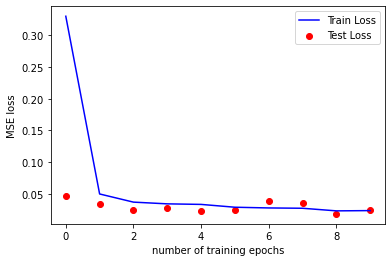

decryption accuracy is 99.49%


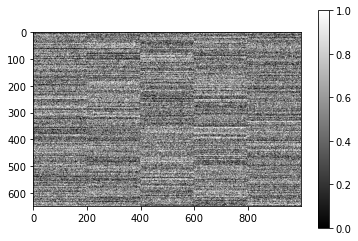

Parameters: 65 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([ 2, 38, 64, 17, 23, 72, 17,  7, 27, 32, 27, 48, 81, 24, 13, 70,  5, 56,
         5, 12, 62, 11, 68, 53, 57, 30, 42, 93, 62, 79, 48,  5, 65, 67, 62, 87,
        88, 60, 46, 74,  8, 18, 25, 40, 10, 45, 90, 10, 44, 20])
Epoch: 1, Train set: Avg. loss: 0.440052
Test set: Avg. loss: 0.099412
Epoch: 2, Train set: Avg. loss: 0.081049
Test set: Avg. loss: 0.076706
Epoch: 3, Train set: Avg. loss: 0.064017
Test set: Avg. loss: 0.042913
Epoch: 4, Train set: Avg. loss: 0.055708
Test set: Avg. loss: 0.074632
Epoch: 5, Train set: Avg. loss: 0.054563
Test set: Avg. loss: 0.066506
Epoch: 6, Train set: Avg. loss: 0.051082
Test set: Avg. loss: 0.040546
Epoch: 7, Train set: Avg. loss: 0.048568
Test set: Avg. loss: 0.046788
Epoch: 8, Train set: Avg. loss: 0.046357
Test set: Avg. loss: 0.043107
Epoch: 9, Train set: Avg. loss: 0.042666
Test set: Avg. loss: 0.046533
Epoch: 10, Train set: Avg. loss: 0.041953
Test set: Avg. loss: 0.042243


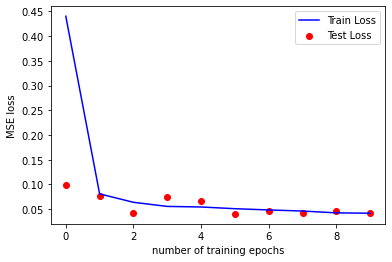

decryption accuracy is 98.95%


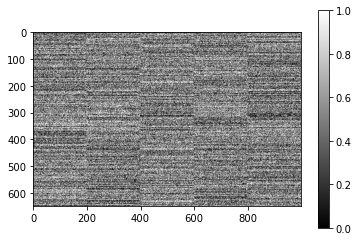

Parameters: 65 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([53, 90, 80, 82, 10, 41, 90,  3, 20, 53, 35, 59, 46, 57, 53, 35, 10, 25,
        45, 78, 52,  7, 39,  0, 31, 87, 24, 28, 44, 40, 65, 13, 53, 26,  1, 25,
        13, 36, 29, 40, 52, 50, 67, 19,  5, 42, 50, 79, 21, 82])
Epoch: 1, Train set: Avg. loss: 0.577686
Test set: Avg. loss: 0.278833
Epoch: 2, Train set: Avg. loss: 0.133226
Test set: Avg. loss: 0.109391
Epoch: 3, Train set: Avg. loss: 0.110471
Test set: Avg. loss: 0.083493
Epoch: 4, Train set: Avg. loss: 0.100802
Test set: Avg. loss: 0.088494
Epoch: 5, Train set: Avg. loss: 0.094664
Test set: Avg. loss: 0.117102
Epoch: 6, Train set: Avg. loss: 0.089106
Test set: Avg. loss: 0.087166
Epoch: 7, Train set: Avg. loss: 0.085104
Test set: Avg. loss: 0.067689
Epoch: 8, Train set: Avg. loss: 0.080477
Test set: Avg. loss: 0.069313
Epoch: 9, Train set: Avg. loss: 0.079578
Test set: Avg. loss: 0.112473
Epoch: 10, Train set: Avg. loss: 0.073713
Test set: Avg. loss: 0.089261


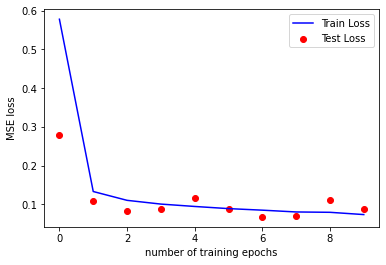

decryption accuracy is 97.45%


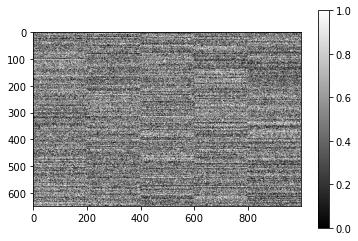

Parameters: 65 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([82, 92, 91, 14, 33, 40, 59, 86, 26, 35, 89, 79, 35, 18, 26, 79, 59, 66,
        40, 24, 16, 33, 53, 18, 12, 10, 26, 35, 13, 20, 87, 11, 40, 53, 31, 37,
        81, 32, 73, 25, 90, 55,  8, 58, 29, 26, 10, 60, 30,  5])
Epoch: 1, Train set: Avg. loss: 0.735257
Test set: Avg. loss: 0.198834
Epoch: 2, Train set: Avg. loss: 0.205460
Test set: Avg. loss: 0.169281
Epoch: 3, Train set: Avg. loss: 0.167974
Test set: Avg. loss: 0.133287
Epoch: 4, Train set: Avg. loss: 0.154920
Test set: Avg. loss: 0.133391
Epoch: 5, Train set: Avg. loss: 0.130139
Test set: Avg. loss: 0.109423
Epoch: 6, Train set: Avg. loss: 0.135082
Test set: Avg. loss: 0.137697
Epoch: 7, Train set: Avg. loss: 0.140291
Test set: Avg. loss: 0.113709
Epoch: 8, Train set: Avg. loss: 0.132856
Test set: Avg. loss: 0.123937
Epoch: 9, Train set: Avg. loss: 0.126086
Test set: Avg. loss: 0.113911
Epoch: 10, Train set: Avg. loss: 0.116671
Test set: Avg. loss: 0.149756


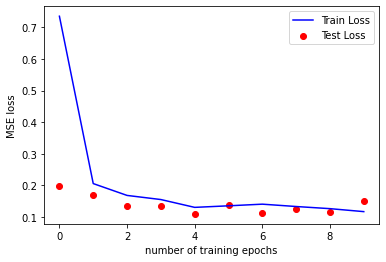

decryption accuracy is 96.07%


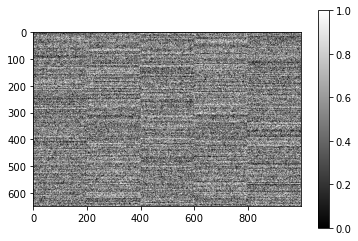

Parameters: 65 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([93, 21, 81, 85, 22, 77, 49, 92, 65,  2, 40, 22, 11, 52, 56, 46, 23, 45,
        89, 42, 43, 63, 73, 16, 62, 32, 49, 23, 70, 30, 86, 26, 31, 91, 75, 19,
        31, 53, 70, 35, 40, 18, 89, 93, 71,  2, 67, 36, 87, 34])
Epoch: 1, Train set: Avg. loss: 0.957885
Test set: Avg. loss: 0.324393
Epoch: 2, Train set: Avg. loss: 0.326292
Test set: Avg. loss: 0.236272
Epoch: 3, Train set: Avg. loss: 0.275319
Test set: Avg. loss: 0.223292
Epoch: 4, Train set: Avg. loss: 0.245395
Test set: Avg. loss: 0.210468
Epoch: 5, Train set: Avg. loss: 0.221633
Test set: Avg. loss: 0.269463
Epoch: 6, Train set: Avg. loss: 0.229063
Test set: Avg. loss: 0.224948
Epoch: 7, Train set: Avg. loss: 0.215979
Test set: Avg. loss: 0.180033
Epoch: 8, Train set: Avg. loss: 0.210820
Test set: Avg. loss: 0.186305
Epoch: 9, Train set: Avg. loss: 0.204399
Test set: Avg. loss: 0.194051
Epoch: 10, Train set: Avg. loss: 0.212111
Test set: Avg. loss: 0.293189


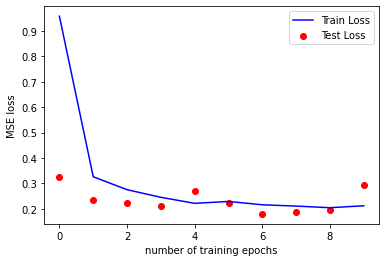

decryption accuracy is 93.27%


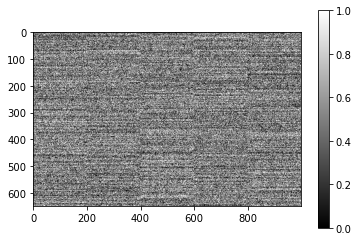

Parameters: 65 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([23, 68,  1, 85, 40, 48, 65,  0, 50, 29, 84, 70, 32, 85, 57,  9, 39,  1,
        36, 56, 31, 53, 25, 81, 33, 13, 86, 87, 80, 73, 91, 58,  9, 34, 68, 20,
        64, 10, 54, 87, 16, 93, 42, 68,  8, 77, 69,  9, 57, 72])
Epoch: 1, Train set: Avg. loss: 1.173984
Test set: Avg. loss: 0.502644
Epoch: 2, Train set: Avg. loss: 0.426816
Test set: Avg. loss: 0.325119
Epoch: 3, Train set: Avg. loss: 0.362751
Test set: Avg. loss: 0.320099
Epoch: 4, Train set: Avg. loss: 0.318511
Test set: Avg. loss: 0.267674
Epoch: 5, Train set: Avg. loss: 0.310441
Test set: Avg. loss: 0.222544
Epoch: 6, Train set: Avg. loss: 0.288524
Test set: Avg. loss: 0.285140
Epoch: 7, Train set: Avg. loss: 0.303793
Test set: Avg. loss: 0.363069
Epoch: 8, Train set: Avg. loss: 0.305298
Test set: Avg. loss: 0.287667
Epoch: 9, Train set: Avg. loss: 0.279445
Test set: Avg. loss: 0.280428
Epoch: 10, Train set: Avg. loss: 0.275756
Test set: Avg. loss: 0

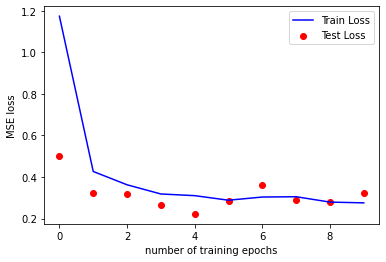

decryption accuracy is 92.55%


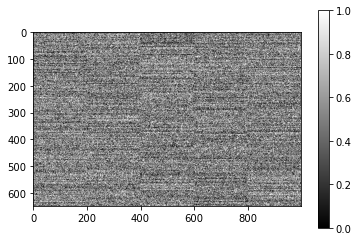

Parameters: 70 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([13, 12, 32, 28, 77,  7, 39, 38,  5, 73, 40, 30, 29, 17, 20, 20, 73, 49,
        64, 59, 45, 49, 62, 60, 58, 54, 62, 71, 74, 62, 55, 33, 21, 14, 91, 79,
        44, 42,  4, 29, 42, 27, 61, 79, 57, 20, 24, 56, 63, 85])
Epoch: 1, Train set: Avg. loss: 0.047768
Test set: Avg. loss: 0.002134
Epoch: 2, Train set: Avg. loss: 0.001613
Test set: Avg. loss: 0.001133
Epoch: 3, Train set: Avg. loss: 0.000935
Test set: Avg. loss: 0.000783
Epoch: 4, Train set: Avg. loss: 0.000688
Test set: Avg. loss: 0.000603
Epoch: 5, Train set: Avg. loss: 0.000536
Test set: Avg. loss: 0.000489
Epoch: 6, Train set: Avg. loss: 0.000453
Test set: Avg. loss: 0.000416
Epoch: 7, Train set: Avg. loss: 0.000377
Test set: Avg. loss: 0.000358
Epoch: 8, Train set: Avg. loss: 0.000385
Test set: Avg. loss: 0.000311
Epoch: 9, Train set: Avg. loss: 0.000318
Test set: Avg. loss: 0.000278
Epoch: 10, Train set: Avg. loss: 0.000272
Test set: Avg. loss: 0.000259


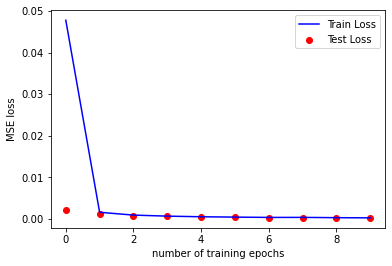

decryption accuracy is 100.0%


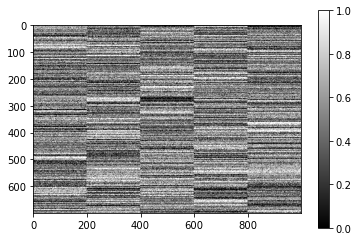

Parameters: 70 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([28,  0,  9, 88, 60, 89, 89, 91, 27, 82, 27, 63, 35, 56, 55,  2, 47, 68,
        66,  6,  0, 25, 45, 92, 64, 61, 34,  3, 54, 66, 61,  7, 31,  2, 91, 63,
         3, 38,  3, 20, 20, 47, 72, 89, 14, 21, 73,  6, 55,  7])
Epoch: 1, Train set: Avg. loss: 0.078576
Test set: Avg. loss: 0.002676
Epoch: 2, Train set: Avg. loss: 0.001975
Test set: Avg. loss: 0.001421
Epoch: 3, Train set: Avg. loss: 0.001194
Test set: Avg. loss: 0.001035
Epoch: 4, Train set: Avg. loss: 0.000898
Test set: Avg. loss: 0.000770
Epoch: 5, Train set: Avg. loss: 0.000694
Test set: Avg. loss: 0.000611
Epoch: 6, Train set: Avg. loss: 0.000612
Test set: Avg. loss: 0.000526
Epoch: 7, Train set: Avg. loss: 0.000485
Test set: Avg. loss: 0.000465
Epoch: 8, Train set: Avg. loss: 0.000435
Test set: Avg. loss: 0.000413
Epoch: 9, Train set: Avg. loss: 0.000397
Test set: Avg. loss: 0.000369
Epoch: 10, Train set: Avg. loss: 0.000515
Test set: Avg. loss: 0.000324


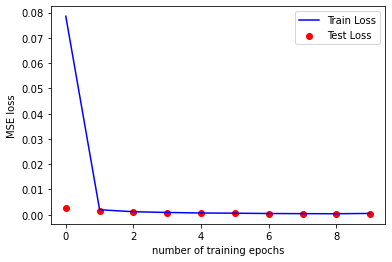

decryption accuracy is 100.0%


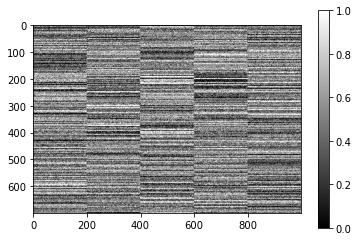

Parameters: 70 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([54, 22, 60, 38, 77, 82, 31, 68,  5, 12,  7, 46, 88, 27, 72, 33, 88, 49,
        13, 21, 79, 82, 84, 58, 68, 46, 41, 46, 35, 43, 26, 76, 54, 61, 83, 89,
        76, 84, 65, 73, 75, 92, 77,  2, 64, 39, 90,  0, 64, 51])
Epoch: 1, Train set: Avg. loss: 0.083038
Test set: Avg. loss: 0.003702
Epoch: 2, Train set: Avg. loss: 0.002955
Test set: Avg. loss: 0.002040
Epoch: 3, Train set: Avg. loss: 0.001969
Test set: Avg. loss: 0.001382
Epoch: 4, Train set: Avg. loss: 0.001245
Test set: Avg. loss: 0.001048
Epoch: 5, Train set: Avg. loss: 0.001242
Test set: Avg. loss: 0.000865
Epoch: 6, Train set: Avg. loss: 0.000920
Test set: Avg. loss: 0.000734
Epoch: 7, Train set: Avg. loss: 0.000839
Test set: Avg. loss: 0.000712
Epoch: 8, Train set: Avg. loss: 0.000834
Test set: Avg. loss: 0.000674
Epoch: 9, Train set: Avg. loss: 0.000526
Test set: Avg. loss: 0.000495
Epoch: 10, Train set: Avg. loss: 0.000519
Test set: Avg. loss: 0.000458


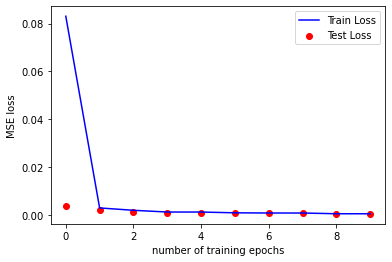

decryption accuracy is 100.0%


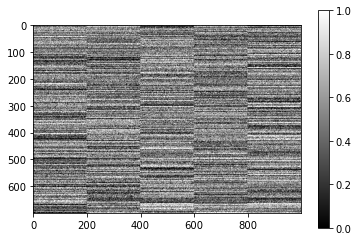

Parameters: 70 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([ 0, 91, 68,  1, 77, 91, 26, 14, 84, 16, 70, 92, 52, 90, 11, 61, 39, 59,
        21, 75, 23, 81, 56, 38, 68, 57, 31,  1, 92, 89, 89, 43, 68, 81, 64, 35,
        54, 81, 13, 61, 24, 66, 29, 23, 32, 14, 59, 14, 75, 92])
Epoch: 1, Train set: Avg. loss: 0.115512
Test set: Avg. loss: 0.005871
Epoch: 2, Train set: Avg. loss: 0.003969
Test set: Avg. loss: 0.002995
Epoch: 3, Train set: Avg. loss: 0.002575
Test set: Avg. loss: 0.001984
Epoch: 4, Train set: Avg. loss: 0.002121
Test set: Avg. loss: 0.001626
Epoch: 5, Train set: Avg. loss: 0.001761
Test set: Avg. loss: 0.001313
Epoch: 6, Train set: Avg. loss: 0.001750
Test set: Avg. loss: 0.001188
Epoch: 7, Train set: Avg. loss: 0.001095
Test set: Avg. loss: 0.001202
Epoch: 8, Train set: Avg. loss: 0.001542
Test set: Avg. loss: 0.001183
Epoch: 9, Train set: Avg. loss: 0.000928
Test set: Avg. loss: 0.001691
Epoch: 10, Train set: Avg. loss: 0.000855
Test set: Avg. loss: 0.000698


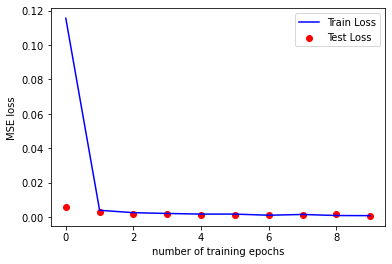

decryption accuracy is 99.99%


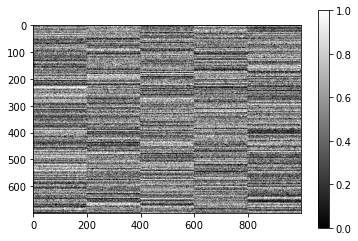

Parameters: 70 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([ 9, 88, 59, 14, 62, 28, 60, 89, 92, 44, 26, 54, 24, 15, 53, 49,  0, 26,
        69, 31, 37, 18,  8, 41, 26, 27, 15, 47, 26, 18, 14, 19, 80, 85, 33, 14,
        62, 73, 40, 18, 12, 42,  7, 37,  9, 82, 17, 67, 77, 85])
Epoch: 1, Train set: Avg. loss: 0.139114
Test set: Avg. loss: 0.007413
Epoch: 2, Train set: Avg. loss: 0.006314
Test set: Avg. loss: 0.004245
Epoch: 3, Train set: Avg. loss: 0.004783
Test set: Avg. loss: 0.004875
Epoch: 4, Train set: Avg. loss: 0.004323
Test set: Avg. loss: 0.002683
Epoch: 5, Train set: Avg. loss: 0.003629
Test set: Avg. loss: 0.002406
Epoch: 6, Train set: Avg. loss: 0.002776
Test set: Avg. loss: 0.001820
Epoch: 7, Train set: Avg. loss: 0.002908
Test set: Avg. loss: 0.001676
Epoch: 8, Train set: Avg. loss: 0.002478
Test set: Avg. loss: 0.001820
Epoch: 9, Train set: Avg. loss: 0.001858
Test set: Avg. loss: 0.001780
Epoch: 10, Train set: Avg. loss: 0.001633
Test set: Avg. loss: 0.001446


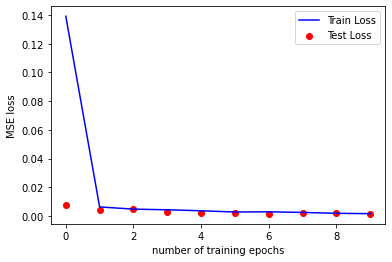

decryption accuracy is 99.96%


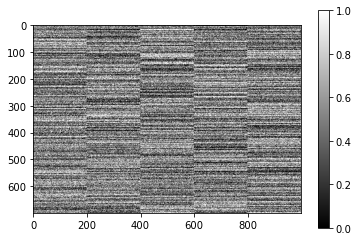

Parameters: 70 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([86, 58,  1, 76,  9, 19, 50, 26, 20, 54, 42, 31, 59, 12, 27,  3, 72,  3,
        58, 62, 60, 93, 37,  9, 45, 61, 45, 43, 47, 24, 52, 50, 61, 26, 25, 77,
        15, 87, 41, 44, 16, 22, 74, 89,  9, 93, 52, 47, 10, 79])
Epoch: 1, Train set: Avg. loss: 0.164641
Test set: Avg. loss: 0.010439
Epoch: 2, Train set: Avg. loss: 0.012771
Test set: Avg. loss: 0.006524
Epoch: 3, Train set: Avg. loss: 0.009312
Test set: Avg. loss: 0.037823
Epoch: 4, Train set: Avg. loss: 0.006937
Test set: Avg. loss: 0.004380
Epoch: 5, Train set: Avg. loss: 0.005203
Test set: Avg. loss: 0.003787
Epoch: 6, Train set: Avg. loss: 0.004761
Test set: Avg. loss: 0.005002
Epoch: 7, Train set: Avg. loss: 0.004427
Test set: Avg. loss: 0.002886
Epoch: 8, Train set: Avg. loss: 0.004518
Test set: Avg. loss: 0.002792
Epoch: 9, Train set: Avg. loss: 0.004568
Test set: Avg. loss: 0.002397
Epoch: 10, Train set: Avg. loss: 0.002908
Test set: Avg. loss: 0.002160


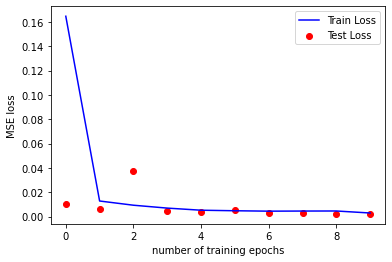

decryption accuracy is 99.98%


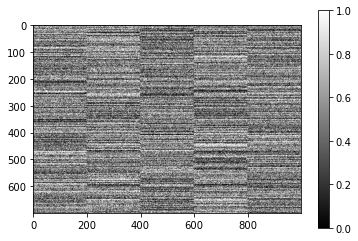

Parameters: 70 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([53, 67, 78, 91, 80, 41, 84, 89, 63, 20, 77,  5, 54, 83, 42, 69, 34, 75,
        92, 32, 56,  1, 91, 18, 35,  5, 58,  9, 33, 71, 29, 15, 85, 66, 20, 82,
        19, 87, 75, 31, 52, 35, 79, 24, 89, 35, 66, 17, 45, 91])
Epoch: 1, Train set: Avg. loss: 0.195620
Test set: Avg. loss: 0.020518
Epoch: 2, Train set: Avg. loss: 0.019879
Test set: Avg. loss: 0.016993
Epoch: 3, Train set: Avg. loss: 0.011984
Test set: Avg. loss: 0.007738
Epoch: 4, Train set: Avg. loss: 0.010278
Test set: Avg. loss: 0.006378
Epoch: 5, Train set: Avg. loss: 0.009172
Test set: Avg. loss: 0.008655
Epoch: 6, Train set: Avg. loss: 0.008081
Test set: Avg. loss: 0.005168
Epoch: 7, Train set: Avg. loss: 0.007419
Test set: Avg. loss: 0.005122
Epoch: 8, Train set: Avg. loss: 0.007177
Test set: Avg. loss: 0.007338
Epoch: 9, Train set: Avg. loss: 0.005848
Test set: Avg. loss: 0.006417
Epoch: 10, Train set: Avg. loss: 0.006670
Test set: Avg. loss: 

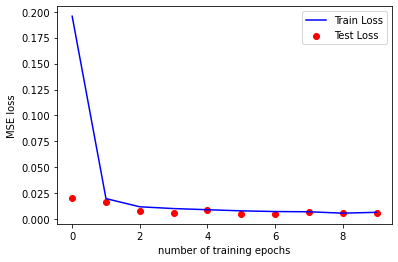

decryption accuracy is 99.87%


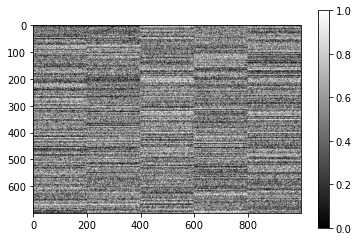

Parameters: 70 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([71, 58, 35, 16, 13, 57,  8, 35, 59, 23, 87, 88, 42,  9, 63, 20, 73, 64,
        89, 45, 75, 79, 24, 20,  3, 15, 38, 26, 52, 15, 47, 87, 91, 36, 77, 78,
        68, 64, 55, 15, 28, 48, 13, 20,  1, 28, 24, 39,  5, 43])
Epoch: 1, Train set: Avg. loss: 0.321704
Test set: Avg. loss: 0.058876
Epoch: 2, Train set: Avg. loss: 0.035199
Test set: Avg. loss: 0.036579
Epoch: 3, Train set: Avg. loss: 0.024787
Test set: Avg. loss: 0.016342
Epoch: 4, Train set: Avg. loss: 0.020899
Test set: Avg. loss: 0.012002
Epoch: 5, Train set: Avg. loss: 0.019591
Test set: Avg. loss: 0.010864
Epoch: 6, Train set: Avg. loss: 0.017500
Test set: Avg. loss: 0.012176
Epoch: 7, Train set: Avg. loss: 0.018092
Test set: Avg. loss: 0.010632
Epoch: 8, Train set: Avg. loss: 0.014804
Test set: Avg. loss: 0.010750
Epoch: 9, Train set: Avg. loss: 0.016034
Test set: Avg. loss: 0.008987
Epoch: 10, Train set: Avg. loss: 0.011797
Test set: Avg. loss: 0.022997


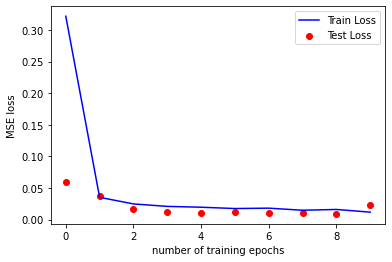

decryption accuracy is 99.55%


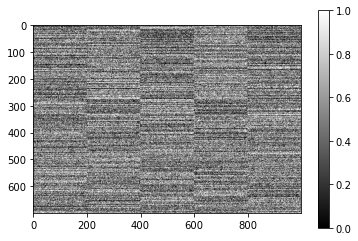

Parameters: 70 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([15, 53, 61, 73, 53, 73, 75,  2, 48, 66, 13, 82, 41, 28, 73, 11, 82, 45,
        73, 49, 80, 37,  3, 47,  9, 86, 61, 75, 75, 40,  1, 84, 64, 73, 73, 36,
        25, 66, 44, 60, 61, 65, 25, 27, 34, 70, 42, 57, 79, 87])
Epoch: 1, Train set: Avg. loss: 0.445492
Test set: Avg. loss: 0.058758
Epoch: 2, Train set: Avg. loss: 0.048015
Test set: Avg. loss: 0.025984
Epoch: 3, Train set: Avg. loss: 0.032066
Test set: Avg. loss: 0.024276
Epoch: 4, Train set: Avg. loss: 0.028587
Test set: Avg. loss: 0.026529
Epoch: 5, Train set: Avg. loss: 0.026887
Test set: Avg. loss: 0.048419
Epoch: 6, Train set: Avg. loss: 0.024782
Test set: Avg. loss: 0.015228
Epoch: 7, Train set: Avg. loss: 0.022505
Test set: Avg. loss: 0.037810
Epoch: 8, Train set: Avg. loss: 0.023403
Test set: Avg. loss: 0.059935
Epoch: 9, Train set: Avg. loss: 0.024008
Test set: Avg. loss: 0.018845
Epoch: 10, Train set: Avg. loss: 0.023035
Test set: Avg. loss: 0.031965


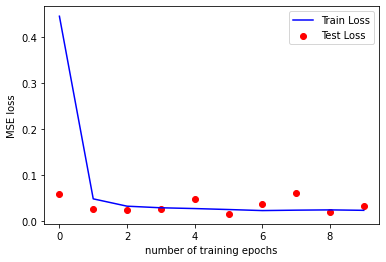

decryption accuracy is 99.11%


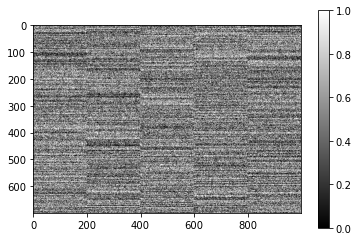

Parameters: 70 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([ 7,  5, 80, 37, 58, 38, 46, 42, 21, 81, 87, 93, 55, 77, 31, 11, 46, 22,
        57, 29, 32, 19, 12, 17, 33, 73, 65, 38,  3, 64, 76, 36, 31, 23, 43, 39,
        81,  3, 17, 54, 27, 64, 91, 10, 78, 52, 72, 26, 40, 11])
Epoch: 1, Train set: Avg. loss: 0.447585
Test set: Avg. loss: 0.072134
Epoch: 2, Train set: Avg. loss: 0.081309
Test set: Avg. loss: 0.070940
Epoch: 3, Train set: Avg. loss: 0.058244
Test set: Avg. loss: 0.058741
Epoch: 4, Train set: Avg. loss: 0.051652
Test set: Avg. loss: 0.071810
Epoch: 5, Train set: Avg. loss: 0.048563
Test set: Avg. loss: 0.026542
Epoch: 6, Train set: Avg. loss: 0.040587
Test set: Avg. loss: 0.031266
Epoch: 7, Train set: Avg. loss: 0.040783
Test set: Avg. loss: 0.027186
Epoch: 8, Train set: Avg. loss: 0.042239
Test set: Avg. loss: 0.032121
Epoch: 9, Train set: Avg. loss: 0.039824
Test set: Avg. loss: 0.059303
Epoch: 10, Train set: Avg. loss: 0.042499
Test set: Avg. loss: 0.035640


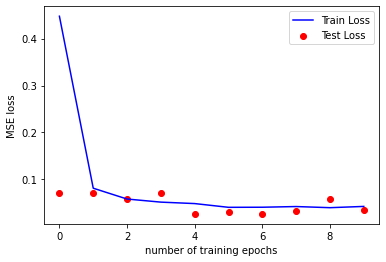

decryption accuracy is 99.11%


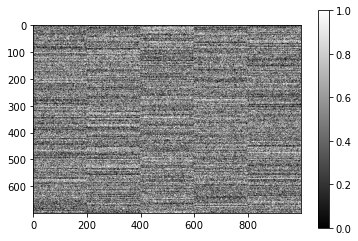

Parameters: 70 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([24, 51, 19, 32, 90, 92, 76, 25, 16, 87,  2, 61, 76, 70, 30, 63, 18, 76,
        25, 76, 66,  9, 31, 52, 83, 53, 10, 62, 85, 77, 66, 41, 22,  0, 32, 34,
        75, 40, 20, 48, 68, 48, 28,  9, 21, 31, 21, 38, 17, 70])
Epoch: 1, Train set: Avg. loss: 0.625757
Test set: Avg. loss: 0.123431
Epoch: 2, Train set: Avg. loss: 0.122799
Test set: Avg. loss: 0.109559
Epoch: 3, Train set: Avg. loss: 0.098844
Test set: Avg. loss: 0.091128
Epoch: 4, Train set: Avg. loss: 0.081012
Test set: Avg. loss: 0.085526
Epoch: 5, Train set: Avg. loss: 0.080800
Test set: Avg. loss: 0.067968
Epoch: 6, Train set: Avg. loss: 0.080144
Test set: Avg. loss: 0.115060
Epoch: 7, Train set: Avg. loss: 0.074071
Test set: Avg. loss: 0.077396
Epoch: 8, Train set: Avg. loss: 0.071251
Test set: Avg. loss: 0.063030
Epoch: 9, Train set: Avg. loss: 0.066124
Test set: Avg. loss: 0.058777
Epoch: 10, Train set: Avg. loss: 0.064060
Test set: Avg. loss: 0.085539


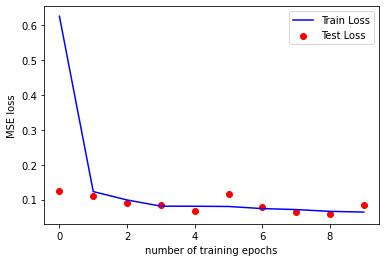

decryption accuracy is 98.1%


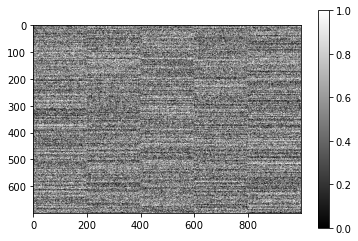

Parameters: 70 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([16, 85, 42, 62, 73, 62, 40, 65, 61,  3, 43, 72,  3, 89, 16, 57, 56, 83,
        21, 85,  6, 68, 65, 93, 87, 41, 40,  6, 35, 92, 17, 23, 60, 79, 53, 27,
        42, 61, 13,  8, 45, 16, 60, 25, 36, 33, 37, 73, 43, 37])
Epoch: 1, Train set: Avg. loss: 0.755438
Test set: Avg. loss: 0.256007
Epoch: 2, Train set: Avg. loss: 0.192659
Test set: Avg. loss: 0.155766
Epoch: 3, Train set: Avg. loss: 0.158120
Test set: Avg. loss: 0.148750
Epoch: 4, Train set: Avg. loss: 0.145437
Test set: Avg. loss: 0.145701
Epoch: 5, Train set: Avg. loss: 0.138470
Test set: Avg. loss: 0.157642
Epoch: 6, Train set: Avg. loss: 0.134762
Test set: Avg. loss: 0.111293
Epoch: 7, Train set: Avg. loss: 0.116640
Test set: Avg. loss: 0.102547
Epoch: 8, Train set: Avg. loss: 0.119484
Test set: Avg. loss: 0.125106
Epoch: 9, Train set: Avg. loss: 0.116970
Test set: Avg. loss: 0.146537
Epoch: 10, Train set: Avg. loss: 0.119791
Test set: Avg. loss: 0.130368


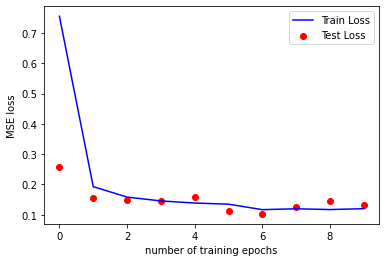

decryption accuracy is 96.63%


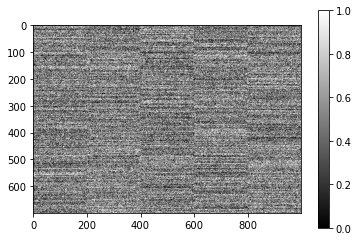

Parameters: 70 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([11, 39, 53, 38, 21, 52, 66, 91, 17,  2, 72, 34, 41, 24, 73, 38, 44, 17,
        44, 33, 18, 36, 77, 35, 49, 27, 19, 51, 67,  0,  6, 62, 38, 30, 27, 90,
         5, 85, 55, 21, 35, 66,  8, 49, 16, 12, 69, 16, 49, 72])
Epoch: 1, Train set: Avg. loss: 1.032839
Test set: Avg. loss: 0.438986
Epoch: 2, Train set: Avg. loss: 0.288361
Test set: Avg. loss: 0.231959
Epoch: 3, Train set: Avg. loss: 0.238497
Test set: Avg. loss: 0.225810
Epoch: 4, Train set: Avg. loss: 0.212340
Test set: Avg. loss: 0.220156
Epoch: 5, Train set: Avg. loss: 0.194630
Test set: Avg. loss: 0.149437
Epoch: 6, Train set: Avg. loss: 0.188987
Test set: Avg. loss: 0.169613
Epoch: 7, Train set: Avg. loss: 0.190648
Test set: Avg. loss: 0.193755
Epoch: 8, Train set: Avg. loss: 0.192801
Test set: Avg. loss: 0.175056
Epoch: 9, Train set: Avg. loss: 0.176431
Test set: Avg. loss: 0.169075
Epoch: 10, Train set: Avg. loss: 0.183919
Test set: Avg. loss: 0.166038


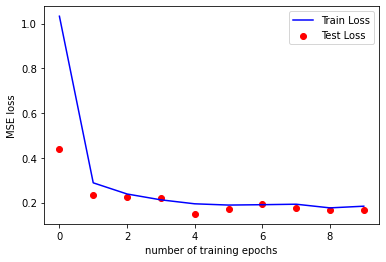

decryption accuracy is 95.74%


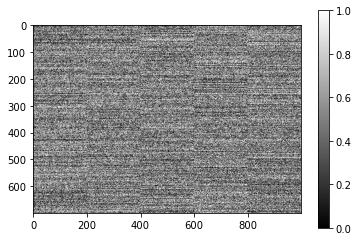

Parameters: 70 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([54, 15, 42, 15,  3, 71, 67, 80,  8, 71, 54, 34, 21, 36,  5,  0, 33,  8,
        75, 74, 31, 38,  9, 71, 85, 52, 65, 89, 16, 62, 40, 35,  5, 29, 77, 44,
        70, 50, 16, 54, 38,  2, 53, 76,  2, 78, 69, 53, 55, 66])
Epoch: 1, Train set: Avg. loss: 1.268027
Test set: Avg. loss: 0.431537
Epoch: 2, Train set: Avg. loss: 0.428634
Test set: Avg. loss: 0.325802
Epoch: 3, Train set: Avg. loss: 0.354281
Test set: Avg. loss: 0.374315
Epoch: 4, Train set: Avg. loss: 0.336780
Test set: Avg. loss: 0.323197
Epoch: 5, Train set: Avg. loss: 0.306697
Test set: Avg. loss: 0.279646
Epoch: 6, Train set: Avg. loss: 0.302695
Test set: Avg. loss: 0.472901
Epoch: 7, Train set: Avg. loss: 0.290983
Test set: Avg. loss: 0.299269
Epoch: 8, Train set: Avg. loss: 0.281368
Test set: Avg. loss: 0.277348
Epoch: 9, Train set: Avg. loss: 0.276421
Test set: Avg. loss: 0.301378
Epoch: 10, Train set: Avg. loss: 0.271369
Test set: Avg. loss: 0

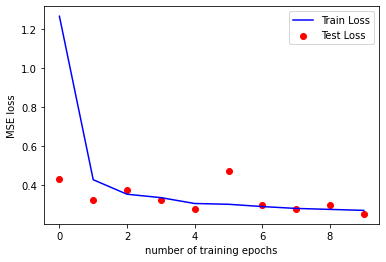

decryption accuracy is 94.32%


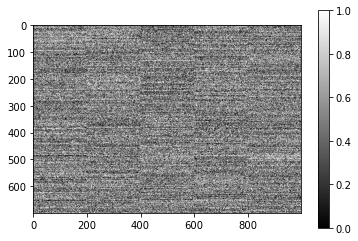

Parameters: 75 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([26, 26, 22, 35, 47, 41, 59, 31, 41, 90, 54, 52, 85, 59, 46, 44, 67, 67,
        76, 46, 83,  0,  4, 23, 32,  6, 69, 77, 68,  4, 23, 12, 16, 87, 26, 31,
         6, 84, 56, 79, 79, 93, 69, 51, 44, 58, 75, 73, 66, 68])
Epoch: 1, Train set: Avg. loss: 0.059817
Test set: Avg. loss: 0.001875
Epoch: 2, Train set: Avg. loss: 0.001335
Test set: Avg. loss: 0.000988
Epoch: 3, Train set: Avg. loss: 0.000828
Test set: Avg. loss: 0.000679
Epoch: 4, Train set: Avg. loss: 0.000592
Test set: Avg. loss: 0.000516
Epoch: 5, Train set: Avg. loss: 0.000471
Test set: Avg. loss: 0.000439
Epoch: 6, Train set: Avg. loss: 0.000388
Test set: Avg. loss: 0.000366
Epoch: 7, Train set: Avg. loss: 0.000334
Test set: Avg. loss: 0.000310
Epoch: 8, Train set: Avg. loss: 0.000288
Test set: Avg. loss: 0.000279
Epoch: 9, Train set: Avg. loss: 0.000259
Test set: Avg. loss: 0.000239
Epoch: 10, Train set: Avg. loss: 0.000260
Test set: Avg. loss: 0.000218


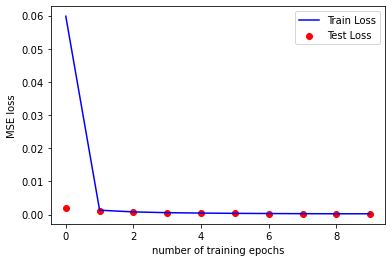

decryption accuracy is 100.0%


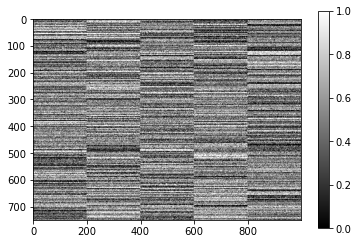

Parameters: 75 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([76, 29, 50, 55, 11,  6, 33, 39, 74, 77, 62, 64, 10, 83, 20, 34, 31, 50,
        11, 78, 68, 63, 83, 58, 54, 58,  0, 43, 83, 43, 47, 35, 61, 35,  9, 85,
        85,  5,  7, 88, 31, 72, 60, 53,  5, 23, 17, 25, 49, 69])
Epoch: 1, Train set: Avg. loss: 0.083056
Test set: Avg. loss: 0.002573
Epoch: 2, Train set: Avg. loss: 0.001844
Test set: Avg. loss: 0.001341
Epoch: 3, Train set: Avg. loss: 0.001183
Test set: Avg. loss: 0.001043
Epoch: 4, Train set: Avg. loss: 0.000871
Test set: Avg. loss: 0.000690
Epoch: 5, Train set: Avg. loss: 0.000675
Test set: Avg. loss: 0.000576
Epoch: 6, Train set: Avg. loss: 0.000838
Test set: Avg. loss: 0.000529
Epoch: 7, Train set: Avg. loss: 0.000466
Test set: Avg. loss: 0.000422
Epoch: 8, Train set: Avg. loss: 0.000403
Test set: Avg. loss: 0.000382
Epoch: 9, Train set: Avg. loss: 0.000386
Test set: Avg. loss: 0.000376
Epoch: 10, Train set: Avg. loss: 0.000435
Test set: Avg. loss: 0.000305


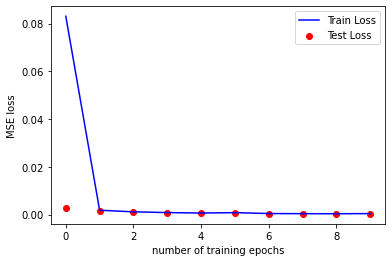

decryption accuracy is 100.0%


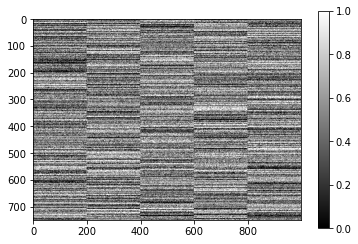

Parameters: 75 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([80, 71, 42, 22, 35, 37, 29, 18, 46, 43, 38, 29, 29, 44,  5, 35, 63, 18,
        33, 79, 68, 61, 46, 27, 67, 34, 63, 77, 34, 25, 91, 65, 82, 81, 27, 10,
        74,  6, 74, 31, 52, 76, 74, 17, 65, 90, 26, 73, 93, 81])
Epoch: 1, Train set: Avg. loss: 0.094765
Test set: Avg. loss: 0.003433
Epoch: 2, Train set: Avg. loss: 0.002423
Test set: Avg. loss: 0.001863
Epoch: 3, Train set: Avg. loss: 0.001579
Test set: Avg. loss: 0.001269
Epoch: 4, Train set: Avg. loss: 0.001396
Test set: Avg. loss: 0.001088
Epoch: 5, Train set: Avg. loss: 0.000909
Test set: Avg. loss: 0.000852
Epoch: 6, Train set: Avg. loss: 0.000796
Test set: Avg. loss: 0.000677
Epoch: 7, Train set: Avg. loss: 0.000850
Test set: Avg. loss: 0.000643
Epoch: 8, Train set: Avg. loss: 0.000586
Test set: Avg. loss: 0.000555
Epoch: 9, Train set: Avg. loss: 0.000601
Test set: Avg. loss: 0.000467
Epoch: 10, Train set: Avg. loss: 0.000460
Test set: Avg. loss: 0.000435


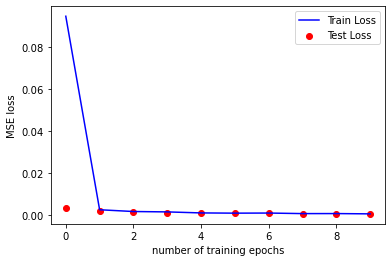

decryption accuracy is 100.0%


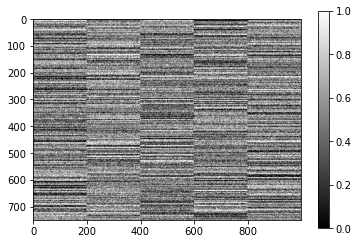

Parameters: 75 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([45,  8, 70, 44,  1, 58, 81, 92, 14, 59, 76, 62, 40,  2, 81, 59, 24, 18,
        15,  3, 25, 66, 87, 66, 51, 52, 56, 41, 21, 73, 38, 50,  6,  4, 10, 86,
        65, 37, 38, 28,  7, 64, 14, 72, 59, 86, 46, 80,  8, 83])
Epoch: 1, Train set: Avg. loss: 0.133515
Test set: Avg. loss: 0.004543
Epoch: 2, Train set: Avg. loss: 0.003792
Test set: Avg. loss: 0.002679
Epoch: 3, Train set: Avg. loss: 0.002220
Test set: Avg. loss: 0.001882
Epoch: 4, Train set: Avg. loss: 0.002019
Test set: Avg. loss: 0.001401
Epoch: 5, Train set: Avg. loss: 0.001313
Test set: Avg. loss: 0.001376
Epoch: 6, Train set: Avg. loss: 0.001137
Test set: Avg. loss: 0.000929
Epoch: 7, Train set: Avg. loss: 0.000986
Test set: Avg. loss: 0.000924
Epoch: 8, Train set: Avg. loss: 0.000835
Test set: Avg. loss: 0.000826
Epoch: 9, Train set: Avg. loss: 0.000835
Test set: Avg. loss: 0.000785
Epoch: 10, Train set: Avg. loss: 0.000792
Test set: Avg. loss: 0.000652


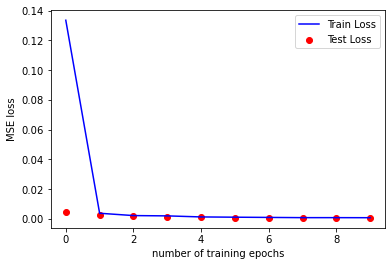

decryption accuracy is 99.99%


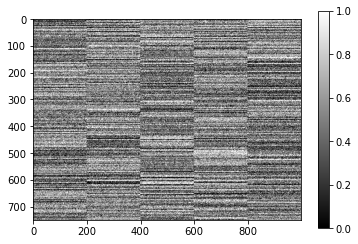

Parameters: 75 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([80, 38, 74, 10,  3, 73, 48, 45, 62, 77, 24, 80, 45, 53, 92, 80, 67, 50,
        43, 34, 20, 55,  0, 51, 10, 34, 36, 25, 52, 69, 90, 41, 48, 80, 15, 70,
        88,  2, 43, 39, 11, 32, 40, 42, 57, 82, 48,  5, 40, 26])
Epoch: 1, Train set: Avg. loss: 0.161942
Test set: Avg. loss: 0.007426
Epoch: 2, Train set: Avg. loss: 0.005982
Test set: Avg. loss: 0.006750
Epoch: 3, Train set: Avg. loss: 0.004173
Test set: Avg. loss: 0.002488
Epoch: 4, Train set: Avg. loss: 0.003213
Test set: Avg. loss: 0.002066
Epoch: 5, Train set: Avg. loss: 0.002912
Test set: Avg. loss: 0.003050
Epoch: 6, Train set: Avg. loss: 0.002104
Test set: Avg. loss: 0.001420
Epoch: 7, Train set: Avg. loss: 0.002273
Test set: Avg. loss: 0.001406
Epoch: 8, Train set: Avg. loss: 0.001217
Test set: Avg. loss: 0.001465
Epoch: 9, Train set: Avg. loss: 0.002037
Test set: Avg. loss: 0.001039
Epoch: 10, Train set: Avg. loss: 0.001417
Test set: Avg. loss: 0.001733


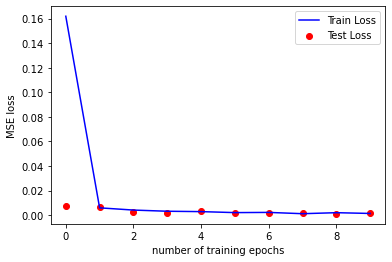

decryption accuracy is 99.95%


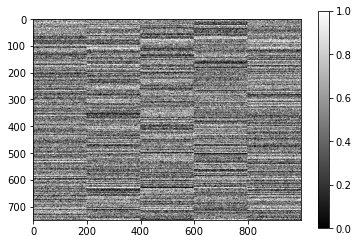

Parameters: 75 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([ 7, 67, 69, 50, 63, 59, 60, 63, 67,  1, 51, 80, 93, 28, 74, 35, 17, 15,
        19, 59, 52, 78, 46, 49, 78,  6,  1, 49, 19, 86, 69,  0, 30, 61, 35, 76,
        76, 25,  4, 29, 91, 34, 26, 49, 42,  0, 21, 13, 14, 82])
Epoch: 1, Train set: Avg. loss: 0.201425
Test set: Avg. loss: 0.010982
Epoch: 2, Train set: Avg. loss: 0.010448
Test set: Avg. loss: 0.010462
Epoch: 3, Train set: Avg. loss: 0.006578
Test set: Avg. loss: 0.004429
Epoch: 4, Train set: Avg. loss: 0.007169
Test set: Avg. loss: 0.009388
Epoch: 5, Train set: Avg. loss: 0.005598
Test set: Avg. loss: 0.002741
Epoch: 6, Train set: Avg. loss: 0.004678
Test set: Avg. loss: 0.002867
Epoch: 7, Train set: Avg. loss: 0.004477
Test set: Avg. loss: 0.003065
Epoch: 8, Train set: Avg. loss: 0.003165
Test set: Avg. loss: 0.004112
Epoch: 9, Train set: Avg. loss: 0.003458
Test set: Avg. loss: 0.001862
Epoch: 10, Train set: Avg. loss: 0.003381
Test set: Avg. loss: 0.002002


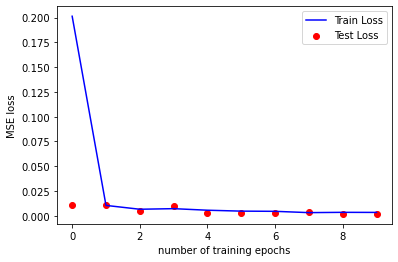

decryption accuracy is 99.95%


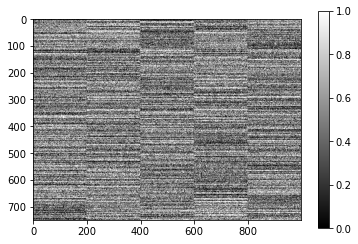

Parameters: 75 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([58, 23, 14, 81, 45, 43, 56, 15, 66, 64, 68, 33, 69,  5, 68, 29,  1, 37,
        25, 15, 65, 62, 54, 21,  6, 10, 89, 35, 77, 42, 48, 46,  2,  1, 37,  8,
        26, 26, 44, 70, 16, 74,  1, 38, 76, 37, 56, 47, 16, 65])
Epoch: 1, Train set: Avg. loss: 0.202623
Test set: Avg. loss: 0.015142
Epoch: 2, Train set: Avg. loss: 0.018144
Test set: Avg. loss: 0.008905
Epoch: 3, Train set: Avg. loss: 0.012111
Test set: Avg. loss: 0.020787
Epoch: 4, Train set: Avg. loss: 0.010640
Test set: Avg. loss: 0.006914
Epoch: 5, Train set: Avg. loss: 0.011173
Test set: Avg. loss: 0.006634
Epoch: 6, Train set: Avg. loss: 0.009247
Test set: Avg. loss: 0.009528
Epoch: 7, Train set: Avg. loss: 0.007925
Test set: Avg. loss: 0.004375
Epoch: 8, Train set: Avg. loss: 0.006317
Test set: Avg. loss: 0.016108
Epoch: 9, Train set: Avg. loss: 0.007098
Test set: Avg. loss: 0.010788
Epoch: 10, Train set: Avg. loss: 0.004744
Test set: Avg. loss: 

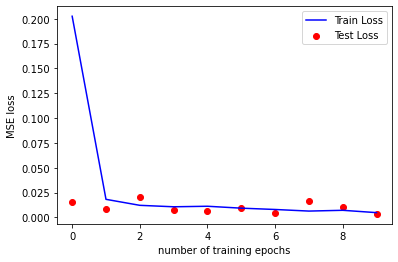

decryption accuracy is 99.93%


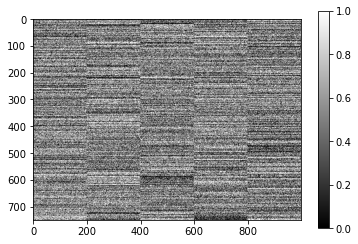

Parameters: 75 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([69, 81,  0, 91, 92, 92, 65,  1, 26, 26, 57, 44, 45, 36, 80, 17, 20, 43,
        89, 30, 64, 51, 24, 57, 90, 91, 27, 57, 31,  8,  3, 34, 26, 60, 42, 19,
        33, 92, 76, 42, 10, 47, 76, 57, 74, 39, 75, 65, 28, 18])
Epoch: 1, Train set: Avg. loss: 0.320486
Test set: Avg. loss: 0.039142
Epoch: 2, Train set: Avg. loss: 0.027169
Test set: Avg. loss: 0.027233
Epoch: 3, Train set: Avg. loss: 0.019395
Test set: Avg. loss: 0.011623
Epoch: 4, Train set: Avg. loss: 0.015960
Test set: Avg. loss: 0.009982
Epoch: 5, Train set: Avg. loss: 0.016258
Test set: Avg. loss: 0.033679
Epoch: 6, Train set: Avg. loss: 0.017700
Test set: Avg. loss: 0.009899
Epoch: 7, Train set: Avg. loss: 0.011983
Test set: Avg. loss: 0.020134
Epoch: 8, Train set: Avg. loss: 0.012615
Test set: Avg. loss: 0.008481
Epoch: 9, Train set: Avg. loss: 0.011819
Test set: Avg. loss: 0.064638
Epoch: 10, Train set: Avg. loss: 0.010309
Test set: Avg. loss: 0.037085


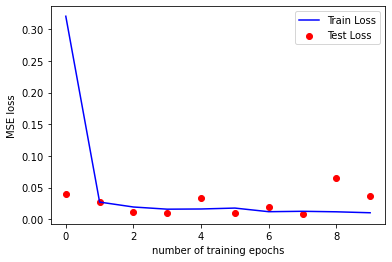

decryption accuracy is 99.19%


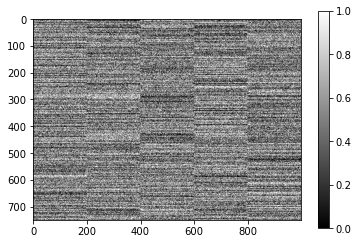

Parameters: 75 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([44, 93,  2, 90, 82, 37, 75, 90, 52,  2, 47, 43, 56, 78, 64, 24,  0, 78,
        32,  5, 50, 19, 14, 52, 92, 10,  1, 93,  2, 22, 66, 50, 28, 61, 37, 88,
        34, 18, 75, 37, 33, 71, 59, 10,  8, 13,  2, 91, 32, 58])
Epoch: 1, Train set: Avg. loss: 0.502976
Test set: Avg. loss: 0.054052
Epoch: 2, Train set: Avg. loss: 0.048063
Test set: Avg. loss: 0.051220
Epoch: 3, Train set: Avg. loss: 0.035609
Test set: Avg. loss: 0.019511
Epoch: 4, Train set: Avg. loss: 0.031209
Test set: Avg. loss: 0.015727
Epoch: 5, Train set: Avg. loss: 0.022843
Test set: Avg. loss: 0.017135
Epoch: 6, Train set: Avg. loss: 0.022576
Test set: Avg. loss: 0.017721
Epoch: 7, Train set: Avg. loss: 0.023223
Test set: Avg. loss: 0.023206
Epoch: 8, Train set: Avg. loss: 0.024666
Test set: Avg. loss: 0.040640
Epoch: 9, Train set: Avg. loss: 0.021405
Test set: Avg. loss: 0.021354
Epoch: 10, Train set: Avg. loss: 0.022776
Test set: Avg. loss: 0.024291


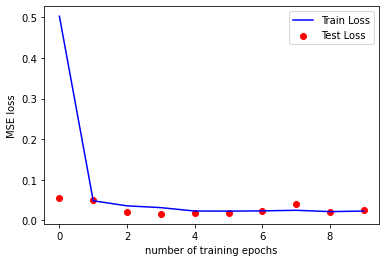

decryption accuracy is 99.28%


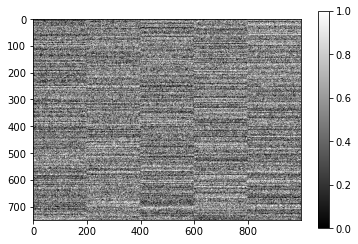

Parameters: 75 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([58, 22, 55,  7, 84, 59, 22, 64, 56, 13, 54, 23, 75, 64, 86, 60, 55,  3,
        75, 74,  1, 52, 85, 54, 23, 48, 11, 54, 73,  9, 30, 11, 82, 17, 11, 30,
        11, 77, 23, 75, 67,  6, 57, 57, 78, 61, 72, 25,  8, 43])
Epoch: 1, Train set: Avg. loss: 0.477949
Test set: Avg. loss: 0.057973
Epoch: 2, Train set: Avg. loss: 0.072888
Test set: Avg. loss: 0.063420
Epoch: 3, Train set: Avg. loss: 0.054704
Test set: Avg. loss: 0.031749
Epoch: 4, Train set: Avg. loss: 0.043663
Test set: Avg. loss: 0.042687
Epoch: 5, Train set: Avg. loss: 0.039258
Test set: Avg. loss: 0.033449
Epoch: 6, Train set: Avg. loss: 0.041499
Test set: Avg. loss: 0.037006
Epoch: 7, Train set: Avg. loss: 0.040630
Test set: Avg. loss: 0.031912
Epoch: 8, Train set: Avg. loss: 0.038428
Test set: Avg. loss: 0.042991
Epoch: 9, Train set: Avg. loss: 0.033137
Test set: Avg. loss: 0.034547
Epoch: 10, Train set: Avg. loss: 0.035668
Test set: Avg. loss: 0.026113


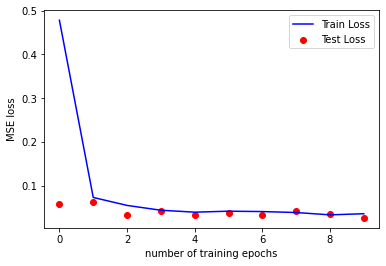

decryption accuracy is 99.28%


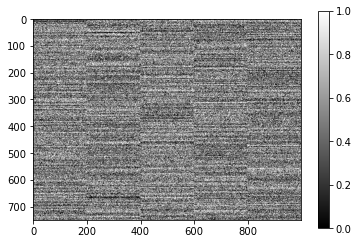

Parameters: 75 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([49, 11, 67, 43, 60, 37, 72, 57, 77, 45,  1, 66, 17, 31, 52, 26,  7, 36,
        80, 35, 70, 42, 27, 87, 17, 58, 47, 59, 23, 55, 63, 15, 14, 32,  4,  9,
        24, 53, 26, 40, 12, 64, 10, 81, 64, 25, 88, 83, 51, 34])
Epoch: 1, Train set: Avg. loss: 0.636376
Test set: Avg. loss: 0.158701
Epoch: 2, Train set: Avg. loss: 0.115028
Test set: Avg. loss: 0.112261
Epoch: 3, Train set: Avg. loss: 0.087333
Test set: Avg. loss: 0.073246
Epoch: 4, Train set: Avg. loss: 0.092162
Test set: Avg. loss: 0.082235
Epoch: 5, Train set: Avg. loss: 0.075375
Test set: Avg. loss: 0.088351
Epoch: 6, Train set: Avg. loss: 0.068631
Test set: Avg. loss: 0.050593
Epoch: 7, Train set: Avg. loss: 0.067674
Test set: Avg. loss: 0.046518
Epoch: 8, Train set: Avg. loss: 0.061591
Test set: Avg. loss: 0.058931
Epoch: 9, Train set: Avg. loss: 0.064396
Test set: Avg. loss: 0.038156
Epoch: 10, Train set: Avg. loss: 0.061825
Test set: Avg. loss: 0.079832


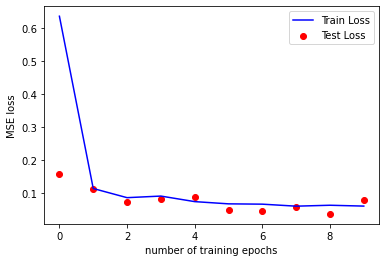

decryption accuracy is 98.13%


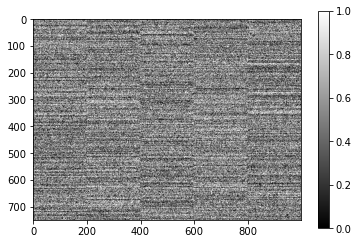

Parameters: 75 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([49, 26, 90, 35, 60, 69, 17, 62, 58, 72,  2,  1, 88, 38, 38, 89, 65,  2,
        16, 52, 41,  5, 33, 69, 79, 26, 42, 72, 21, 31, 36, 93, 29, 40, 77, 48,
        50, 11, 79,  6, 40, 90, 38, 36, 76, 89, 61,  2, 93, 47])
Epoch: 1, Train set: Avg. loss: 0.877731
Test set: Avg. loss: 0.163617
Epoch: 2, Train set: Avg. loss: 0.178027
Test set: Avg. loss: 0.117511
Epoch: 3, Train set: Avg. loss: 0.153621
Test set: Avg. loss: 0.127416
Epoch: 4, Train set: Avg. loss: 0.129610
Test set: Avg. loss: 0.087130
Epoch: 5, Train set: Avg. loss: 0.119086
Test set: Avg. loss: 0.092430
Epoch: 6, Train set: Avg. loss: 0.107008
Test set: Avg. loss: 0.085044
Epoch: 7, Train set: Avg. loss: 0.101435
Test set: Avg. loss: 0.123735
Epoch: 8, Train set: Avg. loss: 0.101089
Test set: Avg. loss: 0.118706
Epoch: 9, Train set: Avg. loss: 0.102274
Test set: Avg. loss: 0.098618
Epoch: 10, Train set: Avg. loss: 0.098415
Test set: Avg. loss: 0.070785


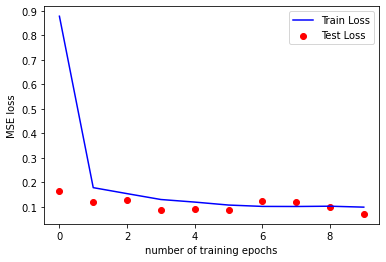

decryption accuracy is 97.86%


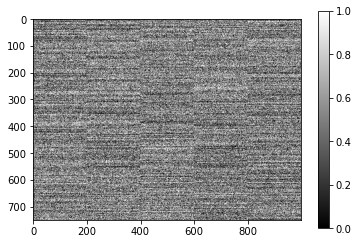

Parameters: 75 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([10, 59, 21, 66, 68,  4, 34, 80, 77, 11, 20, 77,  9, 49, 26, 32, 21, 27,
        59,  0, 45, 62, 82, 56, 93, 62, 33, 56, 16, 84, 79, 41, 49, 16, 60, 41,
        74, 56, 68, 38, 80, 67, 60, 69, 55, 38, 11, 64, 23, 79])
Epoch: 1, Train set: Avg. loss: 1.095691
Test set: Avg. loss: 0.301409
Epoch: 2, Train set: Avg. loss: 0.275969
Test set: Avg. loss: 0.200355
Epoch: 3, Train set: Avg. loss: 0.213524
Test set: Avg. loss: 0.246686
Epoch: 4, Train set: Avg. loss: 0.192175
Test set: Avg. loss: 0.173290
Epoch: 5, Train set: Avg. loss: 0.174881
Test set: Avg. loss: 0.148921
Epoch: 6, Train set: Avg. loss: 0.172695
Test set: Avg. loss: 0.128124
Epoch: 7, Train set: Avg. loss: 0.175664
Test set: Avg. loss: 0.157404
Epoch: 8, Train set: Avg. loss: 0.172623
Test set: Avg. loss: 0.195575
Epoch: 9, Train set: Avg. loss: 0.151397
Test set: Avg. loss: 0.189512
Epoch: 10, Train set: Avg. loss: 0.157765
Test set: Avg. loss: 0.177628


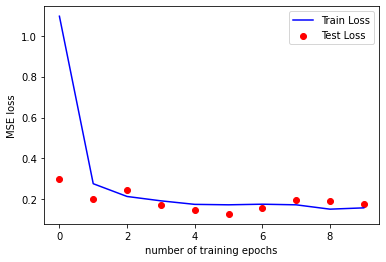

decryption accuracy is 96.07%


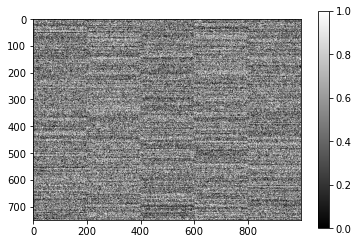

Parameters: 75 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([33, 58, 72,  7, 34, 28, 88, 71, 21, 12, 84, 81,  7, 57, 14, 81, 91, 34,
        39, 53,  7, 76, 35, 45,  3, 38,  2, 10,  7, 87,  1, 46, 47,  4, 67, 59,
        15, 58, 62, 48, 81, 48, 77, 28, 38, 56, 68, 20, 89, 83])
Epoch: 1, Train set: Avg. loss: 1.245503
Test set: Avg. loss: 0.395902
Epoch: 2, Train set: Avg. loss: 0.369378
Test set: Avg. loss: 0.436331
Epoch: 3, Train set: Avg. loss: 0.302505
Test set: Avg. loss: 0.307297
Epoch: 4, Train set: Avg. loss: 0.287132
Test set: Avg. loss: 0.198899
Epoch: 5, Train set: Avg. loss: 0.266010
Test set: Avg. loss: 0.209528
Epoch: 6, Train set: Avg. loss: 0.262532
Test set: Avg. loss: 0.201989
Epoch: 7, Train set: Avg. loss: 0.249288
Test set: Avg. loss: 0.242446
Epoch: 8, Train set: Avg. loss: 0.236619
Test set: Avg. loss: 0.207179
Epoch: 9, Train set: Avg. loss: 0.227061
Test set: Avg. loss: 0.248181
Epoch: 10, Train set: Avg. loss: 0.233032
Test set: Avg. loss: 0

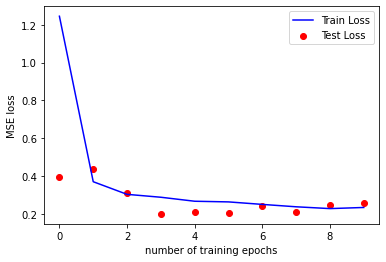

decryption accuracy is 94.32%


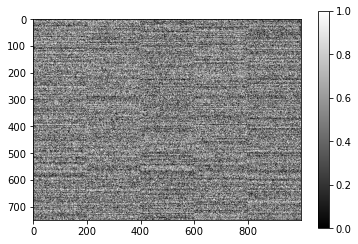

Parameters: 80 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([13, 79, 28, 23, 82, 61, 21, 27, 37, 41, 91, 93, 88, 60, 75, 44,  9, 50,
        66, 49, 63, 40, 37, 37, 54, 75, 41, 33, 53, 68, 19, 54, 75, 21,  4, 58,
        78, 36, 17, 66, 49, 10, 69,  7, 60, 26, 74, 68, 29, 13])
Epoch: 1, Train set: Avg. loss: 0.086036
Test set: Avg. loss: 0.001707
Epoch: 2, Train set: Avg. loss: 0.001260
Test set: Avg. loss: 0.000908
Epoch: 3, Train set: Avg. loss: 0.000742
Test set: Avg. loss: 0.000626
Epoch: 4, Train set: Avg. loss: 0.000548
Test set: Avg. loss: 0.000481
Epoch: 5, Train set: Avg. loss: 0.000429
Test set: Avg. loss: 0.000394
Epoch: 6, Train set: Avg. loss: 0.000359
Test set: Avg. loss: 0.000331
Epoch: 7, Train set: Avg. loss: 0.000304
Test set: Avg. loss: 0.000278
Epoch: 8, Train set: Avg. loss: 0.000267
Test set: Avg. loss: 0.000251
Epoch: 9, Train set: Avg. loss: 0.000240
Test set: Avg. loss: 0.000224
Epoch: 10, Train set: Avg. loss: 0.000211
Test set: Avg. loss: 0.000212


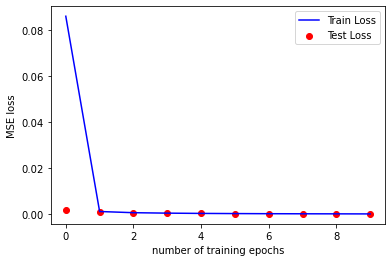

decryption accuracy is 100.0%


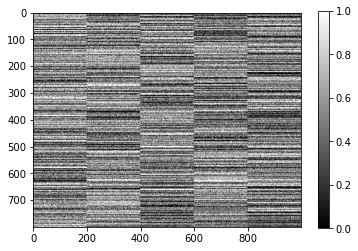

Parameters: 80 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([43, 47, 53, 30,  2, 33, 40, 80, 31, 55, 11, 62, 78,  2, 79, 54, 21,  0,
        12, 54, 15, 62, 70, 31, 27, 66, 56, 42, 83, 39, 36, 41, 62, 38, 54, 30,
        67, 56, 26, 46, 76, 43, 22, 25, 49,  4, 23, 90,  3, 22])
Epoch: 1, Train set: Avg. loss: 0.073607
Test set: Avg. loss: 0.002239
Epoch: 2, Train set: Avg. loss: 0.001723
Test set: Avg. loss: 0.001213
Epoch: 3, Train set: Avg. loss: 0.000983
Test set: Avg. loss: 0.000842
Epoch: 4, Train set: Avg. loss: 0.000818
Test set: Avg. loss: 0.000680
Epoch: 5, Train set: Avg. loss: 0.000577
Test set: Avg. loss: 0.000526
Epoch: 6, Train set: Avg. loss: 0.000489
Test set: Avg. loss: 0.000458
Epoch: 7, Train set: Avg. loss: 0.000425
Test set: Avg. loss: 0.000388
Epoch: 8, Train set: Avg. loss: 0.000379
Test set: Avg. loss: 0.000380
Epoch: 9, Train set: Avg. loss: 0.000330
Test set: Avg. loss: 0.000315
Epoch: 10, Train set: Avg. loss: 0.000312
Test set: Avg. loss: 0.000291


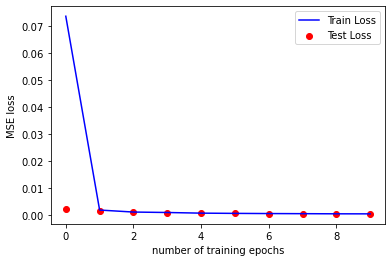

decryption accuracy is 100.0%


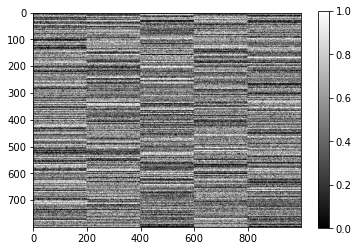

Parameters: 80 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([90, 30, 77, 93, 55, 78, 78, 12, 38, 31, 38, 45, 40, 79, 34, 32, 56, 52,
        80, 64, 72, 86, 16, 77, 62, 36,  8, 73, 10, 33, 71, 54, 33, 66,  8, 91,
        74,  3, 50, 77, 55, 25,  2, 19, 15, 29,  3, 61, 51, 42])
Epoch: 1, Train set: Avg. loss: 0.106705
Test set: Avg. loss: 0.005519
Epoch: 2, Train set: Avg. loss: 0.002527
Test set: Avg. loss: 0.001679
Epoch: 3, Train set: Avg. loss: 0.001408
Test set: Avg. loss: 0.001171
Epoch: 4, Train set: Avg. loss: 0.001115
Test set: Avg. loss: 0.000861
Epoch: 5, Train set: Avg. loss: 0.000875
Test set: Avg. loss: 0.000683
Epoch: 6, Train set: Avg. loss: 0.000743
Test set: Avg. loss: 0.000617
Epoch: 7, Train set: Avg. loss: 0.000588
Test set: Avg. loss: 0.000536
Epoch: 8, Train set: Avg. loss: 0.000587
Test set: Avg. loss: 0.000598
Epoch: 9, Train set: Avg. loss: 0.000452
Test set: Avg. loss: 0.000472
Epoch: 10, Train set: Avg. loss: 0.000403
Test set: Avg. loss: 0.000367


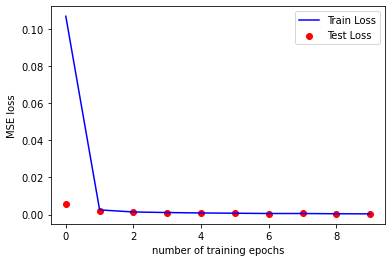

decryption accuracy is 100.0%


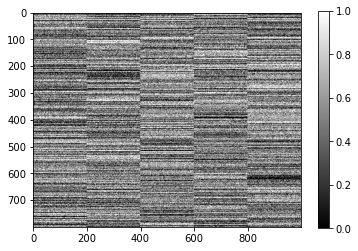

Parameters: 80 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([91, 79, 72, 32, 20, 40, 90, 60,  5, 81, 65,  4, 38, 69,  5, 53, 39, 76,
        81, 45, 77, 21,  9, 14, 58,  8, 50, 69, 53, 79,  6, 51,  1, 20, 74, 80,
        48, 14, 53, 49, 52, 35,  6,  3, 46, 17, 44, 42, 33, 60])
Epoch: 1, Train set: Avg. loss: 0.137811
Test set: Avg. loss: 0.003990
Epoch: 2, Train set: Avg. loss: 0.003734
Test set: Avg. loss: 0.002198
Epoch: 3, Train set: Avg. loss: 0.002439
Test set: Avg. loss: 0.001763
Epoch: 4, Train set: Avg. loss: 0.001502
Test set: Avg. loss: 0.001548
Epoch: 5, Train set: Avg. loss: 0.001240
Test set: Avg. loss: 0.001025
Epoch: 6, Train set: Avg. loss: 0.001003
Test set: Avg. loss: 0.000998
Epoch: 7, Train set: Avg. loss: 0.000890
Test set: Avg. loss: 0.000726
Epoch: 8, Train set: Avg. loss: 0.000735
Test set: Avg. loss: 0.000750
Epoch: 9, Train set: Avg. loss: 0.000693
Test set: Avg. loss: 0.000733
Epoch: 10, Train set: Avg. loss: 0.000609
Test set: Avg. loss: 0.000599


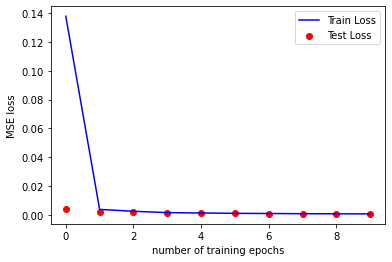

decryption accuracy is 100.0%


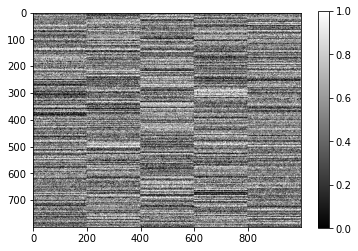

Parameters: 80 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([59, 73, 71, 48, 87, 66, 28, 86,  1,  2, 79, 58, 87, 27, 52, 23, 34, 31,
        74,  1,  8, 90,  0, 85, 45, 61, 28,  0, 22, 35, 36, 70, 59, 26,  8,  5,
        62, 63, 80, 39, 76, 51, 22, 91,  2, 44, 70, 67, 86, 14])
Epoch: 1, Train set: Avg. loss: 0.161036
Test set: Avg. loss: 0.007218
Epoch: 2, Train set: Avg. loss: 0.005598
Test set: Avg. loss: 0.003956
Epoch: 3, Train set: Avg. loss: 0.004465
Test set: Avg. loss: 0.002508
Epoch: 4, Train set: Avg. loss: 0.002787
Test set: Avg. loss: 0.001840
Epoch: 5, Train set: Avg. loss: 0.002491
Test set: Avg. loss: 0.001613
Epoch: 6, Train set: Avg. loss: 0.002044
Test set: Avg. loss: 0.001412
Epoch: 7, Train set: Avg. loss: 0.001478
Test set: Avg. loss: 0.001116
Epoch: 8, Train set: Avg. loss: 0.001666
Test set: Avg. loss: 0.001035
Epoch: 9, Train set: Avg. loss: 0.001672
Test set: Avg. loss: 0.000828
Epoch: 10, Train set: Avg. loss: 0.001247
Test set: Avg. loss: 0.000798


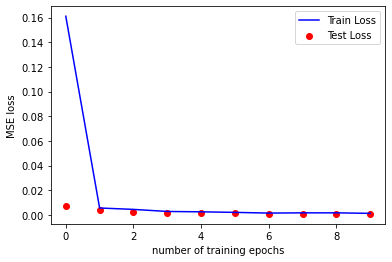

decryption accuracy is 99.99%


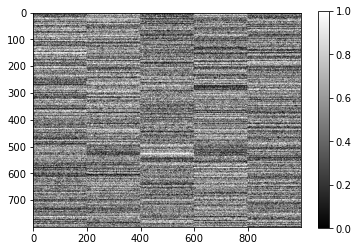

Parameters: 80 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([57, 26, 64, 34, 29, 63, 76, 11, 28, 57, 32, 41, 30, 37,  7, 15, 71, 59,
         6, 13,  3, 52, 57, 19, 61, 32, 37, 16, 62,  6, 71, 63, 84, 70, 16, 59,
         2, 13, 39, 20, 58, 22, 36, 90, 46, 25, 49, 49, 63, 47])
Epoch: 1, Train set: Avg. loss: 0.193425
Test set: Avg. loss: 0.008301
Epoch: 2, Train set: Avg. loss: 0.008023
Test set: Avg. loss: 0.007797
Epoch: 3, Train set: Avg. loss: 0.006565
Test set: Avg. loss: 0.009148
Epoch: 4, Train set: Avg. loss: 0.004239
Test set: Avg. loss: 0.003448
Epoch: 5, Train set: Avg. loss: 0.004996
Test set: Avg. loss: 0.002475
Epoch: 6, Train set: Avg. loss: 0.003904
Test set: Avg. loss: 0.002245
Epoch: 7, Train set: Avg. loss: 0.003803
Test set: Avg. loss: 0.001934
Epoch: 8, Train set: Avg. loss: 0.003276
Test set: Avg. loss: 0.001972
Epoch: 9, Train set: Avg. loss: 0.003230
Test set: Avg. loss: 0.002786
Epoch: 10, Train set: Avg. loss: 0.003388
Test set: Avg. loss: 0.002480


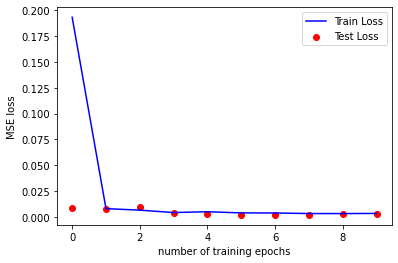

decryption accuracy is 99.94%


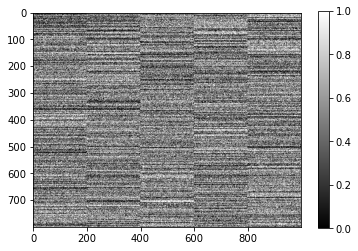

Parameters: 80 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([11, 40, 85, 56, 77, 30, 65, 31, 54, 18, 30, 71, 62, 65, 19, 62, 62,  0,
        64,  1, 19, 59, 31,  7, 42, 35, 26, 16, 76, 63, 71,  9, 71, 50, 28, 30,
        31,  1, 88, 14, 51, 14, 48, 56, 37,  7, 21, 60, 13, 72])
Epoch: 1, Train set: Avg. loss: 0.251925
Test set: Avg. loss: 0.022692
Epoch: 2, Train set: Avg. loss: 0.017419
Test set: Avg. loss: 0.010909
Epoch: 3, Train set: Avg. loss: 0.012033
Test set: Avg. loss: 0.010009
Epoch: 4, Train set: Avg. loss: 0.010813
Test set: Avg. loss: 0.008619
Epoch: 5, Train set: Avg. loss: 0.009230
Test set: Avg. loss: 0.005406
Epoch: 6, Train set: Avg. loss: 0.007427
Test set: Avg. loss: 0.004071
Epoch: 7, Train set: Avg. loss: 0.005728
Test set: Avg. loss: 0.005112
Epoch: 8, Train set: Avg. loss: 0.007442
Test set: Avg. loss: 0.004487
Epoch: 9, Train set: Avg. loss: 0.005425
Test set: Avg. loss: 0.005347
Epoch: 10, Train set: Avg. loss: 0.005453
Test set: Avg. loss: 

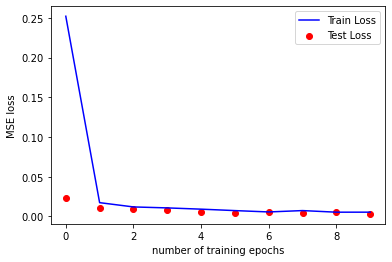

decryption accuracy is 99.95%


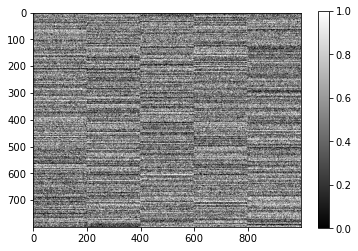

Parameters: 80 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([90, 31, 68, 41, 29, 60, 65, 54, 58,  3, 92, 70, 24, 13, 48,  2, 62, 33,
        57, 84,  4, 21, 46, 42, 58, 91, 60, 87, 18, 62, 69, 68, 52, 62,  1, 65,
        92, 82, 28, 38, 51, 52, 46, 58, 71, 48, 84,  9, 58, 88])
Epoch: 1, Train set: Avg. loss: 0.418251
Test set: Avg. loss: 0.060869
Epoch: 2, Train set: Avg. loss: 0.029234
Test set: Avg. loss: 0.018470
Epoch: 3, Train set: Avg. loss: 0.021889
Test set: Avg. loss: 0.010582
Epoch: 4, Train set: Avg. loss: 0.017363
Test set: Avg. loss: 0.009553
Epoch: 5, Train set: Avg. loss: 0.015038
Test set: Avg. loss: 0.012507
Epoch: 6, Train set: Avg. loss: 0.016952
Test set: Avg. loss: 0.008865
Epoch: 7, Train set: Avg. loss: 0.014182
Test set: Avg. loss: 0.008180
Epoch: 8, Train set: Avg. loss: 0.011022
Test set: Avg. loss: 0.007783
Epoch: 9, Train set: Avg. loss: 0.012186
Test set: Avg. loss: 0.009474
Epoch: 10, Train set: Avg. loss: 0.011866
Test set: Avg. loss: 0.011997


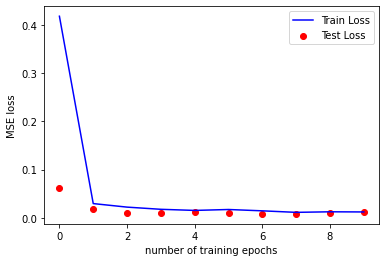

decryption accuracy is 99.7%


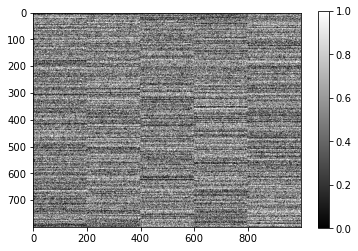

Parameters: 80 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([59, 60, 69, 21, 63, 18, 31, 66,  3, 47, 73, 56, 34, 45, 79, 62, 63, 85,
        28, 42, 76, 18, 37, 61, 11, 65,  2,  1, 93, 40, 20, 82, 26, 12, 17, 57,
         3, 59, 93, 82, 46, 67, 12, 26,  8, 57, 91, 56, 57, 64])
Epoch: 1, Train set: Avg. loss: 0.419306
Test set: Avg. loss: 0.054441
Epoch: 2, Train set: Avg. loss: 0.042179
Test set: Avg. loss: 0.025244
Epoch: 3, Train set: Avg. loss: 0.035538
Test set: Avg. loss: 0.030888
Epoch: 4, Train set: Avg. loss: 0.026000
Test set: Avg. loss: 0.024884
Epoch: 5, Train set: Avg. loss: 0.023610
Test set: Avg. loss: 0.017252
Epoch: 6, Train set: Avg. loss: 0.021885
Test set: Avg. loss: 0.017854
Epoch: 7, Train set: Avg. loss: 0.021652
Test set: Avg. loss: 0.031880
Epoch: 8, Train set: Avg. loss: 0.019626
Test set: Avg. loss: 0.012059
Epoch: 9, Train set: Avg. loss: 0.018984
Test set: Avg. loss: 0.015908
Epoch: 10, Train set: Avg. loss: 0.021758
Test set: Avg. loss: 0.018846


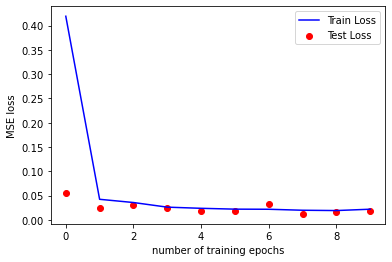

decryption accuracy is 99.52%


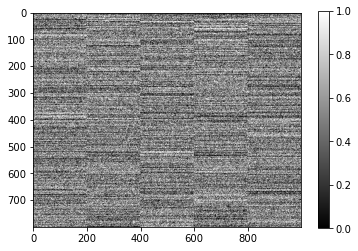

Parameters: 80 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([27, 67, 32, 83, 47, 36, 72, 60, 22, 26, 14, 13,  0, 13,  8, 48, 44,  0,
        75, 60, 89, 11, 62, 12,  6, 19, 29, 24, 61, 31, 54, 87,  5, 30, 44, 90,
        63,  8,  1,  7, 21, 66, 60, 67, 58, 88, 21, 85, 48, 31])
Epoch: 1, Train set: Avg. loss: 0.593342
Test set: Avg. loss: 0.065920
Epoch: 2, Train set: Avg. loss: 0.068240
Test set: Avg. loss: 0.035402
Epoch: 3, Train set: Avg. loss: 0.047942
Test set: Avg. loss: 0.040636
Epoch: 4, Train set: Avg. loss: 0.043714
Test set: Avg. loss: 0.039351
Epoch: 5, Train set: Avg. loss: 0.042145
Test set: Avg. loss: 0.025779
Epoch: 6, Train set: Avg. loss: 0.036171
Test set: Avg. loss: 0.027270
Epoch: 7, Train set: Avg. loss: 0.034468
Test set: Avg. loss: 0.030205
Epoch: 8, Train set: Avg. loss: 0.031552
Test set: Avg. loss: 0.038504
Epoch: 9, Train set: Avg. loss: 0.030457
Test set: Avg. loss: 0.026680
Epoch: 10, Train set: Avg. loss: 0.034064
Test set: Avg. loss: 0.019808


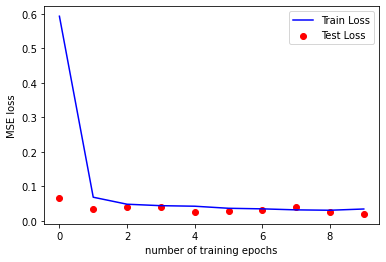

decryption accuracy is 99.51%


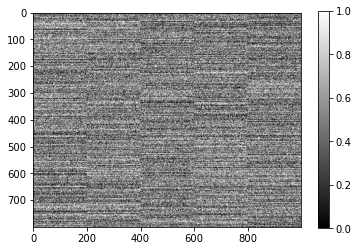

Parameters: 80 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([60, 51, 71, 82, 23, 53, 92, 19, 15, 85, 45, 18,  3, 49, 60, 66, 69, 21,
        52, 14, 38,  4, 63, 38, 61, 61, 25, 37, 66, 49, 59, 26, 71,  8, 17, 48,
        80, 73, 38, 79, 67, 26, 69, 87, 50, 17, 50, 91,  4, 63])
Epoch: 1, Train set: Avg. loss: 0.658055
Test set: Avg. loss: 0.144095
Epoch: 2, Train set: Avg. loss: 0.115310
Test set: Avg. loss: 0.088112
Epoch: 3, Train set: Avg. loss: 0.078415
Test set: Avg. loss: 0.070228
Epoch: 4, Train set: Avg. loss: 0.078127
Test set: Avg. loss: 0.071403
Epoch: 5, Train set: Avg. loss: 0.069192
Test set: Avg. loss: 0.055611
Epoch: 6, Train set: Avg. loss: 0.070144
Test set: Avg. loss: 0.065288
Epoch: 7, Train set: Avg. loss: 0.061461
Test set: Avg. loss: 0.054256
Epoch: 8, Train set: Avg. loss: 0.059124
Test set: Avg. loss: 0.069578
Epoch: 9, Train set: Avg. loss: 0.059643
Test set: Avg. loss: 0.057046
Epoch: 10, Train set: Avg. loss: 0.059522
Test set: Avg. loss: 0.051576


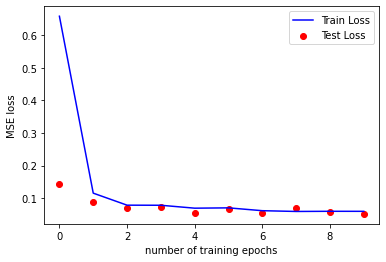

decryption accuracy is 98.72%


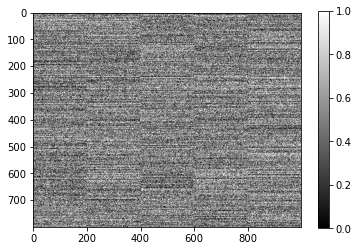

Parameters: 80 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([16, 59, 13, 76, 74, 49, 64, 13, 84, 55, 93, 36, 84, 29, 21, 50, 91, 21,
        43, 34, 52, 33, 40, 70, 47,  0, 82, 18, 51, 11, 27, 52, 91, 36, 15,  3,
        50, 37, 13,  8, 18, 41, 29, 33, 69, 10, 52, 62, 31, 45])
Epoch: 1, Train set: Avg. loss: 0.865425
Test set: Avg. loss: 0.181586
Epoch: 2, Train set: Avg. loss: 0.166259
Test set: Avg. loss: 0.191222
Epoch: 3, Train set: Avg. loss: 0.134928
Test set: Avg. loss: 0.101765
Epoch: 4, Train set: Avg. loss: 0.113028
Test set: Avg. loss: 0.092630
Epoch: 5, Train set: Avg. loss: 0.103091
Test set: Avg. loss: 0.074611
Epoch: 6, Train set: Avg. loss: 0.093170
Test set: Avg. loss: 0.099884
Epoch: 7, Train set: Avg. loss: 0.101734
Test set: Avg. loss: 0.124256
Epoch: 8, Train set: Avg. loss: 0.091791
Test set: Avg. loss: 0.082846
Epoch: 9, Train set: Avg. loss: 0.084829
Test set: Avg. loss: 0.080297
Epoch: 10, Train set: Avg. loss: 0.089860
Test set: Avg. loss: 0.081361


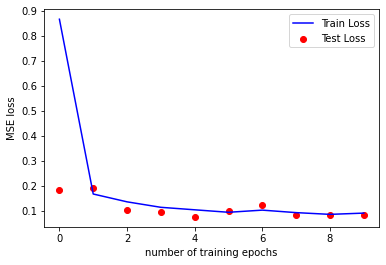

decryption accuracy is 97.8%


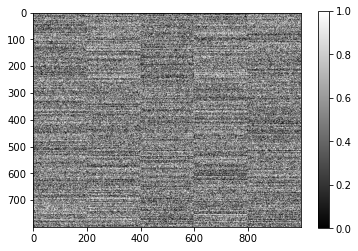

Parameters: 80 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([92, 92,  2, 33, 58, 43, 85, 56,  4, 26, 82, 36, 45, 73, 29, 53, 30, 36,
        85,  8, 25, 52, 62, 40, 55, 84, 31, 25, 62, 68, 53, 66, 29,  6, 35, 60,
        28, 24,  3, 90, 45, 50,  1, 51, 62, 42, 47, 90, 47, 42])
Epoch: 1, Train set: Avg. loss: 1.266898
Test set: Avg. loss: 0.349979
Epoch: 2, Train set: Avg. loss: 0.248987
Test set: Avg. loss: 0.182602
Epoch: 3, Train set: Avg. loss: 0.194640
Test set: Avg. loss: 0.202243
Epoch: 4, Train set: Avg. loss: 0.183122
Test set: Avg. loss: 0.126218
Epoch: 5, Train set: Avg. loss: 0.163270
Test set: Avg. loss: 0.130128
Epoch: 6, Train set: Avg. loss: 0.156541
Test set: Avg. loss: 0.173380
Epoch: 7, Train set: Avg. loss: 0.155129
Test set: Avg. loss: 0.127100
Epoch: 8, Train set: Avg. loss: 0.153832
Test set: Avg. loss: 0.131572
Epoch: 9, Train set: Avg. loss: 0.144083
Test set: Avg. loss: 0.139495
Epoch: 10, Train set: Avg. loss: 0.144458
Test set: Avg. loss: 0.116365


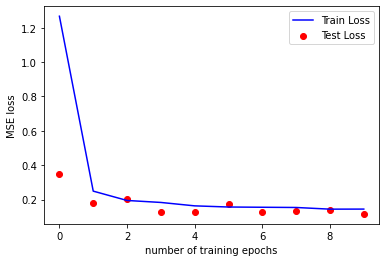

decryption accuracy is 97.22%


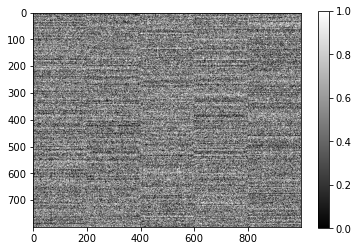

Parameters: 80 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([66, 68, 46,  4, 73, 46, 66, 10, 26,  4, 89, 82, 73,  9, 82, 86, 10, 70,
        13, 11, 52, 37, 59, 24, 55, 82, 71, 25, 72, 36, 33, 19,  5, 74, 35, 25,
        17, 92, 74, 73, 81, 86, 15, 77, 56, 11,  1, 65, 18, 23])
Epoch: 1, Train set: Avg. loss: 1.380936
Test set: Avg. loss: 0.432729
Epoch: 2, Train set: Avg. loss: 0.375360
Test set: Avg. loss: 0.259481
Epoch: 3, Train set: Avg. loss: 0.297044
Test set: Avg. loss: 0.247674
Epoch: 4, Train set: Avg. loss: 0.263225
Test set: Avg. loss: 0.304415
Epoch: 5, Train set: Avg. loss: 0.242264
Test set: Avg. loss: 0.225881
Epoch: 6, Train set: Avg. loss: 0.232240
Test set: Avg. loss: 0.234855
Epoch: 7, Train set: Avg. loss: 0.224039
Test set: Avg. loss: 0.212755
Epoch: 8, Train set: Avg. loss: 0.222718
Test set: Avg. loss: 0.274613
Epoch: 9, Train set: Avg. loss: 0.210110
Test set: Avg. loss: 0.199597
Epoch: 10, Train set: Avg. loss: 0.214905
Test set: Avg. loss: 0

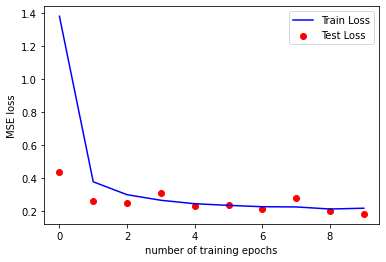

decryption accuracy is 95.41%


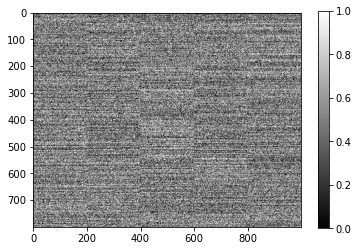

Parameters: 85 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([61, 69, 17, 83, 91, 64, 62, 80, 48, 37, 84,  6,  5,  1, 26, 67, 84, 67,
        40, 82, 92, 79, 84, 61,  1, 15, 13, 55, 14, 13, 59,  0, 14, 92, 63, 25,
        52, 34, 19,  5, 58, 76, 64, 79, 52, 22, 58, 56, 41, 62])
Epoch: 1, Train set: Avg. loss: 0.073476
Test set: Avg. loss: 0.001554
Epoch: 2, Train set: Avg. loss: 0.001122
Test set: Avg. loss: 0.000824
Epoch: 3, Train set: Avg. loss: 0.000681
Test set: Avg. loss: 0.000567
Epoch: 4, Train set: Avg. loss: 0.000504
Test set: Avg. loss: 0.000441
Epoch: 5, Train set: Avg. loss: 0.000390
Test set: Avg. loss: 0.000357
Epoch: 6, Train set: Avg. loss: 0.000324
Test set: Avg. loss: 0.000298
Epoch: 7, Train set: Avg. loss: 0.000272
Test set: Avg. loss: 0.000259
Epoch: 8, Train set: Avg. loss: 0.000245
Test set: Avg. loss: 0.000229
Epoch: 9, Train set: Avg. loss: 0.000211
Test set: Avg. loss: 0.000206
Epoch: 10, Train set: Avg. loss: 0.000192
Test set: Avg. loss: 0.000182


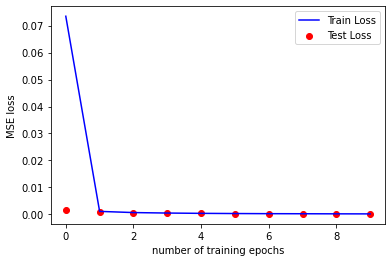

decryption accuracy is 100.0%


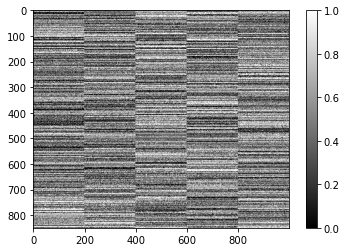

Parameters: 85 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([ 2, 34, 54, 37, 60, 45, 56,  2, 83, 45, 25, 22, 15, 39, 90, 40, 30,  4,
        87, 16, 41, 53, 50,  4, 90, 67,  9,  3, 55, 79,  0, 36,  1, 68, 81, 10,
        24, 15, 35, 82, 60,  1, 67, 71, 43, 46, 36, 59, 75, 63])
Epoch: 1, Train set: Avg. loss: 0.096914
Test set: Avg. loss: 0.002062
Epoch: 2, Train set: Avg. loss: 0.001545
Test set: Avg. loss: 0.001143
Epoch: 3, Train set: Avg. loss: 0.000903
Test set: Avg. loss: 0.000776
Epoch: 4, Train set: Avg. loss: 0.000669
Test set: Avg. loss: 0.000584
Epoch: 5, Train set: Avg. loss: 0.000523
Test set: Avg. loss: 0.000495
Epoch: 6, Train set: Avg. loss: 0.000436
Test set: Avg. loss: 0.000414
Epoch: 7, Train set: Avg. loss: 0.000369
Test set: Avg. loss: 0.000354
Epoch: 8, Train set: Avg. loss: 0.000332
Test set: Avg. loss: 0.000313
Epoch: 9, Train set: Avg. loss: 0.000320
Test set: Avg. loss: 0.000283
Epoch: 10, Train set: Avg. loss: 0.000286
Test set: Avg. loss: 0.000253


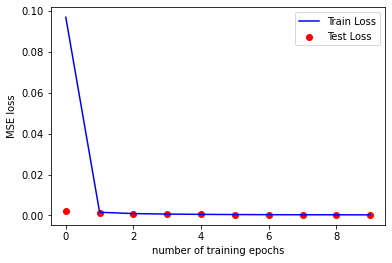

decryption accuracy is 100.0%


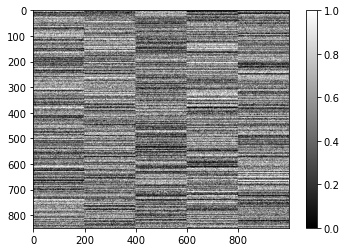

Parameters: 85 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([77, 91, 38, 19, 10, 23, 63, 56, 45, 72, 41, 24, 68,  9, 63, 19, 10, 80,
        19, 13, 93, 72, 45, 77, 58, 92, 21,  5, 85, 55,  8, 90, 68, 41,  6, 71,
        61, 80, 89, 72,  2, 74, 49, 73, 57, 92, 63,  0, 24, 45])
Epoch: 1, Train set: Avg. loss: 0.113507
Test set: Avg. loss: 0.002706
Epoch: 2, Train set: Avg. loss: 0.002011
Test set: Avg. loss: 0.001483
Epoch: 3, Train set: Avg. loss: 0.001276
Test set: Avg. loss: 0.001851
Epoch: 4, Train set: Avg. loss: 0.001059
Test set: Avg. loss: 0.000784
Epoch: 5, Train set: Avg. loss: 0.000773
Test set: Avg. loss: 0.000668
Epoch: 6, Train set: Avg. loss: 0.000664
Test set: Avg. loss: 0.000543
Epoch: 7, Train set: Avg. loss: 0.000537
Test set: Avg. loss: 0.000540
Epoch: 8, Train set: Avg. loss: 0.000462
Test set: Avg. loss: 0.001117
Epoch: 9, Train set: Avg. loss: 0.000411
Test set: Avg. loss: 0.000386
Epoch: 10, Train set: Avg. loss: 0.000344
Test set: Avg. loss: 0.000353


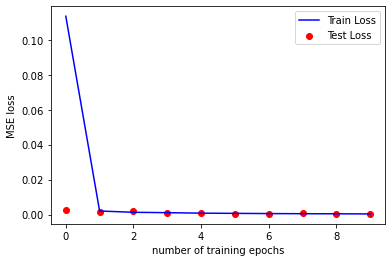

decryption accuracy is 100.0%


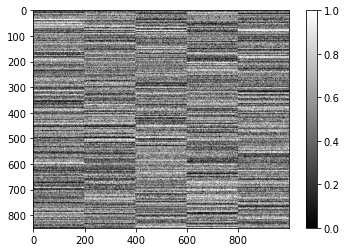

Parameters: 85 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([32, 28,  7, 21, 71, 48, 84, 81,  9, 33, 34, 14, 50,  0, 80, 90, 92, 31,
         2, 39, 54, 30, 29, 65, 36, 60, 18, 66, 37, 73, 55,  9, 11, 58, 85, 72,
        83, 16, 29, 22, 75, 82, 90, 64, 55, 64, 11, 29, 13, 72])
Epoch: 1, Train set: Avg. loss: 0.117591
Test set: Avg. loss: 0.003718
Epoch: 2, Train set: Avg. loss: 0.003071
Test set: Avg. loss: 0.002230
Epoch: 3, Train set: Avg. loss: 0.001848
Test set: Avg. loss: 0.001455
Epoch: 4, Train set: Avg. loss: 0.001420
Test set: Avg. loss: 0.001090
Epoch: 5, Train set: Avg. loss: 0.001096
Test set: Avg. loss: 0.000976
Epoch: 6, Train set: Avg. loss: 0.000897
Test set: Avg. loss: 0.000820
Epoch: 7, Train set: Avg. loss: 0.000707
Test set: Avg. loss: 0.000705
Epoch: 8, Train set: Avg. loss: 0.000683
Test set: Avg. loss: 0.000600
Epoch: 9, Train set: Avg. loss: 0.000666
Test set: Avg. loss: 0.000559
Epoch: 10, Train set: Avg. loss: 0.000721
Test set: Avg. loss: 0.000517


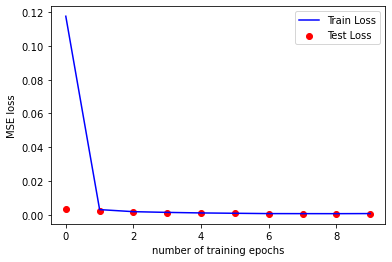

decryption accuracy is 100.0%


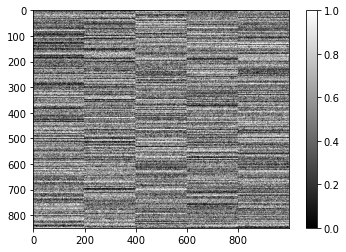

Parameters: 85 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([59, 16, 47, 55, 56, 33, 13, 62, 12, 53, 78, 69, 24, 59, 91, 41, 13, 10,
        61, 32, 33,  4, 18, 50, 51, 29, 28, 51, 92,  3, 17, 58, 28,  3, 40, 25,
        58, 61, 83, 39, 48, 88, 12, 35, 81, 89, 57, 60, 77, 26])
Epoch: 1, Train set: Avg. loss: 0.213453
Test set: Avg. loss: 0.005051
Epoch: 2, Train set: Avg. loss: 0.004965
Test set: Avg. loss: 0.002783
Epoch: 3, Train set: Avg. loss: 0.003258
Test set: Avg. loss: 0.002463
Epoch: 4, Train set: Avg. loss: 0.002620
Test set: Avg. loss: 0.001742
Epoch: 5, Train set: Avg. loss: 0.002479
Test set: Avg. loss: 0.001245
Epoch: 6, Train set: Avg. loss: 0.001618
Test set: Avg. loss: 0.001268
Epoch: 7, Train set: Avg. loss: 0.001263
Test set: Avg. loss: 0.000965
Epoch: 8, Train set: Avg. loss: 0.001271
Test set: Avg. loss: 0.000834
Epoch: 9, Train set: Avg. loss: 0.001034
Test set: Avg. loss: 0.000776
Epoch: 10, Train set: Avg. loss: 0.001035
Test set: Avg. loss: 0.000714


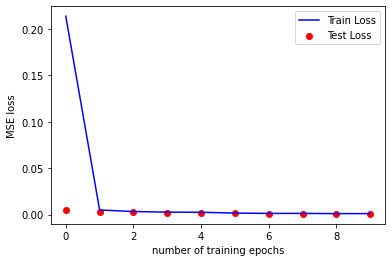

decryption accuracy is 100.0%


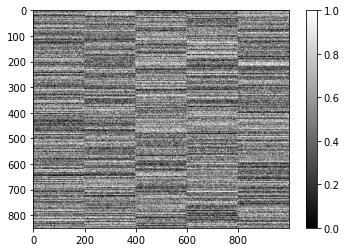

Parameters: 85 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([23, 57,  1, 43, 29, 14, 13, 35, 69, 45, 59, 11, 41, 73, 62, 21, 36, 56,
        71, 27, 36, 76, 26, 74, 92, 92, 24, 54, 14, 79, 86, 60, 84, 80, 31, 45,
        28, 83, 47, 59, 86, 37, 52, 36, 86, 52, 87, 47, 78, 51])
Epoch: 1, Train set: Avg. loss: 0.190587
Test set: Avg. loss: 0.008071
Epoch: 2, Train set: Avg. loss: 0.009907
Test set: Avg. loss: 0.004707
Epoch: 3, Train set: Avg. loss: 0.005899
Test set: Avg. loss: 0.003402
Epoch: 4, Train set: Avg. loss: 0.004287
Test set: Avg. loss: 0.003224
Epoch: 5, Train set: Avg. loss: 0.005106
Test set: Avg. loss: 0.006742
Epoch: 6, Train set: Avg. loss: 0.003508
Test set: Avg. loss: 0.001901
Epoch: 7, Train set: Avg. loss: 0.003198
Test set: Avg. loss: 0.003901
Epoch: 8, Train set: Avg. loss: 0.002711
Test set: Avg. loss: 0.002883
Epoch: 9, Train set: Avg. loss: 0.003213
Test set: Avg. loss: 0.004321
Epoch: 10, Train set: Avg. loss: 0.002059
Test set: Avg. loss: 0.001450


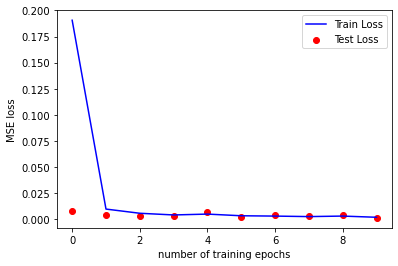

decryption accuracy is 99.97%


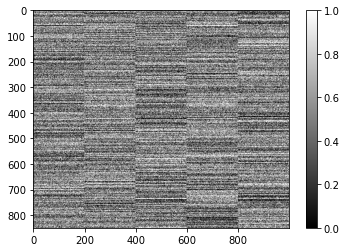

Parameters: 85 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([66, 45,  1, 30, 60, 46,  2, 60, 22, 79, 90, 77, 81, 79, 14, 43, 62, 17,
        93, 61, 90, 92, 19, 40, 29, 54, 54,  8, 34, 75, 32,  6, 79, 68, 57, 66,
        62, 58, 51,  8, 52, 64, 74, 60, 92, 34, 16, 14, 29, 60])
Epoch: 1, Train set: Avg. loss: 0.343812
Test set: Avg. loss: 0.015867
Epoch: 2, Train set: Avg. loss: 0.013760
Test set: Avg. loss: 0.013727
Epoch: 3, Train set: Avg. loss: 0.010489
Test set: Avg. loss: 0.017267
Epoch: 4, Train set: Avg. loss: 0.007678
Test set: Avg. loss: 0.006293
Epoch: 5, Train set: Avg. loss: 0.005965
Test set: Avg. loss: 0.004129
Epoch: 6, Train set: Avg. loss: 0.005383
Test set: Avg. loss: 0.007852
Epoch: 7, Train set: Avg. loss: 0.005675
Test set: Avg. loss: 0.002806
Epoch: 8, Train set: Avg. loss: 0.005583
Test set: Avg. loss: 0.003490
Epoch: 9, Train set: Avg. loss: 0.004263
Test set: Avg. loss: 0.003053
Epoch: 10, Train set: Avg. loss: 0.003763
Test set: Avg. loss: 

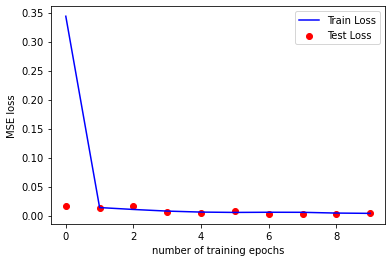

decryption accuracy is 99.87%


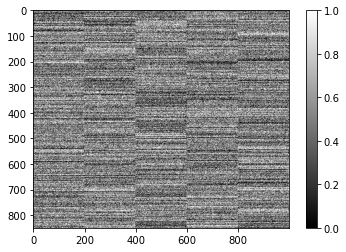

Parameters: 85 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([35, 45,  5, 27,  2, 35, 66, 74, 90, 30, 74, 63, 87, 65, 34, 54,  2,  9,
         9, 78,  5, 63, 52, 34, 20, 46, 83,  2, 83, 48, 47, 41, 33, 58, 42, 15,
        28, 46, 14,  2, 19, 21, 73, 63, 65, 45,  7, 44,  9, 31])
Epoch: 1, Train set: Avg. loss: 0.439599
Test set: Avg. loss: 0.020572
Epoch: 2, Train set: Avg. loss: 0.026908
Test set: Avg. loss: 0.016511
Epoch: 3, Train set: Avg. loss: 0.020255
Test set: Avg. loss: 0.015994
Epoch: 4, Train set: Avg. loss: 0.016913
Test set: Avg. loss: 0.009860
Epoch: 5, Train set: Avg. loss: 0.013495
Test set: Avg. loss: 0.013854
Epoch: 6, Train set: Avg. loss: 0.015027
Test set: Avg. loss: 0.007250
Epoch: 7, Train set: Avg. loss: 0.012125
Test set: Avg. loss: 0.009114
Epoch: 8, Train set: Avg. loss: 0.011036
Test set: Avg. loss: 0.005493
Epoch: 9, Train set: Avg. loss: 0.007863
Test set: Avg. loss: 0.005901
Epoch: 10, Train set: Avg. loss: 0.012525
Test set: Avg. loss: 0.005371


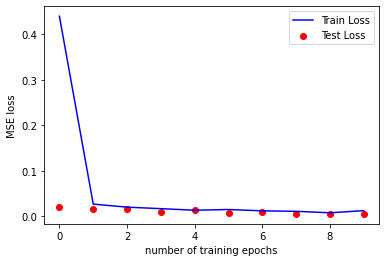

decryption accuracy is 99.92%


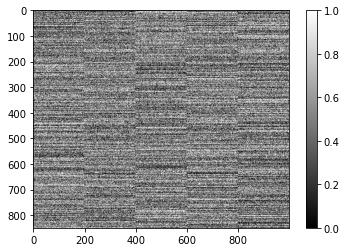

Parameters: 85 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([81, 32, 38, 85, 71, 13, 31, 30,  5, 75, 28, 79, 93, 75, 31, 30, 90, 30,
        12, 30, 23, 76,  9, 78, 50, 28, 10, 58, 47, 13, 58, 83, 12, 75, 34,  8,
        57, 76, 41, 82, 33, 71, 10, 16, 16, 88, 30, 26, 60, 59])
Epoch: 1, Train set: Avg. loss: 0.480442
Test set: Avg. loss: 0.047771
Epoch: 2, Train set: Avg. loss: 0.037194
Test set: Avg. loss: 0.027822
Epoch: 3, Train set: Avg. loss: 0.029455
Test set: Avg. loss: 0.019688
Epoch: 4, Train set: Avg. loss: 0.024188
Test set: Avg. loss: 0.013932
Epoch: 5, Train set: Avg. loss: 0.021282
Test set: Avg. loss: 0.014615
Epoch: 6, Train set: Avg. loss: 0.017193
Test set: Avg. loss: 0.013221
Epoch: 7, Train set: Avg. loss: 0.015615
Test set: Avg. loss: 0.015617
Epoch: 8, Train set: Avg. loss: 0.014635
Test set: Avg. loss: 0.010184
Epoch: 9, Train set: Avg. loss: 0.014754
Test set: Avg. loss: 0.009933
Epoch: 10, Train set: Avg. loss: 0.015783
Test set: Avg. loss: 0.010862


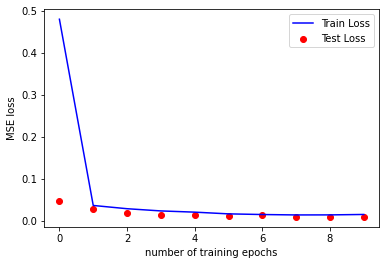

decryption accuracy is 99.79%


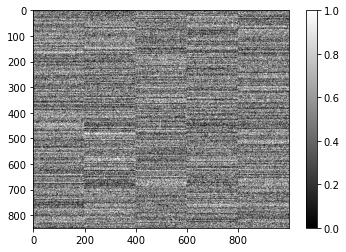

Parameters: 85 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([88, 36, 55,  7, 21, 59,  4, 42, 55, 43, 90, 48, 30, 92,  4, 54, 60, 18,
        70, 27, 55, 10, 89, 24, 38, 73, 29, 56, 55,  2, 69, 40, 89, 85, 64, 42,
        44, 79, 86,  6, 12,  4, 86, 47, 54, 81, 80, 64,  3, 66])
Epoch: 1, Train set: Avg. loss: 0.748738
Test set: Avg. loss: 0.051024
Epoch: 2, Train set: Avg. loss: 0.073089
Test set: Avg. loss: 0.039168
Epoch: 3, Train set: Avg. loss: 0.060366
Test set: Avg. loss: 0.030986
Epoch: 4, Train set: Avg. loss: 0.049096
Test set: Avg. loss: 0.053886
Epoch: 5, Train set: Avg. loss: 0.041248
Test set: Avg. loss: 0.023132
Epoch: 6, Train set: Avg. loss: 0.041459
Test set: Avg. loss: 0.057773
Epoch: 7, Train set: Avg. loss: 0.036392
Test set: Avg. loss: 0.031907
Epoch: 8, Train set: Avg. loss: 0.029782
Test set: Avg. loss: 0.023599
Epoch: 9, Train set: Avg. loss: 0.032208
Test set: Avg. loss: 0.019040
Epoch: 10, Train set: Avg. loss: 0.033114
Test set: Avg. loss: 0.032270


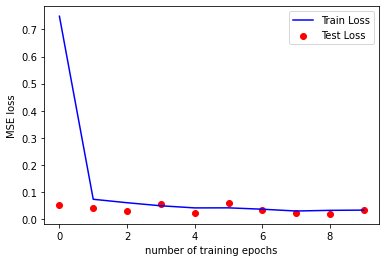

decryption accuracy is 99.34%


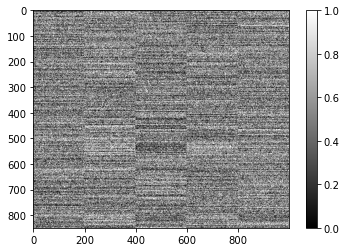

Parameters: 85 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([61, 21, 18, 78, 29, 20, 69, 10, 86, 61, 62, 71, 71, 85, 29, 29, 37, 27,
        91, 60, 82, 30,  4, 45, 10, 32, 92, 81, 71, 45, 34, 61, 63, 73, 64, 21,
        73, 72, 33, 59, 47, 86, 46, 28, 37,  8, 71, 51, 33, 20])
Epoch: 1, Train set: Avg. loss: 0.727676
Test set: Avg. loss: 0.169523
Epoch: 2, Train set: Avg. loss: 0.108434
Test set: Avg. loss: 0.122691
Epoch: 3, Train set: Avg. loss: 0.081065
Test set: Avg. loss: 0.050708
Epoch: 4, Train set: Avg. loss: 0.070621
Test set: Avg. loss: 0.054638
Epoch: 5, Train set: Avg. loss: 0.061637
Test set: Avg. loss: 0.046555
Epoch: 6, Train set: Avg. loss: 0.062709
Test set: Avg. loss: 0.105983
Epoch: 7, Train set: Avg. loss: 0.059614
Test set: Avg. loss: 0.070608
Epoch: 8, Train set: Avg. loss: 0.059980
Test set: Avg. loss: 0.044785
Epoch: 9, Train set: Avg. loss: 0.052980
Test set: Avg. loss: 0.044044
Epoch: 10, Train set: Avg. loss: 0.054220
Test set: Avg. loss: 0.083161


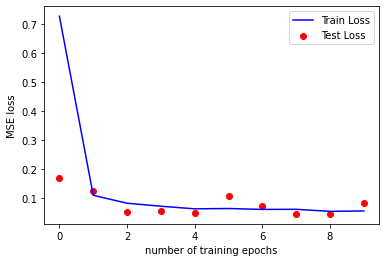

decryption accuracy is 98.37%


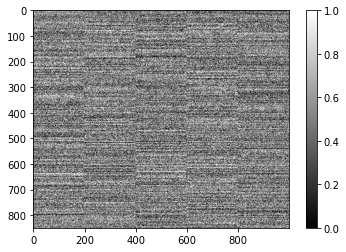

Parameters: 85 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([57, 83, 61, 42, 33, 70, 35, 40, 20, 47, 47, 84, 28, 43, 17, 67, 58, 23,
        77,  8, 11, 72, 92, 29, 58, 86, 81, 25, 73,  8, 49, 73, 79, 15, 65, 39,
        78,  7, 69, 73,  3, 74, 61, 62, 91,  4, 78, 62, 54, 44])
Epoch: 1, Train set: Avg. loss: 1.021479
Test set: Avg. loss: 0.188391
Epoch: 2, Train set: Avg. loss: 0.171165
Test set: Avg. loss: 0.212762
Epoch: 3, Train set: Avg. loss: 0.127650
Test set: Avg. loss: 0.199075
Epoch: 4, Train set: Avg. loss: 0.109570
Test set: Avg. loss: 0.089141
Epoch: 5, Train set: Avg. loss: 0.100349
Test set: Avg. loss: 0.117570
Epoch: 6, Train set: Avg. loss: 0.086964
Test set: Avg. loss: 0.063050
Epoch: 7, Train set: Avg. loss: 0.099864
Test set: Avg. loss: 0.062822
Epoch: 8, Train set: Avg. loss: 0.090996
Test set: Avg. loss: 0.062439
Epoch: 9, Train set: Avg. loss: 0.085388
Test set: Avg. loss: 0.073255
Epoch: 10, Train set: Avg. loss: 0.088749
Test set: Avg. loss: 0.070908


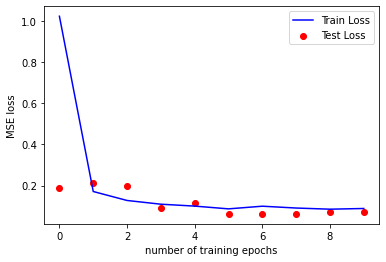

decryption accuracy is 98.22%


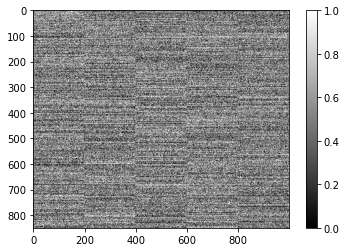

Parameters: 85 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([29, 52, 24, 17, 63, 93, 86, 86, 14, 33,  7, 90,  9, 71, 71, 44, 59,  2,
        43, 13, 48, 49, 57, 87, 77,  2,  9, 89, 34, 85, 74, 82, 87, 80, 82, 61,
        71, 58, 76, 31, 30, 45, 70, 40, 84, 10,  4, 65, 52,  6])
Epoch: 1, Train set: Avg. loss: 1.292197
Test set: Avg. loss: 0.235682
Epoch: 2, Train set: Avg. loss: 0.259944
Test set: Avg. loss: 0.175758
Epoch: 3, Train set: Avg. loss: 0.207481
Test set: Avg. loss: 0.279856
Epoch: 4, Train set: Avg. loss: 0.177814
Test set: Avg. loss: 0.131688
Epoch: 5, Train set: Avg. loss: 0.166932
Test set: Avg. loss: 0.122011
Epoch: 6, Train set: Avg. loss: 0.156321
Test set: Avg. loss: 0.180353
Epoch: 7, Train set: Avg. loss: 0.147472
Test set: Avg. loss: 0.127390
Epoch: 8, Train set: Avg. loss: 0.135198
Test set: Avg. loss: 0.217552
Epoch: 9, Train set: Avg. loss: 0.145718
Test set: Avg. loss: 0.103001
Epoch: 10, Train set: Avg. loss: 0.126142
Test set: Avg. loss: 0.115973


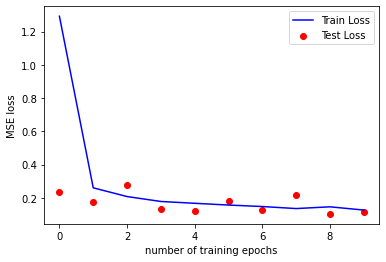

decryption accuracy is 97.16%


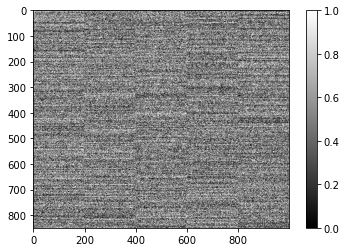

Parameters: 85 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([75, 86,  6, 45, 28, 83, 51, 10, 10, 77, 90, 90, 91, 27, 46, 36, 90, 71,
         2, 83, 34, 77, 50, 25, 54, 57, 27, 58, 59, 67, 31, 91, 11, 30, 13, 33,
        58, 70, 64, 38, 10, 47, 89,  5,  0, 91, 74, 21, 51, 55])
Epoch: 1, Train set: Avg. loss: 1.464582
Test set: Avg. loss: 0.310064
Epoch: 2, Train set: Avg. loss: 0.380855
Test set: Avg. loss: 0.423090
Epoch: 3, Train set: Avg. loss: 0.293648
Test set: Avg. loss: 0.282649
Epoch: 4, Train set: Avg. loss: 0.261107
Test set: Avg. loss: 0.243563
Epoch: 5, Train set: Avg. loss: 0.250609
Test set: Avg. loss: 0.276045
Epoch: 6, Train set: Avg. loss: 0.237056
Test set: Avg. loss: 0.221372
Epoch: 7, Train set: Avg. loss: 0.222229
Test set: Avg. loss: 0.170347
Epoch: 8, Train set: Avg. loss: 0.206755
Test set: Avg. loss: 0.207918
Epoch: 9, Train set: Avg. loss: 0.192822
Test set: Avg. loss: 0.250984
Epoch: 10, Train set: Avg. loss: 0.200852
Test set: Avg. loss: 0

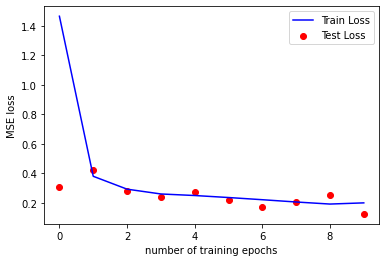

decryption accuracy is 96.6%


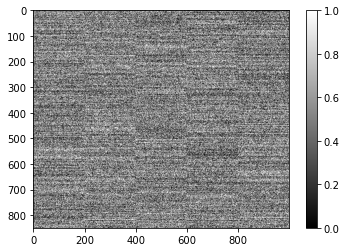

Parameters: 90 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([ 2, 85, 93, 64, 74,  6, 70, 46, 82, 13, 59, 24,  3, 38, 31, 76, 11, 26,
        71, 63, 72, 39, 57, 74, 21,  0, 93,  9, 39, 83, 80, 52,  2, 51, 23, 84,
         7, 44, 16,  5, 82, 53, 85, 61, 71, 90, 68, 71, 78,  7])
Epoch: 1, Train set: Avg. loss: 0.118123
Test set: Avg. loss: 0.001444
Epoch: 2, Train set: Avg. loss: 0.001050
Test set: Avg. loss: 0.000760
Epoch: 3, Train set: Avg. loss: 0.000650
Test set: Avg. loss: 0.000528
Epoch: 4, Train set: Avg. loss: 0.000476
Test set: Avg. loss: 0.000401
Epoch: 5, Train set: Avg. loss: 0.000366
Test set: Avg. loss: 0.000341
Epoch: 6, Train set: Avg. loss: 0.000343
Test set: Avg. loss: 0.000275
Epoch: 7, Train set: Avg. loss: 0.000258
Test set: Avg. loss: 0.000238
Epoch: 8, Train set: Avg. loss: 0.000220
Test set: Avg. loss: 0.000211
Epoch: 9, Train set: Avg. loss: 0.000207
Test set: Avg. loss: 0.000189
Epoch: 10, Train set: Avg. loss: 0.000188
Test set: Avg. loss: 0.000170


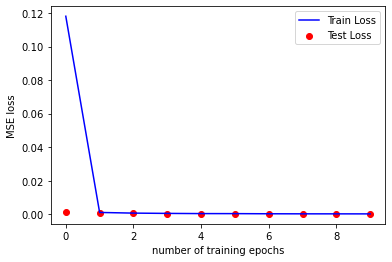

decryption accuracy is 100.0%


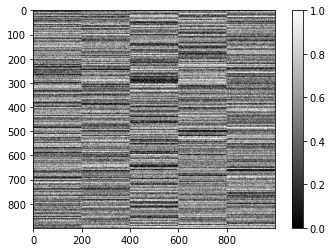

Parameters: 90 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([40, 46, 57,  5,  9, 19, 89, 93, 29, 64, 57, 39, 60, 54, 80, 41, 30, 27,
        34, 27, 61, 34, 38, 72, 79,  7, 32, 50, 46, 90, 27, 67, 39, 78, 63, 13,
        61, 56, 87, 88, 14, 57,  8, 12, 34, 44, 57, 88, 63, 36])
Epoch: 1, Train set: Avg. loss: 0.119427
Test set: Avg. loss: 0.001793
Epoch: 2, Train set: Avg. loss: 0.001307
Test set: Avg. loss: 0.000996
Epoch: 3, Train set: Avg. loss: 0.000850
Test set: Avg. loss: 0.000702
Epoch: 4, Train set: Avg. loss: 0.000610
Test set: Avg. loss: 0.000522
Epoch: 5, Train set: Avg. loss: 0.000485
Test set: Avg. loss: 0.000432
Epoch: 6, Train set: Avg. loss: 0.000413
Test set: Avg. loss: 0.000359
Epoch: 7, Train set: Avg. loss: 0.000339
Test set: Avg. loss: 0.000312
Epoch: 8, Train set: Avg. loss: 0.000299
Test set: Avg. loss: 0.000276
Epoch: 9, Train set: Avg. loss: 0.000264
Test set: Avg. loss: 0.000247
Epoch: 10, Train set: Avg. loss: 0.000248
Test set: Avg. loss: 0.000233


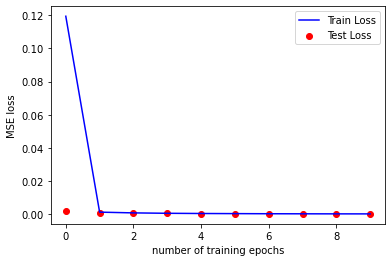

decryption accuracy is 100.0%


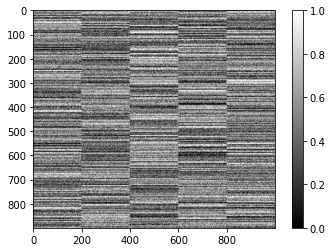

Parameters: 90 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([54, 27, 12,  4, 18, 77, 66, 86, 71,  1, 91, 81, 52, 78, 51, 85,  3, 32,
        47, 75, 32, 48, 65, 21, 12, 46, 69, 33, 59, 92, 42,  4, 66, 42, 51, 53,
        40, 73,  0, 83,  2,  1, 75, 32,  9, 56, 32, 13, 74, 56])
Epoch: 1, Train set: Avg. loss: 0.128385
Test set: Avg. loss: 0.002601
Epoch: 2, Train set: Avg. loss: 0.001911
Test set: Avg. loss: 0.001370
Epoch: 3, Train set: Avg. loss: 0.001206
Test set: Avg. loss: 0.000977
Epoch: 4, Train set: Avg. loss: 0.000824
Test set: Avg. loss: 0.000737
Epoch: 5, Train set: Avg. loss: 0.000696
Test set: Avg. loss: 0.000641
Epoch: 6, Train set: Avg. loss: 0.000545
Test set: Avg. loss: 0.000524
Epoch: 7, Train set: Avg. loss: 0.000476
Test set: Avg. loss: 0.000447
Epoch: 8, Train set: Avg. loss: 0.000409
Test set: Avg. loss: 0.000415
Epoch: 9, Train set: Avg. loss: 0.000378
Test set: Avg. loss: 0.000347
Epoch: 10, Train set: Avg. loss: 0.000339
Test set: Avg. loss: 0.000324


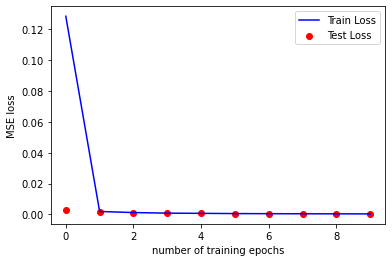

decryption accuracy is 100.0%


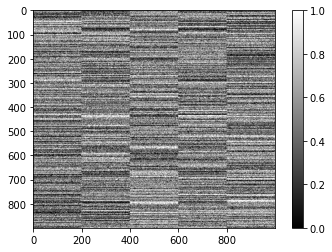

Parameters: 90 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([84,  9, 10, 80, 70, 12, 49, 43, 85, 89, 45,  1, 79, 18, 42, 66, 70, 36,
        39, 44,  4, 38, 89, 27, 91, 67, 19, 34, 12, 84, 41, 41, 38, 36, 73, 68,
        69, 71, 35, 54, 52, 54, 42, 34, 80, 41, 53, 46, 70, 65])
Epoch: 1, Train set: Avg. loss: 0.154223
Test set: Avg. loss: 0.003395
Epoch: 2, Train set: Avg. loss: 0.002841
Test set: Avg. loss: 0.001962
Epoch: 3, Train set: Avg. loss: 0.001598
Test set: Avg. loss: 0.001316
Epoch: 4, Train set: Avg. loss: 0.001501
Test set: Avg. loss: 0.001115
Epoch: 5, Train set: Avg. loss: 0.001153
Test set: Avg. loss: 0.000834
Epoch: 6, Train set: Avg. loss: 0.000816
Test set: Avg. loss: 0.000718
Epoch: 7, Train set: Avg. loss: 0.000674
Test set: Avg. loss: 0.000681
Epoch: 8, Train set: Avg. loss: 0.000743
Test set: Avg. loss: 0.000568
Epoch: 9, Train set: Avg. loss: 0.000880
Test set: Avg. loss: 0.000568
Epoch: 10, Train set: Avg. loss: 0.000715
Test set: Avg. loss: 0.000497


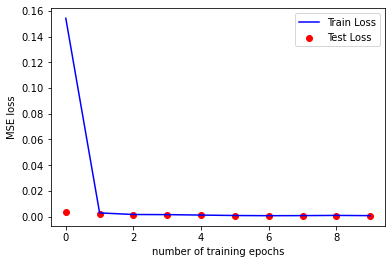

decryption accuracy is 100.0%


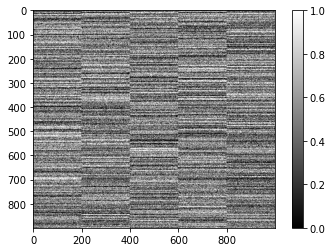

Parameters: 90 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([51, 16, 11, 35, 60, 56, 61, 91, 93, 55, 57, 24, 85, 38,  5, 71, 65, 52,
        67, 68, 22, 70, 46, 92, 22, 70, 64, 26, 56, 64,  6, 12, 65, 49, 17,  1,
        35,  3, 46, 57, 89, 43, 35, 77,  7, 84, 52, 52, 12, 58])
Epoch: 1, Train set: Avg. loss: 0.190584
Test set: Avg. loss: 0.007744
Epoch: 2, Train set: Avg. loss: 0.004371
Test set: Avg. loss: 0.002652
Epoch: 3, Train set: Avg. loss: 0.002132
Test set: Avg. loss: 0.001796
Epoch: 4, Train set: Avg. loss: 0.001835
Test set: Avg. loss: 0.001460
Epoch: 5, Train set: Avg. loss: 0.001600
Test set: Avg. loss: 0.001257
Epoch: 6, Train set: Avg. loss: 0.001118
Test set: Avg. loss: 0.000955
Epoch: 7, Train set: Avg. loss: 0.001160
Test set: Avg. loss: 0.000909
Epoch: 8, Train set: Avg. loss: 0.001146
Test set: Avg. loss: 0.000697
Epoch: 9, Train set: Avg. loss: 0.000810
Test set: Avg. loss: 0.005322
Epoch: 10, Train set: Avg. loss: 0.000772
Test set: Avg. loss: 0.000645


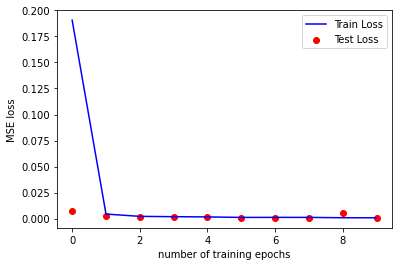

decryption accuracy is 100.0%


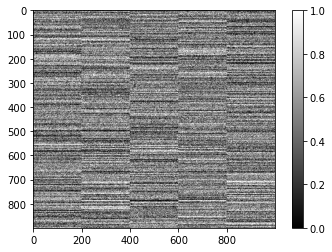

Parameters: 90 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([71, 59, 24, 51, 47, 55,  3, 65, 61, 18, 79, 14, 64, 11, 47, 53, 14, 87,
        68, 25, 20, 21, 92, 52, 66, 91, 17, 75, 27, 59,  1, 46, 58, 11, 72, 75,
        11, 21, 20, 74, 17, 56, 15, 48, 63, 10, 87, 24, 88, 57])
Epoch: 1, Train set: Avg. loss: 0.331881
Test set: Avg. loss: 0.008562
Epoch: 2, Train set: Avg. loss: 0.007905
Test set: Avg. loss: 0.006385
Epoch: 3, Train set: Avg. loss: 0.004387
Test set: Avg. loss: 0.002980
Epoch: 4, Train set: Avg. loss: 0.003547
Test set: Avg. loss: 0.002502
Epoch: 5, Train set: Avg. loss: 0.002395
Test set: Avg. loss: 0.002359
Epoch: 6, Train set: Avg. loss: 0.002642
Test set: Avg. loss: 0.002015
Epoch: 7, Train set: Avg. loss: 0.001809
Test set: Avg. loss: 0.001184
Epoch: 8, Train set: Avg. loss: 0.002332
Test set: Avg. loss: 0.001187
Epoch: 9, Train set: Avg. loss: 0.002293
Test set: Avg. loss: 0.001249
Epoch: 10, Train set: Avg. loss: 0.001911
Test set: Avg. loss: 0.001458


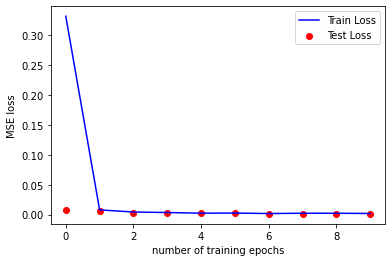

decryption accuracy is 99.98%


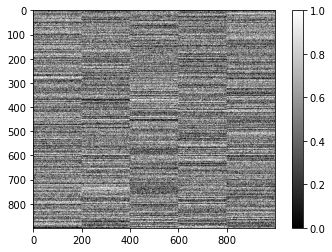

Parameters: 90 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([62, 16, 27, 92, 82, 21, 33, 24, 87, 55, 91, 92,  4, 78, 32, 49, 38, 13,
        63, 57, 55, 90, 22, 72, 26, 80, 27, 66, 91,  0, 60, 92, 73, 32, 45, 16,
        45, 89,  3, 77, 70,  6, 68, 54, 69, 67, 53, 38, 16, 91])
Epoch: 1, Train set: Avg. loss: 0.400976
Test set: Avg. loss: 0.028942
Epoch: 2, Train set: Avg. loss: 0.013528
Test set: Avg. loss: 0.005601
Epoch: 3, Train set: Avg. loss: 0.008738
Test set: Avg. loss: 0.016182
Epoch: 4, Train set: Avg. loss: 0.007631
Test set: Avg. loss: 0.006540
Epoch: 5, Train set: Avg. loss: 0.005747
Test set: Avg. loss: 0.007018
Epoch: 6, Train set: Avg. loss: 0.005571
Test set: Avg. loss: 0.004092
Epoch: 7, Train set: Avg. loss: 0.003792
Test set: Avg. loss: 0.002438
Epoch: 8, Train set: Avg. loss: 0.004930
Test set: Avg. loss: 0.032378
Epoch: 9, Train set: Avg. loss: 0.005626
Test set: Avg. loss: 0.005261
Epoch: 10, Train set: Avg. loss: 0.003691
Test set: Avg. loss: 

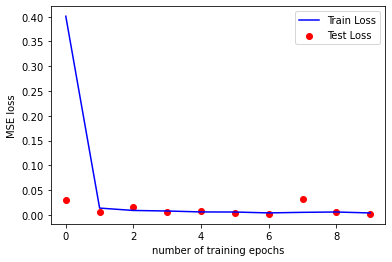

decryption accuracy is 99.96%


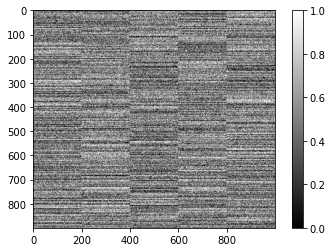

Parameters: 90 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([73, 65, 85, 25, 47, 49, 56,  3, 41,  3, 32, 31, 89, 14, 42, 58, 37,  3,
        35, 61,  4, 92, 78, 77, 26, 30, 92, 89, 36, 92, 57, 62, 72, 35, 76, 60,
        40, 59, 16, 14, 37, 54, 77, 68, 13, 33, 88, 40, 68, 55])
Epoch: 1, Train set: Avg. loss: 0.434054
Test set: Avg. loss: 0.021298
Epoch: 2, Train set: Avg. loss: 0.023686
Test set: Avg. loss: 0.029851
Epoch: 3, Train set: Avg. loss: 0.018918
Test set: Avg. loss: 0.022203
Epoch: 4, Train set: Avg. loss: 0.016492
Test set: Avg. loss: 0.015228
Epoch: 5, Train set: Avg. loss: 0.011247
Test set: Avg. loss: 0.007508
Epoch: 6, Train set: Avg. loss: 0.010923
Test set: Avg. loss: 0.013306
Epoch: 7, Train set: Avg. loss: 0.008720
Test set: Avg. loss: 0.006850
Epoch: 8, Train set: Avg. loss: 0.009562
Test set: Avg. loss: 0.007896
Epoch: 9, Train set: Avg. loss: 0.009133
Test set: Avg. loss: 0.007319
Epoch: 10, Train set: Avg. loss: 0.008553
Test set: Avg. loss: 0.007197


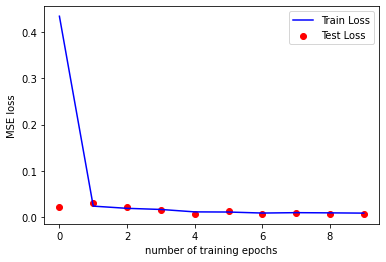

decryption accuracy is 99.83%


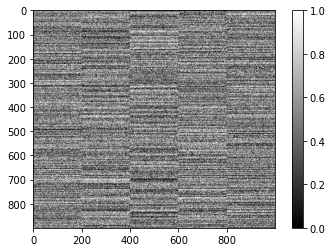

Parameters: 90 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([ 9, 40,  5, 21, 61, 57, 41, 11, 14, 85,  7, 34, 71, 20, 13, 61, 70,  1,
        69, 26, 49, 62, 56, 81, 72, 93, 92, 30, 91,  4, 45, 36, 73, 75, 41, 52,
        44, 75, 28,  8, 33, 33, 69, 47, 61, 15, 10, 77, 19, 68])
Epoch: 1, Train set: Avg. loss: 0.520680
Test set: Avg. loss: 0.043638
Epoch: 2, Train set: Avg. loss: 0.038706
Test set: Avg. loss: 0.020269
Epoch: 3, Train set: Avg. loss: 0.031133
Test set: Avg. loss: 0.088439
Epoch: 4, Train set: Avg. loss: 0.029212
Test set: Avg. loss: 0.016049
Epoch: 5, Train set: Avg. loss: 0.020985
Test set: Avg. loss: 0.013429
Epoch: 6, Train set: Avg. loss: 0.019359
Test set: Avg. loss: 0.010412
Epoch: 7, Train set: Avg. loss: 0.017341
Test set: Avg. loss: 0.009876
Epoch: 8, Train set: Avg. loss: 0.017532
Test set: Avg. loss: 0.012049
Epoch: 9, Train set: Avg. loss: 0.019343
Test set: Avg. loss: 0.028713
Epoch: 10, Train set: Avg. loss: 0.014789
Test set: Avg. loss: 0.028868


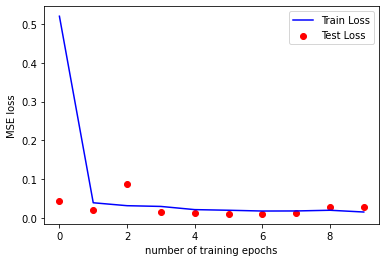

decryption accuracy is 99.38%


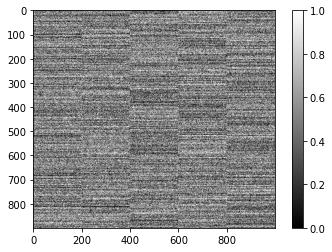

Parameters: 90 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([ 1, 48, 84, 22, 44, 42, 61, 85, 47, 72, 46, 62, 81, 78, 17, 31, 48, 65,
        67, 79, 13, 25, 22, 24, 44, 88, 16, 32, 46, 92, 55, 74, 22, 76, 76, 16,
        14, 23, 62, 38, 48, 49, 32, 26,  5, 27, 85, 90, 20, 11])
Epoch: 1, Train set: Avg. loss: 0.723225
Test set: Avg. loss: 0.124025
Epoch: 2, Train set: Avg. loss: 0.065947
Test set: Avg. loss: 0.034480
Epoch: 3, Train set: Avg. loss: 0.048509
Test set: Avg. loss: 0.034033
Epoch: 4, Train set: Avg. loss: 0.041708
Test set: Avg. loss: 0.036531
Epoch: 5, Train set: Avg. loss: 0.039619
Test set: Avg. loss: 0.015050
Epoch: 6, Train set: Avg. loss: 0.034090
Test set: Avg. loss: 0.064843
Epoch: 7, Train set: Avg. loss: 0.031598
Test set: Avg. loss: 0.039939
Epoch: 8, Train set: Avg. loss: 0.031033
Test set: Avg. loss: 0.023214
Epoch: 9, Train set: Avg. loss: 0.029828
Test set: Avg. loss: 0.023492
Epoch: 10, Train set: Avg. loss: 0.027400
Test set: Avg. loss: 0.023303


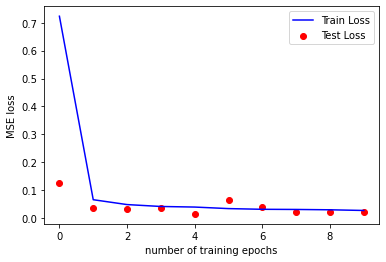

decryption accuracy is 99.33%


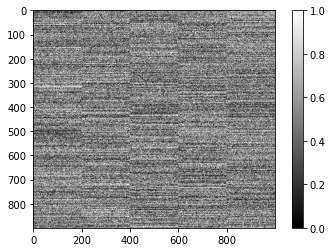

Parameters: 90 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([ 2, 29, 69, 30, 28, 23, 64, 90, 28, 14, 58, 15, 61, 69, 19, 59, 77, 47,
        37, 21, 42, 40,  9, 26, 68, 45, 82, 57, 74, 87, 24, 68, 83, 13, 39, 21,
        15, 74, 27, 49, 51, 46, 64, 72, 48, 84, 73, 47, 28, 18])
Epoch: 1, Train set: Avg. loss: 0.768160
Test set: Avg. loss: 0.140398
Epoch: 2, Train set: Avg. loss: 0.102693
Test set: Avg. loss: 0.050068
Epoch: 3, Train set: Avg. loss: 0.073424
Test set: Avg. loss: 0.085328
Epoch: 4, Train set: Avg. loss: 0.068636
Test set: Avg. loss: 0.036317
Epoch: 5, Train set: Avg. loss: 0.058910
Test set: Avg. loss: 0.079463
Epoch: 6, Train set: Avg. loss: 0.058177
Test set: Avg. loss: 0.049795
Epoch: 7, Train set: Avg. loss: 0.052418
Test set: Avg. loss: 0.058628
Epoch: 8, Train set: Avg. loss: 0.052322
Test set: Avg. loss: 0.038728
Epoch: 9, Train set: Avg. loss: 0.044178
Test set: Avg. loss: 0.029390
Epoch: 10, Train set: Avg. loss: 0.046505
Test set: Avg. loss: 0.056947


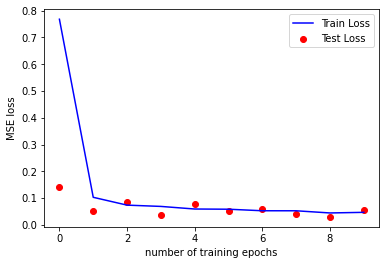

decryption accuracy is 98.84%


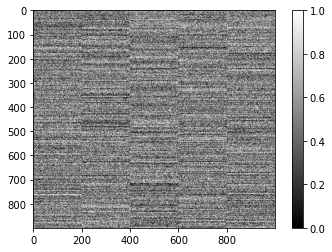

Parameters: 90 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([55, 28, 61, 68, 71, 61, 39,  3, 21,  2, 36, 31,  3, 46, 58, 64, 56, 59,
        46,  0, 36, 52, 28, 49,  3, 40, 80, 27, 62, 52, 18, 19, 49, 73, 89, 57,
        14,  8, 20, 40, 31,  9, 56, 62, 50, 85, 20, 68, 40, 59])
Epoch: 1, Train set: Avg. loss: 1.178744
Test set: Avg. loss: 0.189069
Epoch: 2, Train set: Avg. loss: 0.160967
Test set: Avg. loss: 0.089917
Epoch: 3, Train set: Avg. loss: 0.134160
Test set: Avg. loss: 0.106065
Epoch: 4, Train set: Avg. loss: 0.109934
Test set: Avg. loss: 0.097122
Epoch: 5, Train set: Avg. loss: 0.108636
Test set: Avg. loss: 0.075501
Epoch: 6, Train set: Avg. loss: 0.094342
Test set: Avg. loss: 0.055329
Epoch: 7, Train set: Avg. loss: 0.091571
Test set: Avg. loss: 0.070769
Epoch: 8, Train set: Avg. loss: 0.086656
Test set: Avg. loss: 0.076712
Epoch: 9, Train set: Avg. loss: 0.080173
Test set: Avg. loss: 0.064348
Epoch: 10, Train set: Avg. loss: 0.077842
Test set: Avg. loss: 0.085545


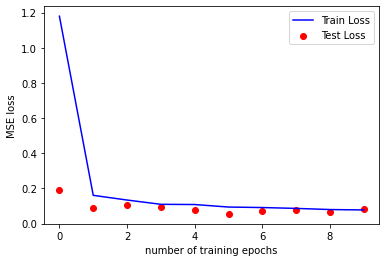

decryption accuracy is 97.99%


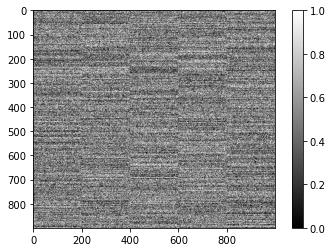

Parameters: 90 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([42, 68, 64, 71, 60, 13, 29, 89, 55, 33, 56, 81, 38,  5, 21, 49, 81, 52,
        16,  9, 51, 80,  9,  1,  5, 43, 91, 34, 58, 50, 75, 66, 58, 22, 73, 10,
        71, 37, 81, 52, 28, 41, 15, 24, 12, 26, 86, 28, 85, 23])
Epoch: 1, Train set: Avg. loss: 1.313254
Test set: Avg. loss: 0.234249
Epoch: 2, Train set: Avg. loss: 0.223410
Test set: Avg. loss: 0.193449
Epoch: 3, Train set: Avg. loss: 0.175442
Test set: Avg. loss: 0.113220
Epoch: 4, Train set: Avg. loss: 0.157098
Test set: Avg. loss: 0.131212
Epoch: 5, Train set: Avg. loss: 0.136116
Test set: Avg. loss: 0.187779
Epoch: 6, Train set: Avg. loss: 0.130043
Test set: Avg. loss: 0.120247
Epoch: 7, Train set: Avg. loss: 0.122104
Test set: Avg. loss: 0.113990
Epoch: 8, Train set: Avg. loss: 0.126526
Test set: Avg. loss: 0.092400
Epoch: 9, Train set: Avg. loss: 0.115000
Test set: Avg. loss: 0.099855
Epoch: 10, Train set: Avg. loss: 0.117448
Test set: Avg. loss: 0.100613


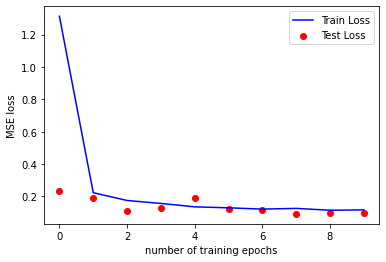

decryption accuracy is 97.88%


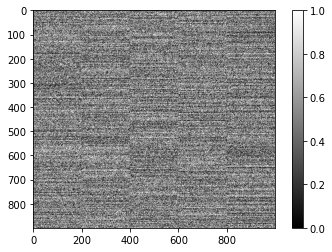

Parameters: 90 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([92, 74, 50, 19, 49, 45, 93, 75, 30, 17, 44, 82, 93, 92,  5, 13, 25, 71,
        31,  0,  9,  0, 72, 33, 42, 42, 76,  9, 20, 82, 22, 54, 25, 82, 90, 15,
        27, 15, 50, 54,  0, 80, 16, 34, 76, 45, 61, 36, 89, 56])
Epoch: 1, Train set: Avg. loss: 1.655218
Test set: Avg. loss: 0.566072
Epoch: 2, Train set: Avg. loss: 0.333448
Test set: Avg. loss: 0.407647
Epoch: 3, Train set: Avg. loss: 0.282727
Test set: Avg. loss: 0.296775
Epoch: 4, Train set: Avg. loss: 0.244281
Test set: Avg. loss: 0.300542
Epoch: 5, Train set: Avg. loss: 0.210302
Test set: Avg. loss: 0.217634
Epoch: 6, Train set: Avg. loss: 0.206681
Test set: Avg. loss: 0.226412
Epoch: 7, Train set: Avg. loss: 0.191681
Test set: Avg. loss: 0.244680
Epoch: 8, Train set: Avg. loss: 0.180563
Test set: Avg. loss: 0.263620
Epoch: 9, Train set: Avg. loss: 0.187818
Test set: Avg. loss: 0.184229
Epoch: 10, Train set: Avg. loss: 0.183674
Test set: Avg. loss: 0

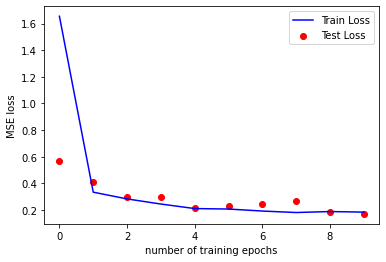

decryption accuracy is 96.02%


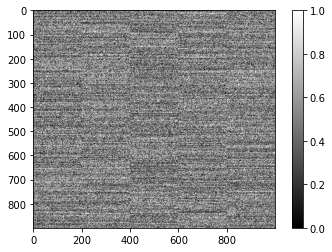

Parameters: 95 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([ 9, 56,  9, 39, 44,  3, 93, 25, 47, 23, 18,  4,  2, 82, 10, 73, 18, 63,
        87, 12, 68,  9, 28, 38, 75, 91,  0, 60, 83, 23,  1,  8, 76, 59, 81, 40,
        51, 39, 17, 91, 21, 86, 46, 54,  4, 28, 34, 13, 18, 14])
Epoch: 1, Train set: Avg. loss: 0.094581
Test set: Avg. loss: 0.001312
Epoch: 2, Train set: Avg. loss: 0.000948
Test set: Avg. loss: 0.000700
Epoch: 3, Train set: Avg. loss: 0.000589
Test set: Avg. loss: 0.000483
Epoch: 4, Train set: Avg. loss: 0.000418
Test set: Avg. loss: 0.000369
Epoch: 5, Train set: Avg. loss: 0.000330
Test set: Avg. loss: 0.000299
Epoch: 6, Train set: Avg. loss: 0.000280
Test set: Avg. loss: 0.000254
Epoch: 7, Train set: Avg. loss: 0.000233
Test set: Avg. loss: 0.000222
Epoch: 8, Train set: Avg. loss: 0.000206
Test set: Avg. loss: 0.000198
Epoch: 9, Train set: Avg. loss: 0.000185
Test set: Avg. loss: 0.000175
Epoch: 10, Train set: Avg. loss: 0.000171
Test set: Avg. loss: 0.000157


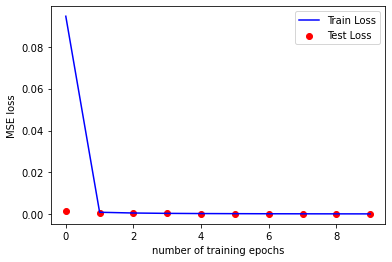

decryption accuracy is 100.0%


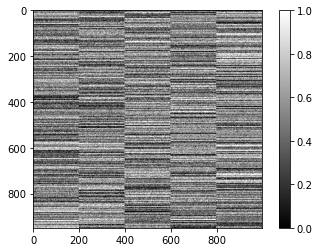

Parameters: 95 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([34, 50, 88, 59,  6,  1, 11, 60, 93, 24, 81,  7, 88, 65, 89, 52,  3, 89,
        21, 54, 30, 65, 73, 85, 18, 65, 42, 93,  3, 86, 27, 52, 63, 29, 44, 21,
        53, 90, 46, 78, 52, 11, 23, 25, 32, 26, 82, 70,  5, 80])
Epoch: 1, Train set: Avg. loss: 0.186940
Test set: Avg. loss: 0.001594
Epoch: 2, Train set: Avg. loss: 0.001181
Test set: Avg. loss: 0.000873
Epoch: 3, Train set: Avg. loss: 0.000725
Test set: Avg. loss: 0.000606
Epoch: 4, Train set: Avg. loss: 0.000539
Test set: Avg. loss: 0.000493
Epoch: 5, Train set: Avg. loss: 0.000451
Test set: Avg. loss: 0.000398
Epoch: 6, Train set: Avg. loss: 0.000368
Test set: Avg. loss: 0.000348
Epoch: 7, Train set: Avg. loss: 0.000308
Test set: Avg. loss: 0.000296
Epoch: 8, Train set: Avg. loss: 0.000270
Test set: Avg. loss: 0.000260
Epoch: 9, Train set: Avg. loss: 0.000261
Test set: Avg. loss: 0.000236
Epoch: 10, Train set: Avg. loss: 0.000219
Test set: Avg. loss: 0.000220


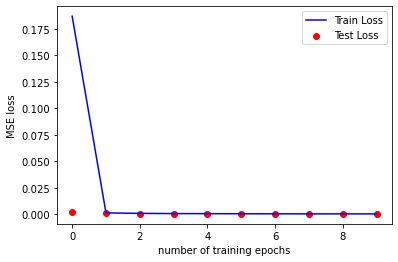

decryption accuracy is 100.0%


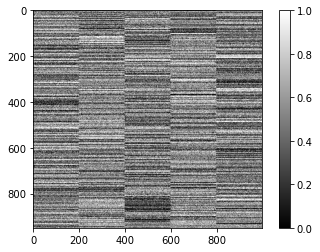

Parameters: 95 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([77, 59, 85, 51, 24, 40, 51, 57, 63, 62,  3,  2, 85, 55,  4, 50, 77, 47,
         0, 35, 79, 16,  0, 43, 24, 82, 37,  9, 30,  5, 75,  9, 31, 75, 30,  5,
        80, 82, 25, 92, 80, 69, 30, 62, 44, 28, 70, 17,  1, 56])
Epoch: 1, Train set: Avg. loss: 0.151919
Test set: Avg. loss: 0.004739
Epoch: 2, Train set: Avg. loss: 0.002399
Test set: Avg. loss: 0.001248
Epoch: 3, Train set: Avg. loss: 0.001057
Test set: Avg. loss: 0.000841
Epoch: 4, Train set: Avg. loss: 0.000826
Test set: Avg. loss: 0.000661
Epoch: 5, Train set: Avg. loss: 0.000862
Test set: Avg. loss: 0.000537
Epoch: 6, Train set: Avg. loss: 0.000545
Test set: Avg. loss: 0.000465
Epoch: 7, Train set: Avg. loss: 0.000439
Test set: Avg. loss: 0.000418
Epoch: 8, Train set: Avg. loss: 0.000461
Test set: Avg. loss: 0.000351
Epoch: 9, Train set: Avg. loss: 0.000342
Test set: Avg. loss: 0.000324
Epoch: 10, Train set: Avg. loss: 0.000329
Test set: Avg. loss: 0.000653


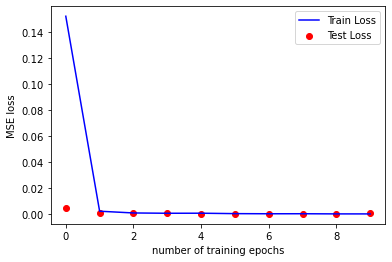

decryption accuracy is 100.0%


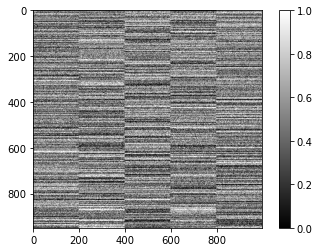

Parameters: 95 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([47, 69, 34, 27, 35, 79, 43, 28, 40, 43, 11, 75, 36, 93, 68, 32, 50, 68,
        50, 59,  8, 35, 57, 55, 72, 89, 59, 18, 24,  2, 52, 16, 16, 61, 38, 31,
        90, 63, 89, 68, 16, 83,  0, 65, 75, 84, 59, 70, 51, 72])
Epoch: 1, Train set: Avg. loss: 0.149702
Test set: Avg. loss: 0.003219
Epoch: 2, Train set: Avg. loss: 0.003306
Test set: Avg. loss: 0.001724
Epoch: 3, Train set: Avg. loss: 0.002032
Test set: Avg. loss: 0.001255
Epoch: 4, Train set: Avg. loss: 0.001155
Test set: Avg. loss: 0.000982
Epoch: 5, Train set: Avg. loss: 0.000896
Test set: Avg. loss: 0.000938
Epoch: 6, Train set: Avg. loss: 0.000898
Test set: Avg. loss: 0.000704
Epoch: 7, Train set: Avg. loss: 0.000660
Test set: Avg. loss: 0.000614
Epoch: 8, Train set: Avg. loss: 0.000594
Test set: Avg. loss: 0.000499
Epoch: 9, Train set: Avg. loss: 0.000538
Test set: Avg. loss: 0.000487
Epoch: 10, Train set: Avg. loss: 0.000546
Test set: Avg. loss: 0.000629


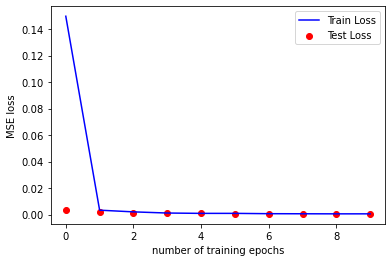

decryption accuracy is 100.0%


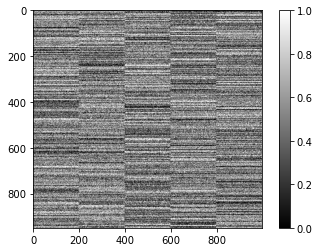

Parameters: 95 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([73, 12, 77, 62, 83,  9, 16, 90,  3, 16, 72, 29, 82, 88, 62, 28, 79, 38,
        59, 11, 73, 25, 51, 88, 15, 67, 58, 37, 80, 56, 77, 29, 30, 30, 51, 68,
        29, 30,  5, 75, 51, 34, 73, 91, 53, 69, 17,  5, 19, 92])
Epoch: 1, Train set: Avg. loss: 0.252296
Test set: Avg. loss: 0.004011
Epoch: 2, Train set: Avg. loss: 0.003402
Test set: Avg. loss: 0.002646
Epoch: 3, Train set: Avg. loss: 0.002793
Test set: Avg. loss: 0.001615
Epoch: 4, Train set: Avg. loss: 0.002101
Test set: Avg. loss: 0.002224
Epoch: 5, Train set: Avg. loss: 0.001734
Test set: Avg. loss: 0.003899
Epoch: 6, Train set: Avg. loss: 0.001232
Test set: Avg. loss: 0.001053
Epoch: 7, Train set: Avg. loss: 0.000802
Test set: Avg. loss: 0.000907
Epoch: 8, Train set: Avg. loss: 0.001025
Test set: Avg. loss: 0.000644
Epoch: 9, Train set: Avg. loss: 0.000796
Test set: Avg. loss: 0.000588
Epoch: 10, Train set: Avg. loss: 0.000773
Test set: Avg. loss: 0.000655


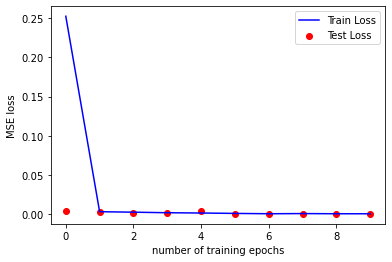

decryption accuracy is 100.0%


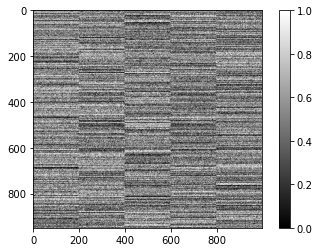

Parameters: 95 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([20, 11, 31, 39, 36, 14, 90, 68, 45, 88, 20, 27, 87, 29, 89, 37, 78, 26,
         3, 86, 16, 83, 35, 16, 50, 59, 11, 10, 80, 63, 27, 80, 56, 29, 71, 74,
        40, 11, 38, 64, 81, 48,  6, 76, 75, 72, 55, 27, 14, 11])
Epoch: 1, Train set: Avg. loss: 0.339481
Test set: Avg. loss: 0.005966
Epoch: 2, Train set: Avg. loss: 0.008547
Test set: Avg. loss: 0.003085
Epoch: 3, Train set: Avg. loss: 0.003968
Test set: Avg. loss: 0.002695
Epoch: 4, Train set: Avg. loss: 0.002693
Test set: Avg. loss: 0.002074
Epoch: 5, Train set: Avg. loss: 0.002295
Test set: Avg. loss: 0.002290
Epoch: 6, Train set: Avg. loss: 0.004937
Test set: Avg. loss: 0.001532
Epoch: 7, Train set: Avg. loss: 0.002368
Test set: Avg. loss: 0.003240
Epoch: 8, Train set: Avg. loss: 0.003379
Test set: Avg. loss: 0.001969
Epoch: 9, Train set: Avg. loss: 0.003330
Test set: Avg. loss: 0.001081
Epoch: 10, Train set: Avg. loss: 0.001804
Test set: Avg. loss: 0.001176


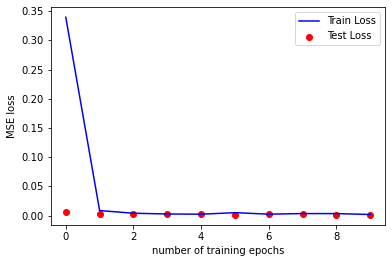

decryption accuracy is 99.99%


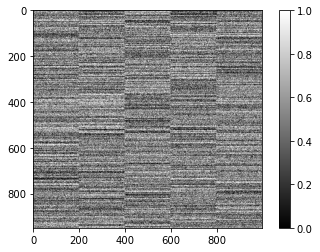

Parameters: 95 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([77, 32, 89,  2, 16, 44, 52, 46, 81, 64,  8, 17,  9, 12, 48, 28, 92, 53,
        66,  5, 40, 66, 66, 18, 92, 62, 43, 17, 48, 25, 22, 76, 68, 48, 13, 19,
        38, 79, 86, 75, 83, 64, 61, 67,  2,  9, 10, 14, 50,  4])
Epoch: 1, Train set: Avg. loss: 0.413849
Test set: Avg. loss: 0.017333
Epoch: 2, Train set: Avg. loss: 0.015162
Test set: Avg. loss: 0.008981
Epoch: 3, Train set: Avg. loss: 0.008282
Test set: Avg. loss: 0.006324
Epoch: 4, Train set: Avg. loss: 0.005753
Test set: Avg. loss: 0.020456
Epoch: 5, Train set: Avg. loss: 0.006620
Test set: Avg. loss: 0.002771
Epoch: 6, Train set: Avg. loss: 0.005197
Test set: Avg. loss: 0.005784
Epoch: 7, Train set: Avg. loss: 0.005356
Test set: Avg. loss: 0.002565
Epoch: 8, Train set: Avg. loss: 0.005300
Test set: Avg. loss: 0.002180
Epoch: 9, Train set: Avg. loss: 0.003904
Test set: Avg. loss: 0.083034
Epoch: 10, Train set: Avg. loss: 0.003334
Test set: Avg. loss: 

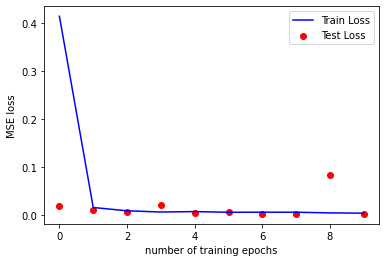

decryption accuracy is 99.96%


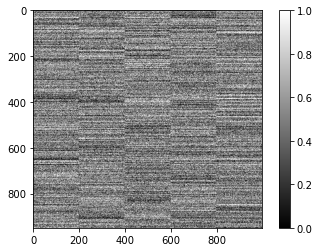

Parameters: 95 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([33, 81, 13, 88, 69, 20, 15, 83, 88,  6, 10, 39, 56, 11, 53, 28, 92, 85,
        40, 38, 38, 74, 49, 10, 55, 68, 90, 49, 46, 48, 66, 10, 39, 72, 46, 42,
        82, 22, 78, 44, 33, 55, 45, 57, 72, 38, 15, 91,  4, 78])
Epoch: 1, Train set: Avg. loss: 0.529372
Test set: Avg. loss: 0.015817
Epoch: 2, Train set: Avg. loss: 0.025464
Test set: Avg. loss: 0.019357
Epoch: 3, Train set: Avg. loss: 0.016260
Test set: Avg. loss: 0.020217
Epoch: 4, Train set: Avg. loss: 0.015332
Test set: Avg. loss: 0.006800
Epoch: 5, Train set: Avg. loss: 0.013465
Test set: Avg. loss: 0.006929
Epoch: 6, Train set: Avg. loss: 0.013641
Test set: Avg. loss: 0.007790
Epoch: 7, Train set: Avg. loss: 0.008360
Test set: Avg. loss: 0.006266
Epoch: 8, Train set: Avg. loss: 0.008008
Test set: Avg. loss: 0.004619
Epoch: 9, Train set: Avg. loss: 0.007780
Test set: Avg. loss: 0.005298
Epoch: 10, Train set: Avg. loss: 0.008004
Test set: Avg. loss: 0.008589


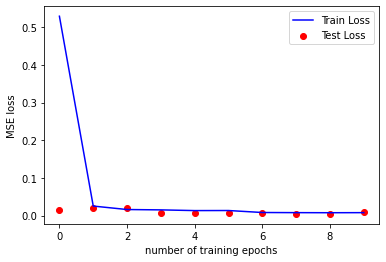

decryption accuracy is 99.74%


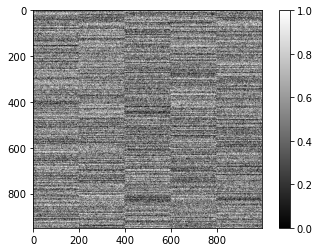

Parameters: 95 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([79, 92, 69, 51, 30, 92, 38, 85, 58, 72, 40, 60, 13, 51, 44, 67, 22,  2,
        84, 38,  3, 74, 19, 33, 92, 62, 92, 50, 72, 63, 29, 22, 88, 34, 35, 14,
        66, 21, 11, 42, 88, 89, 65, 68, 17, 77, 26, 38, 50, 84])
Epoch: 1, Train set: Avg. loss: 0.541291
Test set: Avg. loss: 0.035580
Epoch: 2, Train set: Avg. loss: 0.037338
Test set: Avg. loss: 0.022402
Epoch: 3, Train set: Avg. loss: 0.023756
Test set: Avg. loss: 0.015331
Epoch: 4, Train set: Avg. loss: 0.018696
Test set: Avg. loss: 0.024476
Epoch: 5, Train set: Avg. loss: 0.014184
Test set: Avg. loss: 0.018983
Epoch: 6, Train set: Avg. loss: 0.013755
Test set: Avg. loss: 0.013434
Epoch: 7, Train set: Avg. loss: 0.012423
Test set: Avg. loss: 0.008061
Epoch: 8, Train set: Avg. loss: 0.011259
Test set: Avg. loss: 0.009034
Epoch: 9, Train set: Avg. loss: 0.012143
Test set: Avg. loss: 0.035085
Epoch: 10, Train set: Avg. loss: 0.012450
Test set: Avg. loss: 0.018342


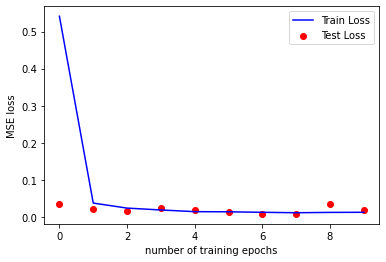

decryption accuracy is 99.49%


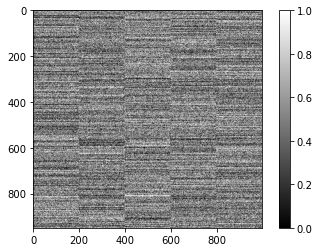

Parameters: 95 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([93,  0, 10, 51, 47, 35, 71,  6, 63, 43, 60, 13, 80, 22, 44, 64, 76, 91,
        16, 65, 11, 24, 62,  6, 60, 85, 88, 21, 21, 67, 35,  2, 75, 46, 44,  2,
        87, 47,  9, 33, 84, 55,  3,  5, 77, 39,  2, 58, 70, 83])
Epoch: 1, Train set: Avg. loss: 0.804918
Test set: Avg. loss: 0.044885
Epoch: 2, Train set: Avg. loss: 0.062171
Test set: Avg. loss: 0.032348
Epoch: 3, Train set: Avg. loss: 0.052786
Test set: Avg. loss: 0.027703
Epoch: 4, Train set: Avg. loss: 0.037276
Test set: Avg. loss: 0.023877
Epoch: 5, Train set: Avg. loss: 0.037664
Test set: Avg. loss: 0.016234
Epoch: 6, Train set: Avg. loss: 0.032824
Test set: Avg. loss: 0.060658
Epoch: 7, Train set: Avg. loss: 0.031858
Test set: Avg. loss: 0.026060
Epoch: 8, Train set: Avg. loss: 0.025481
Test set: Avg. loss: 0.020288
Epoch: 9, Train set: Avg. loss: 0.028343
Test set: Avg. loss: 0.020283
Epoch: 10, Train set: Avg. loss: 0.025469
Test set: Avg. loss: 0.031642


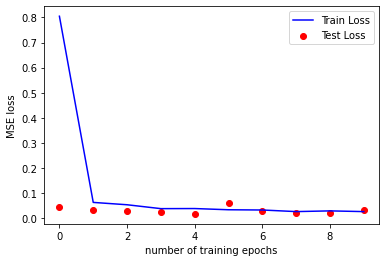

decryption accuracy is 99.15%


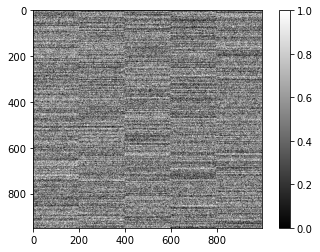

Parameters: 95 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([64, 92, 18, 18, 66,  7, 63, 75, 89, 77,  0, 62, 18, 93, 26, 52, 84, 52,
        51, 43, 31, 88, 20, 36, 61, 88, 92, 58,  6, 14, 63, 41, 85,  0, 41, 89,
        85, 14,  5, 73, 12, 73, 53, 41, 33, 41, 68,  0, 78, 92])
Epoch: 1, Train set: Avg. loss: 0.947779
Test set: Avg. loss: 0.122966
Epoch: 2, Train set: Avg. loss: 0.100212
Test set: Avg. loss: 0.091671
Epoch: 3, Train set: Avg. loss: 0.072266
Test set: Avg. loss: 0.040556
Epoch: 4, Train set: Avg. loss: 0.061270
Test set: Avg. loss: 0.047039
Epoch: 5, Train set: Avg. loss: 0.057620
Test set: Avg. loss: 0.046209
Epoch: 6, Train set: Avg. loss: 0.057184
Test set: Avg. loss: 0.034808
Epoch: 7, Train set: Avg. loss: 0.049501
Test set: Avg. loss: 0.030927
Epoch: 8, Train set: Avg. loss: 0.042698
Test set: Avg. loss: 0.209006
Epoch: 9, Train set: Avg. loss: 0.037900
Test set: Avg. loss: 0.060886
Epoch: 10, Train set: Avg. loss: 0.045537
Test set: Avg. loss: 0.050166


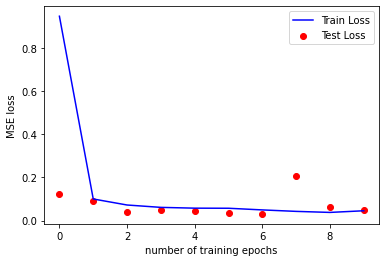

decryption accuracy is 99.03%


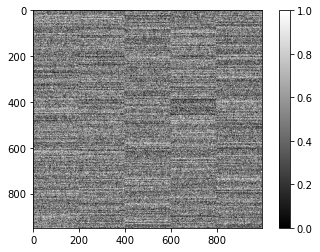

Parameters: 95 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([76, 32, 16, 30, 39, 57, 65, 36, 63, 42, 18, 29, 75, 67, 23, 64, 30, 87,
         1, 45, 47, 71, 28, 78, 48, 24, 77, 14, 67, 53, 66,  7, 58, 57, 35, 54,
        72, 49, 43,  0, 29, 84, 76, 80,  4, 13, 70, 34, 46, 28])
Epoch: 1, Train set: Avg. loss: 1.190416
Test set: Avg. loss: 0.230745
Epoch: 2, Train set: Avg. loss: 0.162356
Test set: Avg. loss: 0.177034
Epoch: 3, Train set: Avg. loss: 0.126425
Test set: Avg. loss: 0.079389
Epoch: 4, Train set: Avg. loss: 0.098505
Test set: Avg. loss: 0.072798
Epoch: 5, Train set: Avg. loss: 0.088794
Test set: Avg. loss: 0.072439
Epoch: 6, Train set: Avg. loss: 0.089111
Test set: Avg. loss: 0.068858
Epoch: 7, Train set: Avg. loss: 0.088649
Test set: Avg. loss: 0.046693
Epoch: 8, Train set: Avg. loss: 0.082703
Test set: Avg. loss: 0.045583
Epoch: 9, Train set: Avg. loss: 0.074147
Test set: Avg. loss: 0.049433
Epoch: 10, Train set: Avg. loss: 0.064585
Test set: Avg. loss: 0.060833


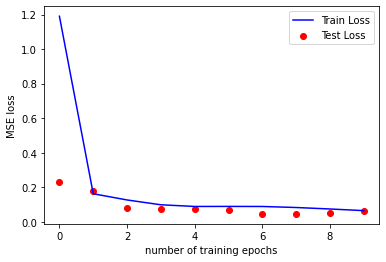

decryption accuracy is 98.68%


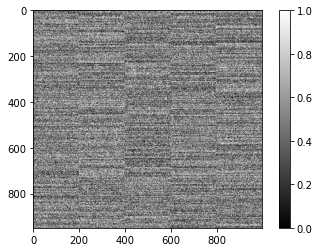

Parameters: 95 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([92, 42, 71, 76, 57, 23, 14, 48, 78,  4,  7, 64, 81,  3, 91, 57,  9, 34,
        15, 36,  2, 62, 84, 42, 25, 15, 71, 65, 71, 24, 56, 24, 72, 83, 69, 77,
        41, 20, 23, 29, 55, 49, 11, 41, 37,  0, 34, 15, 89, 67])
Epoch: 1, Train set: Avg. loss: 1.462046
Test set: Avg. loss: 0.221539
Epoch: 2, Train set: Avg. loss: 0.225173
Test set: Avg. loss: 0.210526
Epoch: 3, Train set: Avg. loss: 0.176374
Test set: Avg. loss: 0.211218
Epoch: 4, Train set: Avg. loss: 0.153703
Test set: Avg. loss: 0.205543
Epoch: 5, Train set: Avg. loss: 0.137037
Test set: Avg. loss: 0.148957
Epoch: 6, Train set: Avg. loss: 0.134436
Test set: Avg. loss: 0.108395
Epoch: 7, Train set: Avg. loss: 0.125920
Test set: Avg. loss: 0.087222
Epoch: 8, Train set: Avg. loss: 0.124976
Test set: Avg. loss: 0.097026
Epoch: 9, Train set: Avg. loss: 0.107457
Test set: Avg. loss: 0.094510
Epoch: 10, Train set: Avg. loss: 0.110538
Test set: Avg. loss: 0.134601


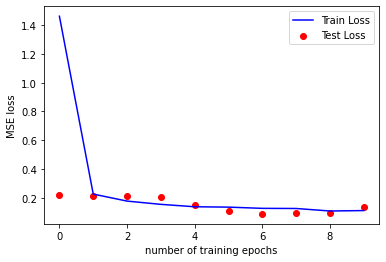

decryption accuracy is 97.12%


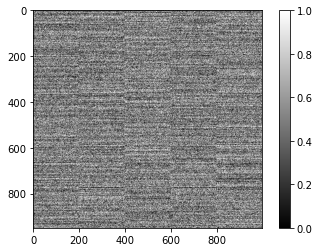

Parameters: 95 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([ 5, 20, 93,  0, 91, 41,  0, 33, 41, 38, 53, 91, 90, 84, 80, 41, 24,  3,
         0, 87, 25, 49, 68, 93, 46, 18, 78, 21, 48, 64, 85, 64, 87, 46, 17, 68,
        24, 63, 10, 30, 76, 43,  4,  4, 18, 58, 75,  0, 17, 59])
Epoch: 1, Train set: Avg. loss: 1.805916
Test set: Avg. loss: 0.364635
Epoch: 2, Train set: Avg. loss: 0.345219
Test set: Avg. loss: 0.338543
Epoch: 3, Train set: Avg. loss: 0.260198
Test set: Avg. loss: 0.300736
Epoch: 4, Train set: Avg. loss: 0.229947
Test set: Avg. loss: 0.196889
Epoch: 5, Train set: Avg. loss: 0.207218
Test set: Avg. loss: 0.184846
Epoch: 6, Train set: Avg. loss: 0.201226
Test set: Avg. loss: 0.194170
Epoch: 7, Train set: Avg. loss: 0.189642
Test set: Avg. loss: 0.146263
Epoch: 8, Train set: Avg. loss: 0.195419
Test set: Avg. loss: 0.147178
Epoch: 9, Train set: Avg. loss: 0.175546
Test set: Avg. loss: 0.128446
Epoch: 10, Train set: Avg. loss: 0.176229
Test set: Avg. loss: 0

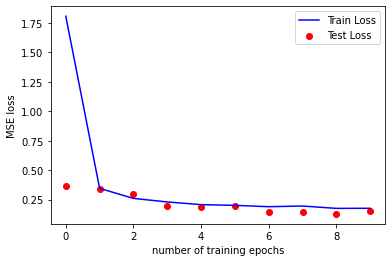

decryption accuracy is 96.26%


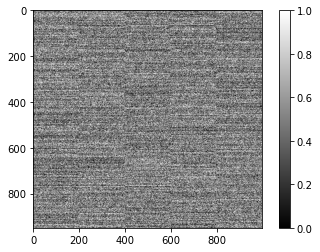

Parameters: 100 0.05
torch.Size([10, 50]) torch.Size([50]) tensor([62, 52, 41, 24, 19, 80, 47, 25,  6, 26, 92, 35, 78, 74, 70, 56, 14, 21,
        58, 78, 90, 83, 80, 75, 53, 90, 29, 25, 41, 67, 17, 19, 38, 57, 41, 58,
        35, 27, 58, 74, 93, 64, 49, 27, 20, 80, 37, 33, 31, 54])
Epoch: 1, Train set: Avg. loss: 0.093682
Test set: Avg. loss: 0.001191
Epoch: 2, Train set: Avg. loss: 0.000864
Test set: Avg. loss: 0.000640
Epoch: 3, Train set: Avg. loss: 0.000545
Test set: Avg. loss: 0.000450
Epoch: 4, Train set: Avg. loss: 0.000392
Test set: Avg. loss: 0.000345
Epoch: 5, Train set: Avg. loss: 0.000312
Test set: Avg. loss: 0.000280
Epoch: 6, Train set: Avg. loss: 0.000254
Test set: Avg. loss: 0.000235
Epoch: 7, Train set: Avg. loss: 0.000219
Test set: Avg. loss: 0.000213
Epoch: 8, Train set: Avg. loss: 0.000192
Test set: Avg. loss: 0.000184
Epoch: 9, Train set: Avg. loss: 0.000171
Test set: Avg. loss: 0.000164
Epoch: 10, Train set: Avg. loss: 0.000157
Test set: Avg. loss: 0.000148


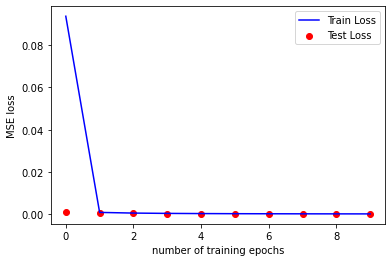

decryption accuracy is 100.0%


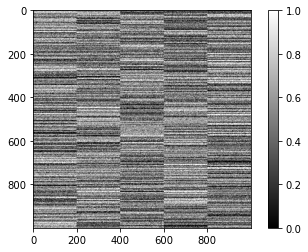

Parameters: 100 0.1
torch.Size([10, 50]) torch.Size([50]) tensor([73, 24, 71, 82, 45,  3, 34, 59, 70, 51, 83, 37, 14, 34, 78, 64, 37, 42,
        73, 84, 82, 30,  3, 20, 45, 91,  1,  0, 60, 16,  9, 76, 88, 58,  4, 33,
        49, 86, 64, 33,  2, 16, 72, 21, 86, 39, 30, 19, 47, 75])
Epoch: 1, Train set: Avg. loss: 0.185595
Test set: Avg. loss: 0.001555
Epoch: 2, Train set: Avg. loss: 0.001053
Test set: Avg. loss: 0.000830
Epoch: 3, Train set: Avg. loss: 0.000695
Test set: Avg. loss: 0.000570
Epoch: 4, Train set: Avg. loss: 0.000498
Test set: Avg. loss: 0.000483
Epoch: 5, Train set: Avg. loss: 0.000405
Test set: Avg. loss: 0.000369
Epoch: 6, Train set: Avg. loss: 0.000326
Test set: Avg. loss: 0.000306
Epoch: 7, Train set: Avg. loss: 0.000307
Test set: Avg. loss: 0.000260
Epoch: 8, Train set: Avg. loss: 0.000250
Test set: Avg. loss: 0.000236
Epoch: 9, Train set: Avg. loss: 0.000222
Test set: Avg. loss: 0.000214
Epoch: 10, Train set: Avg. loss: 0.000197
Test set: Avg. loss: 0.000198


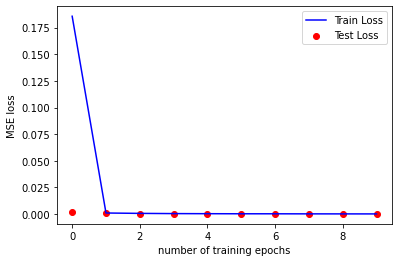

decryption accuracy is 100.0%


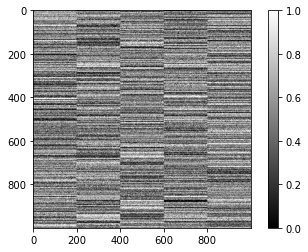

Parameters: 100 0.15
torch.Size([10, 50]) torch.Size([50]) tensor([37, 83, 22, 89, 47, 89, 65, 35, 68, 27, 57, 45, 19, 57, 57, 78, 26,  9,
        75,  0, 51, 91, 56, 86, 44, 18, 49, 35, 74, 11, 51,  3, 62, 74, 33, 39,
         8,  9, 82, 25, 77, 19, 25, 34, 29,  4, 18, 33, 90, 23])
Epoch: 1, Train set: Avg. loss: 0.143947
Test set: Avg. loss: 0.002112
Epoch: 2, Train set: Avg. loss: 0.001742
Test set: Avg. loss: 0.001227
Epoch: 3, Train set: Avg. loss: 0.000942
Test set: Avg. loss: 0.000825
Epoch: 4, Train set: Avg. loss: 0.000713
Test set: Avg. loss: 0.000652
Epoch: 5, Train set: Avg. loss: 0.000599
Test set: Avg. loss: 0.000523
Epoch: 6, Train set: Avg. loss: 0.000542
Test set: Avg. loss: 0.000445
Epoch: 7, Train set: Avg. loss: 0.000426
Test set: Avg. loss: 0.000433
Epoch: 8, Train set: Avg. loss: 0.000379
Test set: Avg. loss: 0.000321
Epoch: 9, Train set: Avg. loss: 0.000303
Test set: Avg. loss: 0.000303
Epoch: 10, Train set: Avg. loss: 0.000404
Test set: Avg. loss: 0.000264


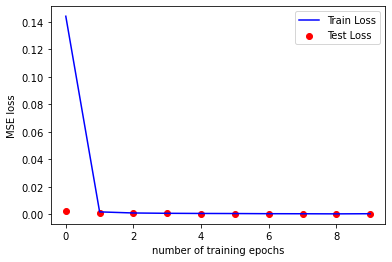

decryption accuracy is 100.0%


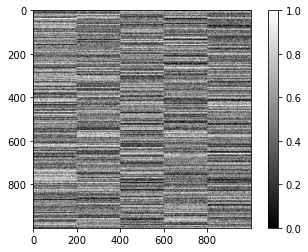

Parameters: 100 0.2
torch.Size([10, 50]) torch.Size([50]) tensor([36, 56, 26, 65, 39, 90, 92,  9, 76, 53, 34, 16, 49, 42,  5, 71, 70, 51,
        88, 84, 59, 25, 70, 17,  4, 13, 20, 48, 19, 92, 41,  2, 68, 31,  2, 15,
        10, 89, 84, 56, 89, 17, 56, 78, 67, 78, 86, 27, 29, 43])
Epoch: 1, Train set: Avg. loss: 0.134081
Test set: Avg. loss: 0.011207
Epoch: 2, Train set: Avg. loss: 0.002497
Test set: Avg. loss: 0.001636
Epoch: 3, Train set: Avg. loss: 0.001528
Test set: Avg. loss: 0.001060
Epoch: 4, Train set: Avg. loss: 0.001142
Test set: Avg. loss: 0.000925
Epoch: 5, Train set: Avg. loss: 0.000908
Test set: Avg. loss: 0.000828
Epoch: 6, Train set: Avg. loss: 0.000805
Test set: Avg. loss: 0.000551
Epoch: 7, Train set: Avg. loss: 0.000615
Test set: Avg. loss: 0.000505
Epoch: 8, Train set: Avg. loss: 0.000507
Test set: Avg. loss: 0.000463
Epoch: 9, Train set: Avg. loss: 0.000542
Test set: Avg. loss: 0.000452
Epoch: 10, Train set: Avg. loss: 0.000393
Test set: Avg. loss: 0.000376


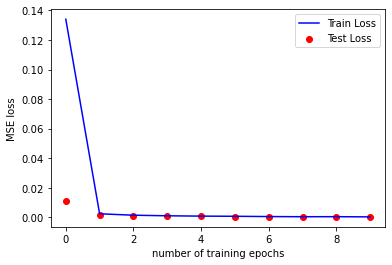

decryption accuracy is 100.0%


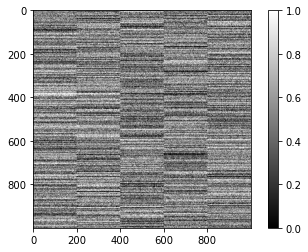

Parameters: 100 0.25
torch.Size([10, 50]) torch.Size([50]) tensor([72, 77, 63, 52, 36, 64, 55,  1, 72, 72, 56, 45, 21, 47, 85, 19,  4,  8,
        35, 58, 15, 82, 75, 93, 19, 83, 10, 11, 62, 52, 62,  6, 24, 14, 93, 50,
        73, 53, 39, 22, 43,  6, 91, 38, 42, 79, 11, 63, 93, 38])
Epoch: 1, Train set: Avg. loss: 0.226138
Test set: Avg. loss: 0.010651
Epoch: 2, Train set: Avg. loss: 0.005716
Test set: Avg. loss: 0.002196
Epoch: 3, Train set: Avg. loss: 0.002787
Test set: Avg. loss: 0.001711
Epoch: 4, Train set: Avg. loss: 0.001982
Test set: Avg. loss: 0.001190
Epoch: 5, Train set: Avg. loss: 0.001519
Test set: Avg. loss: 0.000954
Epoch: 6, Train set: Avg. loss: 0.001373
Test set: Avg. loss: 0.001244
Epoch: 7, Train set: Avg. loss: 0.001084
Test set: Avg. loss: 0.001059
Epoch: 8, Train set: Avg. loss: 0.001193
Test set: Avg. loss: 0.000580
Epoch: 9, Train set: Avg. loss: 0.000780
Test set: Avg. loss: 0.000676
Epoch: 10, Train set: Avg. loss: 0.000964
Test set: Avg. loss: 0.000552


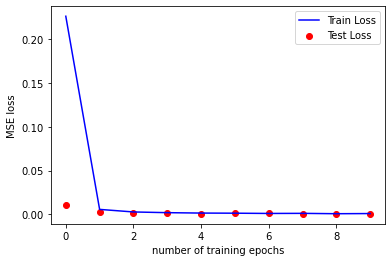

decryption accuracy is 99.98%


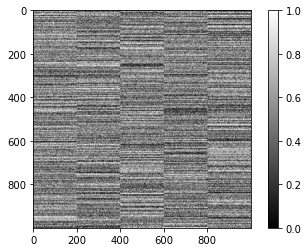

Parameters: 100 0.3
torch.Size([10, 50]) torch.Size([50]) tensor([36,  0, 52, 86, 69, 93, 27, 86, 38, 28, 41, 71, 26, 42, 41,  9, 70, 12,
        54, 45, 48, 46, 21, 70, 85, 39,  9, 23, 29, 24, 14,  2, 46, 17,  4, 37,
         7, 14,  9, 46, 31, 39, 53, 75, 10, 52, 12, 70, 25, 51])
Epoch: 1, Train set: Avg. loss: 0.307536
Test set: Avg. loss: 0.010204
Epoch: 2, Train set: Avg. loss: 0.007277
Test set: Avg. loss: 0.003280
Epoch: 3, Train set: Avg. loss: 0.005233
Test set: Avg. loss: 0.002708
Epoch: 4, Train set: Avg. loss: 0.003741
Test set: Avg. loss: 0.001878
Epoch: 5, Train set: Avg. loss: 0.003195
Test set: Avg. loss: 0.001403
Epoch: 6, Train set: Avg. loss: 0.002522
Test set: Avg. loss: 0.003230
Epoch: 7, Train set: Avg. loss: 0.002865
Test set: Avg. loss: 0.003821
Epoch: 8, Train set: Avg. loss: 0.002294
Test set: Avg. loss: 0.001606
Epoch: 9, Train set: Avg. loss: 0.001693
Test set: Avg. loss: 0.001493
Epoch: 10, Train set: Avg. loss: 0.001204
Test set: Avg. loss: 0.000903


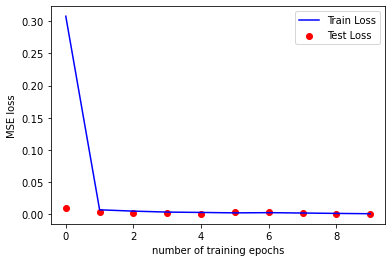

decryption accuracy is 99.95%


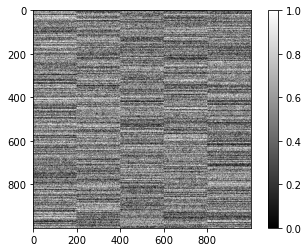

Parameters: 100 0.35000000000000003
torch.Size([10, 50]) torch.Size([50]) tensor([85,  7, 89, 33, 77, 10, 52, 54, 90, 91, 67, 64, 10, 16, 65, 69, 87, 65,
        61, 67, 35, 88, 59, 37, 39, 38, 40, 85,  0, 75,  7, 31, 34, 49, 44,  7,
        65, 51, 57, 60, 76, 57, 85, 42, 61, 11, 45, 33,  2, 27])
Epoch: 1, Train set: Avg. loss: 0.362821
Test set: Avg. loss: 0.015922
Epoch: 2, Train set: Avg. loss: 0.012762
Test set: Avg. loss: 0.008408
Epoch: 3, Train set: Avg. loss: 0.008795
Test set: Avg. loss: 0.018688
Epoch: 4, Train set: Avg. loss: 0.006389
Test set: Avg. loss: 0.005093
Epoch: 5, Train set: Avg. loss: 0.009470
Test set: Avg. loss: 0.019799
Epoch: 6, Train set: Avg. loss: 0.005508
Test set: Avg. loss: 0.003886
Epoch: 7, Train set: Avg. loss: 0.003724
Test set: Avg. loss: 0.002269
Epoch: 8, Train set: Avg. loss: 0.003993
Test set: Avg. loss: 0.002665
Epoch: 9, Train set: Avg. loss: 0.004430
Test set: Avg. loss: 0.001882
Epoch: 10, Train set: Avg. loss: 0.003790
Test set: Avg. loss:

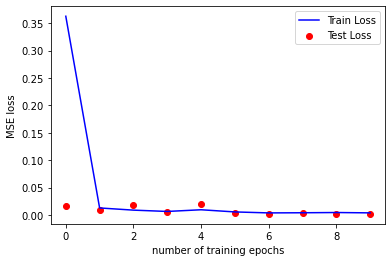

decryption accuracy is 99.95%


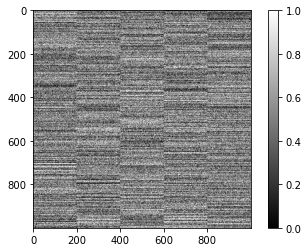

Parameters: 100 0.4
torch.Size([10, 50]) torch.Size([50]) tensor([10, 32, 83,  6, 23, 24, 27, 68,  2, 13, 49, 35, 52, 89, 17,  2, 21, 62,
        33, 61, 91, 22, 27, 43, 49, 78,  9, 43, 37, 59, 79, 38, 46, 91, 72, 78,
        26, 74, 25, 61, 76, 28, 69, 22,  8, 48, 35, 69, 52, 79])
Epoch: 1, Train set: Avg. loss: 0.568713
Test set: Avg. loss: 0.017427
Epoch: 2, Train set: Avg. loss: 0.022333
Test set: Avg. loss: 0.020572
Epoch: 3, Train set: Avg. loss: 0.017026
Test set: Avg. loss: 0.015772
Epoch: 4, Train set: Avg. loss: 0.013661
Test set: Avg. loss: 0.008161
Epoch: 5, Train set: Avg. loss: 0.010516
Test set: Avg. loss: 0.013966
Epoch: 6, Train set: Avg. loss: 0.007891
Test set: Avg. loss: 0.009095
Epoch: 7, Train set: Avg. loss: 0.008596
Test set: Avg. loss: 0.005173
Epoch: 8, Train set: Avg. loss: 0.007554
Test set: Avg. loss: 0.003375
Epoch: 9, Train set: Avg. loss: 0.006372
Test set: Avg. loss: 0.004527
Epoch: 10, Train set: Avg. loss: 0.005413
Test set: Avg. loss: 0.003124


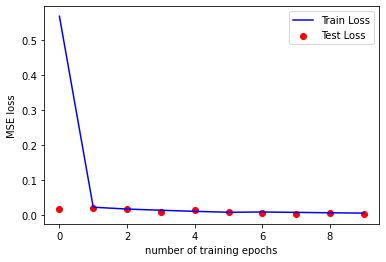

decryption accuracy is 99.9%


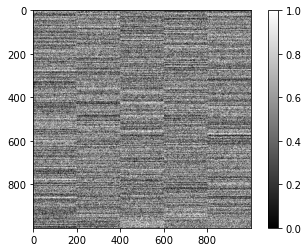

Parameters: 100 0.45
torch.Size([10, 50]) torch.Size([50]) tensor([21, 75, 74, 82, 21, 19, 22, 87, 43, 79, 45, 61, 43,  0, 10,  5,  8, 57,
        44, 77, 55,  8, 66, 63, 87, 12, 34, 13, 92, 32, 90, 74,  0, 92,  7,  8,
        81, 91, 87, 62, 69, 75, 50, 38, 17, 54,  4, 89, 41, 27])
Epoch: 1, Train set: Avg. loss: 0.599342
Test set: Avg. loss: 0.032800
Epoch: 2, Train set: Avg. loss: 0.039863
Test set: Avg. loss: 0.037650
Epoch: 3, Train set: Avg. loss: 0.024513
Test set: Avg. loss: 0.020001
Epoch: 4, Train set: Avg. loss: 0.019451
Test set: Avg. loss: 0.009677
Epoch: 5, Train set: Avg. loss: 0.019128
Test set: Avg. loss: 0.023809
Epoch: 6, Train set: Avg. loss: 0.019597
Test set: Avg. loss: 0.011104
Epoch: 7, Train set: Avg. loss: 0.014380
Test set: Avg. loss: 0.011079
Epoch: 8, Train set: Avg. loss: 0.017259
Test set: Avg. loss: 0.010413
Epoch: 9, Train set: Avg. loss: 0.014022
Test set: Avg. loss: 0.016963
Epoch: 10, Train set: Avg. loss: 0.015400
Test set: Avg. loss: 0.008177


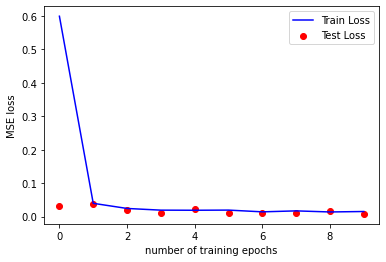

decryption accuracy is 99.74%


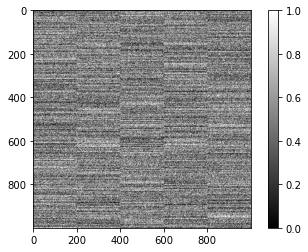

Parameters: 100 0.5
torch.Size([10, 50]) torch.Size([50]) tensor([34, 43, 38, 52, 82, 33, 64, 35, 20, 44, 75, 47, 18, 57, 19, 28, 25, 54,
        64, 32, 48, 72, 93, 32,  5, 60, 36, 32, 71, 53, 57, 34, 13, 68, 88, 47,
        63, 12, 43, 41, 29, 28, 87, 62, 93, 88, 15, 19, 76, 31])
Epoch: 1, Train set: Avg. loss: 0.871689
Test set: Avg. loss: 0.188238
Epoch: 2, Train set: Avg. loss: 0.066735
Test set: Avg. loss: 0.038995
Epoch: 3, Train set: Avg. loss: 0.045725
Test set: Avg. loss: 0.032365
Epoch: 4, Train set: Avg. loss: 0.039435
Test set: Avg. loss: 0.025452
Epoch: 5, Train set: Avg. loss: 0.029163
Test set: Avg. loss: 0.026705
Epoch: 6, Train set: Avg. loss: 0.028573
Test set: Avg. loss: 0.026433
Epoch: 7, Train set: Avg. loss: 0.025796
Test set: Avg. loss: 0.017054
Epoch: 8, Train set: Avg. loss: 0.025028
Test set: Avg. loss: 0.033704
Epoch: 9, Train set: Avg. loss: 0.022164
Test set: Avg. loss: 0.014242
Epoch: 10, Train set: Avg. loss: 0.021691
Test set: Avg. loss: 0.012075


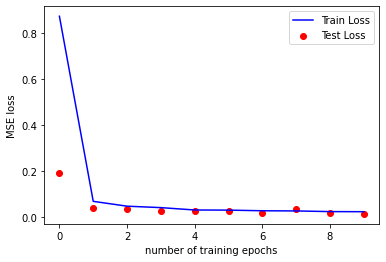

decryption accuracy is 99.74%


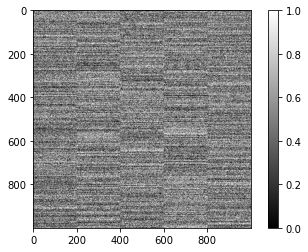

Parameters: 100 0.55
torch.Size([10, 50]) torch.Size([50]) tensor([77, 47, 45, 14, 35, 44, 20, 34, 88, 53, 60,  7,  2, 43, 24, 30, 40, 17,
        22, 77, 64, 64, 14, 61, 80, 55, 60, 92, 52, 67, 19, 83, 12, 59, 61,  6,
        54, 40, 83, 16,  2, 12, 82, 12, 72, 11, 91,  0, 74, 81])
Epoch: 1, Train set: Avg. loss: 1.024510
Test set: Avg. loss: 0.264752
Epoch: 2, Train set: Avg. loss: 0.093613
Test set: Avg. loss: 0.205870
Epoch: 3, Train set: Avg. loss: 0.073409
Test set: Avg. loss: 0.136853
Epoch: 4, Train set: Avg. loss: 0.068112
Test set: Avg. loss: 0.064695
Epoch: 5, Train set: Avg. loss: 0.057547
Test set: Avg. loss: 0.041309
Epoch: 6, Train set: Avg. loss: 0.043979
Test set: Avg. loss: 0.058309
Epoch: 7, Train set: Avg. loss: 0.048546
Test set: Avg. loss: 0.026713
Epoch: 8, Train set: Avg. loss: 0.048877
Test set: Avg. loss: 0.125336
Epoch: 9, Train set: Avg. loss: 0.042628
Test set: Avg. loss: 0.050155
Epoch: 10, Train set: Avg. loss: 0.044178
Test set: Avg. loss: 0.032616


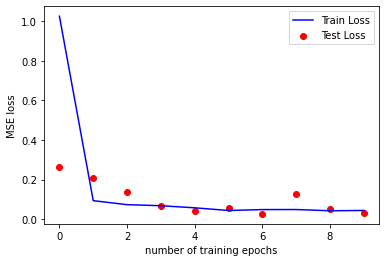

decryption accuracy is 99.32%


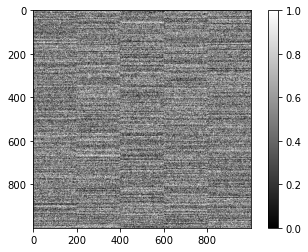

Parameters: 100 0.6
torch.Size([10, 50]) torch.Size([50]) tensor([ 5, 63,  0, 87, 71, 68, 16, 22, 29, 44, 89, 83, 60, 14, 87, 82, 20, 65,
        64, 32, 83, 81, 31, 92, 11,  1, 88, 64, 33, 56, 46, 86, 10, 73, 72,  5,
        84, 86, 77, 47, 75, 53,  1, 12,  9, 93, 44, 73,  2,  0])
Epoch: 1, Train set: Avg. loss: 1.136667
Test set: Avg. loss: 0.181353
Epoch: 2, Train set: Avg. loss: 0.149256
Test set: Avg. loss: 0.092409
Epoch: 3, Train set: Avg. loss: 0.115861
Test set: Avg. loss: 0.061012
Epoch: 4, Train set: Avg. loss: 0.092576
Test set: Avg. loss: 0.071235
Epoch: 5, Train set: Avg. loss: 0.081098
Test set: Avg. loss: 0.098768
Epoch: 6, Train set: Avg. loss: 0.076721
Test set: Avg. loss: 0.101209
Epoch: 7, Train set: Avg. loss: 0.079196
Test set: Avg. loss: 0.090659
Epoch: 8, Train set: Avg. loss: 0.072685
Test set: Avg. loss: 0.068456
Epoch: 9, Train set: Avg. loss: 0.066880
Test set: Avg. loss: 0.058517
Epoch: 10, Train set: Avg. loss: 0.063255
Test set: Avg. loss: 0.081687


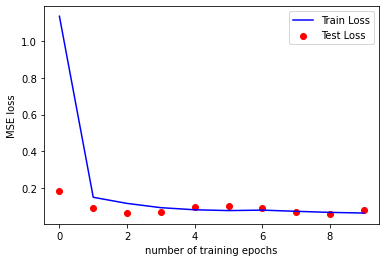

decryption accuracy is 98.64%


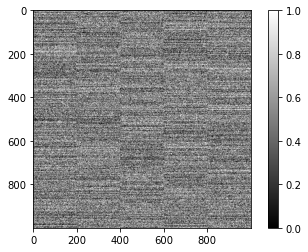

Parameters: 100 0.65
torch.Size([10, 50]) torch.Size([50]) tensor([89, 15,  7, 15, 18, 49, 61, 74, 23, 77, 89,  5,  0, 35, 29, 53, 87, 30,
        17, 88, 43, 10, 57, 79,  2, 10, 79, 93, 84, 29, 83, 32, 40, 75, 90, 66,
        39, 81,  4, 10,  7, 48, 52, 12, 58, 66, 75, 35, 52, 66])
Epoch: 1, Train set: Avg. loss: 1.571932
Test set: Avg. loss: 0.198526
Epoch: 2, Train set: Avg. loss: 0.222960
Test set: Avg. loss: 0.180088
Epoch: 3, Train set: Avg. loss: 0.156887
Test set: Avg. loss: 0.124538
Epoch: 4, Train set: Avg. loss: 0.132946
Test set: Avg. loss: 0.146769
Epoch: 5, Train set: Avg. loss: 0.123702
Test set: Avg. loss: 0.090999
Epoch: 6, Train set: Avg. loss: 0.118183
Test set: Avg. loss: 0.076570
Epoch: 7, Train set: Avg. loss: 0.114740
Test set: Avg. loss: 0.227076
Epoch: 8, Train set: Avg. loss: 0.105432
Test set: Avg. loss: 0.088915
Epoch: 9, Train set: Avg. loss: 0.101245
Test set: Avg. loss: 0.112581
Epoch: 10, Train set: Avg. loss: 0.109255
Test set: Avg. loss: 0.103450


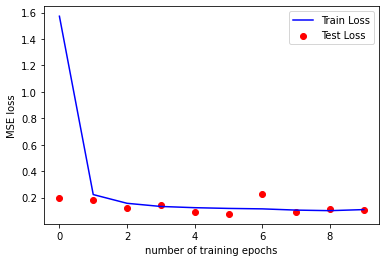

decryption accuracy is 97.59%


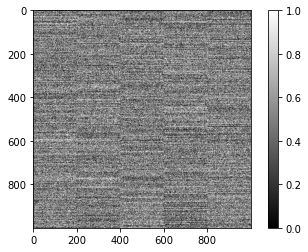

Parameters: 100 0.7000000000000001
torch.Size([10, 50]) torch.Size([50]) tensor([45,  4, 33,  4,  9, 16, 12, 56, 43, 74, 54, 73, 32, 31, 32, 78, 35,  5,
        84, 91, 88, 85, 55, 90, 37, 66, 10, 44, 20, 73, 38, 58, 88, 90, 85,  9,
        85, 52, 49, 32, 23, 12, 13, 23, 29, 61, 93, 16, 54, 34])
Epoch: 1, Train set: Avg. loss: 1.759095
Test set: Avg. loss: 0.297407
Epoch: 2, Train set: Avg. loss: 0.311541
Test set: Avg. loss: 0.216441
Epoch: 3, Train set: Avg. loss: 0.250142
Test set: Avg. loss: 0.230455
Epoch: 4, Train set: Avg. loss: 0.211527
Test set: Avg. loss: 0.179251
Epoch: 5, Train set: Avg. loss: 0.191800
Test set: Avg. loss: 0.181264
Epoch: 6, Train set: Avg. loss: 0.177522
Test set: Avg. loss: 0.254757
Epoch: 7, Train set: Avg. loss: 0.173409
Test set: Avg. loss: 0.157769
Epoch: 8, Train set: Avg. loss: 0.163787
Test set: Avg. loss: 0.129077
Epoch: 9, Train set: Avg. loss: 0.150541
Test set: Avg. loss: 0.152426
Epoch: 10, Train set: Avg. loss: 0.154161
Test set: Avg. loss: 

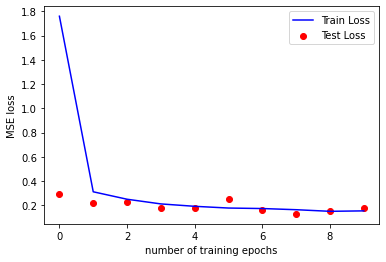

decryption accuracy is 96.01%


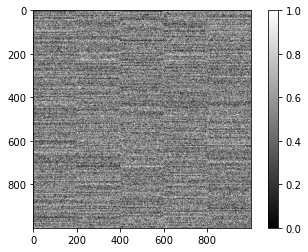

In [139]:
for i, multiplier in enumerate(dim_multipliers):
    for j, noise in enumerate(noise_levels):
        crypto_params = {
            'classes': 94,
            'skdim': 10,
            'noise': noise,
            'dim_multiplier': multiplier
        }
        crossbar_params = {
            'Ron': 10e3,
            'Roff': 10e5,
            'viability': noise,
            'P_stuck_on': 0.05,
            'P_stuck_off': 0.05,
        }
        print("Parameters:",multiplier, noise)
        model = TC.encryption_model('model1', secret_key, crypto_params, crossbar_params)
        model.train()
        acc = model.evaluate(message, noise = noise, vis = True)
        grid[i,j] = acc

In [140]:
print(grid)

[[ 95.72  93.28  91.15  84.56  78.13  68.58  56.07  45.55  39.32  32.44
   26.06  22.64  20.36  16.32]
 [ 99.55  99.41  98.29  97.5   95.11  92.16  85.14  80.37  69.74  61.55
   52.35  44.63  37.11  31.72]
 [ 99.81  99.82  99.66  99.04  98.13  96.95  94.38  88.82  86.19  77.91
   67.49  60.53  53.17  45.83]
 [ 99.97  99.94  99.76  99.68  99.24  98.73  97.04  94.14  91.61  87.76
   79.04  74.6   64.32  60.  ]
 [ 99.99  99.96  99.96  99.91  99.34  98.87  98.28  96.92  94.45  90.09
   87.3   80.67  73.81  68.2 ]
 [100.   100.    99.97  99.92  99.75  99.4   99.06  98.2   96.39  93.86
   91.4   85.37  81.91  76.24]
 [100.   100.    99.99  99.92  99.74  99.71  99.28  98.4   97.37  95.71
   93.26  89.73  85.75  78.66]
 [100.   100.   100.    99.94  99.88  99.77  99.08  99.37  98.48  96.44
   95.45  91.52  88.07  84.63]
 [100.   100.    99.99  99.93  99.95  99.9   99.6   99.25  98.5   97.25
   95.84  94.43  91.35  87.62]
 [100.   100.    99.98 100.    99.96  99.75  99.68  99.53  99.01  97.06
 

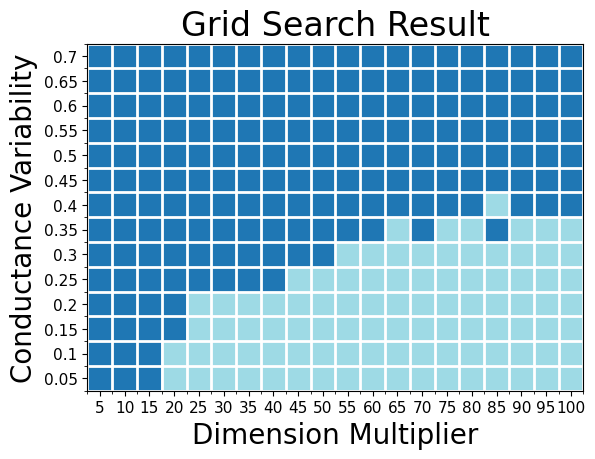

In [338]:
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rc('font', serif='Arial') 
matplotlib.rcParams.update({'font.size': 20})

M = np.array(grid) > 99.9
M = np.rot90(M)
#plt.imshow(np.array(grid))

nl = np.array(noise_levels[::-1])

plt.figure()
im = plt.imshow(M,
                interpolation='none', aspect='equal', cmap = "tab20")

ax = plt.gca();

# Major ticks
ax.set_xticks(np.arange(0, 20, 1))
ax.set_yticks(np.arange(0, 14, 1))

# Labels for major ticks
ax.set_xticklabels(dim_multipliers, size = 11)
ax.set_yticklabels(np.round(nl, 2), size = 11)

# Minor ticks
ax.set_xticks(np.arange(-.5, 20, 1), minor=True)
ax.set_yticks(np.arange(-.5, 14, 1), minor=True)

ax.set_xlabel("Dimension Multiplier")
ax.set_ylabel("Conductance Variability")

ax.set_title("Grid Search Result")

# Gridlines based on minor ticks
ax.grid(which='minor', color='w', linestyle='-', linewidth=2)
plt.savefig('figures/paper/grid_search.png', dpi=300, bbox_inches='tight')

In [325]:
import pandas as pd
np_grid = np.array(grid)
print(np_grid.shape)
np_noise_levels = np.array(np_noise_levels)
print(np_noise_levels.shape)

(20, 14)
(14,)


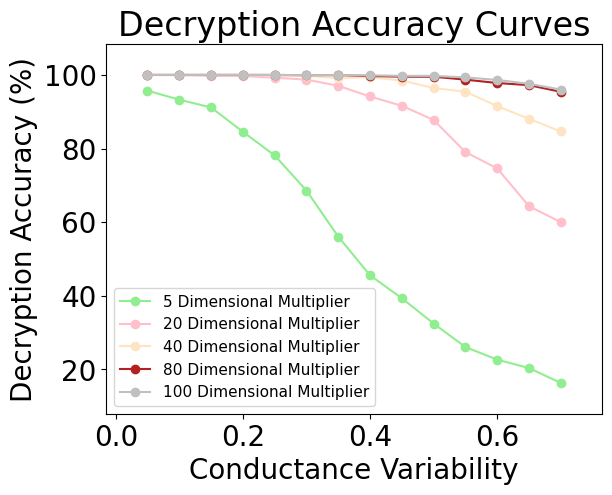

In [339]:
plt.style.use('seaborn-pastel')
plt.margins(0.1, tight=True)
plt.plot(np.round(np_noise_levels, 2), np_grid[0], 'o-', color='lightgreen',label = "5 Dimensional Multiplier")
plt.plot(np.round(np_noise_levels, 2), np_grid[3], 'o-', color='pink', label = "20 Dimensional Multiplier")
plt.plot(np.round(np_noise_levels, 2), np_grid[7], 'o-', color='bisque',label = "40 Dimensional Multiplier")
plt.plot(np.round(np_noise_levels, 2), np_grid[15], 'o-', color='firebrick', label = "80 Dimensional Multiplier")
plt.plot(np.round(np_noise_levels, 2), np_grid[19], 'o-', color='silver',label = "100 Dimensional Multiplier")
plt.legend(loc = 3, fontsize = 11)
plt.title("Decryption Accuracy Curves")
plt.xlabel("Conductance Variability")
plt.ylabel("Decryption Accuracy (%)")
# ax = plt.axes()
# ax.set_facecolor("white")
plt.savefig('figures/paper/decryption_accuracy_curves.png', dpi=300, bbox_inches='tight')